# Generative Models as Data Augmentation in the Medical Domain

## 1. Overview

This project tries to evaluate the quality of generative models for data augmentation in the medical domain. 

Data augmentation will be relying on geometric data augmentation, (variational) auto-encoder (e.g. stacked denoising, denoising auto-encoder, etc.), and generative adversarial neural networks (e.g. GAN, DCGAN, Wasserstein GAN, etc.) for instance.

We will restrict ourself to three kind of models to generate new data and evaluate the (possible) improvement with regards to a final classification score (i.e. comparing results between augmented and non-augmented training sets). 

### Datasets

We will look into applying the above project on some (if not all) of the following datasets from the MedMNIST Classification Decathlon (https://medmnist.github.io/):

| Dataset | Classification Type | Train size | Validation size | Test size |
| :--- | :--- | :---: | :---: | :---: |  
| PathMNIST Pathology | Multi-Class (9) | 89,996 | 10,004 | 7,180 |
| DermaMNIST Dermatoscope | Multi-Class (7) | 7,007 | 1,003 | 2,005 |
| OctMNIST | Multi-Class (4) | 97,477 | 10,832 | 1,000 |
| PneumoniaMNIST Chest X-ray | Binary-Class (2) |4,708 | 524 | 624 |
| BreastMNIST Breast Ultrasound | Binary-Class (2) | 546 | 78 | 156 |
| OrganMNIST_Axial Abdominal CT | Multi-Class (11) | 34,581 | 6,491 | 17,778 |
| OragnMNIST_Coronal Abdominal CT | Multi-Class (11) |13,000 | 2,392 | 8,268 |
| OrganMNIST_Sagittal Abdominal CT | Multi-Class (11) | 13,940 | 2,452 | 8,829 |

### Notes

We will also provide a short report (in copy) explaining the choice of VAE, AE, and/or GAN models, outlining differences between datasets' results. We will also try to interprete and justify possible differences with regards to models, data specifications, visual features, and bibliography references used to support the choices made.

## 2. Data imports, Library Imports, and other preliminary declarations

### Source

We will retrieve the above dataset from the following website:

> [MedMNIST v2: A Large-Scale Lightweight Benchmark for 2D and 3D Biomedical Image Classification](https://medmnist.com/), Jiancheng Yang,Rui Shi,Donglai Wei,Zequan Liu,Lin Zhao,Bilian Ke,Hanspeter Pfister,Bingbing Ni

By following the instructions on their [github](https://github.com/MedMNIST/MedMNIST), we can download their ready-made module with the following instruction:

```sh
pip install jupyter ipywidgets IProgress
pip install medmnist
```

And load it in a python or ipython instance:

```python
import medmnist
```

### Library Imports

In [1]:
from python_scripts.classifier import run_classifier_pipeline
from python_scripts.variational_autoencoders import run_encoder_pipeline, one_hot
from python_scripts.generative_adversarial_networks import run_GAN_pipeline
from python_scripts.data import retrieve_flag_info, import_dataset
from python_scripts.data import check_cuda_availability
from python_scripts.data import generate_augmented_dataset_condVAE
from python_scripts.data import generate_augmented_dataset_jointVAE
from python_scripts.data import generate_augmented_dataset_condGAN

import os
import warnings
warnings.filterwarnings('ignore')

### Checks CUDA availability

In [2]:
check_cuda_availability()

True,0,<torch.cuda.device object at 0x7f24f43d2910>,1
NVIDIA GeForce GTX 980 Ti


### Data Imports

We import the datasets in four manners:

| import # | with WSR | with Geometric DA | Application | Other transformation | 
| --- | --- | --- | --- | --- |
| 1 | No | No | To test the baseline classifier |  No | 
| 2 | Yes | No | To test the baseline classifier and train the VAE |  No | 
| 3 | Yes | No | To train the GAN |  Iimage upscale to 32x32* | 
| 4 | Yes | Yes | To test the baseline classifier |  No | 

\* Images are upscaled to 32 pixels by 32 pixels in size in order to work with TorchFusion's implementation of a GAN.


In [3]:
data_flags = ["pathmnist", "dermamnist", "octmnist", "pneumoniamnist", 
              "breastmnist", "organamnist", "organcmnist", "organsmnist"]

info_flags = {flag:retrieve_flag_info(flag) for flag in data_flags}

Using downloaded and verified file: /home/quentin/.medmnist/pathmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/pathmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/pathmnist.npz
Montage of randomly extracted images from the dataset:


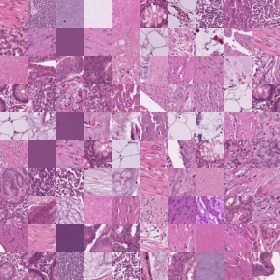

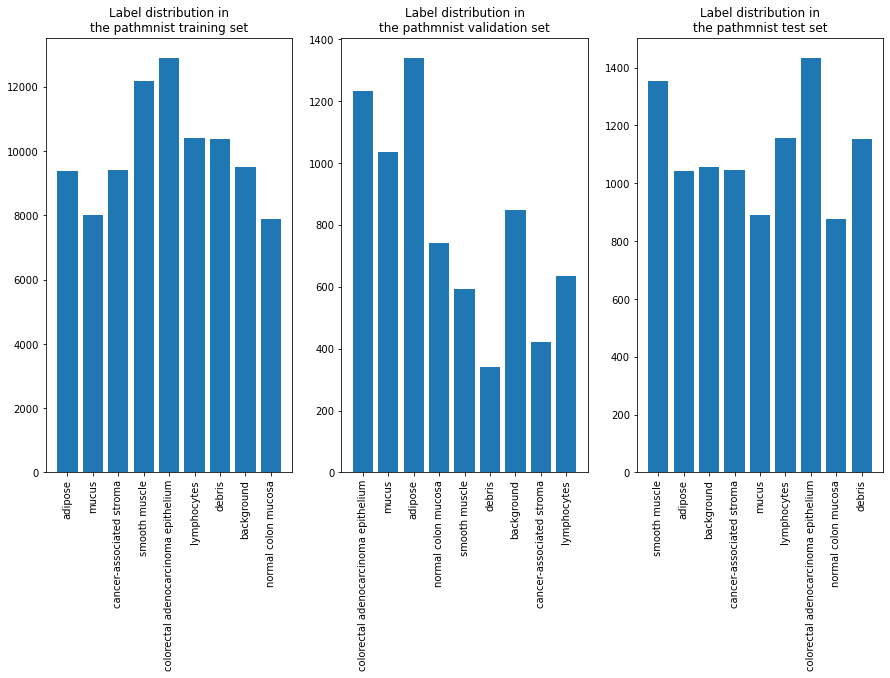

Using downloaded and verified file: /home/quentin/.medmnist/pathmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/pathmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/pathmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/pathmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/pathmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/pathmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/pathmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/pathmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/pathmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/pathmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/pathmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/pathmnist.npz


In [4]:
pathmnist_noWRS_noGDA = import_dataset(
    "pathmnist", info_flags, print_visualization=True
)
pathmnist_noGDA = import_dataset(
    "pathmnist", info_flags, sampler=True
)
pathmnist_noWSR_GDA = import_dataset(
    "pathmnist", info_flags, geometric_augment=3
)
pathmnist_WSR_GDA = import_dataset(
    "pathmnist", info_flags, sampler=True, geometric_augment=3
)
# To be used for the GAN training
pathmnist_noWRS_noGDA_upscaled = import_dataset(
    "pathmnist", info_flags, upscale=True
)

Using downloaded and verified file: /home/quentin/.medmnist/dermamnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/dermamnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/dermamnist.npz
Montage of randomly extracted images from the dataset:


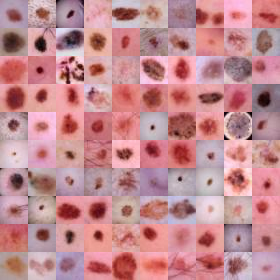

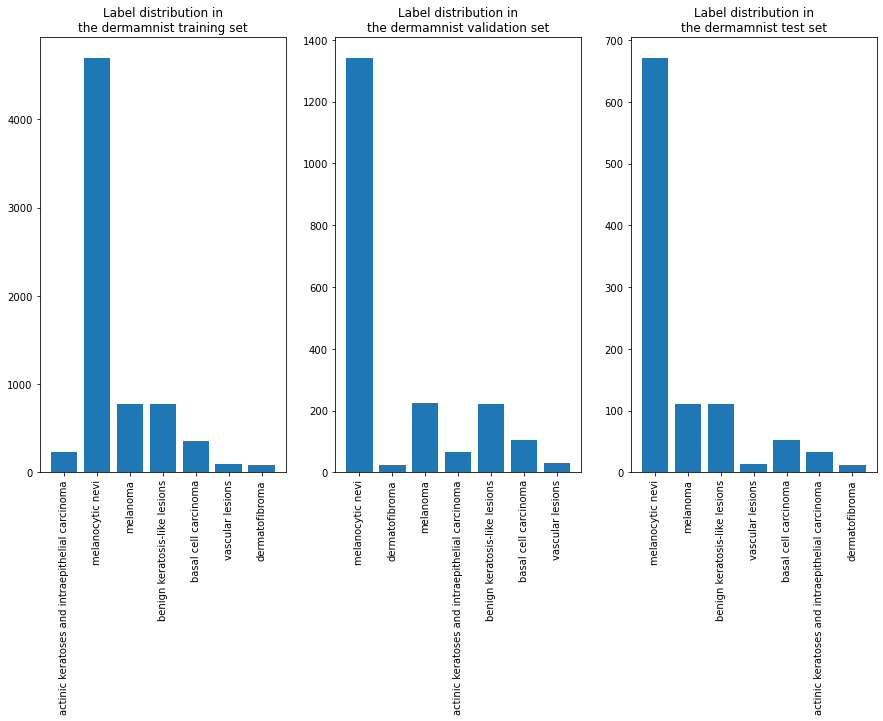

Using downloaded and verified file: /home/quentin/.medmnist/dermamnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/dermamnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/dermamnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/dermamnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/dermamnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/dermamnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/dermamnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/dermamnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/dermamnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/dermamnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/dermamnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/dermamnist.npz


In [5]:
dermamnist_noWRS_noGDA = import_dataset(
    "dermamnist", info_flags, print_visualization=True
)
dermamnist_noGDA = import_dataset(
    "dermamnist", info_flags, sampler=True
)
dermamnist_noWSR_GDA = import_dataset(
    "dermamnist", info_flags, geometric_augment=3
)
dermamnist_WSR_GDA = import_dataset(
    "dermamnist", info_flags, sampler=True, geometric_augment=3
)
# To be used for the GAN training
dermamnist_noWRS_noGDA_upscaled = import_dataset(
    "dermamnist", info_flags, sampler=True, upscale=True
)

Using downloaded and verified file: /home/quentin/.medmnist/octmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/octmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/octmnist.npz
Montage of randomly extracted images from the dataset:


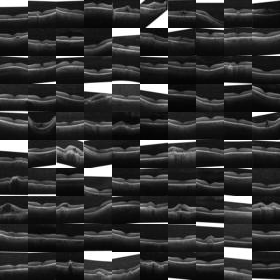

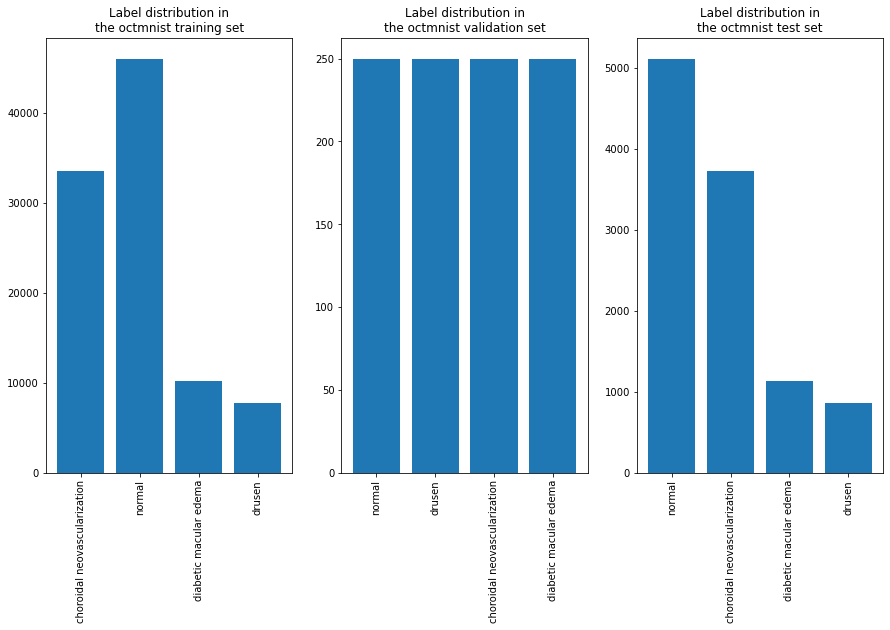

Using downloaded and verified file: /home/quentin/.medmnist/octmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/octmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/octmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/octmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/octmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/octmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/octmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/octmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/octmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/octmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/octmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/octmnist.npz


In [6]:
octmnist_noWRS_noGDA = import_dataset(
    "octmnist", info_flags, print_visualization=True
)
octmnist_noGDA = import_dataset(
    "octmnist", info_flags, sampler=True
)
octmnist_noWSR_GDA = import_dataset(
    "octmnist", info_flags, geometric_augment=2
)
octmnist_WSR_GDA = import_dataset(
    "octmnist", info_flags, sampler=True, geometric_augment=2
)
# To be used for the GAN training
octmnist_noWRS_noGDA_upscaled = import_dataset(
    "octmnist", info_flags, sampler=True, upscale=True
)

Using downloaded and verified file: /home/quentin/.medmnist/pneumoniamnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/pneumoniamnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/pneumoniamnist.npz
Montage of randomly extracted images from the dataset:


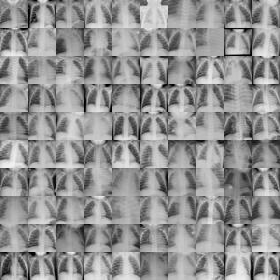

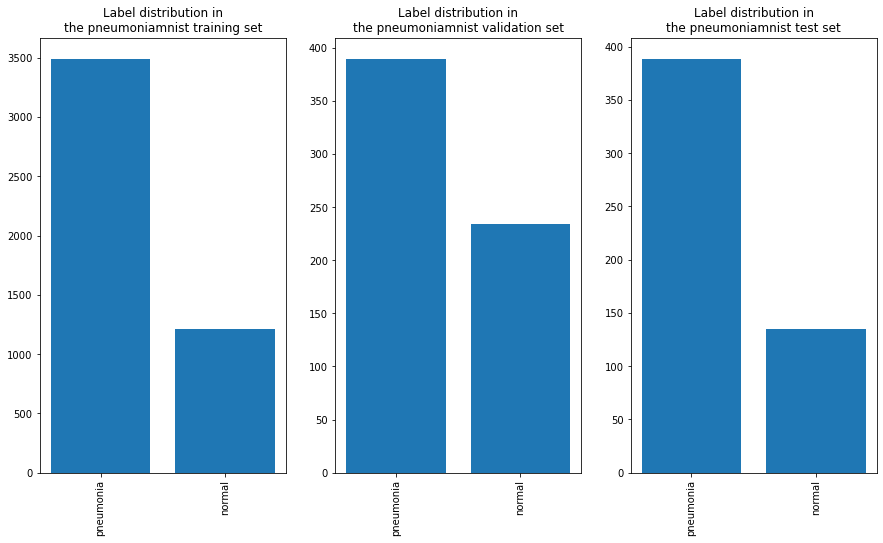

Using downloaded and verified file: /home/quentin/.medmnist/pneumoniamnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/pneumoniamnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/pneumoniamnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/pneumoniamnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/pneumoniamnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/pneumoniamnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/pneumoniamnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/pneumoniamnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/pneumoniamnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/pneumoniamnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/pneumoniamnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/pneumoniamnist.npz


In [7]:
pneumoniamnist_noWRS_noGDA = import_dataset(
    "pneumoniamnist", info_flags, print_visualization=True
)
pneumoniamnist_noGDA = import_dataset(
    "pneumoniamnist", info_flags, sampler=True
)
pneumoniamnist_noWSR_GDA = import_dataset(
    "pneumoniamnist", info_flags, geometric_augment=2
)
pneumoniamnist_WSR_GDA = import_dataset(
    "pneumoniamnist", info_flags, sampler=True, geometric_augment=2
)
# To be used for the GAN training
pneumoniamnist_noWRS_noGDA_upscaled = import_dataset(
    "pneumoniamnist", info_flags, sampler=True, upscale=True
)

Using downloaded and verified file: /home/quentin/.medmnist/breastmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/breastmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/breastmnist.npz
Montage of randomly extracted images from the dataset:


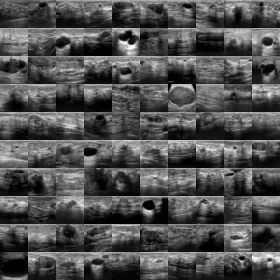

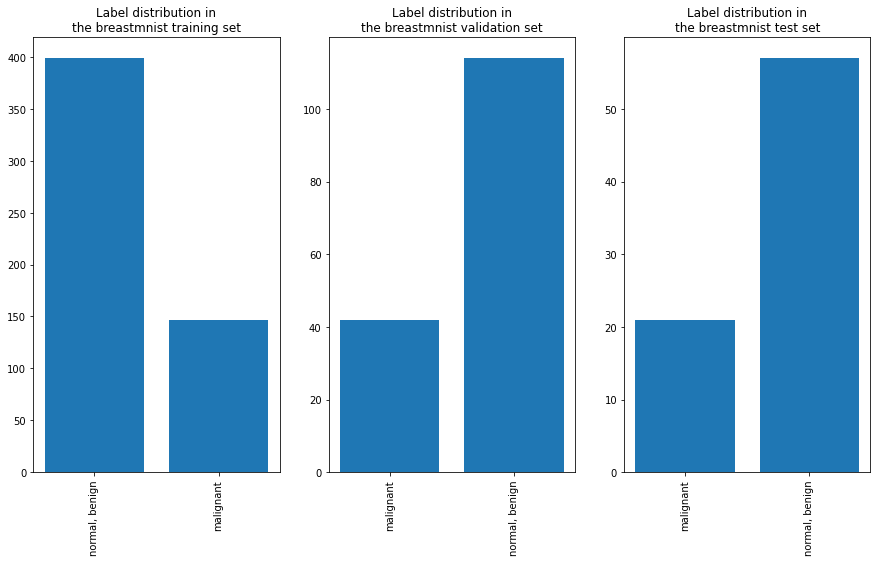

Using downloaded and verified file: /home/quentin/.medmnist/breastmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/breastmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/breastmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/breastmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/breastmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/breastmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/breastmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/breastmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/breastmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/breastmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/breastmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/breastmnist.npz


In [8]:
breastmnist_noWRS_noGDA = import_dataset(
    "breastmnist", info_flags, print_visualization=True
)
breastmnist_noGDA = import_dataset(
    "breastmnist", info_flags, sampler=True
)
breastmnist_noWSR_GDA = import_dataset(
    "breastmnist", info_flags, geometric_augment=2
)
breastmnist_WSR_GDA = import_dataset(
    "breastmnist", info_flags, sampler=True, geometric_augment=2
)
# To be used for the GAN training
breastmnist_noWRS_noGDA_upscaled = import_dataset(
    "breastmnist", info_flags, sampler=True, upscale=True
)

Using downloaded and verified file: /home/quentin/.medmnist/organamnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/organamnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/organamnist.npz
Montage of randomly extracted images from the dataset:


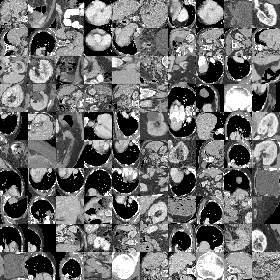

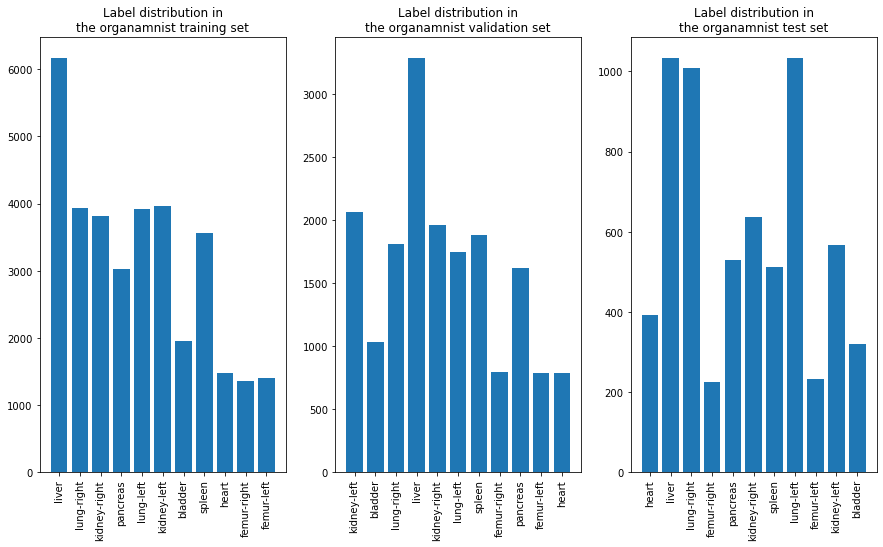

Using downloaded and verified file: /home/quentin/.medmnist/organamnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/organamnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/organamnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/organamnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/organamnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/organamnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/organamnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/organamnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/organamnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/organamnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/organamnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/organamnist.npz


In [9]:
organamnist_noWRS_noGDA = import_dataset(
    "organamnist", info_flags, print_visualization=True
)
organamnist_noGDA = import_dataset(
    "organamnist", info_flags, sampler=True
)
organamnist_noWSR_GDA = import_dataset(
    "organamnist", info_flags, geometric_augment=2
)
organamnist_WSR_GDA = import_dataset(
    "organamnist", info_flags, sampler=True, geometric_augment=2
)
# To be used for the GAN training
organamnist_noWRS_noGDA_upscaled = import_dataset(
    "organamnist", info_flags, sampler=True, upscale=True
)

Using downloaded and verified file: /home/quentin/.medmnist/organcmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/organcmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/organcmnist.npz
Montage of randomly extracted images from the dataset:


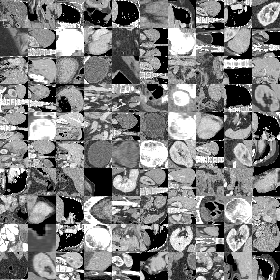

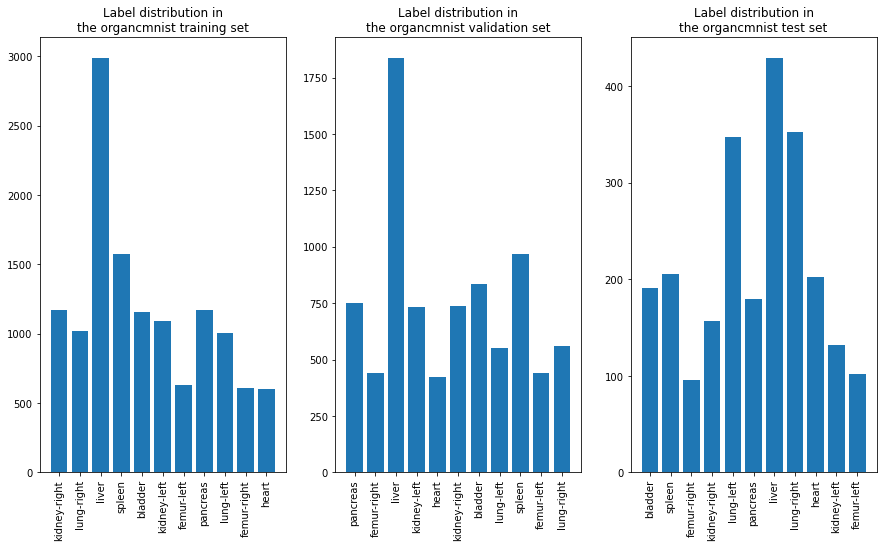

Using downloaded and verified file: /home/quentin/.medmnist/organcmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/organcmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/organcmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/organcmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/organcmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/organcmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/organcmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/organcmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/organcmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/organcmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/organcmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/organcmnist.npz


In [10]:
organcmnist_noWRS_noGDA = import_dataset(
    "organcmnist", info_flags, print_visualization=True
)
organcmnist_noGDA = import_dataset(
    "organcmnist", info_flags, sampler=True
)
organcmnist_noWSR_GDA = import_dataset(
    "organcmnist", info_flags, geometric_augment=2
)
organcmnist_WSR_GDA = import_dataset(
    "organcmnist", info_flags, sampler=True, geometric_augment=2
)
# To be used for the GAN training
organcmnist_noWRS_noGDA_upscaled = import_dataset(
    "organcmnist", info_flags, sampler=True, upscale=True
)

Using downloaded and verified file: /home/quentin/.medmnist/organsmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/organsmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/organsmnist.npz
Montage of randomly extracted images from the dataset:


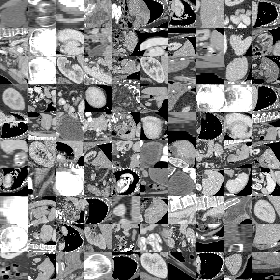

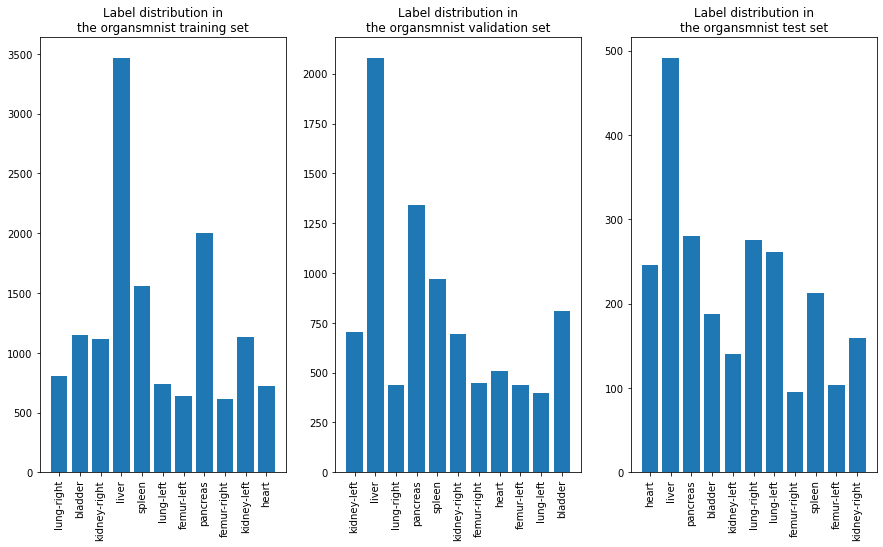

Using downloaded and verified file: /home/quentin/.medmnist/organsmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/organsmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/organsmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/organsmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/organsmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/organsmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/organsmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/organsmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/organsmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/organsmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/organsmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/organsmnist.npz


In [11]:
organsmnist_noWRS_noGDA = import_dataset(
    "organsmnist", info_flags, print_visualization=True
)
organsmnist_noGDA = import_dataset(
    "organsmnist", info_flags, sampler=True
)
organsmnist_noWSR_GDA = import_dataset(
    "organsmnist", info_flags, geometric_augment=2
)
organsmnist_WSR_GDA = import_dataset(
    "organsmnist", info_flags, sampler=True, geometric_augment=2
)
# To be used for the GAN training
organsmnist_noWRS_noGDA_upscaled = import_dataset(
    "organsmnist", info_flags, sampler=True, upscale=True
)

## 3. Training the MedMNIST baseline classifier on dataset without Deep Learning data augmentation

Relying on the MedMNIST baseline classifier available on their github and repurposed for this notebook, we will train it on three variants of the datasets as listed in the previous section:

- Without geometric data augmentation and without weighted random sampling (the data is simply shuffled)
- With weighted random sampling and without geometric data augmentation
- With both geometric data augmentation and weighted random sampling

### 3.1. Training on the MedMNIST datasets without GDA and WSR

In [12]:
# Declares the baseline setup to save the related model
DA_technique="_noWRS_noGDA"

#### PathMNIST

{
  "python_class": "PathMNIST",
  "description": "The PathMNIST is based on a prior study for predicting survival from colorectal cancer histology slides, providing a dataset (NCT-CRC-HE-100K) of 100,000 non-overlapping image patches from hematoxylin & eosin stained histological images, and a test dataset (CRC-VAL-HE-7K) of 7,180 image patches from a different clinical center. The dataset is comprised of 9 types of tissues, resulting in a multi-class classification task. We resize the source images of 3\u00d7224\u00d7224 into 3\u00d728\u00d728, and split NCT-CRC-HE-100K into training and validation set with a ratio of 9:1. The CRC-VAL-HE-7K is treated as the test set.",
  "url": "https://zenodo.org/record/5208230/files/pathmnist.npz?download=1",
  "MD5": "a8b06965200029087d5bd730944a56c1",
  "task": "multi-class",
  "label": {
    "0": "adipose",
    "1": "background",
    "2": "debris",
    "3": "lymphocytes",
    "4": "mucus",
    "5": "smooth muscle",
    "6": "normal colon mucosa"

100%|█████████████████████████████████████████| 704/704 [00:19<00:00, 35.87it/s]


train -- accuracy: 0.61
val -- accuracy: 0.96,  AUC: 0.64
Epoch 1



100%|█████████████████████████████████████████| 704/704 [00:19<00:00, 36.92it/s]


train -- accuracy: 0.8
val -- accuracy: 0.98,  AUC: 0.82
Epoch 2



100%|█████████████████████████████████████████| 704/704 [00:19<00:00, 36.47it/s]


train -- accuracy: 0.85
val -- accuracy: 0.98,  AUC: 0.83
Epoch 3



100%|█████████████████████████████████████████| 704/704 [00:19<00:00, 36.72it/s]


train -- accuracy: 0.88
val -- accuracy: 0.98,  AUC: 0.78
Epoch 4



100%|█████████████████████████████████████████| 704/704 [00:19<00:00, 36.48it/s]


train -- accuracy: 0.89
val -- accuracy: 0.99,  AUC: 0.89
Epoch 5



100%|█████████████████████████████████████████| 704/704 [00:19<00:00, 36.53it/s]


train -- accuracy: 0.91
val -- accuracy: 0.99,  AUC: 0.87
Epoch 6



100%|█████████████████████████████████████████| 704/704 [00:19<00:00, 36.36it/s]


train -- accuracy: 0.92
val -- accuracy: 0.98,  AUC: 0.8
Epoch 7



100%|█████████████████████████████████████████| 704/704 [00:19<00:00, 36.62it/s]


train -- accuracy: 0.92
val -- accuracy: 0.99,  AUC: 0.91
Epoch 8



100%|█████████████████████████████████████████| 704/704 [00:19<00:00, 36.34it/s]


train -- accuracy: 0.93
val -- accuracy: 1.0,  AUC: 0.91
Epoch 9



100%|█████████████████████████████████████████| 704/704 [00:19<00:00, 36.68it/s]


train -- accuracy: 0.93
val -- accuracy: 0.99,  AUC: 0.84
Epoch 10



100%|█████████████████████████████████████████| 704/704 [00:19<00:00, 36.40it/s]


train -- accuracy: 0.94
val -- accuracy: 1.0,  AUC: 0.9
Epoch 11



100%|█████████████████████████████████████████| 704/704 [00:19<00:00, 36.62it/s]


train -- accuracy: 0.94
val -- accuracy: 0.99,  AUC: 0.86
Epoch 12



100%|█████████████████████████████████████████| 704/704 [00:19<00:00, 36.62it/s]


train -- accuracy: 0.95
val -- accuracy: 0.99,  AUC: 0.84
Epoch 13



100%|█████████████████████████████████████████| 704/704 [00:19<00:00, 36.59it/s]


train -- accuracy: 0.95
val -- accuracy: 1.0,  AUC: 0.93
Epoch 14



100%|█████████████████████████████████████████| 704/704 [00:19<00:00, 36.60it/s]


train -- accuracy: 0.95
val -- accuracy: 1.0,  AUC: 0.93
Epoch 15



100%|█████████████████████████████████████████| 704/704 [00:19<00:00, 36.38it/s]


train -- accuracy: 0.96
val -- accuracy: 1.0,  AUC: 0.91
Epoch 16



100%|█████████████████████████████████████████| 704/704 [00:19<00:00, 36.68it/s]


train -- accuracy: 0.96
val -- accuracy: 1.0,  AUC: 0.92
Epoch 17



100%|█████████████████████████████████████████| 704/704 [00:19<00:00, 36.39it/s]


train -- accuracy: 0.96
val -- accuracy: 1.0,  AUC: 0.93
Epoch 18



100%|█████████████████████████████████████████| 704/704 [00:19<00:00, 36.65it/s]


train -- accuracy: 0.97
val -- accuracy: 0.99,  AUC: 0.9
Epoch 19



100%|█████████████████████████████████████████| 704/704 [00:19<00:00, 36.53it/s]


train -- accuracy: 0.97
val -- accuracy: 1.0,  AUC: 0.93
test -- accuracy: 0.96,  AUC: 0.81


<Figure size 720x720 with 0 Axes>

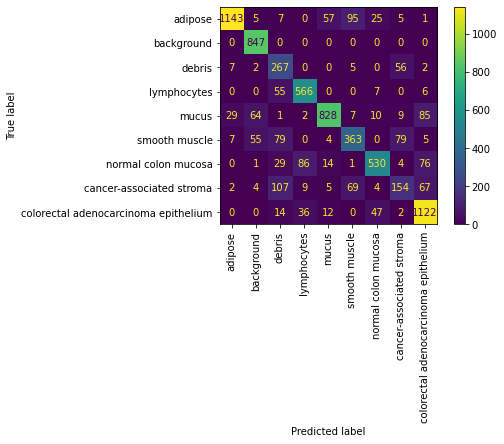

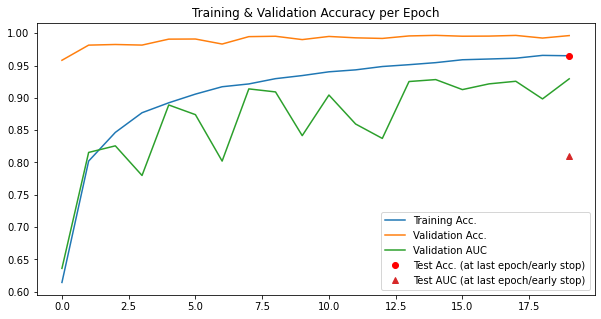

In [13]:
clf = run_classifier_pipeline(
    "pathmnist", info_flags, pathmnist_noWRS_noGDA,
    DA_technique=DA_technique
)

#### DermaMNIST

{
  "python_class": "DermaMNIST",
  "description": "The DermaMNIST is based on the HAM10000, a large collection of multi-source dermatoscopic images of common pigmented skin lesions. The dataset consists of 10,015 dermatoscopic images categorized as 7 different diseases, formulized as a multi-class classification task. We split the images into training, validation and test set with a ratio of 7:1:2. The source images of 3\u00d7600\u00d7450 are resized into 3\u00d728\u00d728.",
  "url": "https://zenodo.org/record/5208230/files/dermamnist.npz?download=1",
  "MD5": "0744692d530f8e62ec473284d019b0c7",
  "task": "multi-class",
  "label": {
    "0": "actinic keratoses and intraepithelial carcinoma",
    "1": "basal cell carcinoma",
    "2": "benign keratosis-like lesions",
    "3": "dermatofibroma",
    "4": "melanoma",
    "5": "melanocytic nevi",
    "6": "vascular lesions"
  },
  "n_channels": 3,
  "n_samples": {
    "train": 7007,
    "val": 1003,
    "test": 2005
  },
  "license": "CC B

100%|███████████████████████████████████████████| 55/55 [00:01<00:00, 36.71it/s]


train -- accuracy: 0.25
val -- accuracy: 0.79,  AUC: 0.27
Epoch 1



100%|███████████████████████████████████████████| 55/55 [00:01<00:00, 37.11it/s]


train -- accuracy: 0.4
val -- accuracy: 0.84,  AUC: 0.46
Epoch 2



100%|███████████████████████████████████████████| 55/55 [00:01<00:00, 36.89it/s]


train -- accuracy: 0.46
val -- accuracy: 0.85,  AUC: 0.49
Epoch 3



100%|███████████████████████████████████████████| 55/55 [00:01<00:00, 36.97it/s]


train -- accuracy: 0.49
val -- accuracy: 0.87,  AUC: 0.52
Epoch 4



100%|███████████████████████████████████████████| 55/55 [00:01<00:00, 36.92it/s]


train -- accuracy: 0.53
val -- accuracy: 0.88,  AUC: 0.52
Epoch 5



100%|███████████████████████████████████████████| 55/55 [00:01<00:00, 36.65it/s]


train -- accuracy: 0.56
val -- accuracy: 0.89,  AUC: 0.51
Epoch 6



100%|███████████████████████████████████████████| 55/55 [00:01<00:00, 36.69it/s]


train -- accuracy: 0.59
val -- accuracy: 0.89,  AUC: 0.52
Epoch 7



100%|███████████████████████████████████████████| 55/55 [00:01<00:00, 36.73it/s]


train -- accuracy: 0.63
val -- accuracy: 0.89,  AUC: 0.52
Epoch 8



100%|███████████████████████████████████████████| 55/55 [00:01<00:00, 36.62it/s]


train -- accuracy: 0.66
val -- accuracy: 0.89,  AUC: 0.61
Epoch 9



100%|███████████████████████████████████████████| 55/55 [00:01<00:00, 35.30it/s]


train -- accuracy: 0.69
val -- accuracy: 0.9,  AUC: 0.62
Epoch 10



100%|███████████████████████████████████████████| 55/55 [00:01<00:00, 36.63it/s]


train -- accuracy: 0.74
val -- accuracy: 0.89,  AUC: 0.55
Epoch 11



100%|███████████████████████████████████████████| 55/55 [00:01<00:00, 36.73it/s]


train -- accuracy: 0.75
val -- accuracy: 0.9,  AUC: 0.6
Epoch 12



100%|███████████████████████████████████████████| 55/55 [00:01<00:00, 36.85it/s]


train -- accuracy: 0.77
val -- accuracy: 0.9,  AUC: 0.63
Epoch 13



100%|███████████████████████████████████████████| 55/55 [00:01<00:00, 36.75it/s]


train -- accuracy: 0.8
val -- accuracy: 0.9,  AUC: 0.55
Epoch 14



100%|███████████████████████████████████████████| 55/55 [00:01<00:00, 36.45it/s]


train -- accuracy: 0.81
val -- accuracy: 0.9,  AUC: 0.58
Epoch 15



100%|███████████████████████████████████████████| 55/55 [00:01<00:00, 36.78it/s]


train -- accuracy: 0.83
val -- accuracy: 0.91,  AUC: 0.61
Epoch 16



100%|███████████████████████████████████████████| 55/55 [00:01<00:00, 36.88it/s]


train -- accuracy: 0.85
val -- accuracy: 0.9,  AUC: 0.6
Epoch 17



100%|███████████████████████████████████████████| 55/55 [00:01<00:00, 36.62it/s]


train -- accuracy: 0.86
val -- accuracy: 0.91,  AUC: 0.66
Epoch 18



100%|███████████████████████████████████████████| 55/55 [00:01<00:00, 36.76it/s]


train -- accuracy: 0.87
val -- accuracy: 0.91,  AUC: 0.63
Epoch 19



100%|███████████████████████████████████████████| 55/55 [00:01<00:00, 36.53it/s]


train -- accuracy: 0.88
val -- accuracy: 0.91,  AUC: 0.71
test -- accuracy: 0.91,  AUC: 0.7


<Figure size 720x720 with 0 Axes>

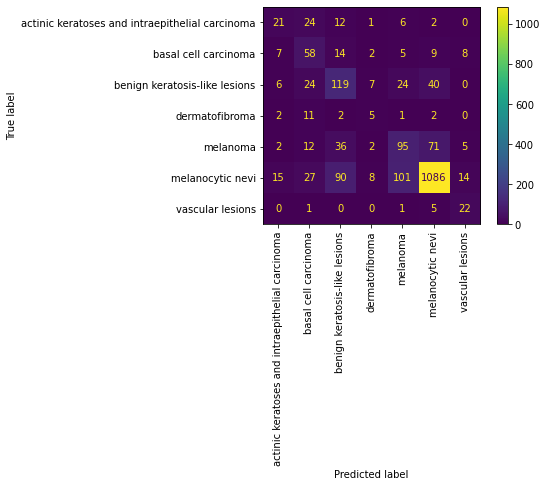

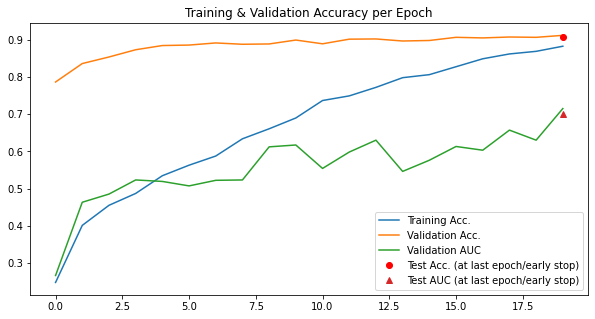

In [14]:
clf = run_classifier_pipeline(
    "dermamnist", info_flags, dermamnist_noWRS_noGDA,
    DA_technique=DA_technique
)

#### OctMNIST

{
  "python_class": "OCTMNIST",
  "description": "The OCTMNIST is based on a prior dataset of 109,309 valid optical coherence tomography (OCT) images for retinal diseases. The dataset is comprised of 4 diagnosis categories, leading to a multi-class classification task. We split the source training set with a ratio of 9:1 into training and validation set, and use its source validation set as the test set. The source images are gray-scale, and their sizes are (384\u22121,536)\u00d7(277\u2212512). We center-crop the images and resize them into 1\u00d728\u00d728.",
  "url": "https://zenodo.org/record/5208230/files/octmnist.npz?download=1",
  "MD5": "c68d92d5b585d8d81f7112f81e2d0842",
  "task": "multi-class",
  "label": {
    "0": "choroidal neovascularization",
    "1": "diabetic macular edema",
    "2": "drusen",
    "3": "normal"
  },
  "n_channels": 1,
  "n_samples": {
    "train": 97477,
    "val": 10832,
    "test": 1000
  },
  "license": "CC BY 4.0"
}
--------------------------------

100%|█████████████████████████████████████████| 762/762 [00:18<00:00, 40.65it/s]


train -- accuracy: 0.63
val -- accuracy: 0.93,  AUC: 0.76
Epoch 1



100%|█████████████████████████████████████████| 762/762 [00:18<00:00, 40.78it/s]


train -- accuracy: 0.78
val -- accuracy: 0.94,  AUC: 0.81
Epoch 2



100%|█████████████████████████████████████████| 762/762 [00:18<00:00, 40.62it/s]


train -- accuracy: 0.82
val -- accuracy: 0.96,  AUC: 0.84
Epoch 3



100%|█████████████████████████████████████████| 762/762 [00:18<00:00, 40.84it/s]


train -- accuracy: 0.85
val -- accuracy: 0.96,  AUC: 0.75
Epoch 4



100%|█████████████████████████████████████████| 762/762 [00:18<00:00, 40.73it/s]


train -- accuracy: 0.87
val -- accuracy: 0.97,  AUC: 0.85
Epoch 5



100%|█████████████████████████████████████████| 762/762 [00:18<00:00, 40.89it/s]


train -- accuracy: 0.89
val -- accuracy: 0.96,  AUC: 0.82
Epoch 6



100%|█████████████████████████████████████████| 762/762 [00:18<00:00, 40.51it/s]


train -- accuracy: 0.9
val -- accuracy: 0.97,  AUC: 0.88
Epoch 7



100%|█████████████████████████████████████████| 762/762 [00:19<00:00, 39.55it/s]


train -- accuracy: 0.92
val -- accuracy: 0.96,  AUC: 0.84
Epoch 8



100%|█████████████████████████████████████████| 762/762 [00:19<00:00, 39.06it/s]


train -- accuracy: 0.93
val -- accuracy: 0.96,  AUC: 0.79
Epoch 9



100%|█████████████████████████████████████████| 762/762 [00:19<00:00, 38.88it/s]


train -- accuracy: 0.93
val -- accuracy: 0.96,  AUC: 0.86
Epoch 10



100%|█████████████████████████████████████████| 762/762 [00:19<00:00, 39.82it/s]


train -- accuracy: 0.94
val -- accuracy: 0.97,  AUC: 0.84
Epoch 11



100%|█████████████████████████████████████████| 762/762 [00:19<00:00, 39.97it/s]


train -- accuracy: 0.95
val -- accuracy: 0.97,  AUC: 0.89
Epoch 12



100%|█████████████████████████████████████████| 762/762 [00:19<00:00, 39.72it/s]


train -- accuracy: 0.95
val -- accuracy: 0.97,  AUC: 0.9
Epoch 13



100%|█████████████████████████████████████████| 762/762 [00:19<00:00, 39.92it/s]


train -- accuracy: 0.96
val -- accuracy: 0.97,  AUC: 0.88
Epoch 14



100%|█████████████████████████████████████████| 762/762 [00:19<00:00, 39.74it/s]


train -- accuracy: 0.96
val -- accuracy: 0.97,  AUC: 0.91
Epoch 15



100%|█████████████████████████████████████████| 762/762 [00:19<00:00, 39.09it/s]


train -- accuracy: 0.96
val -- accuracy: 0.97,  AUC: 0.9
Epoch 16



100%|█████████████████████████████████████████| 762/762 [00:19<00:00, 39.67it/s]


train -- accuracy: 0.97
val -- accuracy: 0.97,  AUC: 0.89
Epoch 17



100%|█████████████████████████████████████████| 762/762 [00:19<00:00, 39.95it/s]


train -- accuracy: 0.97
val -- accuracy: 0.97,  AUC: 0.9
Epoch 18



100%|█████████████████████████████████████████| 762/762 [00:19<00:00, 39.84it/s]


train -- accuracy: 0.97
val -- accuracy: 0.97,  AUC: 0.88
Epoch 19



100%|█████████████████████████████████████████| 762/762 [00:19<00:00, 39.92it/s]


train -- accuracy: 0.98
val -- accuracy: 0.97,  AUC: 0.9
test -- accuracy: 0.93,  AUC: 0.74


<Figure size 720x720 with 0 Axes>

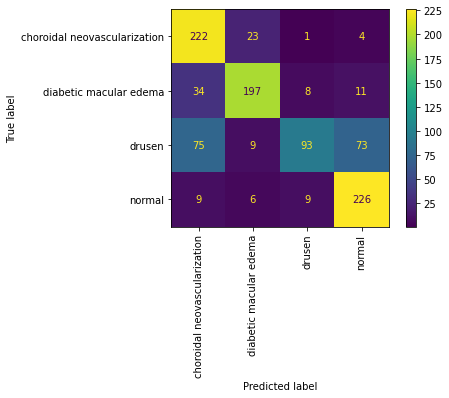

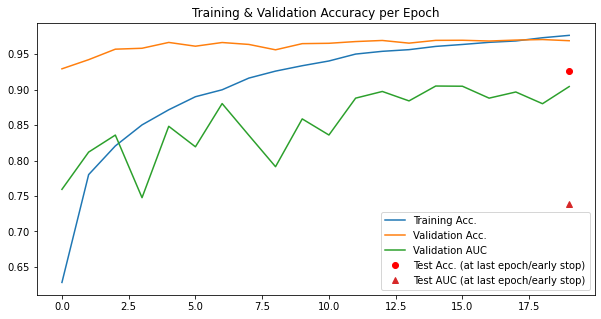

In [15]:
clf = run_classifier_pipeline(
    "octmnist", info_flags, octmnist_noWRS_noGDA,
    DA_technique=DA_technique
)

#### PneumoniaMNIST

{
  "python_class": "PneumoniaMNIST",
  "description": "The PneumoniaMNIST is based on a prior dataset of 5,856 pediatric chest X-Ray images. The task is binary-class classification of pneumonia against normal. We split the source training set with a ratio of 9:1 into training and validation set and use its source validation set as the test set. The source images are gray-scale, and their sizes are (384\u22122,916)\u00d7(127\u22122,713). We center-crop the images and resize them into 1\u00d728\u00d728.",
  "url": "https://zenodo.org/record/5208230/files/pneumoniamnist.npz?download=1",
  "MD5": "28209eda62fecd6e6a2d98b1501bb15f",
  "task": "binary-class",
  "label": {
    "0": "normal",
    "1": "pneumonia"
  },
  "n_channels": 1,
  "n_samples": {
    "train": 4708,
    "val": 524,
    "test": 624
  },
  "license": "CC BY 4.0"
}
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           

100%|███████████████████████████████████████████| 37/37 [00:00<00:00, 39.82it/s]


train -- accuracy: 0.69
val -- accuracy: 0.91,  AUC: 0.84
Epoch 1



100%|███████████████████████████████████████████| 37/37 [00:00<00:00, 39.91it/s]


train -- accuracy: 0.91
val -- accuracy: 0.97,  AUC: 0.93
Epoch 2



100%|███████████████████████████████████████████| 37/37 [00:00<00:00, 39.85it/s]


train -- accuracy: 0.94
val -- accuracy: 0.98,  AUC: 0.94
Epoch 3



100%|███████████████████████████████████████████| 37/37 [00:00<00:00, 39.96it/s]


train -- accuracy: 0.95
val -- accuracy: 0.99,  AUC: 0.95
Epoch 4



100%|███████████████████████████████████████████| 37/37 [00:00<00:00, 39.88it/s]


train -- accuracy: 0.95
val -- accuracy: 0.99,  AUC: 0.96
Epoch 5



100%|███████████████████████████████████████████| 37/37 [00:00<00:00, 40.07it/s]


train -- accuracy: 0.96
val -- accuracy: 0.99,  AUC: 0.96
Epoch 6



100%|███████████████████████████████████████████| 37/37 [00:00<00:00, 40.28it/s]


train -- accuracy: 0.97
val -- accuracy: 0.99,  AUC: 0.95
Epoch 7



100%|███████████████████████████████████████████| 37/37 [00:00<00:00, 39.77it/s]


train -- accuracy: 0.97
val -- accuracy: 1.0,  AUC: 0.95
Epoch 8



100%|███████████████████████████████████████████| 37/37 [00:00<00:00, 40.11it/s]


train -- accuracy: 0.97
val -- accuracy: 1.0,  AUC: 0.96
Epoch 9



100%|███████████████████████████████████████████| 37/37 [00:00<00:00, 40.01it/s]


train -- accuracy: 0.97
val -- accuracy: 1.0,  AUC: 0.97
Epoch 10



100%|███████████████████████████████████████████| 37/37 [00:00<00:00, 40.24it/s]


train -- accuracy: 0.98
val -- accuracy: 1.0,  AUC: 0.97
Epoch 11



100%|███████████████████████████████████████████| 37/37 [00:00<00:00, 40.08it/s]


train -- accuracy: 0.99
val -- accuracy: 1.0,  AUC: 0.97
Epoch 12



100%|███████████████████████████████████████████| 37/37 [00:00<00:00, 39.96it/s]


train -- accuracy: 0.99
val -- accuracy: 1.0,  AUC: 0.98
Epoch 13



100%|███████████████████████████████████████████| 37/37 [00:00<00:00, 40.20it/s]


train -- accuracy: 0.99
val -- accuracy: 1.0,  AUC: 0.98
Epoch 14



100%|███████████████████████████████████████████| 37/37 [00:00<00:00, 40.26it/s]


train -- accuracy: 0.99
val -- accuracy: 1.0,  AUC: 0.97
Epoch 15



100%|███████████████████████████████████████████| 37/37 [00:00<00:00, 40.06it/s]


train -- accuracy: 0.99
val -- accuracy: 1.0,  AUC: 0.97
Epoch 16



100%|███████████████████████████████████████████| 37/37 [00:00<00:00, 39.90it/s]


train -- accuracy: 0.99
val -- accuracy: 1.0,  AUC: 0.98
Epoch 17



100%|███████████████████████████████████████████| 37/37 [00:00<00:00, 40.13it/s]


train -- accuracy: 0.99
val -- accuracy: 1.0,  AUC: 0.98
Epoch 18



100%|███████████████████████████████████████████| 37/37 [00:00<00:00, 40.30it/s]


train -- accuracy: 0.99
val -- accuracy: 1.0,  AUC: 0.97
Epoch 19



100%|███████████████████████████████████████████| 37/37 [00:00<00:00, 39.84it/s]


train -- accuracy: 1.0
val -- accuracy: 1.0,  AUC: 0.97
test -- accuracy: 0.97,  AUC: 0.85


<Figure size 720x720 with 0 Axes>

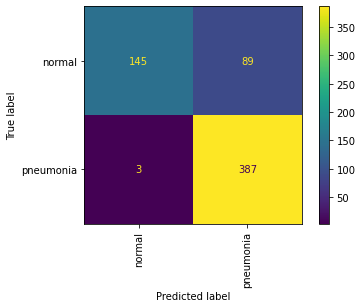

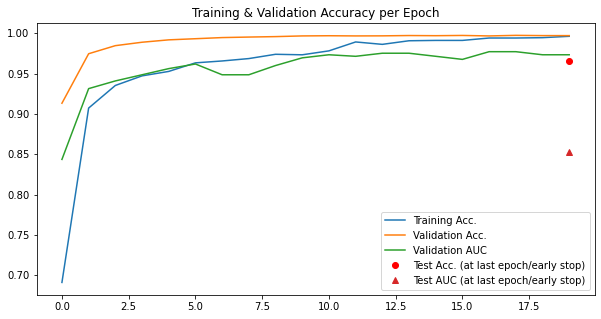

In [16]:
clf = run_classifier_pipeline(
    "pneumoniamnist", info_flags, pneumoniamnist_noWRS_noGDA,
    DA_technique=DA_technique
)

#### BreastMNIST

{
  "python_class": "BreastMNIST",
  "description": "The BreastMNIST is based on a dataset of 780 breast ultrasound images. It is categorized into 3 classes: normal, benign, and malignant. As we use low-resolution images, we simplify the task into binary classification by combining normal and benign as positive and classifying them against malignant as negative. We split the source dataset with a ratio of 7:1:2 into training, validation and test set. The source images of 1\u00d7500\u00d7500 are resized into 1\u00d728\u00d728.",
  "url": "https://zenodo.org/record/5208230/files/breastmnist.npz?download=1",
  "MD5": "750601b1f35ba3300ea97c75c52ff8f6",
  "task": "binary-class",
  "label": {
    "0": "malignant",
    "1": "normal, benign"
  },
  "n_channels": 1,
  "n_samples": {
    "train": 546,
    "val": 78,
    "test": 156
  },
  "license": "CC BY 4.0"
}
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
    

100%|█████████████████████████████████████████████| 5/5 [00:00<00:00, 44.90it/s]


train -- accuracy: 0.52
val -- accuracy: 0.46,  AUC: 0.73
Epoch 1



100%|█████████████████████████████████████████████| 5/5 [00:00<00:00, 44.50it/s]


train -- accuracy: 0.52
val -- accuracy: 0.58,  AUC: 0.73
Epoch 2



100%|█████████████████████████████████████████████| 5/5 [00:00<00:00, 45.05it/s]


train -- accuracy: 0.52
val -- accuracy: 0.65,  AUC: 0.73
Epoch 3



100%|█████████████████████████████████████████████| 5/5 [00:00<00:00, 44.18it/s]


train -- accuracy: 0.51
val -- accuracy: 0.66,  AUC: 0.73
Epoch 4



100%|█████████████████████████████████████████████| 5/5 [00:00<00:00, 44.43it/s]


train -- accuracy: 0.56
val -- accuracy: 0.66,  AUC: 0.73
Epoch 5



100%|█████████████████████████████████████████████| 5/5 [00:00<00:00, 45.67it/s]


train -- accuracy: 0.58
val -- accuracy: 0.7,  AUC: 0.72
Epoch 6



100%|█████████████████████████████████████████████| 5/5 [00:00<00:00, 43.94it/s]


train -- accuracy: 0.59
val -- accuracy: 0.71,  AUC: 0.74
Epoch 7



100%|█████████████████████████████████████████████| 5/5 [00:00<00:00, 44.85it/s]


train -- accuracy: 0.64
val -- accuracy: 0.73,  AUC: 0.78
Epoch 8



100%|█████████████████████████████████████████████| 5/5 [00:00<00:00, 44.17it/s]


train -- accuracy: 0.73
val -- accuracy: 0.74,  AUC: 0.71
Epoch 9



100%|█████████████████████████████████████████████| 5/5 [00:00<00:00, 44.06it/s]


train -- accuracy: 0.72
val -- accuracy: 0.74,  AUC: 0.71
Epoch 10



100%|█████████████████████████████████████████████| 5/5 [00:00<00:00, 44.71it/s]


train -- accuracy: 0.7
val -- accuracy: 0.75,  AUC: 0.72
Epoch 11



100%|█████████████████████████████████████████████| 5/5 [00:00<00:00, 44.69it/s]


train -- accuracy: 0.69
val -- accuracy: 0.75,  AUC: 0.72
Epoch 12



100%|█████████████████████████████████████████████| 5/5 [00:00<00:00, 44.01it/s]


train -- accuracy: 0.75
val -- accuracy: 0.75,  AUC: 0.74
Epoch 13



100%|█████████████████████████████████████████████| 5/5 [00:00<00:00, 44.50it/s]


train -- accuracy: 0.74
val -- accuracy: 0.76,  AUC: 0.73
Epoch 14



100%|█████████████████████████████████████████████| 5/5 [00:00<00:00, 44.40it/s]


train -- accuracy: 0.74
val -- accuracy: 0.76,  AUC: 0.72
Epoch 15



100%|█████████████████████████████████████████████| 5/5 [00:00<00:00, 46.03it/s]


train -- accuracy: 0.73
val -- accuracy: 0.76,  AUC: 0.73
Epoch 16



100%|█████████████████████████████████████████████| 5/5 [00:00<00:00, 43.74it/s]


train -- accuracy: 0.72
val -- accuracy: 0.77,  AUC: 0.73
Epoch 17



100%|█████████████████████████████████████████████| 5/5 [00:00<00:00, 45.01it/s]


train -- accuracy: 0.77
val -- accuracy: 0.77,  AUC: 0.73
Epoch 18



100%|█████████████████████████████████████████████| 5/5 [00:00<00:00, 44.77it/s]


train -- accuracy: 0.74
val -- accuracy: 0.78,  AUC: 0.73
Epoch 19



100%|█████████████████████████████████████████████| 5/5 [00:00<00:00, 44.50it/s]


train -- accuracy: 0.72
val -- accuracy: 0.79,  AUC: 0.74
test -- accuracy: 0.77,  AUC: 0.74


<Figure size 720x720 with 0 Axes>

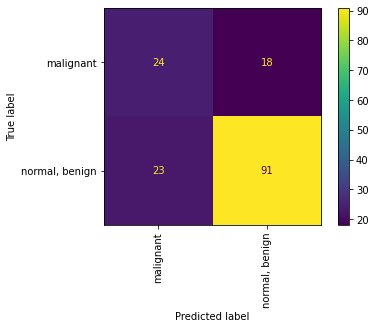

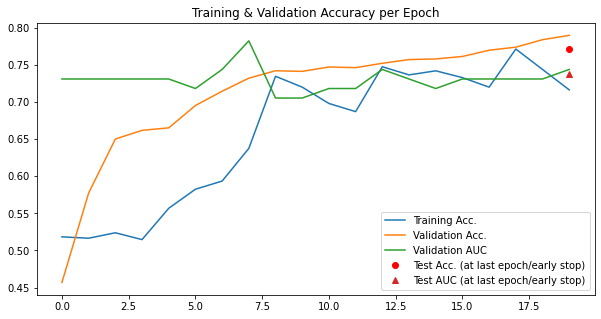

In [17]:
clf= run_classifier_pipeline(
    "breastmnist", info_flags, breastmnist_noWRS_noGDA,
    DA_technique=DA_technique
)

#### OrganAMNIST

{
  "python_class": "OrganAMNIST",
  "description": "The OrganAMNIST is based on 3D computed tomography (CT) images from Liver Tumor Segmentation Benchmark (LiTS). It is renamed from OrganMNIST_Axial (in MedMNIST v1) for simplicity. We use bounding-box annotations of 11 body organs from another study to obtain the organ labels. Hounsfield-Unit (HU) of the 3D images are transformed into gray-scale with an abdominal window. We crop 2D images from the center slices of the 3D bounding boxes in axial views (planes). The images are resized into 1\u00d728\u00d728 to perform multi-class classification of 11 body organs. 115 and 16 CT scans from the source training set are used as training and validation set, respectively. The 70 CT scans from the source test set are treated as the test set.",
  "url": "https://zenodo.org/record/5208230/files/organamnist.npz?download=1",
  "MD5": "866b832ed4eeba67bfb9edee1d5544e6",
  "task": "multi-class",
  "label": {
    "0": "bladder",
    "1": "femur-left",

100%|█████████████████████████████████████████| 271/271 [00:06<00:00, 39.54it/s]


train -- accuracy: 0.49
val -- accuracy: 0.97,  AUC: 0.78
Epoch 1



100%|█████████████████████████████████████████| 271/271 [00:06<00:00, 40.08it/s]


train -- accuracy: 0.79
val -- accuracy: 0.99,  AUC: 0.9
Epoch 2



100%|█████████████████████████████████████████| 271/271 [00:06<00:00, 39.95it/s]


train -- accuracy: 0.87
val -- accuracy: 1.0,  AUC: 0.94
Epoch 3



100%|█████████████████████████████████████████| 271/271 [00:06<00:00, 39.97it/s]


train -- accuracy: 0.91
val -- accuracy: 1.0,  AUC: 0.95
Epoch 4



100%|█████████████████████████████████████████| 271/271 [00:06<00:00, 39.49it/s]


train -- accuracy: 0.93
val -- accuracy: 1.0,  AUC: 0.95
Epoch 5



100%|█████████████████████████████████████████| 271/271 [00:06<00:00, 39.29it/s]


train -- accuracy: 0.95
val -- accuracy: 1.0,  AUC: 0.95
Epoch 6



100%|█████████████████████████████████████████| 271/271 [00:06<00:00, 39.40it/s]


train -- accuracy: 0.96
val -- accuracy: 1.0,  AUC: 0.95
Epoch 7



100%|█████████████████████████████████████████| 271/271 [00:06<00:00, 39.14it/s]


train -- accuracy: 0.97
val -- accuracy: 1.0,  AUC: 0.96
Epoch 8



100%|█████████████████████████████████████████| 271/271 [00:06<00:00, 39.32it/s]


train -- accuracy: 0.98
val -- accuracy: 1.0,  AUC: 0.95
Epoch 9



100%|█████████████████████████████████████████| 271/271 [00:06<00:00, 40.13it/s]


train -- accuracy: 0.98
val -- accuracy: 1.0,  AUC: 0.96
Epoch 10



100%|█████████████████████████████████████████| 271/271 [00:06<00:00, 39.23it/s]


train -- accuracy: 0.98
val -- accuracy: 1.0,  AUC: 0.96
Epoch 11



100%|█████████████████████████████████████████| 271/271 [00:07<00:00, 38.58it/s]


train -- accuracy: 0.99
val -- accuracy: 1.0,  AUC: 0.96
Epoch 12



100%|█████████████████████████████████████████| 271/271 [00:06<00:00, 39.63it/s]


train -- accuracy: 0.99
val -- accuracy: 1.0,  AUC: 0.95
Epoch 13



100%|█████████████████████████████████████████| 271/271 [00:06<00:00, 39.42it/s]


train -- accuracy: 0.99
val -- accuracy: 1.0,  AUC: 0.96
Epoch 14



100%|█████████████████████████████████████████| 271/271 [00:06<00:00, 39.93it/s]


train -- accuracy: 0.99
val -- accuracy: 1.0,  AUC: 0.96
Epoch 15



100%|█████████████████████████████████████████| 271/271 [00:06<00:00, 39.58it/s]


train -- accuracy: 0.99
val -- accuracy: 1.0,  AUC: 0.96
Epoch 16



100%|█████████████████████████████████████████| 271/271 [00:06<00:00, 40.06it/s]


train -- accuracy: 0.99
val -- accuracy: 1.0,  AUC: 0.96
Epoch 17



100%|█████████████████████████████████████████| 271/271 [00:06<00:00, 38.86it/s]


train -- accuracy: 0.99
val -- accuracy: 1.0,  AUC: 0.96
Epoch 18



100%|█████████████████████████████████████████| 271/271 [00:06<00:00, 39.52it/s]


train -- accuracy: 0.99
val -- accuracy: 1.0,  AUC: 0.96
Epoch 19



100%|█████████████████████████████████████████| 271/271 [00:07<00:00, 38.47it/s]


train -- accuracy: 1.0
val -- accuracy: 1.0,  AUC: 0.96
test -- accuracy: 0.99,  AUC: 0.88


<Figure size 720x720 with 0 Axes>

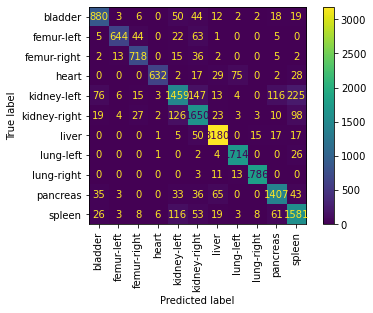

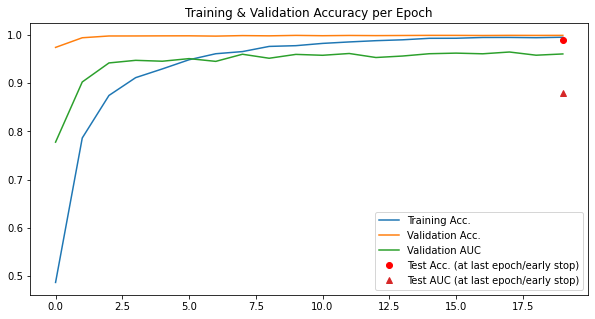

In [18]:
clf = run_classifier_pipeline(
    "organamnist", info_flags, organamnist_noWRS_noGDA,
    DA_technique=DA_technique
)

#### OrganCMNIST

{
  "python_class": "OrganCMNIST",
  "description": "The OrganCMNIST is based on 3D computed tomography (CT) images from Liver Tumor Segmentation Benchmark (LiTS). It is renamed from OrganMNIST_Coronal (in MedMNIST v1) for simplicity. We use bounding-box annotations of 11 body organs from another study to obtain the organ labels. Hounsfield-Unit (HU) of the 3D images are transformed into gray-scale with an abdominal window. We crop 2D images from the center slices of the 3D bounding boxes in coronal views (planes). The images are resized into 1\u00d728\u00d728 to perform multi-class classification of 11 body organs. 115 and 16 CT scans from the source training set are used as training and validation set, respectively. The 70 CT scans from the source test set are treated as the test set.",
  "url": "https://zenodo.org/record/5208230/files/organcmnist.npz?download=1",
  "MD5": "0afa5834fb105f7705a7d93372119a21",
  "task": "multi-class",
  "label": {
    "0": "bladder",
    "1": "femur-le

100%|█████████████████████████████████████████| 102/102 [00:02<00:00, 38.91it/s]


train -- accuracy: 0.32
val -- accuracy: 0.91,  AUC: 0.59
Epoch 1



100%|█████████████████████████████████████████| 102/102 [00:02<00:00, 39.23it/s]


train -- accuracy: 0.52
val -- accuracy: 0.96,  AUC: 0.74
Epoch 2



100%|█████████████████████████████████████████| 102/102 [00:02<00:00, 39.81it/s]


train -- accuracy: 0.66
val -- accuracy: 0.98,  AUC: 0.81
Epoch 3



100%|█████████████████████████████████████████| 102/102 [00:02<00:00, 40.83it/s]


train -- accuracy: 0.75
val -- accuracy: 0.99,  AUC: 0.87
Epoch 4



100%|█████████████████████████████████████████| 102/102 [00:02<00:00, 40.66it/s]


train -- accuracy: 0.8
val -- accuracy: 0.99,  AUC: 0.89
Epoch 5



100%|█████████████████████████████████████████| 102/102 [00:02<00:00, 40.65it/s]


train -- accuracy: 0.83
val -- accuracy: 1.0,  AUC: 0.91
Epoch 6



100%|█████████████████████████████████████████| 102/102 [00:02<00:00, 40.61it/s]


train -- accuracy: 0.86
val -- accuracy: 1.0,  AUC: 0.93
Epoch 7



100%|█████████████████████████████████████████| 102/102 [00:02<00:00, 40.75it/s]


train -- accuracy: 0.88
val -- accuracy: 1.0,  AUC: 0.94
Epoch 8



100%|█████████████████████████████████████████| 102/102 [00:02<00:00, 40.59it/s]


train -- accuracy: 0.89
val -- accuracy: 1.0,  AUC: 0.93
Epoch 9



100%|█████████████████████████████████████████| 102/102 [00:02<00:00, 39.47it/s]


train -- accuracy: 0.9
val -- accuracy: 1.0,  AUC: 0.94
Epoch 10



100%|█████████████████████████████████████████| 102/102 [00:02<00:00, 40.49it/s]


train -- accuracy: 0.91
val -- accuracy: 1.0,  AUC: 0.93
Epoch 11



100%|█████████████████████████████████████████| 102/102 [00:02<00:00, 38.03it/s]


train -- accuracy: 0.92
val -- accuracy: 1.0,  AUC: 0.94
Epoch 12



100%|█████████████████████████████████████████| 102/102 [00:02<00:00, 40.05it/s]


train -- accuracy: 0.94
val -- accuracy: 1.0,  AUC: 0.95
Epoch 13



100%|█████████████████████████████████████████| 102/102 [00:02<00:00, 40.52it/s]


train -- accuracy: 0.94
val -- accuracy: 1.0,  AUC: 0.93
Epoch 14



100%|█████████████████████████████████████████| 102/102 [00:02<00:00, 40.41it/s]


train -- accuracy: 0.95
val -- accuracy: 1.0,  AUC: 0.94
Epoch 15



100%|█████████████████████████████████████████| 102/102 [00:02<00:00, 40.38it/s]


train -- accuracy: 0.95
val -- accuracy: 1.0,  AUC: 0.95
Epoch 16



100%|█████████████████████████████████████████| 102/102 [00:02<00:00, 40.46it/s]


train -- accuracy: 0.96
val -- accuracy: 1.0,  AUC: 0.95
Epoch 17



100%|█████████████████████████████████████████| 102/102 [00:02<00:00, 40.37it/s]


train -- accuracy: 0.96
val -- accuracy: 1.0,  AUC: 0.95
Epoch 18



100%|█████████████████████████████████████████| 102/102 [00:02<00:00, 40.38it/s]


train -- accuracy: 0.97
val -- accuracy: 1.0,  AUC: 0.94
Epoch 19



100%|█████████████████████████████████████████| 102/102 [00:02<00:00, 40.43it/s]


train -- accuracy: 0.97
val -- accuracy: 1.0,  AUC: 0.95
test -- accuracy: 0.99,  AUC: 0.86


<Figure size 720x720 with 0 Axes>

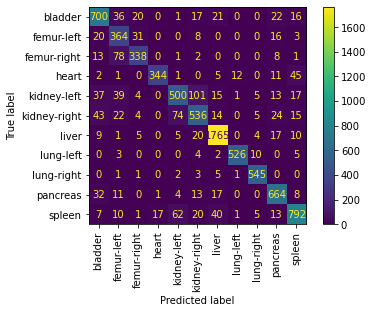

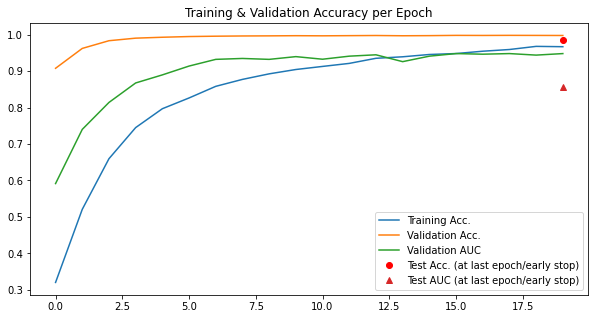

In [19]:
clf = run_classifier_pipeline(
    "organcmnist", info_flags, organcmnist_noWRS_noGDA,
    DA_technique=DA_technique
)

#### OrganSMNIST

{
  "python_class": "OrganSMNIST",
  "description": "The OrganSMNIST is based on 3D computed tomography (CT) images from Liver Tumor Segmentation Benchmark (LiTS). It is renamed from OrganMNIST_Sagittal (in MedMNIST v1) for simplicity. We use bounding-box annotations of 11 body organs from another study to obtain the organ labels. Hounsfield-Unit (HU) of the 3D images are transformed into gray-scale with an abdominal window. We crop 2D images from the center slices of the 3D bounding boxes in sagittal views (planes). The images are resized into 1\u00d728\u00d728 to perform multi-class classification of 11 body organs. 115 and 16 CT scans from the source training set are used as training and validation set, respectively. The 70 CT scans from the source test set are treated as the test set.",
  "url": "https://zenodo.org/record/5208230/files/organsmnist.npz?download=1",
  "MD5": "e5c39f1af030238290b9557d9503af9d",
  "task": "multi-class",
  "label": {
    "0": "bladder",
    "1": "femur-

100%|█████████████████████████████████████████| 109/109 [00:02<00:00, 40.44it/s]


train -- accuracy: 0.28
val -- accuracy: 0.88,  AUC: 0.43
Epoch 1



100%|█████████████████████████████████████████| 109/109 [00:02<00:00, 40.52it/s]


train -- accuracy: 0.39
val -- accuracy: 0.92,  AUC: 0.59
Epoch 2



100%|█████████████████████████████████████████| 109/109 [00:02<00:00, 39.84it/s]


train -- accuracy: 0.51
val -- accuracy: 0.96,  AUC: 0.67
Epoch 3



100%|█████████████████████████████████████████| 109/109 [00:02<00:00, 37.38it/s]


train -- accuracy: 0.6
val -- accuracy: 0.97,  AUC: 0.73
Epoch 4



100%|█████████████████████████████████████████| 109/109 [00:02<00:00, 39.04it/s]


train -- accuracy: 0.65
val -- accuracy: 0.98,  AUC: 0.77
Epoch 5



100%|█████████████████████████████████████████| 109/109 [00:02<00:00, 39.19it/s]


train -- accuracy: 0.69
val -- accuracy: 0.98,  AUC: 0.81
Epoch 6



100%|█████████████████████████████████████████| 109/109 [00:02<00:00, 38.54it/s]


train -- accuracy: 0.72
val -- accuracy: 0.98,  AUC: 0.81
Epoch 7



100%|█████████████████████████████████████████| 109/109 [00:02<00:00, 39.36it/s]


train -- accuracy: 0.74
val -- accuracy: 0.99,  AUC: 0.84
Epoch 8



100%|█████████████████████████████████████████| 109/109 [00:02<00:00, 39.66it/s]


train -- accuracy: 0.76
val -- accuracy: 0.99,  AUC: 0.83
Epoch 9



100%|█████████████████████████████████████████| 109/109 [00:02<00:00, 38.78it/s]


train -- accuracy: 0.77
val -- accuracy: 0.99,  AUC: 0.82
Epoch 10



100%|█████████████████████████████████████████| 109/109 [00:02<00:00, 40.10it/s]


train -- accuracy: 0.79
val -- accuracy: 0.99,  AUC: 0.83
Epoch 11



100%|█████████████████████████████████████████| 109/109 [00:02<00:00, 38.96it/s]


train -- accuracy: 0.8
val -- accuracy: 0.99,  AUC: 0.86
Epoch 12



100%|█████████████████████████████████████████| 109/109 [00:02<00:00, 38.33it/s]


train -- accuracy: 0.82
val -- accuracy: 0.99,  AUC: 0.83
Epoch 13



100%|█████████████████████████████████████████| 109/109 [00:02<00:00, 39.78it/s]


train -- accuracy: 0.83
val -- accuracy: 0.99,  AUC: 0.85
Epoch 14



100%|█████████████████████████████████████████| 109/109 [00:02<00:00, 39.76it/s]


train -- accuracy: 0.84
val -- accuracy: 0.99,  AUC: 0.86
Epoch 15



100%|█████████████████████████████████████████| 109/109 [00:02<00:00, 38.48it/s]


train -- accuracy: 0.85
val -- accuracy: 0.99,  AUC: 0.87
Epoch 16



100%|█████████████████████████████████████████| 109/109 [00:02<00:00, 39.83it/s]


train -- accuracy: 0.86
val -- accuracy: 0.99,  AUC: 0.84
Epoch 17



100%|█████████████████████████████████████████| 109/109 [00:02<00:00, 39.72it/s]


train -- accuracy: 0.86
val -- accuracy: 0.99,  AUC: 0.87
Epoch 18



100%|█████████████████████████████████████████| 109/109 [00:02<00:00, 39.67it/s]


train -- accuracy: 0.88
val -- accuracy: 0.99,  AUC: 0.85
Epoch 19



100%|█████████████████████████████████████████| 109/109 [00:02<00:00, 39.65it/s]


train -- accuracy: 0.89
val -- accuracy: 0.99,  AUC: 0.85
test -- accuracy: 0.96,  AUC: 0.71


<Figure size 720x720 with 0 Axes>

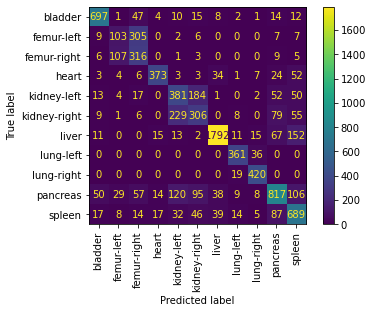

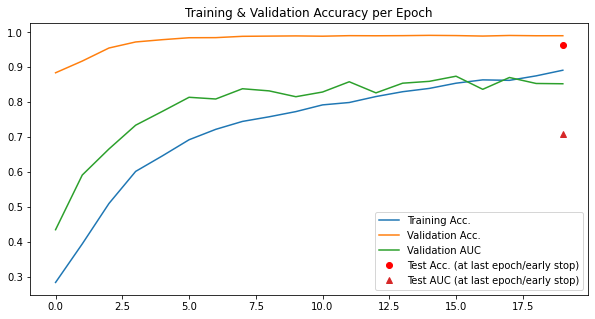

In [20]:
clf = run_classifier_pipeline(
    "organsmnist", info_flags, organsmnist_noWRS_noGDA,
    DA_technique=DA_technique
)

### 3.2. Training on the MedMNIST datasets with WSR and without GDA

In [21]:
# Declares the baseline setup to save the related model
DA_technique="_noGDA"

#### PathMNIST

{
  "python_class": "PathMNIST",
  "description": "The PathMNIST is based on a prior study for predicting survival from colorectal cancer histology slides, providing a dataset (NCT-CRC-HE-100K) of 100,000 non-overlapping image patches from hematoxylin & eosin stained histological images, and a test dataset (CRC-VAL-HE-7K) of 7,180 image patches from a different clinical center. The dataset is comprised of 9 types of tissues, resulting in a multi-class classification task. We resize the source images of 3\u00d7224\u00d7224 into 3\u00d728\u00d728, and split NCT-CRC-HE-100K into training and validation set with a ratio of 9:1. The CRC-VAL-HE-7K is treated as the test set.",
  "url": "https://zenodo.org/record/5208230/files/pathmnist.npz?download=1",
  "MD5": "a8b06965200029087d5bd730944a56c1",
  "task": "multi-class",
  "label": {
    "0": "adipose",
    "1": "background",
    "2": "debris",
    "3": "lymphocytes",
    "4": "mucus",
    "5": "smooth muscle",
    "6": "normal colon mucosa"

100%|█████████████████████████████████████████| 704/704 [00:20<00:00, 34.91it/s]


train -- accuracy: 0.6
val -- accuracy: 0.97,  AUC: 0.75
Epoch 1



100%|█████████████████████████████████████████| 704/704 [00:20<00:00, 35.15it/s]


train -- accuracy: 0.8
val -- accuracy: 0.98,  AUC: 0.82
Epoch 2



100%|█████████████████████████████████████████| 704/704 [00:20<00:00, 35.14it/s]


train -- accuracy: 0.85
val -- accuracy: 0.98,  AUC: 0.81
Epoch 3



100%|█████████████████████████████████████████| 704/704 [00:19<00:00, 35.30it/s]


train -- accuracy: 0.87
val -- accuracy: 0.99,  AUC: 0.87
Epoch 4



100%|█████████████████████████████████████████| 704/704 [00:20<00:00, 34.56it/s]


train -- accuracy: 0.89
val -- accuracy: 0.99,  AUC: 0.88
Epoch 5



100%|█████████████████████████████████████████| 704/704 [00:20<00:00, 34.54it/s]


train -- accuracy: 0.91
val -- accuracy: 0.99,  AUC: 0.9
Epoch 6



100%|█████████████████████████████████████████| 704/704 [00:19<00:00, 35.30it/s]


train -- accuracy: 0.92
val -- accuracy: 0.99,  AUC: 0.89
Epoch 7



100%|█████████████████████████████████████████| 704/704 [00:19<00:00, 35.41it/s]


train -- accuracy: 0.93
val -- accuracy: 0.99,  AUC: 0.89
Epoch 8



100%|█████████████████████████████████████████| 704/704 [00:20<00:00, 34.70it/s]


train -- accuracy: 0.93
val -- accuracy: 0.99,  AUC: 0.83
Epoch 9



100%|█████████████████████████████████████████| 704/704 [00:20<00:00, 35.00it/s]


train -- accuracy: 0.93
val -- accuracy: 0.99,  AUC: 0.87
Epoch 10



100%|█████████████████████████████████████████| 704/704 [00:20<00:00, 34.19it/s]


train -- accuracy: 0.94
val -- accuracy: 1.0,  AUC: 0.93
Epoch 11



100%|█████████████████████████████████████████| 704/704 [00:19<00:00, 35.35it/s]


train -- accuracy: 0.94
val -- accuracy: 0.99,  AUC: 0.91
Epoch 12



100%|█████████████████████████████████████████| 704/704 [00:20<00:00, 34.79it/s]


train -- accuracy: 0.95
val -- accuracy: 0.99,  AUC: 0.9
Epoch 13



100%|█████████████████████████████████████████| 704/704 [00:20<00:00, 34.93it/s]


train -- accuracy: 0.95
val -- accuracy: 0.99,  AUC: 0.9
Epoch 14



100%|█████████████████████████████████████████| 704/704 [00:20<00:00, 34.36it/s]


train -- accuracy: 0.96
val -- accuracy: 1.0,  AUC: 0.92
Epoch 15



100%|█████████████████████████████████████████| 704/704 [00:20<00:00, 34.87it/s]


train -- accuracy: 0.95
val -- accuracy: 1.0,  AUC: 0.92
Epoch 16



100%|█████████████████████████████████████████| 704/704 [00:20<00:00, 34.98it/s]


train -- accuracy: 0.96
val -- accuracy: 1.0,  AUC: 0.93
Epoch 17



100%|█████████████████████████████████████████| 704/704 [00:20<00:00, 33.92it/s]


train -- accuracy: 0.96
val -- accuracy: 1.0,  AUC: 0.94
Epoch 18



100%|█████████████████████████████████████████| 704/704 [00:20<00:00, 34.67it/s]


train -- accuracy: 0.96
val -- accuracy: 1.0,  AUC: 0.91
Epoch 19



100%|█████████████████████████████████████████| 704/704 [00:20<00:00, 33.72it/s]


train -- accuracy: 0.96
val -- accuracy: 0.99,  AUC: 0.88
test -- accuracy: 0.94,  AUC: 0.73


<Figure size 720x720 with 0 Axes>

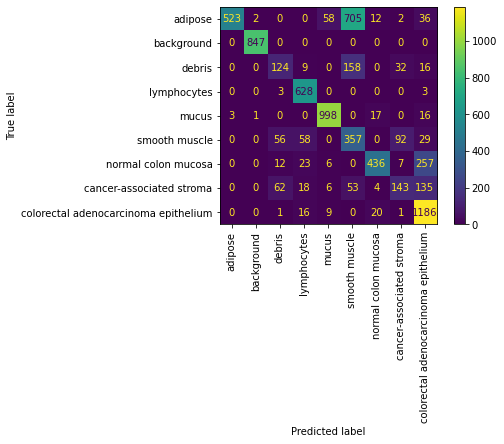

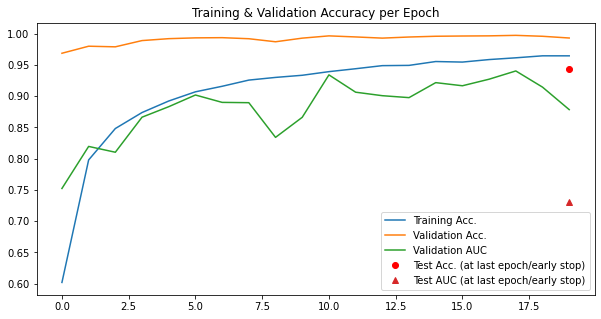

In [22]:
clf = run_classifier_pipeline(
    "pathmnist", info_flags, pathmnist_noGDA,
    DA_technique=DA_technique
)

#### DermaMNIST

{
  "python_class": "DermaMNIST",
  "description": "The DermaMNIST is based on the HAM10000, a large collection of multi-source dermatoscopic images of common pigmented skin lesions. The dataset consists of 10,015 dermatoscopic images categorized as 7 different diseases, formulized as a multi-class classification task. We split the images into training, validation and test set with a ratio of 7:1:2. The source images of 3\u00d7600\u00d7450 are resized into 3\u00d728\u00d728.",
  "url": "https://zenodo.org/record/5208230/files/dermamnist.npz?download=1",
  "MD5": "0744692d530f8e62ec473284d019b0c7",
  "task": "multi-class",
  "label": {
    "0": "actinic keratoses and intraepithelial carcinoma",
    "1": "basal cell carcinoma",
    "2": "benign keratosis-like lesions",
    "3": "dermatofibroma",
    "4": "melanoma",
    "5": "melanocytic nevi",
    "6": "vascular lesions"
  },
  "n_channels": 3,
  "n_samples": {
    "train": 7007,
    "val": 1003,
    "test": 2005
  },
  "license": "CC B

100%|███████████████████████████████████████████| 55/55 [00:01<00:00, 34.28it/s]


train -- accuracy: 0.25
val -- accuracy: 0.76,  AUC: 0.55
Epoch 1



100%|███████████████████████████████████████████| 55/55 [00:01<00:00, 32.95it/s]


train -- accuracy: 0.36
val -- accuracy: 0.82,  AUC: 0.48
Epoch 2



100%|███████████████████████████████████████████| 55/55 [00:01<00:00, 33.42it/s]


train -- accuracy: 0.44
val -- accuracy: 0.85,  AUC: 0.49
Epoch 3



100%|███████████████████████████████████████████| 55/55 [00:01<00:00, 34.21it/s]


train -- accuracy: 0.51
val -- accuracy: 0.87,  AUC: 0.48
Epoch 4



100%|███████████████████████████████████████████| 55/55 [00:01<00:00, 33.90it/s]


train -- accuracy: 0.53
val -- accuracy: 0.87,  AUC: 0.52
Epoch 5



100%|███████████████████████████████████████████| 55/55 [00:01<00:00, 33.47it/s]


train -- accuracy: 0.58
val -- accuracy: 0.87,  AUC: 0.5
Epoch 6



100%|███████████████████████████████████████████| 55/55 [00:01<00:00, 33.17it/s]


train -- accuracy: 0.61
val -- accuracy: 0.89,  AUC: 0.55
Epoch 7



100%|███████████████████████████████████████████| 55/55 [00:01<00:00, 33.37it/s]


train -- accuracy: 0.64
val -- accuracy: 0.89,  AUC: 0.61
Epoch 8



100%|███████████████████████████████████████████| 55/55 [00:01<00:00, 33.34it/s]


train -- accuracy: 0.67
val -- accuracy: 0.88,  AUC: 0.56
Epoch 9



100%|███████████████████████████████████████████| 55/55 [00:01<00:00, 33.98it/s]


train -- accuracy: 0.7
val -- accuracy: 0.89,  AUC: 0.56
Epoch 10



100%|███████████████████████████████████████████| 55/55 [00:01<00:00, 31.95it/s]


train -- accuracy: 0.72
val -- accuracy: 0.9,  AUC: 0.62
Epoch 11



100%|███████████████████████████████████████████| 55/55 [00:01<00:00, 33.91it/s]


train -- accuracy: 0.76
val -- accuracy: 0.9,  AUC: 0.64
Epoch 12



100%|███████████████████████████████████████████| 55/55 [00:01<00:00, 33.06it/s]


train -- accuracy: 0.78
val -- accuracy: 0.91,  AUC: 0.61
Epoch 13



100%|███████████████████████████████████████████| 55/55 [00:01<00:00, 33.36it/s]


train -- accuracy: 0.8
val -- accuracy: 0.89,  AUC: 0.63
Epoch 14



100%|███████████████████████████████████████████| 55/55 [00:01<00:00, 33.46it/s]


train -- accuracy: 0.82
val -- accuracy: 0.91,  AUC: 0.64
Epoch 15



100%|███████████████████████████████████████████| 55/55 [00:01<00:00, 33.15it/s]


train -- accuracy: 0.85
val -- accuracy: 0.91,  AUC: 0.62
Epoch 16



100%|███████████████████████████████████████████| 55/55 [00:01<00:00, 34.29it/s]


train -- accuracy: 0.86
val -- accuracy: 0.89,  AUC: 0.62
Epoch 17



100%|███████████████████████████████████████████| 55/55 [00:01<00:00, 35.22it/s]


train -- accuracy: 0.87
val -- accuracy: 0.92,  AUC: 0.66
Epoch 18



100%|███████████████████████████████████████████| 55/55 [00:01<00:00, 32.53it/s]


train -- accuracy: 0.88
val -- accuracy: 0.89,  AUC: 0.57
Epoch 19



100%|███████████████████████████████████████████| 55/55 [00:01<00:00, 32.20it/s]


train -- accuracy: 0.89
val -- accuracy: 0.89,  AUC: 0.56
test -- accuracy: 0.89,  AUC: 0.59


<Figure size 720x720 with 0 Axes>

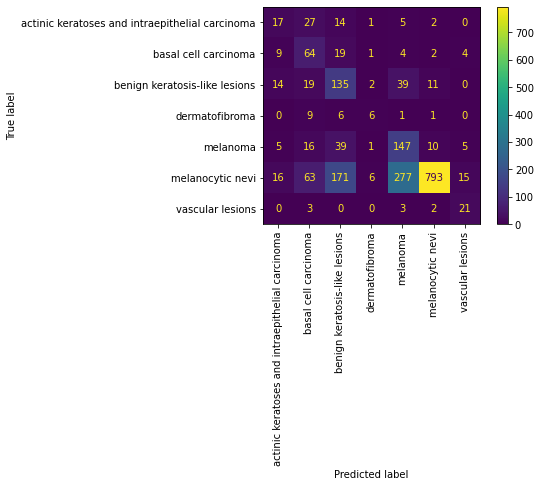

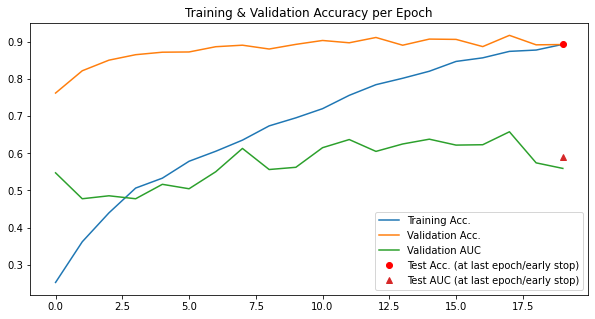

In [23]:
clf = run_classifier_pipeline(
    "dermamnist", info_flags, dermamnist_noGDA,
    DA_technique=DA_technique
)

#### OctMNIST

{
  "python_class": "OCTMNIST",
  "description": "The OCTMNIST is based on a prior dataset of 109,309 valid optical coherence tomography (OCT) images for retinal diseases. The dataset is comprised of 4 diagnosis categories, leading to a multi-class classification task. We split the source training set with a ratio of 9:1 into training and validation set, and use its source validation set as the test set. The source images are gray-scale, and their sizes are (384\u22121,536)\u00d7(277\u2212512). We center-crop the images and resize them into 1\u00d728\u00d728.",
  "url": "https://zenodo.org/record/5208230/files/octmnist.npz?download=1",
  "MD5": "c68d92d5b585d8d81f7112f81e2d0842",
  "task": "multi-class",
  "label": {
    "0": "choroidal neovascularization",
    "1": "diabetic macular edema",
    "2": "drusen",
    "3": "normal"
  },
  "n_channels": 1,
  "n_samples": {
    "train": 97477,
    "val": 10832,
    "test": 1000
  },
  "license": "CC BY 4.0"
}
--------------------------------

100%|█████████████████████████████████████████| 762/762 [00:20<00:00, 37.70it/s]


train -- accuracy: 0.64
val -- accuracy: 0.93,  AUC: 0.72
Epoch 1



100%|█████████████████████████████████████████| 762/762 [00:19<00:00, 38.18it/s]


train -- accuracy: 0.79
val -- accuracy: 0.94,  AUC: 0.78
Epoch 2



100%|█████████████████████████████████████████| 762/762 [00:20<00:00, 37.83it/s]


train -- accuracy: 0.83
val -- accuracy: 0.95,  AUC: 0.72
Epoch 3



100%|█████████████████████████████████████████| 762/762 [00:20<00:00, 37.64it/s]


train -- accuracy: 0.86
val -- accuracy: 0.96,  AUC: 0.74
Epoch 4



100%|█████████████████████████████████████████| 762/762 [00:20<00:00, 37.54it/s]


train -- accuracy: 0.88
val -- accuracy: 0.96,  AUC: 0.85
Epoch 5



100%|█████████████████████████████████████████| 762/762 [00:20<00:00, 37.81it/s]


train -- accuracy: 0.89
val -- accuracy: 0.97,  AUC: 0.88
Epoch 6



100%|█████████████████████████████████████████| 762/762 [00:19<00:00, 38.12it/s]


train -- accuracy: 0.91
val -- accuracy: 0.97,  AUC: 0.88
Epoch 7



100%|█████████████████████████████████████████| 762/762 [00:20<00:00, 37.58it/s]


train -- accuracy: 0.92
val -- accuracy: 0.97,  AUC: 0.88
Epoch 8



100%|█████████████████████████████████████████| 762/762 [00:20<00:00, 37.58it/s]


train -- accuracy: 0.93
val -- accuracy: 0.97,  AUC: 0.88
Epoch 9



100%|█████████████████████████████████████████| 762/762 [00:19<00:00, 38.77it/s]


train -- accuracy: 0.94
val -- accuracy: 0.97,  AUC: 0.89
Epoch 10



100%|█████████████████████████████████████████| 762/762 [00:20<00:00, 38.05it/s]


train -- accuracy: 0.94
val -- accuracy: 0.97,  AUC: 0.86
Epoch 11



100%|█████████████████████████████████████████| 762/762 [00:20<00:00, 37.47it/s]


train -- accuracy: 0.95
val -- accuracy: 0.97,  AUC: 0.89
Epoch 12



100%|█████████████████████████████████████████| 762/762 [00:20<00:00, 37.96it/s]


train -- accuracy: 0.96
val -- accuracy: 0.97,  AUC: 0.85
Epoch 13



100%|█████████████████████████████████████████| 762/762 [00:19<00:00, 38.41it/s]


train -- accuracy: 0.96
val -- accuracy: 0.97,  AUC: 0.89
Epoch 14



100%|█████████████████████████████████████████| 762/762 [00:20<00:00, 37.37it/s]


train -- accuracy: 0.96
val -- accuracy: 0.97,  AUC: 0.9
Epoch 15



100%|█████████████████████████████████████████| 762/762 [00:19<00:00, 38.70it/s]


train -- accuracy: 0.97
val -- accuracy: 0.97,  AUC: 0.87
Epoch 16



100%|█████████████████████████████████████████| 762/762 [00:20<00:00, 37.72it/s]


train -- accuracy: 0.97
val -- accuracy: 0.97,  AUC: 0.9
Epoch 17



100%|█████████████████████████████████████████| 762/762 [00:19<00:00, 38.50it/s]


train -- accuracy: 0.97
val -- accuracy: 0.97,  AUC: 0.89
Epoch 18



100%|█████████████████████████████████████████| 762/762 [00:19<00:00, 39.08it/s]


train -- accuracy: 0.98
val -- accuracy: 0.97,  AUC: 0.91
Epoch 19



100%|█████████████████████████████████████████| 762/762 [00:19<00:00, 38.67it/s]


train -- accuracy: 0.98
val -- accuracy: 0.97,  AUC: 0.9
test -- accuracy: 0.94,  AUC: 0.75


<Figure size 720x720 with 0 Axes>

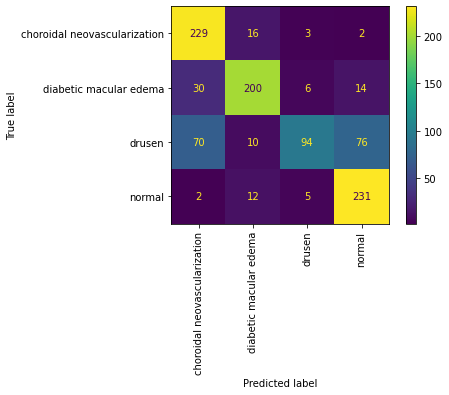

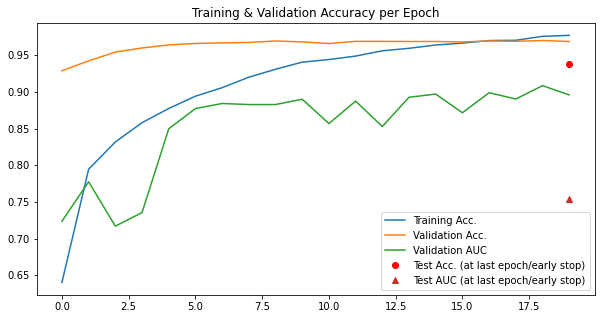

In [24]:
clf = run_classifier_pipeline(
    "octmnist", info_flags, octmnist_noGDA,
    DA_technique=DA_technique
)

#### PneumoniaMNIST

{
  "python_class": "PneumoniaMNIST",
  "description": "The PneumoniaMNIST is based on a prior dataset of 5,856 pediatric chest X-Ray images. The task is binary-class classification of pneumonia against normal. We split the source training set with a ratio of 9:1 into training and validation set and use its source validation set as the test set. The source images are gray-scale, and their sizes are (384\u22122,916)\u00d7(127\u22122,713). We center-crop the images and resize them into 1\u00d728\u00d728.",
  "url": "https://zenodo.org/record/5208230/files/pneumoniamnist.npz?download=1",
  "MD5": "28209eda62fecd6e6a2d98b1501bb15f",
  "task": "binary-class",
  "label": {
    "0": "normal",
    "1": "pneumonia"
  },
  "n_channels": 1,
  "n_samples": {
    "train": 4708,
    "val": 524,
    "test": 624
  },
  "license": "CC BY 4.0"
}
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           

100%|███████████████████████████████████████████| 37/37 [00:00<00:00, 37.61it/s]


train -- accuracy: 0.64
val -- accuracy: 0.89,  AUC: 0.83
Epoch 1



100%|███████████████████████████████████████████| 37/37 [00:00<00:00, 38.90it/s]


train -- accuracy: 0.91
val -- accuracy: 0.97,  AUC: 0.93
Epoch 2



100%|███████████████████████████████████████████| 37/37 [00:01<00:00, 36.61it/s]


train -- accuracy: 0.94
val -- accuracy: 0.98,  AUC: 0.94
Epoch 3



100%|███████████████████████████████████████████| 37/37 [00:00<00:00, 37.70it/s]


train -- accuracy: 0.94
val -- accuracy: 0.99,  AUC: 0.93
Epoch 4



100%|███████████████████████████████████████████| 37/37 [00:00<00:00, 37.73it/s]


train -- accuracy: 0.96
val -- accuracy: 0.99,  AUC: 0.93
Epoch 5



100%|███████████████████████████████████████████| 37/37 [00:00<00:00, 37.46it/s]


train -- accuracy: 0.97
val -- accuracy: 0.99,  AUC: 0.95
Epoch 6



100%|███████████████████████████████████████████| 37/37 [00:00<00:00, 38.42it/s]


train -- accuracy: 0.97
val -- accuracy: 0.99,  AUC: 0.96
Epoch 7



100%|███████████████████████████████████████████| 37/37 [00:00<00:00, 38.15it/s]


train -- accuracy: 0.98
val -- accuracy: 0.99,  AUC: 0.96
Epoch 8



100%|███████████████████████████████████████████| 37/37 [00:01<00:00, 35.91it/s]


train -- accuracy: 0.98
val -- accuracy: 0.99,  AUC: 0.97
Epoch 9



100%|███████████████████████████████████████████| 37/37 [00:00<00:00, 39.04it/s]


train -- accuracy: 0.98
val -- accuracy: 0.99,  AUC: 0.97
Epoch 10



100%|███████████████████████████████████████████| 37/37 [00:00<00:00, 37.27it/s]


train -- accuracy: 0.98
val -- accuracy: 1.0,  AUC: 0.95
Epoch 11



100%|███████████████████████████████████████████| 37/37 [00:00<00:00, 37.82it/s]


train -- accuracy: 0.99
val -- accuracy: 1.0,  AUC: 0.97
Epoch 12



100%|███████████████████████████████████████████| 37/37 [00:00<00:00, 37.28it/s]


train -- accuracy: 0.99
val -- accuracy: 1.0,  AUC: 0.97
Epoch 13



100%|███████████████████████████████████████████| 37/37 [00:01<00:00, 36.63it/s]


train -- accuracy: 0.99
val -- accuracy: 1.0,  AUC: 0.96
Epoch 14



100%|███████████████████████████████████████████| 37/37 [00:00<00:00, 37.93it/s]


train -- accuracy: 0.99
val -- accuracy: 1.0,  AUC: 0.96
Epoch 15



100%|███████████████████████████████████████████| 37/37 [00:00<00:00, 38.21it/s]


train -- accuracy: 0.99
val -- accuracy: 1.0,  AUC: 0.96
Epoch 16



100%|███████████████████████████████████████████| 37/37 [00:00<00:00, 37.45it/s]


train -- accuracy: 0.99
val -- accuracy: 1.0,  AUC: 0.96
Epoch 17



100%|███████████████████████████████████████████| 37/37 [00:00<00:00, 37.57it/s]


train -- accuracy: 1.0
val -- accuracy: 1.0,  AUC: 0.97
Epoch 18



100%|███████████████████████████████████████████| 37/37 [00:00<00:00, 37.92it/s]


train -- accuracy: 1.0
val -- accuracy: 1.0,  AUC: 0.96
Epoch 19



100%|███████████████████████████████████████████| 37/37 [00:00<00:00, 37.48it/s]


train -- accuracy: 1.0
val -- accuracy: 1.0,  AUC: 0.96
test -- accuracy: 0.96,  AUC: 0.86


<Figure size 720x720 with 0 Axes>

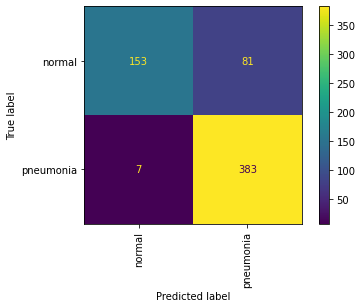

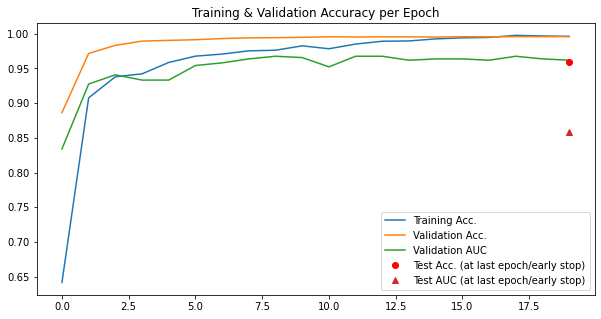

In [25]:
clf = run_classifier_pipeline(
    "pneumoniamnist", info_flags, pneumoniamnist_noGDA,
    DA_technique=DA_technique
)

#### BreastMNIST

{
  "python_class": "BreastMNIST",
  "description": "The BreastMNIST is based on a dataset of 780 breast ultrasound images. It is categorized into 3 classes: normal, benign, and malignant. As we use low-resolution images, we simplify the task into binary classification by combining normal and benign as positive and classifying them against malignant as negative. We split the source dataset with a ratio of 7:1:2 into training, validation and test set. The source images of 1\u00d7500\u00d7500 are resized into 1\u00d728\u00d728.",
  "url": "https://zenodo.org/record/5208230/files/breastmnist.npz?download=1",
  "MD5": "750601b1f35ba3300ea97c75c52ff8f6",
  "task": "binary-class",
  "label": {
    "0": "malignant",
    "1": "normal, benign"
  },
  "n_channels": 1,
  "n_samples": {
    "train": 546,
    "val": 78,
    "test": 156
  },
  "license": "CC BY 4.0"
}
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
    

100%|█████████████████████████████████████████████| 5/5 [00:00<00:00, 42.25it/s]


train -- accuracy: 0.55
val -- accuracy: 0.58,  AUC: 0.27
Epoch 1



100%|█████████████████████████████████████████████| 5/5 [00:00<00:00, 41.94it/s]


train -- accuracy: 0.55
val -- accuracy: 0.54,  AUC: 0.27
Epoch 2



100%|█████████████████████████████████████████████| 5/5 [00:00<00:00, 42.79it/s]


train -- accuracy: 0.65
val -- accuracy: 0.63,  AUC: 0.5
Epoch 3



100%|█████████████████████████████████████████████| 5/5 [00:00<00:00, 40.00it/s]


train -- accuracy: 0.7
val -- accuracy: 0.68,  AUC: 0.58
Epoch 4



100%|█████████████████████████████████████████████| 5/5 [00:00<00:00, 42.75it/s]


train -- accuracy: 0.69
val -- accuracy: 0.74,  AUC: 0.64
Epoch 5



100%|█████████████████████████████████████████████| 5/5 [00:00<00:00, 40.53it/s]


train -- accuracy: 0.71
val -- accuracy: 0.78,  AUC: 0.65
Epoch 6



100%|█████████████████████████████████████████████| 5/5 [00:00<00:00, 42.78it/s]


train -- accuracy: 0.7
val -- accuracy: 0.79,  AUC: 0.67
Epoch 7



100%|█████████████████████████████████████████████| 5/5 [00:00<00:00, 42.12it/s]


train -- accuracy: 0.68
val -- accuracy: 0.8,  AUC: 0.67
Epoch 8



100%|█████████████████████████████████████████████| 5/5 [00:00<00:00, 44.15it/s]


train -- accuracy: 0.69
val -- accuracy: 0.81,  AUC: 0.73
Epoch 9



100%|█████████████████████████████████████████████| 5/5 [00:00<00:00, 44.02it/s]


train -- accuracy: 0.73
val -- accuracy: 0.81,  AUC: 0.74
Epoch 10



100%|█████████████████████████████████████████████| 5/5 [00:00<00:00, 44.41it/s]


train -- accuracy: 0.73
val -- accuracy: 0.81,  AUC: 0.74
Epoch 11



100%|█████████████████████████████████████████████| 5/5 [00:00<00:00, 41.48it/s]


train -- accuracy: 0.75
val -- accuracy: 0.81,  AUC: 0.71
Epoch 12



100%|█████████████████████████████████████████████| 5/5 [00:00<00:00, 43.13it/s]


train -- accuracy: 0.74
val -- accuracy: 0.82,  AUC: 0.73
Epoch 13



100%|█████████████████████████████████████████████| 5/5 [00:00<00:00, 43.48it/s]


train -- accuracy: 0.76
val -- accuracy: 0.83,  AUC: 0.76
Epoch 14



100%|█████████████████████████████████████████████| 5/5 [00:00<00:00, 44.33it/s]


train -- accuracy: 0.79
val -- accuracy: 0.84,  AUC: 0.74
Epoch 15



100%|█████████████████████████████████████████████| 5/5 [00:00<00:00, 42.58it/s]


train -- accuracy: 0.76
val -- accuracy: 0.84,  AUC: 0.74
Epoch 16



100%|█████████████████████████████████████████████| 5/5 [00:00<00:00, 43.41it/s]


train -- accuracy: 0.79
val -- accuracy: 0.86,  AUC: 0.76
Epoch 17



100%|█████████████████████████████████████████████| 5/5 [00:00<00:00, 43.84it/s]


train -- accuracy: 0.81
val -- accuracy: 0.86,  AUC: 0.78
Epoch 18



100%|█████████████████████████████████████████████| 5/5 [00:00<00:00, 43.78it/s]


train -- accuracy: 0.78
val -- accuracy: 0.86,  AUC: 0.78
Epoch 19



100%|█████████████████████████████████████████████| 5/5 [00:00<00:00, 43.13it/s]


train -- accuracy: 0.8
val -- accuracy: 0.87,  AUC: 0.78
test -- accuracy: 0.83,  AUC: 0.79


<Figure size 720x720 with 0 Axes>

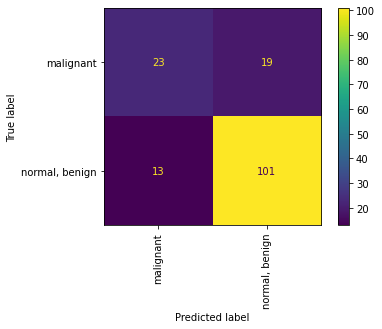

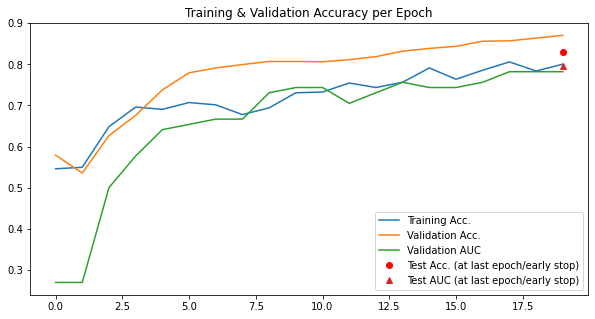

In [26]:
clf = run_classifier_pipeline(
    "breastmnist", info_flags, breastmnist_noGDA,
    DA_technique=DA_technique
)

#### OrganAMNIST

{
  "python_class": "OrganAMNIST",
  "description": "The OrganAMNIST is based on 3D computed tomography (CT) images from Liver Tumor Segmentation Benchmark (LiTS). It is renamed from OrganMNIST_Axial (in MedMNIST v1) for simplicity. We use bounding-box annotations of 11 body organs from another study to obtain the organ labels. Hounsfield-Unit (HU) of the 3D images are transformed into gray-scale with an abdominal window. We crop 2D images from the center slices of the 3D bounding boxes in axial views (planes). The images are resized into 1\u00d728\u00d728 to perform multi-class classification of 11 body organs. 115 and 16 CT scans from the source training set are used as training and validation set, respectively. The 70 CT scans from the source test set are treated as the test set.",
  "url": "https://zenodo.org/record/5208230/files/organamnist.npz?download=1",
  "MD5": "866b832ed4eeba67bfb9edee1d5544e6",
  "task": "multi-class",
  "label": {
    "0": "bladder",
    "1": "femur-left",

100%|█████████████████████████████████████████| 271/271 [00:07<00:00, 37.84it/s]


train -- accuracy: 0.47
val -- accuracy: 0.97,  AUC: 0.73
Epoch 1



100%|█████████████████████████████████████████| 271/271 [00:07<00:00, 38.12it/s]


train -- accuracy: 0.77
val -- accuracy: 0.99,  AUC: 0.9
Epoch 2



100%|█████████████████████████████████████████| 271/271 [00:07<00:00, 37.87it/s]


train -- accuracy: 0.88
val -- accuracy: 1.0,  AUC: 0.93
Epoch 3



100%|█████████████████████████████████████████| 271/271 [00:07<00:00, 37.74it/s]


train -- accuracy: 0.92
val -- accuracy: 1.0,  AUC: 0.95
Epoch 4



100%|█████████████████████████████████████████| 271/271 [00:06<00:00, 39.81it/s]


train -- accuracy: 0.94
val -- accuracy: 1.0,  AUC: 0.95
Epoch 5



100%|█████████████████████████████████████████| 271/271 [00:07<00:00, 38.49it/s]


train -- accuracy: 0.95
val -- accuracy: 1.0,  AUC: 0.96
Epoch 6



100%|█████████████████████████████████████████| 271/271 [00:06<00:00, 39.65it/s]


train -- accuracy: 0.96
val -- accuracy: 1.0,  AUC: 0.94
Epoch 7



100%|█████████████████████████████████████████| 271/271 [00:06<00:00, 39.36it/s]


train -- accuracy: 0.97
val -- accuracy: 1.0,  AUC: 0.95
Epoch 8



100%|█████████████████████████████████████████| 271/271 [00:06<00:00, 38.81it/s]


train -- accuracy: 0.98
val -- accuracy: 1.0,  AUC: 0.96
Epoch 9



100%|█████████████████████████████████████████| 271/271 [00:07<00:00, 37.90it/s]


train -- accuracy: 0.98
val -- accuracy: 1.0,  AUC: 0.96
Epoch 10



100%|█████████████████████████████████████████| 271/271 [00:07<00:00, 37.17it/s]


train -- accuracy: 0.98
val -- accuracy: 1.0,  AUC: 0.96
Epoch 11



100%|█████████████████████████████████████████| 271/271 [00:07<00:00, 37.43it/s]


train -- accuracy: 0.99
val -- accuracy: 1.0,  AUC: 0.96
Epoch 12



100%|█████████████████████████████████████████| 271/271 [00:07<00:00, 37.13it/s]


train -- accuracy: 0.99
val -- accuracy: 1.0,  AUC: 0.96
Epoch 13



100%|█████████████████████████████████████████| 271/271 [00:07<00:00, 37.04it/s]


train -- accuracy: 0.99
val -- accuracy: 1.0,  AUC: 0.96
Epoch 14



100%|█████████████████████████████████████████| 271/271 [00:06<00:00, 39.02it/s]


train -- accuracy: 0.99
val -- accuracy: 1.0,  AUC: 0.97
Epoch 15



100%|█████████████████████████████████████████| 271/271 [00:07<00:00, 37.73it/s]


train -- accuracy: 0.99
val -- accuracy: 1.0,  AUC: 0.96
Epoch 16



100%|█████████████████████████████████████████| 271/271 [00:07<00:00, 37.11it/s]


train -- accuracy: 1.0
val -- accuracy: 1.0,  AUC: 0.96
Epoch 17



100%|█████████████████████████████████████████| 271/271 [00:07<00:00, 37.95it/s]


train -- accuracy: 1.0
val -- accuracy: 1.0,  AUC: 0.97
Epoch 18



100%|█████████████████████████████████████████| 271/271 [00:07<00:00, 37.52it/s]


train -- accuracy: 1.0
val -- accuracy: 1.0,  AUC: 0.96
Epoch 19



100%|█████████████████████████████████████████| 271/271 [00:07<00:00, 38.08it/s]


train -- accuracy: 1.0
val -- accuracy: 1.0,  AUC: 0.96
test -- accuracy: 0.99,  AUC: 0.88


<Figure size 720x720 with 0 Axes>

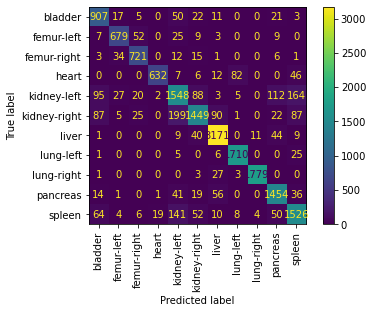

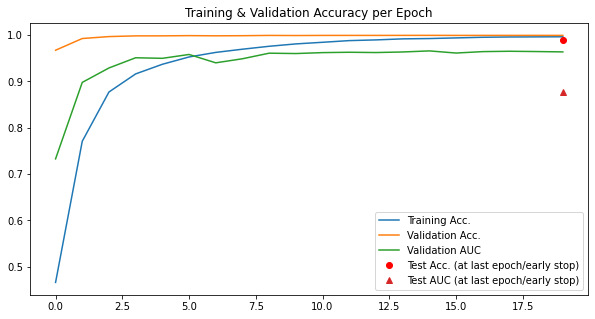

In [27]:
clf = run_classifier_pipeline(
    "organamnist", info_flags, organamnist_noGDA,
    DA_technique=DA_technique
)

#### OrganCMNIST

{
  "python_class": "OrganCMNIST",
  "description": "The OrganCMNIST is based on 3D computed tomography (CT) images from Liver Tumor Segmentation Benchmark (LiTS). It is renamed from OrganMNIST_Coronal (in MedMNIST v1) for simplicity. We use bounding-box annotations of 11 body organs from another study to obtain the organ labels. Hounsfield-Unit (HU) of the 3D images are transformed into gray-scale with an abdominal window. We crop 2D images from the center slices of the 3D bounding boxes in coronal views (planes). The images are resized into 1\u00d728\u00d728 to perform multi-class classification of 11 body organs. 115 and 16 CT scans from the source training set are used as training and validation set, respectively. The 70 CT scans from the source test set are treated as the test set.",
  "url": "https://zenodo.org/record/5208230/files/organcmnist.npz?download=1",
  "MD5": "0afa5834fb105f7705a7d93372119a21",
  "task": "multi-class",
  "label": {
    "0": "bladder",
    "1": "femur-le

100%|█████████████████████████████████████████| 102/102 [00:02<00:00, 39.44it/s]


train -- accuracy: 0.3
val -- accuracy: 0.91,  AUC: 0.58
Epoch 1



100%|█████████████████████████████████████████| 102/102 [00:02<00:00, 37.93it/s]


train -- accuracy: 0.48
val -- accuracy: 0.96,  AUC: 0.72
Epoch 2



100%|█████████████████████████████████████████| 102/102 [00:02<00:00, 39.15it/s]


train -- accuracy: 0.64
val -- accuracy: 0.98,  AUC: 0.78
Epoch 3



100%|█████████████████████████████████████████| 102/102 [00:02<00:00, 37.41it/s]


train -- accuracy: 0.75
val -- accuracy: 0.99,  AUC: 0.87
Epoch 4



100%|█████████████████████████████████████████| 102/102 [00:02<00:00, 37.49it/s]


train -- accuracy: 0.8
val -- accuracy: 0.99,  AUC: 0.86
Epoch 5



100%|█████████████████████████████████████████| 102/102 [00:02<00:00, 37.62it/s]


train -- accuracy: 0.83
val -- accuracy: 1.0,  AUC: 0.93
Epoch 6



100%|█████████████████████████████████████████| 102/102 [00:02<00:00, 37.15it/s]


train -- accuracy: 0.86
val -- accuracy: 1.0,  AUC: 0.95
Epoch 7



100%|█████████████████████████████████████████| 102/102 [00:02<00:00, 38.14it/s]


train -- accuracy: 0.88
val -- accuracy: 1.0,  AUC: 0.93
Epoch 8



100%|█████████████████████████████████████████| 102/102 [00:02<00:00, 37.53it/s]


train -- accuracy: 0.9
val -- accuracy: 1.0,  AUC: 0.94
Epoch 9



100%|█████████████████████████████████████████| 102/102 [00:02<00:00, 37.86it/s]


train -- accuracy: 0.91
val -- accuracy: 1.0,  AUC: 0.95
Epoch 10



100%|█████████████████████████████████████████| 102/102 [00:02<00:00, 38.15it/s]


train -- accuracy: 0.92
val -- accuracy: 1.0,  AUC: 0.94
Epoch 11



100%|█████████████████████████████████████████| 102/102 [00:02<00:00, 37.28it/s]


train -- accuracy: 0.92
val -- accuracy: 1.0,  AUC: 0.93
Epoch 12



100%|█████████████████████████████████████████| 102/102 [00:02<00:00, 37.70it/s]


train -- accuracy: 0.94
val -- accuracy: 1.0,  AUC: 0.95
Epoch 13



100%|█████████████████████████████████████████| 102/102 [00:02<00:00, 37.26it/s]


train -- accuracy: 0.94
val -- accuracy: 1.0,  AUC: 0.94
Epoch 14



100%|█████████████████████████████████████████| 102/102 [00:02<00:00, 35.99it/s]


train -- accuracy: 0.94
val -- accuracy: 1.0,  AUC: 0.94
Epoch 15



100%|█████████████████████████████████████████| 102/102 [00:02<00:00, 39.59it/s]


train -- accuracy: 0.95
val -- accuracy: 1.0,  AUC: 0.94
Epoch 16



100%|█████████████████████████████████████████| 102/102 [00:02<00:00, 38.33it/s]


train -- accuracy: 0.95
val -- accuracy: 1.0,  AUC: 0.95
Epoch 17



100%|█████████████████████████████████████████| 102/102 [00:02<00:00, 38.61it/s]


train -- accuracy: 0.96
val -- accuracy: 1.0,  AUC: 0.95
Epoch 18



100%|█████████████████████████████████████████| 102/102 [00:02<00:00, 38.02it/s]


train -- accuracy: 0.96
val -- accuracy: 1.0,  AUC: 0.94
Epoch 19



100%|█████████████████████████████████████████| 102/102 [00:02<00:00, 37.78it/s]


train -- accuracy: 0.96
val -- accuracy: 1.0,  AUC: 0.95
test -- accuracy: 0.99,  AUC: 0.86


<Figure size 720x720 with 0 Axes>

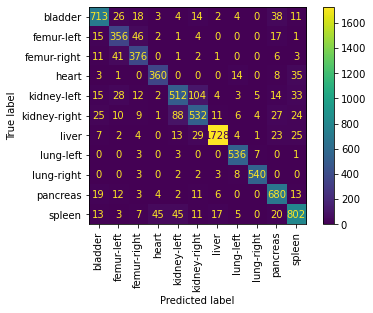

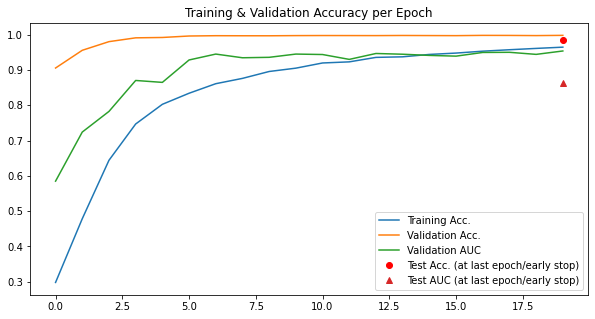

In [28]:
clf = run_classifier_pipeline(
    "organcmnist", info_flags, organcmnist_noGDA,
    DA_technique=DA_technique
)

#### OrganSMNIST

{
  "python_class": "OrganSMNIST",
  "description": "The OrganSMNIST is based on 3D computed tomography (CT) images from Liver Tumor Segmentation Benchmark (LiTS). It is renamed from OrganMNIST_Sagittal (in MedMNIST v1) for simplicity. We use bounding-box annotations of 11 body organs from another study to obtain the organ labels. Hounsfield-Unit (HU) of the 3D images are transformed into gray-scale with an abdominal window. We crop 2D images from the center slices of the 3D bounding boxes in sagittal views (planes). The images are resized into 1\u00d728\u00d728 to perform multi-class classification of 11 body organs. 115 and 16 CT scans from the source training set are used as training and validation set, respectively. The 70 CT scans from the source test set are treated as the test set.",
  "url": "https://zenodo.org/record/5208230/files/organsmnist.npz?download=1",
  "MD5": "e5c39f1af030238290b9557d9503af9d",
  "task": "multi-class",
  "label": {
    "0": "bladder",
    "1": "femur-

100%|█████████████████████████████████████████| 109/109 [00:02<00:00, 40.23it/s]


train -- accuracy: 0.22
val -- accuracy: 0.85,  AUC: 0.32
Epoch 1



100%|█████████████████████████████████████████| 109/109 [00:02<00:00, 40.22it/s]


train -- accuracy: 0.37
val -- accuracy: 0.9,  AUC: 0.55
Epoch 2



100%|█████████████████████████████████████████| 109/109 [00:02<00:00, 38.74it/s]


train -- accuracy: 0.48
val -- accuracy: 0.94,  AUC: 0.58
Epoch 3



100%|█████████████████████████████████████████| 109/109 [00:02<00:00, 40.00it/s]


train -- accuracy: 0.56
val -- accuracy: 0.96,  AUC: 0.67
Epoch 4



100%|█████████████████████████████████████████| 109/109 [00:02<00:00, 39.80it/s]


train -- accuracy: 0.61
val -- accuracy: 0.97,  AUC: 0.71
Epoch 5



100%|█████████████████████████████████████████| 109/109 [00:02<00:00, 39.30it/s]


train -- accuracy: 0.66
val -- accuracy: 0.98,  AUC: 0.77
Epoch 6



100%|█████████████████████████████████████████| 109/109 [00:02<00:00, 38.57it/s]


train -- accuracy: 0.7
val -- accuracy: 0.98,  AUC: 0.79
Epoch 7



100%|█████████████████████████████████████████| 109/109 [00:02<00:00, 38.67it/s]


train -- accuracy: 0.73
val -- accuracy: 0.99,  AUC: 0.79
Epoch 8



100%|█████████████████████████████████████████| 109/109 [00:02<00:00, 38.15it/s]


train -- accuracy: 0.75
val -- accuracy: 0.99,  AUC: 0.81
Epoch 9



100%|█████████████████████████████████████████| 109/109 [00:02<00:00, 37.46it/s]


train -- accuracy: 0.77
val -- accuracy: 0.99,  AUC: 0.83
Epoch 10



100%|█████████████████████████████████████████| 109/109 [00:02<00:00, 39.16it/s]


train -- accuracy: 0.79
val -- accuracy: 0.99,  AUC: 0.83
Epoch 11



100%|█████████████████████████████████████████| 109/109 [00:02<00:00, 39.80it/s]


train -- accuracy: 0.81
val -- accuracy: 0.99,  AUC: 0.83
Epoch 12



100%|█████████████████████████████████████████| 109/109 [00:02<00:00, 39.32it/s]


train -- accuracy: 0.82
val -- accuracy: 0.99,  AUC: 0.84
Epoch 13



100%|█████████████████████████████████████████| 109/109 [00:02<00:00, 38.33it/s]


train -- accuracy: 0.83
val -- accuracy: 0.99,  AUC: 0.83
Epoch 14



100%|█████████████████████████████████████████| 109/109 [00:02<00:00, 40.51it/s]


train -- accuracy: 0.84
val -- accuracy: 0.99,  AUC: 0.86
Epoch 15



100%|█████████████████████████████████████████| 109/109 [00:02<00:00, 40.45it/s]


train -- accuracy: 0.86
val -- accuracy: 0.99,  AUC: 0.85
Epoch 16



100%|█████████████████████████████████████████| 109/109 [00:02<00:00, 40.19it/s]


train -- accuracy: 0.86
val -- accuracy: 0.99,  AUC: 0.85
Epoch 17



100%|█████████████████████████████████████████| 109/109 [00:02<00:00, 40.30it/s]


train -- accuracy: 0.87
val -- accuracy: 0.99,  AUC: 0.85
Epoch 18



100%|█████████████████████████████████████████| 109/109 [00:02<00:00, 40.39it/s]


train -- accuracy: 0.9
val -- accuracy: 0.99,  AUC: 0.82
Epoch 19



100%|█████████████████████████████████████████| 109/109 [00:02<00:00, 40.25it/s]


train -- accuracy: 0.9
val -- accuracy: 0.99,  AUC: 0.83
test -- accuracy: 0.96,  AUC: 0.71


<Figure size 720x720 with 0 Axes>

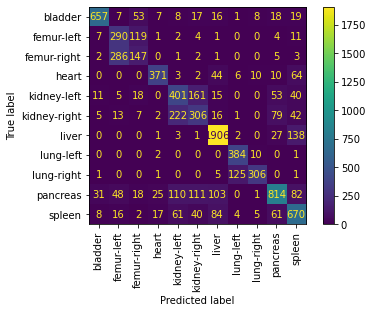

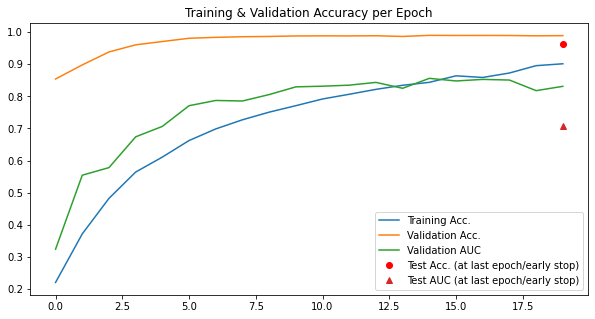

In [29]:
clf = run_classifier_pipeline(
    "organsmnist", info_flags, organsmnist_noGDA,
    DA_technique=DA_technique
)

### 3.3. Training on the MedMNIST datasets with WSR and GDA

In [30]:
# Declares the baseline setup to save the related model
DA_technique="_WSR_GDA"

#### PathMNIST

{
  "python_class": "PathMNIST",
  "description": "The PathMNIST is based on a prior study for predicting survival from colorectal cancer histology slides, providing a dataset (NCT-CRC-HE-100K) of 100,000 non-overlapping image patches from hematoxylin & eosin stained histological images, and a test dataset (CRC-VAL-HE-7K) of 7,180 image patches from a different clinical center. The dataset is comprised of 9 types of tissues, resulting in a multi-class classification task. We resize the source images of 3\u00d7224\u00d7224 into 3\u00d728\u00d728, and split NCT-CRC-HE-100K into training and validation set with a ratio of 9:1. The CRC-VAL-HE-7K is treated as the test set.",
  "url": "https://zenodo.org/record/5208230/files/pathmnist.npz?download=1",
  "MD5": "a8b06965200029087d5bd730944a56c1",
  "task": "multi-class",
  "label": {
    "0": "adipose",
    "1": "background",
    "2": "debris",
    "3": "lymphocytes",
    "4": "mucus",
    "5": "smooth muscle",
    "6": "normal colon mucosa"

100%|█████████████████████████████████████████| 704/704 [01:48<00:00,  6.46it/s]


train -- accuracy: 0.39
val -- accuracy: 0.89,  AUC: 0.55
Epoch 1



100%|█████████████████████████████████████████| 704/704 [01:51<00:00,  6.31it/s]


train -- accuracy: 0.57
val -- accuracy: 0.93,  AUC: 0.62
Epoch 2



100%|█████████████████████████████████████████| 704/704 [02:05<00:00,  5.59it/s]


train -- accuracy: 0.62
val -- accuracy: 0.94,  AUC: 0.66
Epoch 3



100%|█████████████████████████████████████████| 704/704 [02:07<00:00,  5.53it/s]


train -- accuracy: 0.66
val -- accuracy: 0.95,  AUC: 0.7
Epoch 4



100%|█████████████████████████████████████████| 704/704 [01:58<00:00,  5.92it/s]


train -- accuracy: 0.7
val -- accuracy: 0.96,  AUC: 0.75
Epoch 5



100%|█████████████████████████████████████████| 704/704 [02:01<00:00,  5.78it/s]


train -- accuracy: 0.72
val -- accuracy: 0.96,  AUC: 0.74
Epoch 6



100%|█████████████████████████████████████████| 704/704 [01:56<00:00,  6.02it/s]


train -- accuracy: 0.74
val -- accuracy: 0.97,  AUC: 0.77
Epoch 7



100%|█████████████████████████████████████████| 704/704 [02:04<00:00,  5.67it/s]


train -- accuracy: 0.75
val -- accuracy: 0.98,  AUC: 0.79
Epoch 8



100%|█████████████████████████████████████████| 704/704 [02:07<00:00,  5.51it/s]


train -- accuracy: 0.76
val -- accuracy: 0.98,  AUC: 0.82
Epoch 9



100%|█████████████████████████████████████████| 704/704 [02:15<00:00,  5.20it/s]


train -- accuracy: 0.77
val -- accuracy: 0.98,  AUC: 0.82
Epoch 10



100%|█████████████████████████████████████████| 704/704 [02:31<00:00,  4.65it/s]


train -- accuracy: 0.78
val -- accuracy: 0.98,  AUC: 0.81
Epoch 11



100%|█████████████████████████████████████████| 704/704 [02:31<00:00,  4.66it/s]


train -- accuracy: 0.79
val -- accuracy: 0.98,  AUC: 0.83
Epoch 12



100%|█████████████████████████████████████████| 704/704 [02:46<00:00,  4.24it/s]


train -- accuracy: 0.8
val -- accuracy: 0.98,  AUC: 0.83
Epoch 13



100%|█████████████████████████████████████████| 704/704 [02:52<00:00,  4.08it/s]


train -- accuracy: 0.81
val -- accuracy: 0.98,  AUC: 0.84
Epoch 14



100%|█████████████████████████████████████████| 704/704 [02:44<00:00,  4.27it/s]


train -- accuracy: 0.81
val -- accuracy: 0.99,  AUC: 0.85
Epoch 15



100%|█████████████████████████████████████████| 704/704 [02:25<00:00,  4.85it/s]


train -- accuracy: 0.81
val -- accuracy: 0.98,  AUC: 0.83
Epoch 16



100%|█████████████████████████████████████████| 704/704 [02:16<00:00,  5.15it/s]


train -- accuracy: 0.82
val -- accuracy: 0.99,  AUC: 0.86
Epoch 17



100%|█████████████████████████████████████████| 704/704 [02:14<00:00,  5.22it/s]


train -- accuracy: 0.82
val -- accuracy: 0.99,  AUC: 0.87
Epoch 18



100%|█████████████████████████████████████████| 704/704 [02:51<00:00,  4.10it/s]


train -- accuracy: 0.83
val -- accuracy: 0.99,  AUC: 0.86
Epoch 19



100%|█████████████████████████████████████████| 704/704 [02:45<00:00,  4.26it/s]


train -- accuracy: 0.83
val -- accuracy: 0.99,  AUC: 0.86
test -- accuracy: 0.99,  AUC: 0.88


<Figure size 720x720 with 0 Axes>

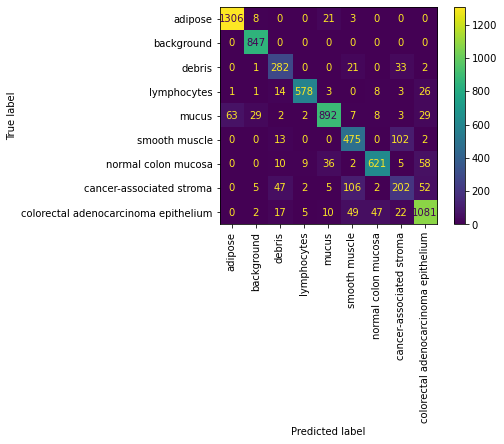

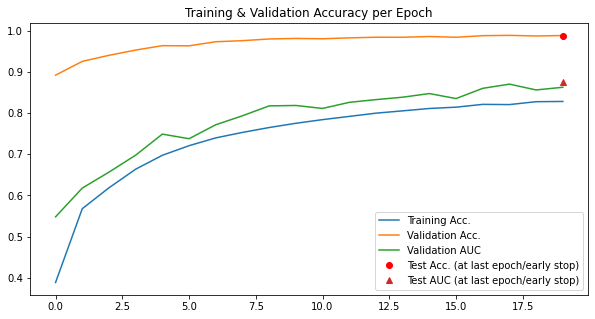

In [31]:
clf = run_classifier_pipeline(
    "pathmnist", info_flags, pathmnist_WSR_GDA,
    DA_technique=DA_technique
)

#### DermaMNIST

{
  "python_class": "DermaMNIST",
  "description": "The DermaMNIST is based on the HAM10000, a large collection of multi-source dermatoscopic images of common pigmented skin lesions. The dataset consists of 10,015 dermatoscopic images categorized as 7 different diseases, formulized as a multi-class classification task. We split the images into training, validation and test set with a ratio of 7:1:2. The source images of 3\u00d7600\u00d7450 are resized into 3\u00d728\u00d728.",
  "url": "https://zenodo.org/record/5208230/files/dermamnist.npz?download=1",
  "MD5": "0744692d530f8e62ec473284d019b0c7",
  "task": "multi-class",
  "label": {
    "0": "actinic keratoses and intraepithelial carcinoma",
    "1": "basal cell carcinoma",
    "2": "benign keratosis-like lesions",
    "3": "dermatofibroma",
    "4": "melanoma",
    "5": "melanocytic nevi",
    "6": "vascular lesions"
  },
  "n_channels": 3,
  "n_samples": {
    "train": 7007,
    "val": 1003,
    "test": 2005
  },
  "license": "CC B

100%|███████████████████████████████████████████| 55/55 [00:10<00:00,  5.35it/s]


train -- accuracy: 0.19
val -- accuracy: 0.72,  AUC: 0.17
Epoch 1



100%|███████████████████████████████████████████| 55/55 [00:11<00:00,  4.96it/s]


train -- accuracy: 0.25
val -- accuracy: 0.73,  AUC: 0.29
Epoch 2



100%|███████████████████████████████████████████| 55/55 [00:10<00:00,  5.22it/s]


train -- accuracy: 0.28
val -- accuracy: 0.75,  AUC: 0.41
Epoch 3



100%|███████████████████████████████████████████| 55/55 [00:10<00:00,  5.42it/s]


train -- accuracy: 0.31
val -- accuracy: 0.77,  AUC: 0.44
Epoch 4



100%|███████████████████████████████████████████| 55/55 [00:11<00:00,  4.84it/s]


train -- accuracy: 0.32
val -- accuracy: 0.77,  AUC: 0.45
Epoch 5



100%|███████████████████████████████████████████| 55/55 [00:11<00:00,  4.66it/s]


train -- accuracy: 0.33
val -- accuracy: 0.79,  AUC: 0.39
Epoch 6



100%|███████████████████████████████████████████| 55/55 [00:10<00:00,  5.34it/s]


train -- accuracy: 0.34
val -- accuracy: 0.78,  AUC: 0.41
Epoch 7



100%|███████████████████████████████████████████| 55/55 [00:10<00:00,  5.17it/s]


train -- accuracy: 0.35
val -- accuracy: 0.79,  AUC: 0.46
Epoch 8



100%|███████████████████████████████████████████| 55/55 [00:10<00:00,  5.22it/s]


train -- accuracy: 0.36
val -- accuracy: 0.8,  AUC: 0.45
Epoch 9



100%|███████████████████████████████████████████| 55/55 [00:10<00:00,  5.11it/s]


train -- accuracy: 0.36
val -- accuracy: 0.81,  AUC: 0.44
Epoch 10



100%|███████████████████████████████████████████| 55/55 [00:10<00:00,  5.15it/s]


train -- accuracy: 0.37
val -- accuracy: 0.81,  AUC: 0.44
Epoch 11



100%|███████████████████████████████████████████| 55/55 [00:10<00:00,  5.22it/s]


train -- accuracy: 0.38
val -- accuracy: 0.81,  AUC: 0.39
Epoch 12



100%|███████████████████████████████████████████| 55/55 [00:10<00:00,  5.27it/s]


train -- accuracy: 0.38
val -- accuracy: 0.82,  AUC: 0.47
Epoch 13



100%|███████████████████████████████████████████| 55/55 [00:10<00:00,  5.30it/s]


train -- accuracy: 0.4
val -- accuracy: 0.83,  AUC: 0.44
Epoch 14



100%|███████████████████████████████████████████| 55/55 [00:10<00:00,  5.44it/s]


train -- accuracy: 0.4
val -- accuracy: 0.83,  AUC: 0.45
Epoch 15



100%|███████████████████████████████████████████| 55/55 [00:10<00:00,  5.41it/s]


train -- accuracy: 0.4
val -- accuracy: 0.84,  AUC: 0.46
Epoch 16



100%|███████████████████████████████████████████| 55/55 [00:10<00:00,  5.29it/s]


train -- accuracy: 0.42
val -- accuracy: 0.85,  AUC: 0.46
Epoch 17



100%|███████████████████████████████████████████| 55/55 [00:10<00:00,  5.13it/s]


train -- accuracy: 0.42
val -- accuracy: 0.83,  AUC: 0.43
Epoch 18



100%|███████████████████████████████████████████| 55/55 [00:10<00:00,  5.31it/s]


train -- accuracy: 0.41
val -- accuracy: 0.84,  AUC: 0.54
Epoch 19



100%|███████████████████████████████████████████| 55/55 [00:10<00:00,  5.16it/s]


train -- accuracy: 0.43
val -- accuracy: 0.84,  AUC: 0.49
test -- accuracy: 0.85,  AUC: 0.51


<Figure size 720x720 with 0 Axes>

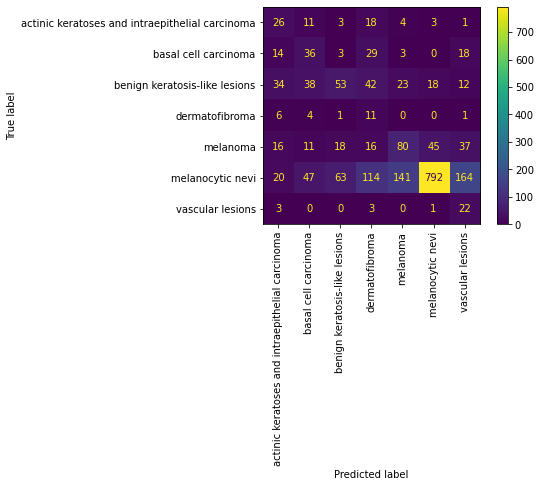

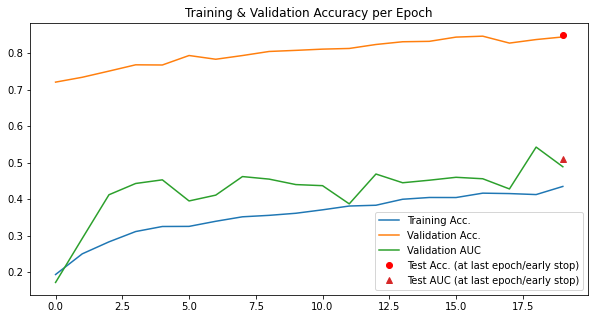

In [32]:
clf = run_classifier_pipeline(
    "dermamnist", info_flags, dermamnist_WSR_GDA,
    DA_technique=DA_technique
)

#### OctMNIST

{
  "python_class": "OCTMNIST",
  "description": "The OCTMNIST is based on a prior dataset of 109,309 valid optical coherence tomography (OCT) images for retinal diseases. The dataset is comprised of 4 diagnosis categories, leading to a multi-class classification task. We split the source training set with a ratio of 9:1 into training and validation set, and use its source validation set as the test set. The source images are gray-scale, and their sizes are (384\u22121,536)\u00d7(277\u2212512). We center-crop the images and resize them into 1\u00d728\u00d728.",
  "url": "https://zenodo.org/record/5208230/files/octmnist.npz?download=1",
  "MD5": "c68d92d5b585d8d81f7112f81e2d0842",
  "task": "multi-class",
  "label": {
    "0": "choroidal neovascularization",
    "1": "diabetic macular edema",
    "2": "drusen",
    "3": "normal"
  },
  "n_channels": 1,
  "n_samples": {
    "train": 97477,
    "val": 10832,
    "test": 1000
  },
  "license": "CC BY 4.0"
}
--------------------------------

100%|█████████████████████████████████████████| 762/762 [00:45<00:00, 16.63it/s]


train -- accuracy: 0.55
val -- accuracy: 0.91,  AUC: 0.76
Epoch 1



100%|█████████████████████████████████████████| 762/762 [00:55<00:00, 13.84it/s]


train -- accuracy: 0.71
val -- accuracy: 0.93,  AUC: 0.78
Epoch 2



100%|█████████████████████████████████████████| 762/762 [00:48<00:00, 15.87it/s]


train -- accuracy: 0.75
val -- accuracy: 0.94,  AUC: 0.79
Epoch 3



100%|█████████████████████████████████████████| 762/762 [00:53<00:00, 14.15it/s]


train -- accuracy: 0.77
val -- accuracy: 0.95,  AUC: 0.79
Epoch 4



100%|█████████████████████████████████████████| 762/762 [00:41<00:00, 18.38it/s]


train -- accuracy: 0.78
val -- accuracy: 0.95,  AUC: 0.8
Epoch 5



100%|█████████████████████████████████████████| 762/762 [00:46<00:00, 16.40it/s]


train -- accuracy: 0.8
val -- accuracy: 0.96,  AUC: 0.87
Epoch 6



100%|█████████████████████████████████████████| 762/762 [00:35<00:00, 21.75it/s]


train -- accuracy: 0.81
val -- accuracy: 0.96,  AUC: 0.8
Epoch 7



100%|█████████████████████████████████████████| 762/762 [00:34<00:00, 21.78it/s]


train -- accuracy: 0.82
val -- accuracy: 0.96,  AUC: 0.84
Epoch 8



100%|█████████████████████████████████████████| 762/762 [00:36<00:00, 21.15it/s]


train -- accuracy: 0.82
val -- accuracy: 0.96,  AUC: 0.85
Epoch 9



100%|█████████████████████████████████████████| 762/762 [00:35<00:00, 21.57it/s]


train -- accuracy: 0.83
val -- accuracy: 0.96,  AUC: 0.86
Epoch 10



100%|█████████████████████████████████████████| 762/762 [00:34<00:00, 21.94it/s]


train -- accuracy: 0.83
val -- accuracy: 0.96,  AUC: 0.83
Epoch 11



100%|█████████████████████████████████████████| 762/762 [00:48<00:00, 15.78it/s]


train -- accuracy: 0.84
val -- accuracy: 0.96,  AUC: 0.87
Epoch 12



100%|█████████████████████████████████████████| 762/762 [00:42<00:00, 17.87it/s]


train -- accuracy: 0.84
val -- accuracy: 0.96,  AUC: 0.79
Epoch 13



100%|█████████████████████████████████████████| 762/762 [00:52<00:00, 14.44it/s]


train -- accuracy: 0.84
val -- accuracy: 0.96,  AUC: 0.85
Epoch 14



100%|█████████████████████████████████████████| 762/762 [00:45<00:00, 16.66it/s]


train -- accuracy: 0.85
val -- accuracy: 0.97,  AUC: 0.84
Epoch 15



100%|█████████████████████████████████████████| 762/762 [00:44<00:00, 16.99it/s]


train -- accuracy: 0.85
val -- accuracy: 0.96,  AUC: 0.8
Epoch 16



100%|█████████████████████████████████████████| 762/762 [00:48<00:00, 15.61it/s]


train -- accuracy: 0.85
val -- accuracy: 0.96,  AUC: 0.85
Epoch 17



100%|█████████████████████████████████████████| 762/762 [00:47<00:00, 15.89it/s]


train -- accuracy: 0.85
val -- accuracy: 0.97,  AUC: 0.83
Epoch 18



100%|█████████████████████████████████████████| 762/762 [00:45<00:00, 16.58it/s]


train -- accuracy: 0.86
val -- accuracy: 0.97,  AUC: 0.86
Epoch 19



100%|█████████████████████████████████████████| 762/762 [00:44<00:00, 17.03it/s]


train -- accuracy: 0.86
val -- accuracy: 0.96,  AUC: 0.84
test -- accuracy: 0.94,  AUC: 0.73


<Figure size 720x720 with 0 Axes>

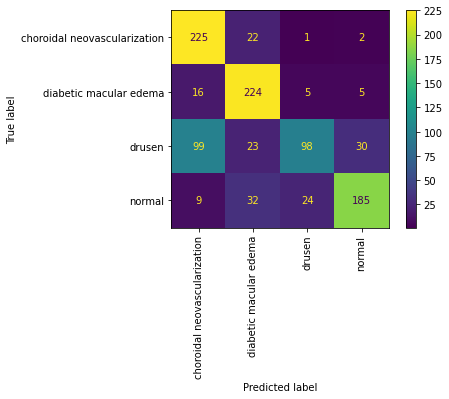

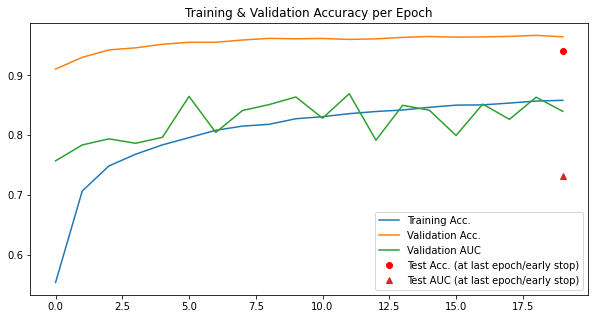

In [33]:
clf = run_classifier_pipeline(
    "octmnist", info_flags, octmnist_WSR_GDA,
    DA_technique=DA_technique
)

#### PneumoniaMNIST

{
  "python_class": "PneumoniaMNIST",
  "description": "The PneumoniaMNIST is based on a prior dataset of 5,856 pediatric chest X-Ray images. The task is binary-class classification of pneumonia against normal. We split the source training set with a ratio of 9:1 into training and validation set and use its source validation set as the test set. The source images are gray-scale, and their sizes are (384\u22122,916)\u00d7(127\u22122,713). We center-crop the images and resize them into 1\u00d728\u00d728.",
  "url": "https://zenodo.org/record/5208230/files/pneumoniamnist.npz?download=1",
  "MD5": "28209eda62fecd6e6a2d98b1501bb15f",
  "task": "binary-class",
  "label": {
    "0": "normal",
    "1": "pneumonia"
  },
  "n_channels": 1,
  "n_samples": {
    "train": 4708,
    "val": 524,
    "test": 624
  },
  "license": "CC BY 4.0"
}
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           

100%|███████████████████████████████████████████| 37/37 [00:02<00:00, 17.49it/s]


train -- accuracy: 0.61
val -- accuracy: 0.85,  AUC: 0.81
Epoch 1



100%|███████████████████████████████████████████| 37/37 [00:02<00:00, 18.06it/s]


train -- accuracy: 0.87
val -- accuracy: 0.95,  AUC: 0.88
Epoch 2



100%|███████████████████████████████████████████| 37/37 [00:02<00:00, 17.35it/s]


train -- accuracy: 0.9
val -- accuracy: 0.97,  AUC: 0.92
Epoch 3



100%|███████████████████████████████████████████| 37/37 [00:02<00:00, 17.92it/s]


train -- accuracy: 0.92
val -- accuracy: 0.98,  AUC: 0.92
Epoch 4



100%|███████████████████████████████████████████| 37/37 [00:01<00:00, 18.62it/s]


train -- accuracy: 0.92
val -- accuracy: 0.99,  AUC: 0.9
Epoch 5



100%|███████████████████████████████████████████| 37/37 [00:01<00:00, 18.77it/s]


train -- accuracy: 0.94
val -- accuracy: 0.99,  AUC: 0.96
Epoch 6



100%|███████████████████████████████████████████| 37/37 [00:02<00:00, 14.38it/s]


train -- accuracy: 0.94
val -- accuracy: 0.99,  AUC: 0.95
Epoch 7



100%|███████████████████████████████████████████| 37/37 [00:02<00:00, 15.43it/s]


train -- accuracy: 0.95
val -- accuracy: 0.99,  AUC: 0.96
Epoch 8



100%|███████████████████████████████████████████| 37/37 [00:02<00:00, 14.10it/s]


train -- accuracy: 0.95
val -- accuracy: 0.99,  AUC: 0.95
Epoch 9



100%|███████████████████████████████████████████| 37/37 [00:02<00:00, 12.74it/s]


train -- accuracy: 0.96
val -- accuracy: 0.99,  AUC: 0.96
Epoch 10



100%|███████████████████████████████████████████| 37/37 [00:02<00:00, 15.44it/s]


train -- accuracy: 0.95
val -- accuracy: 0.99,  AUC: 0.96
Epoch 11



100%|███████████████████████████████████████████| 37/37 [00:02<00:00, 14.56it/s]


train -- accuracy: 0.96
val -- accuracy: 0.99,  AUC: 0.95
Epoch 12



100%|███████████████████████████████████████████| 37/37 [00:02<00:00, 17.24it/s]


train -- accuracy: 0.96
val -- accuracy: 0.99,  AUC: 0.95
Epoch 13



100%|███████████████████████████████████████████| 37/37 [00:02<00:00, 14.75it/s]


train -- accuracy: 0.96
val -- accuracy: 0.99,  AUC: 0.96
Epoch 14



100%|███████████████████████████████████████████| 37/37 [00:02<00:00, 13.17it/s]


train -- accuracy: 0.97
val -- accuracy: 0.99,  AUC: 0.94
Epoch 15



100%|███████████████████████████████████████████| 37/37 [00:01<00:00, 19.08it/s]


train -- accuracy: 0.96
val -- accuracy: 0.99,  AUC: 0.96
Epoch 16



100%|███████████████████████████████████████████| 37/37 [00:01<00:00, 19.03it/s]


train -- accuracy: 0.97
val -- accuracy: 0.99,  AUC: 0.96
Epoch 17



100%|███████████████████████████████████████████| 37/37 [00:02<00:00, 17.16it/s]


train -- accuracy: 0.97
val -- accuracy: 0.99,  AUC: 0.95
Epoch 18



100%|███████████████████████████████████████████| 37/37 [00:02<00:00, 13.25it/s]


train -- accuracy: 0.97
val -- accuracy: 0.99,  AUC: 0.96
Epoch 19



100%|███████████████████████████████████████████| 37/37 [00:01<00:00, 18.60it/s]


train -- accuracy: 0.97
val -- accuracy: 0.99,  AUC: 0.96
test -- accuracy: 0.97,  AUC: 0.88


<Figure size 720x720 with 0 Axes>

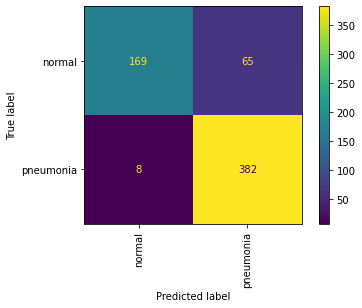

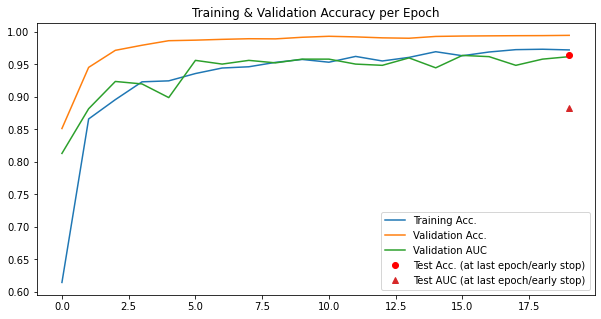

In [34]:
clf = run_classifier_pipeline(
    "pneumoniamnist", info_flags, pneumoniamnist_WSR_GDA,
    DA_technique=DA_technique
)

#### BreastMNIST

{
  "python_class": "BreastMNIST",
  "description": "The BreastMNIST is based on a dataset of 780 breast ultrasound images. It is categorized into 3 classes: normal, benign, and malignant. As we use low-resolution images, we simplify the task into binary classification by combining normal and benign as positive and classifying them against malignant as negative. We split the source dataset with a ratio of 7:1:2 into training, validation and test set. The source images of 1\u00d7500\u00d7500 are resized into 1\u00d728\u00d728.",
  "url": "https://zenodo.org/record/5208230/files/breastmnist.npz?download=1",
  "MD5": "750601b1f35ba3300ea97c75c52ff8f6",
  "task": "binary-class",
  "label": {
    "0": "malignant",
    "1": "normal, benign"
  },
  "n_channels": 1,
  "n_samples": {
    "train": 546,
    "val": 78,
    "test": 156
  },
  "license": "CC BY 4.0"
}
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
    

100%|█████████████████████████████████████████████| 5/5 [00:00<00:00, 19.57it/s]


train -- accuracy: 0.48
val -- accuracy: 0.54,  AUC: 0.27
Epoch 1



100%|█████████████████████████████████████████████| 5/5 [00:00<00:00, 20.75it/s]


train -- accuracy: 0.54
val -- accuracy: 0.48,  AUC: 0.71
Epoch 2



100%|█████████████████████████████████████████████| 5/5 [00:00<00:00, 20.81it/s]


train -- accuracy: 0.57
val -- accuracy: 0.43,  AUC: 0.72
Epoch 3



100%|█████████████████████████████████████████████| 5/5 [00:00<00:00, 14.17it/s]


train -- accuracy: 0.59
val -- accuracy: 0.53,  AUC: 0.72
Epoch 4



100%|█████████████████████████████████████████████| 5/5 [00:00<00:00, 14.86it/s]


train -- accuracy: 0.6
val -- accuracy: 0.57,  AUC: 0.76
Epoch 5



100%|█████████████████████████████████████████████| 5/5 [00:00<00:00, 17.37it/s]


train -- accuracy: 0.62
val -- accuracy: 0.68,  AUC: 0.72
Epoch 6



100%|█████████████████████████████████████████████| 5/5 [00:00<00:00, 18.48it/s]


train -- accuracy: 0.64
val -- accuracy: 0.72,  AUC: 0.74
Epoch 7



100%|█████████████████████████████████████████████| 5/5 [00:00<00:00, 16.25it/s]


train -- accuracy: 0.64
val -- accuracy: 0.73,  AUC: 0.73
Epoch 8



100%|█████████████████████████████████████████████| 5/5 [00:00<00:00, 20.47it/s]


train -- accuracy: 0.66
val -- accuracy: 0.73,  AUC: 0.69
Epoch 9



100%|█████████████████████████████████████████████| 5/5 [00:00<00:00, 15.95it/s]


train -- accuracy: 0.66
val -- accuracy: 0.73,  AUC: 0.71
Epoch 10



100%|█████████████████████████████████████████████| 5/5 [00:00<00:00, 19.54it/s]


train -- accuracy: 0.66
val -- accuracy: 0.74,  AUC: 0.69
Epoch 11



100%|█████████████████████████████████████████████| 5/5 [00:00<00:00, 19.44it/s]


train -- accuracy: 0.69
val -- accuracy: 0.74,  AUC: 0.71
Epoch 12



100%|█████████████████████████████████████████████| 5/5 [00:00<00:00, 17.11it/s]


train -- accuracy: 0.66
val -- accuracy: 0.73,  AUC: 0.68
Epoch 13



100%|█████████████████████████████████████████████| 5/5 [00:00<00:00, 19.66it/s]


train -- accuracy: 0.65
val -- accuracy: 0.73,  AUC: 0.68
Epoch 14



100%|█████████████████████████████████████████████| 5/5 [00:00<00:00, 15.86it/s]


train -- accuracy: 0.66
val -- accuracy: 0.74,  AUC: 0.65
Epoch 15



100%|█████████████████████████████████████████████| 5/5 [00:00<00:00, 21.27it/s]


train -- accuracy: 0.67
val -- accuracy: 0.74,  AUC: 0.65
Epoch 16



100%|█████████████████████████████████████████████| 5/5 [00:00<00:00, 20.23it/s]


train -- accuracy: 0.71
val -- accuracy: 0.74,  AUC: 0.65
Epoch 17



100%|█████████████████████████████████████████████| 5/5 [00:00<00:00, 21.26it/s]


train -- accuracy: 0.7
val -- accuracy: 0.74,  AUC: 0.65
Epoch 18



100%|█████████████████████████████████████████████| 5/5 [00:00<00:00, 15.54it/s]


train -- accuracy: 0.67
val -- accuracy: 0.74,  AUC: 0.69
Epoch 19



100%|█████████████████████████████████████████████| 5/5 [00:00<00:00, 17.95it/s]


train -- accuracy: 0.71
val -- accuracy: 0.74,  AUC: 0.68
test -- accuracy: 0.72,  AUC: 0.69


<Figure size 720x720 with 0 Axes>

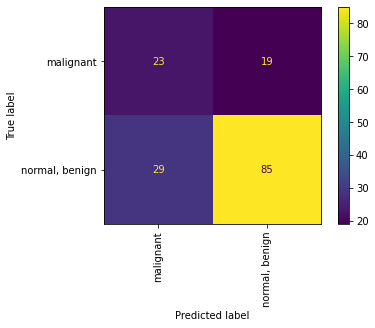

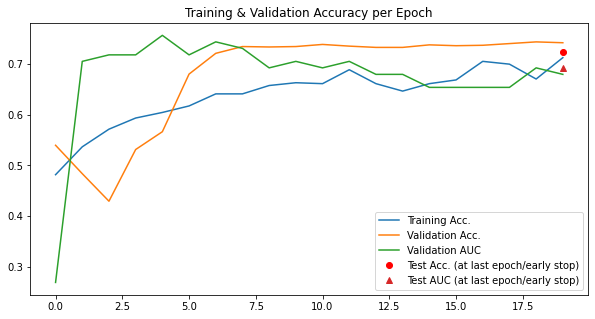

In [46]:
clf = run_classifier_pipeline(
    "breastmnist", info_flags, breastmnist_WSR_GDA,
    DA_technique=DA_technique
)

#### OrganAMNIST

{
  "python_class": "OrganAMNIST",
  "description": "The OrganAMNIST is based on 3D computed tomography (CT) images from Liver Tumor Segmentation Benchmark (LiTS). It is renamed from OrganMNIST_Axial (in MedMNIST v1) for simplicity. We use bounding-box annotations of 11 body organs from another study to obtain the organ labels. Hounsfield-Unit (HU) of the 3D images are transformed into gray-scale with an abdominal window. We crop 2D images from the center slices of the 3D bounding boxes in axial views (planes). The images are resized into 1\u00d728\u00d728 to perform multi-class classification of 11 body organs. 115 and 16 CT scans from the source training set are used as training and validation set, respectively. The 70 CT scans from the source test set are treated as the test set.",
  "url": "https://zenodo.org/record/5208230/files/organamnist.npz?download=1",
  "MD5": "866b832ed4eeba67bfb9edee1d5544e6",
  "task": "multi-class",
  "label": {
    "0": "bladder",
    "1": "femur-left",

100%|█████████████████████████████████████████| 271/271 [00:15<00:00, 17.34it/s]


train -- accuracy: 0.34
val -- accuracy: 0.93,  AUC: 0.5
Epoch 1



100%|█████████████████████████████████████████| 271/271 [00:15<00:00, 16.94it/s]


train -- accuracy: 0.58
val -- accuracy: 0.96,  AUC: 0.73
Epoch 2



100%|█████████████████████████████████████████| 271/271 [00:17<00:00, 15.89it/s]


train -- accuracy: 0.7
val -- accuracy: 0.99,  AUC: 0.85
Epoch 3



100%|█████████████████████████████████████████| 271/271 [00:17<00:00, 15.69it/s]


train -- accuracy: 0.79
val -- accuracy: 0.99,  AUC: 0.87
Epoch 4



100%|█████████████████████████████████████████| 271/271 [00:18<00:00, 14.58it/s]


train -- accuracy: 0.83
val -- accuracy: 0.99,  AUC: 0.9
Epoch 5



100%|█████████████████████████████████████████| 271/271 [00:16<00:00, 16.22it/s]


train -- accuracy: 0.85
val -- accuracy: 0.99,  AUC: 0.9
Epoch 6



100%|█████████████████████████████████████████| 271/271 [00:16<00:00, 16.13it/s]


train -- accuracy: 0.87
val -- accuracy: 1.0,  AUC: 0.92
Epoch 7



100%|█████████████████████████████████████████| 271/271 [00:16<00:00, 16.65it/s]


train -- accuracy: 0.88
val -- accuracy: 1.0,  AUC: 0.92
Epoch 8



100%|█████████████████████████████████████████| 271/271 [00:15<00:00, 17.25it/s]


train -- accuracy: 0.89
val -- accuracy: 1.0,  AUC: 0.92
Epoch 9



100%|█████████████████████████████████████████| 271/271 [00:15<00:00, 17.77it/s]


train -- accuracy: 0.9
val -- accuracy: 1.0,  AUC: 0.92
Epoch 10



100%|█████████████████████████████████████████| 271/271 [00:17<00:00, 15.07it/s]


train -- accuracy: 0.91
val -- accuracy: 1.0,  AUC: 0.92
Epoch 11



100%|█████████████████████████████████████████| 271/271 [00:17<00:00, 15.35it/s]


train -- accuracy: 0.92
val -- accuracy: 1.0,  AUC: 0.91
Epoch 12



100%|█████████████████████████████████████████| 271/271 [00:16<00:00, 16.59it/s]


train -- accuracy: 0.92
val -- accuracy: 1.0,  AUC: 0.91
Epoch 13



100%|█████████████████████████████████████████| 271/271 [00:16<00:00, 16.91it/s]


train -- accuracy: 0.93
val -- accuracy: 1.0,  AUC: 0.93
Epoch 14



100%|█████████████████████████████████████████| 271/271 [00:15<00:00, 17.26it/s]


train -- accuracy: 0.93
val -- accuracy: 1.0,  AUC: 0.92
Epoch 15



100%|█████████████████████████████████████████| 271/271 [00:15<00:00, 17.33it/s]


train -- accuracy: 0.93
val -- accuracy: 1.0,  AUC: 0.93
Epoch 16



100%|█████████████████████████████████████████| 271/271 [00:17<00:00, 15.93it/s]


train -- accuracy: 0.94
val -- accuracy: 1.0,  AUC: 0.93
Epoch 17



100%|█████████████████████████████████████████| 271/271 [00:16<00:00, 16.81it/s]


train -- accuracy: 0.94
val -- accuracy: 1.0,  AUC: 0.94
Epoch 18



100%|█████████████████████████████████████████| 271/271 [00:17<00:00, 15.35it/s]


train -- accuracy: 0.95
val -- accuracy: 1.0,  AUC: 0.94
Epoch 19



100%|█████████████████████████████████████████| 271/271 [00:15<00:00, 17.35it/s]


train -- accuracy: 0.95
val -- accuracy: 1.0,  AUC: 0.94
test -- accuracy: 0.99,  AUC: 0.85


<Figure size 720x720 with 0 Axes>

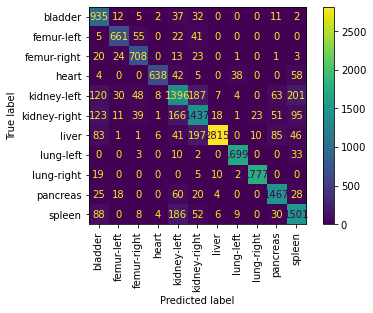

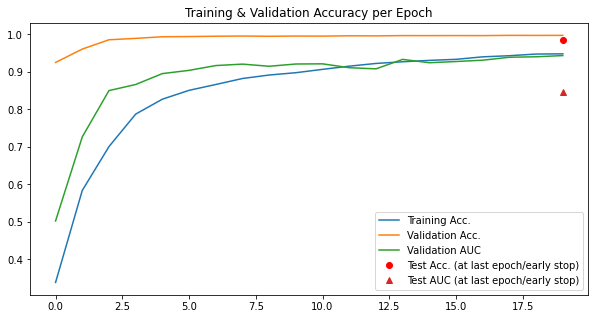

In [47]:
clf = run_classifier_pipeline(
    "organamnist", info_flags, organamnist_WSR_GDA,
    DA_technique=DA_technique
)

#### OrganCMNIST

{
  "python_class": "OrganCMNIST",
  "description": "The OrganCMNIST is based on 3D computed tomography (CT) images from Liver Tumor Segmentation Benchmark (LiTS). It is renamed from OrganMNIST_Coronal (in MedMNIST v1) for simplicity. We use bounding-box annotations of 11 body organs from another study to obtain the organ labels. Hounsfield-Unit (HU) of the 3D images are transformed into gray-scale with an abdominal window. We crop 2D images from the center slices of the 3D bounding boxes in coronal views (planes). The images are resized into 1\u00d728\u00d728 to perform multi-class classification of 11 body organs. 115 and 16 CT scans from the source training set are used as training and validation set, respectively. The 70 CT scans from the source test set are treated as the test set.",
  "url": "https://zenodo.org/record/5208230/files/organcmnist.npz?download=1",
  "MD5": "0afa5834fb105f7705a7d93372119a21",
  "task": "multi-class",
  "label": {
    "0": "bladder",
    "1": "femur-le

100%|█████████████████████████████████████████| 102/102 [00:05<00:00, 17.76it/s]


train -- accuracy: 0.21
val -- accuracy: 0.86,  AUC: 0.41
Epoch 1



100%|█████████████████████████████████████████| 102/102 [00:05<00:00, 17.32it/s]


train -- accuracy: 0.39
val -- accuracy: 0.91,  AUC: 0.52
Epoch 2



100%|█████████████████████████████████████████| 102/102 [00:06<00:00, 14.90it/s]


train -- accuracy: 0.49
val -- accuracy: 0.94,  AUC: 0.63
Epoch 3



100%|█████████████████████████████████████████| 102/102 [00:06<00:00, 16.69it/s]


train -- accuracy: 0.57
val -- accuracy: 0.96,  AUC: 0.69
Epoch 4



100%|█████████████████████████████████████████| 102/102 [00:05<00:00, 17.10it/s]


train -- accuracy: 0.64
val -- accuracy: 0.98,  AUC: 0.78
Epoch 5



100%|█████████████████████████████████████████| 102/102 [00:06<00:00, 15.43it/s]


train -- accuracy: 0.67
val -- accuracy: 0.98,  AUC: 0.76
Epoch 6



100%|█████████████████████████████████████████| 102/102 [00:05<00:00, 18.29it/s]


train -- accuracy: 0.7
val -- accuracy: 0.98,  AUC: 0.82
Epoch 7



100%|█████████████████████████████████████████| 102/102 [00:05<00:00, 17.86it/s]


train -- accuracy: 0.73
val -- accuracy: 0.99,  AUC: 0.83
Epoch 8



100%|█████████████████████████████████████████| 102/102 [00:05<00:00, 17.70it/s]


train -- accuracy: 0.75
val -- accuracy: 0.99,  AUC: 0.86
Epoch 9



100%|█████████████████████████████████████████| 102/102 [00:05<00:00, 17.50it/s]


train -- accuracy: 0.77
val -- accuracy: 0.99,  AUC: 0.86
Epoch 10



100%|█████████████████████████████████████████| 102/102 [00:05<00:00, 17.57it/s]


train -- accuracy: 0.78
val -- accuracy: 0.99,  AUC: 0.89
Epoch 11



100%|█████████████████████████████████████████| 102/102 [00:06<00:00, 15.91it/s]


train -- accuracy: 0.8
val -- accuracy: 0.99,  AUC: 0.9
Epoch 12



100%|█████████████████████████████████████████| 102/102 [00:07<00:00, 13.25it/s]


train -- accuracy: 0.81
val -- accuracy: 0.99,  AUC: 0.91
Epoch 13



100%|█████████████████████████████████████████| 102/102 [00:05<00:00, 17.45it/s]


train -- accuracy: 0.82
val -- accuracy: 0.99,  AUC: 0.92
Epoch 14



100%|█████████████████████████████████████████| 102/102 [00:06<00:00, 16.29it/s]


train -- accuracy: 0.83
val -- accuracy: 0.99,  AUC: 0.9
Epoch 15



100%|█████████████████████████████████████████| 102/102 [00:06<00:00, 15.81it/s]


train -- accuracy: 0.84
val -- accuracy: 1.0,  AUC: 0.91
Epoch 16



100%|█████████████████████████████████████████| 102/102 [00:06<00:00, 15.53it/s]


train -- accuracy: 0.84
val -- accuracy: 0.99,  AUC: 0.89
Epoch 17



100%|█████████████████████████████████████████| 102/102 [00:05<00:00, 17.02it/s]


train -- accuracy: 0.84
val -- accuracy: 1.0,  AUC: 0.92
Epoch 18



100%|█████████████████████████████████████████| 102/102 [00:07<00:00, 13.57it/s]


train -- accuracy: 0.85
val -- accuracy: 1.0,  AUC: 0.92
Epoch 19



100%|█████████████████████████████████████████| 102/102 [00:09<00:00, 11.28it/s]


train -- accuracy: 0.85
val -- accuracy: 1.0,  AUC: 0.93
test -- accuracy: 0.97,  AUC: 0.78


<Figure size 720x720 with 0 Axes>

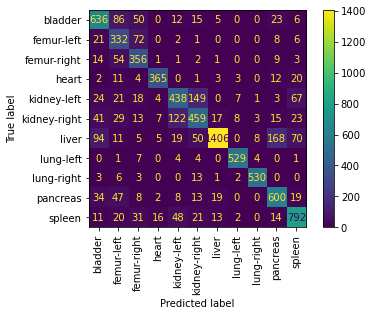

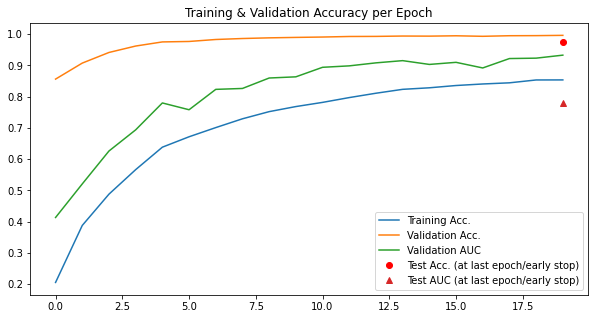

In [48]:
clf = run_classifier_pipeline(
    "organcmnist", info_flags, organcmnist_WSR_GDA,
    DA_technique=DA_technique
)

#### OrganSMNIST

{
  "python_class": "OrganSMNIST",
  "description": "The OrganSMNIST is based on 3D computed tomography (CT) images from Liver Tumor Segmentation Benchmark (LiTS). It is renamed from OrganMNIST_Sagittal (in MedMNIST v1) for simplicity. We use bounding-box annotations of 11 body organs from another study to obtain the organ labels. Hounsfield-Unit (HU) of the 3D images are transformed into gray-scale with an abdominal window. We crop 2D images from the center slices of the 3D bounding boxes in sagittal views (planes). The images are resized into 1\u00d728\u00d728 to perform multi-class classification of 11 body organs. 115 and 16 CT scans from the source training set are used as training and validation set, respectively. The 70 CT scans from the source test set are treated as the test set.",
  "url": "https://zenodo.org/record/5208230/files/organsmnist.npz?download=1",
  "MD5": "e5c39f1af030238290b9557d9503af9d",
  "task": "multi-class",
  "label": {
    "0": "bladder",
    "1": "femur-

100%|█████████████████████████████████████████| 109/109 [00:07<00:00, 14.70it/s]


train -- accuracy: 0.15
val -- accuracy: 0.78,  AUC: 0.2
Epoch 1



100%|█████████████████████████████████████████| 109/109 [00:06<00:00, 15.76it/s]


train -- accuracy: 0.27
val -- accuracy: 0.85,  AUC: 0.25
Epoch 2



100%|█████████████████████████████████████████| 109/109 [00:06<00:00, 17.16it/s]


train -- accuracy: 0.35
val -- accuracy: 0.89,  AUC: 0.41
Epoch 3



100%|█████████████████████████████████████████| 109/109 [00:06<00:00, 16.34it/s]


train -- accuracy: 0.42
val -- accuracy: 0.9,  AUC: 0.45
Epoch 4



100%|█████████████████████████████████████████| 109/109 [00:09<00:00, 11.81it/s]


train -- accuracy: 0.46
val -- accuracy: 0.92,  AUC: 0.51
Epoch 5



100%|█████████████████████████████████████████| 109/109 [00:07<00:00, 15.07it/s]


train -- accuracy: 0.49
val -- accuracy: 0.93,  AUC: 0.52
Epoch 6



100%|█████████████████████████████████████████| 109/109 [00:07<00:00, 14.34it/s]


train -- accuracy: 0.52
val -- accuracy: 0.94,  AUC: 0.48
Epoch 7



100%|█████████████████████████████████████████| 109/109 [00:06<00:00, 17.23it/s]


train -- accuracy: 0.54
val -- accuracy: 0.95,  AUC: 0.56
Epoch 8



100%|█████████████████████████████████████████| 109/109 [00:07<00:00, 15.50it/s]


train -- accuracy: 0.56
val -- accuracy: 0.96,  AUC: 0.6
Epoch 9



100%|█████████████████████████████████████████| 109/109 [00:07<00:00, 13.90it/s]


train -- accuracy: 0.58
val -- accuracy: 0.96,  AUC: 0.62
Epoch 10



100%|█████████████████████████████████████████| 109/109 [00:06<00:00, 18.01it/s]


train -- accuracy: 0.6
val -- accuracy: 0.96,  AUC: 0.63
Epoch 11



100%|█████████████████████████████████████████| 109/109 [00:06<00:00, 16.53it/s]


train -- accuracy: 0.61
val -- accuracy: 0.97,  AUC: 0.72
Epoch 12



100%|█████████████████████████████████████████| 109/109 [00:09<00:00, 11.82it/s]


train -- accuracy: 0.64
val -- accuracy: 0.97,  AUC: 0.66
Epoch 13



100%|█████████████████████████████████████████| 109/109 [00:09<00:00, 11.65it/s]


train -- accuracy: 0.64
val -- accuracy: 0.98,  AUC: 0.74
Epoch 14



100%|█████████████████████████████████████████| 109/109 [00:09<00:00, 11.81it/s]


train -- accuracy: 0.66
val -- accuracy: 0.98,  AUC: 0.74
Epoch 15



100%|█████████████████████████████████████████| 109/109 [00:09<00:00, 12.01it/s]


train -- accuracy: 0.67
val -- accuracy: 0.98,  AUC: 0.74
Epoch 16



100%|█████████████████████████████████████████| 109/109 [00:07<00:00, 14.68it/s]


train -- accuracy: 0.68
val -- accuracy: 0.98,  AUC: 0.74
Epoch 17



100%|█████████████████████████████████████████| 109/109 [00:07<00:00, 14.06it/s]


train -- accuracy: 0.69
val -- accuracy: 0.98,  AUC: 0.79
Epoch 18



100%|█████████████████████████████████████████| 109/109 [00:06<00:00, 17.65it/s]


train -- accuracy: 0.7
val -- accuracy: 0.98,  AUC: 0.74
Epoch 19



100%|█████████████████████████████████████████| 109/109 [00:07<00:00, 14.57it/s]


train -- accuracy: 0.71
val -- accuracy: 0.98,  AUC: 0.76
test -- accuracy: 0.94,  AUC: 0.59


<Figure size 720x720 with 0 Axes>

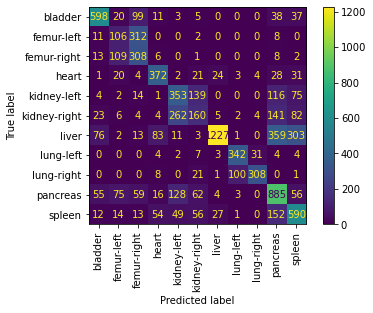

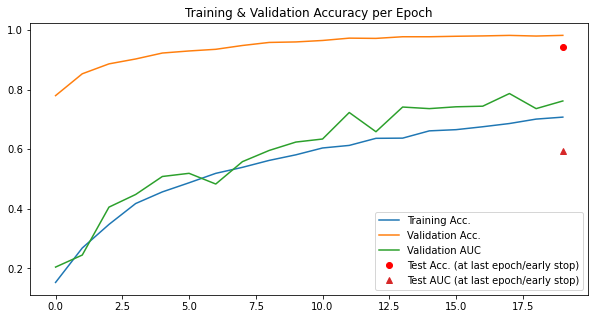

In [49]:
clf = run_classifier_pipeline(
    "organsmnist", info_flags, organsmnist_WSR_GDA,
    DA_technique=DA_technique
)

### 3.4. Training on the MedMNIST datasets with GDA but without WSR

In [12]:
# Declares the baseline setup to save the related model
DA_technique="_noWSR_GDA"

#### PathMNIST

{
  "python_class": "PathMNIST",
  "description": "The PathMNIST is based on a prior study for predicting survival from colorectal cancer histology slides, providing a dataset (NCT-CRC-HE-100K) of 100,000 non-overlapping image patches from hematoxylin & eosin stained histological images, and a test dataset (CRC-VAL-HE-7K) of 7,180 image patches from a different clinical center. The dataset is comprised of 9 types of tissues, resulting in a multi-class classification task. We resize the source images of 3\u00d7224\u00d7224 into 3\u00d728\u00d728, and split NCT-CRC-HE-100K into training and validation set with a ratio of 9:1. The CRC-VAL-HE-7K is treated as the test set.",
  "url": "https://zenodo.org/record/5208230/files/pathmnist.npz?download=1",
  "MD5": "a8b06965200029087d5bd730944a56c1",
  "task": "multi-class",
  "label": {
    "0": "adipose",
    "1": "background",
    "2": "debris",
    "3": "lymphocytes",
    "4": "mucus",
    "5": "smooth muscle",
    "6": "normal colon mucosa"

100%|█████████████████████████████████████████| 704/704 [02:37<00:00,  4.46it/s]


train -- accuracy: 0.41
val -- accuracy: 0.9,  AUC: 0.55
Epoch 1



100%|█████████████████████████████████████████| 704/704 [02:29<00:00,  4.72it/s]


train -- accuracy: 0.58
val -- accuracy: 0.93,  AUC: 0.62
Epoch 2



100%|█████████████████████████████████████████| 704/704 [02:37<00:00,  4.48it/s]


train -- accuracy: 0.64
val -- accuracy: 0.95,  AUC: 0.68
Epoch 3



100%|█████████████████████████████████████████| 704/704 [02:24<00:00,  4.89it/s]


train -- accuracy: 0.68
val -- accuracy: 0.96,  AUC: 0.72
Epoch 4



100%|█████████████████████████████████████████| 704/704 [02:06<00:00,  5.55it/s]


train -- accuracy: 0.71
val -- accuracy: 0.97,  AUC: 0.76
Epoch 5



100%|█████████████████████████████████████████| 704/704 [02:16<00:00,  5.14it/s]


train -- accuracy: 0.73
val -- accuracy: 0.96,  AUC: 0.72
Epoch 6



100%|█████████████████████████████████████████| 704/704 [02:04<00:00,  5.66it/s]


train -- accuracy: 0.74
val -- accuracy: 0.97,  AUC: 0.79
Epoch 7



100%|█████████████████████████████████████████| 704/704 [02:30<00:00,  4.69it/s]


train -- accuracy: 0.76
val -- accuracy: 0.98,  AUC: 0.8
Epoch 8



100%|█████████████████████████████████████████| 704/704 [02:13<00:00,  5.27it/s]


train -- accuracy: 0.77
val -- accuracy: 0.98,  AUC: 0.8
Epoch 9



100%|█████████████████████████████████████████| 704/704 [02:13<00:00,  5.26it/s]


train -- accuracy: 0.78
val -- accuracy: 0.98,  AUC: 0.83
Epoch 10



100%|█████████████████████████████████████████| 704/704 [02:14<00:00,  5.22it/s]


train -- accuracy: 0.79
val -- accuracy: 0.97,  AUC: 0.77
Epoch 11



100%|█████████████████████████████████████████| 704/704 [02:12<00:00,  5.31it/s]


train -- accuracy: 0.8
val -- accuracy: 0.98,  AUC: 0.82
Epoch 12



100%|█████████████████████████████████████████| 704/704 [02:20<00:00,  5.01it/s]


train -- accuracy: 0.8
val -- accuracy: 0.98,  AUC: 0.85
Epoch 13



100%|█████████████████████████████████████████| 704/704 [02:17<00:00,  5.11it/s]


train -- accuracy: 0.81
val -- accuracy: 0.98,  AUC: 0.81
Epoch 14



100%|█████████████████████████████████████████| 704/704 [02:36<00:00,  4.50it/s]


train -- accuracy: 0.81
val -- accuracy: 0.99,  AUC: 0.86
Epoch 15



100%|█████████████████████████████████████████| 704/704 [02:53<00:00,  4.06it/s]


train -- accuracy: 0.82
val -- accuracy: 0.99,  AUC: 0.85
Epoch 16



100%|█████████████████████████████████████████| 704/704 [02:49<00:00,  4.14it/s]


train -- accuracy: 0.82
val -- accuracy: 0.99,  AUC: 0.86
Epoch 17



100%|█████████████████████████████████████████| 704/704 [03:06<00:00,  3.78it/s]


train -- accuracy: 0.82
val -- accuracy: 0.99,  AUC: 0.86
Epoch 18



100%|█████████████████████████████████████████| 704/704 [02:59<00:00,  3.92it/s]


train -- accuracy: 0.83
val -- accuracy: 0.99,  AUC: 0.87
Epoch 19



100%|█████████████████████████████████████████| 704/704 [03:01<00:00,  3.87it/s]


train -- accuracy: 0.83
val -- accuracy: 0.99,  AUC: 0.86
test -- accuracy: 0.99,  AUC: 0.86


<Figure size 720x720 with 0 Axes>

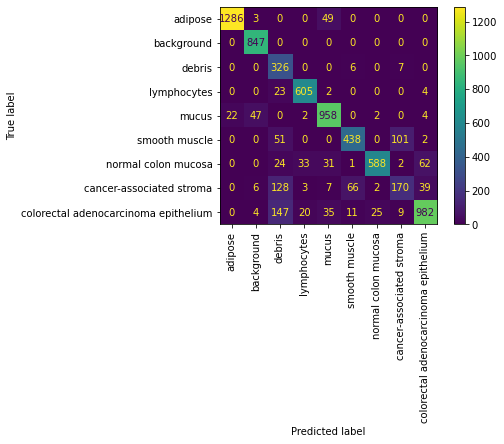

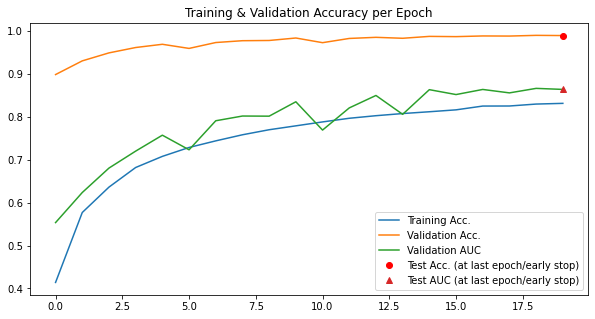

In [13]:
clf = run_classifier_pipeline(
    "pathmnist", info_flags, pathmnist_noWSR_GDA,
    DA_technique=DA_technique
)

#### DermaMNIST

{
  "python_class": "DermaMNIST",
  "description": "The DermaMNIST is based on the HAM10000, a large collection of multi-source dermatoscopic images of common pigmented skin lesions. The dataset consists of 10,015 dermatoscopic images categorized as 7 different diseases, formulized as a multi-class classification task. We split the images into training, validation and test set with a ratio of 7:1:2. The source images of 3\u00d7600\u00d7450 are resized into 3\u00d728\u00d728.",
  "url": "https://zenodo.org/record/5208230/files/dermamnist.npz?download=1",
  "MD5": "0744692d530f8e62ec473284d019b0c7",
  "task": "multi-class",
  "label": {
    "0": "actinic keratoses and intraepithelial carcinoma",
    "1": "basal cell carcinoma",
    "2": "benign keratosis-like lesions",
    "3": "dermatofibroma",
    "4": "melanoma",
    "5": "melanocytic nevi",
    "6": "vascular lesions"
  },
  "n_channels": 3,
  "n_samples": {
    "train": 7007,
    "val": 1003,
    "test": 2005
  },
  "license": "CC B

100%|███████████████████████████████████████████| 55/55 [00:11<00:00,  4.83it/s]


train -- accuracy: 0.19
val -- accuracy: 0.73,  AUC: 0.31
Epoch 1



100%|███████████████████████████████████████████| 55/55 [00:11<00:00,  4.75it/s]


train -- accuracy: 0.25
val -- accuracy: 0.74,  AUC: 0.35
Epoch 2



100%|███████████████████████████████████████████| 55/55 [00:11<00:00,  4.93it/s]


train -- accuracy: 0.29
val -- accuracy: 0.75,  AUC: 0.24
Epoch 3



100%|███████████████████████████████████████████| 55/55 [00:12<00:00,  4.41it/s]


train -- accuracy: 0.29
val -- accuracy: 0.76,  AUC: 0.41
Epoch 4



100%|███████████████████████████████████████████| 55/55 [00:11<00:00,  4.80it/s]


train -- accuracy: 0.33
val -- accuracy: 0.78,  AUC: 0.45
Epoch 5



100%|███████████████████████████████████████████| 55/55 [00:10<00:00,  5.02it/s]


train -- accuracy: 0.33
val -- accuracy: 0.8,  AUC: 0.49
Epoch 6



100%|███████████████████████████████████████████| 55/55 [00:12<00:00,  4.49it/s]


train -- accuracy: 0.33
val -- accuracy: 0.79,  AUC: 0.42
Epoch 7



100%|███████████████████████████████████████████| 55/55 [00:11<00:00,  4.78it/s]


train -- accuracy: 0.35
val -- accuracy: 0.79,  AUC: 0.44
Epoch 8



100%|███████████████████████████████████████████| 55/55 [00:10<00:00,  5.01it/s]


train -- accuracy: 0.35
val -- accuracy: 0.8,  AUC: 0.42
Epoch 9



100%|███████████████████████████████████████████| 55/55 [00:10<00:00,  5.05it/s]


train -- accuracy: 0.37
val -- accuracy: 0.82,  AUC: 0.46
Epoch 10



100%|███████████████████████████████████████████| 55/55 [00:10<00:00,  5.14it/s]


train -- accuracy: 0.37
val -- accuracy: 0.82,  AUC: 0.46
Epoch 11



100%|███████████████████████████████████████████| 55/55 [00:10<00:00,  5.01it/s]


train -- accuracy: 0.4
val -- accuracy: 0.82,  AUC: 0.43
Epoch 12



100%|███████████████████████████████████████████| 55/55 [00:10<00:00,  5.18it/s]


train -- accuracy: 0.39
val -- accuracy: 0.83,  AUC: 0.45
Epoch 13



100%|███████████████████████████████████████████| 55/55 [00:11<00:00,  4.82it/s]


train -- accuracy: 0.4
val -- accuracy: 0.83,  AUC: 0.44
Epoch 14



100%|███████████████████████████████████████████| 55/55 [00:10<00:00,  5.14it/s]


train -- accuracy: 0.41
val -- accuracy: 0.83,  AUC: 0.49
Epoch 15



100%|███████████████████████████████████████████| 55/55 [00:10<00:00,  5.17it/s]


train -- accuracy: 0.42
val -- accuracy: 0.83,  AUC: 0.48
Epoch 16



100%|███████████████████████████████████████████| 55/55 [00:10<00:00,  5.09it/s]


train -- accuracy: 0.42
val -- accuracy: 0.85,  AUC: 0.5
Epoch 17



100%|███████████████████████████████████████████| 55/55 [00:12<00:00,  4.53it/s]


train -- accuracy: 0.43
val -- accuracy: 0.84,  AUC: 0.5
Epoch 18



100%|███████████████████████████████████████████| 55/55 [00:10<00:00,  5.10it/s]


train -- accuracy: 0.43
val -- accuracy: 0.84,  AUC: 0.48
Epoch 19



100%|███████████████████████████████████████████| 55/55 [00:14<00:00,  3.92it/s]


train -- accuracy: 0.44
val -- accuracy: 0.85,  AUC: 0.52
test -- accuracy: 0.85,  AUC: 0.52


<Figure size 720x720 with 0 Axes>

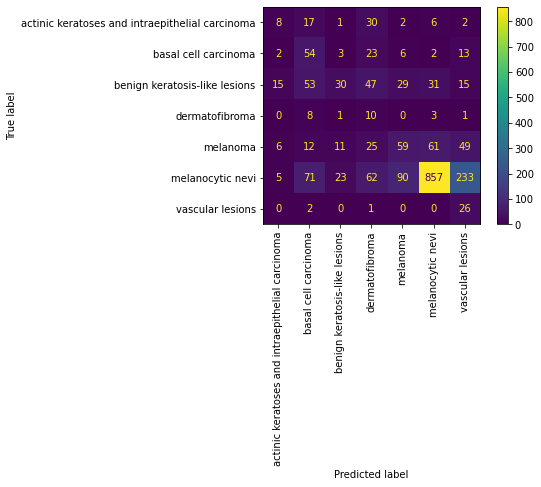

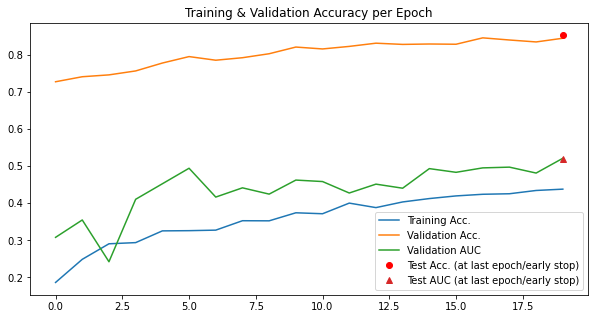

In [14]:
clf = run_classifier_pipeline(
    "dermamnist", info_flags, dermamnist_noWSR_GDA,
    DA_technique=DA_technique
)

#### OctMNIST

{
  "python_class": "OCTMNIST",
  "description": "The OCTMNIST is based on a prior dataset of 109,309 valid optical coherence tomography (OCT) images for retinal diseases. The dataset is comprised of 4 diagnosis categories, leading to a multi-class classification task. We split the source training set with a ratio of 9:1 into training and validation set, and use its source validation set as the test set. The source images are gray-scale, and their sizes are (384\u22121,536)\u00d7(277\u2212512). We center-crop the images and resize them into 1\u00d728\u00d728.",
  "url": "https://zenodo.org/record/5208230/files/octmnist.npz?download=1",
  "MD5": "c68d92d5b585d8d81f7112f81e2d0842",
  "task": "multi-class",
  "label": {
    "0": "choroidal neovascularization",
    "1": "diabetic macular edema",
    "2": "drusen",
    "3": "normal"
  },
  "n_channels": 1,
  "n_samples": {
    "train": 97477,
    "val": 10832,
    "test": 1000
  },
  "license": "CC BY 4.0"
}
--------------------------------

100%|█████████████████████████████████████████| 762/762 [00:40<00:00, 18.99it/s]


train -- accuracy: 0.55
val -- accuracy: 0.89,  AUC: 0.7
Epoch 1



100%|█████████████████████████████████████████| 762/762 [00:42<00:00, 18.10it/s]


train -- accuracy: 0.71
val -- accuracy: 0.93,  AUC: 0.77
Epoch 2



100%|█████████████████████████████████████████| 762/762 [00:54<00:00, 13.91it/s]


train -- accuracy: 0.75
val -- accuracy: 0.94,  AUC: 0.74
Epoch 3



100%|█████████████████████████████████████████| 762/762 [00:42<00:00, 18.07it/s]


train -- accuracy: 0.77
val -- accuracy: 0.94,  AUC: 0.74
Epoch 4



100%|█████████████████████████████████████████| 762/762 [00:41<00:00, 18.33it/s]


train -- accuracy: 0.78
val -- accuracy: 0.95,  AUC: 0.84
Epoch 5



100%|█████████████████████████████████████████| 762/762 [00:38<00:00, 19.63it/s]


train -- accuracy: 0.79
val -- accuracy: 0.96,  AUC: 0.79
Epoch 6



100%|█████████████████████████████████████████| 762/762 [00:38<00:00, 19.84it/s]


train -- accuracy: 0.81
val -- accuracy: 0.96,  AUC: 0.82
Epoch 7



100%|█████████████████████████████████████████| 762/762 [00:40<00:00, 18.92it/s]


train -- accuracy: 0.81
val -- accuracy: 0.96,  AUC: 0.84
Epoch 8



100%|█████████████████████████████████████████| 762/762 [00:38<00:00, 19.62it/s]


train -- accuracy: 0.82
val -- accuracy: 0.96,  AUC: 0.84
Epoch 9



100%|█████████████████████████████████████████| 762/762 [00:38<00:00, 19.67it/s]


train -- accuracy: 0.83
val -- accuracy: 0.96,  AUC: 0.86
Epoch 10



100%|█████████████████████████████████████████| 762/762 [00:39<00:00, 19.39it/s]


train -- accuracy: 0.83
val -- accuracy: 0.96,  AUC: 0.8
Epoch 11



100%|█████████████████████████████████████████| 762/762 [00:39<00:00, 19.49it/s]


train -- accuracy: 0.83
val -- accuracy: 0.96,  AUC: 0.87
Epoch 12



100%|█████████████████████████████████████████| 762/762 [00:42<00:00, 17.77it/s]


train -- accuracy: 0.84
val -- accuracy: 0.96,  AUC: 0.83
Epoch 13



100%|█████████████████████████████████████████| 762/762 [00:40<00:00, 18.75it/s]


train -- accuracy: 0.84
val -- accuracy: 0.97,  AUC: 0.88
Epoch 14



100%|█████████████████████████████████████████| 762/762 [00:38<00:00, 19.82it/s]


train -- accuracy: 0.85
val -- accuracy: 0.96,  AUC: 0.87
Epoch 15



100%|█████████████████████████████████████████| 762/762 [00:41<00:00, 18.53it/s]


train -- accuracy: 0.85
val -- accuracy: 0.96,  AUC: 0.82
Epoch 16



100%|█████████████████████████████████████████| 762/762 [00:40<00:00, 18.71it/s]


train -- accuracy: 0.85
val -- accuracy: 0.97,  AUC: 0.88
Epoch 17



100%|█████████████████████████████████████████| 762/762 [00:52<00:00, 14.64it/s]


train -- accuracy: 0.85
val -- accuracy: 0.97,  AUC: 0.84
Epoch 18



100%|█████████████████████████████████████████| 762/762 [00:51<00:00, 14.89it/s]


train -- accuracy: 0.86
val -- accuracy: 0.97,  AUC: 0.88
Epoch 19



100%|█████████████████████████████████████████| 762/762 [00:57<00:00, 13.26it/s]


train -- accuracy: 0.86
val -- accuracy: 0.97,  AUC: 0.85
test -- accuracy: 0.95,  AUC: 0.79


<Figure size 720x720 with 0 Axes>

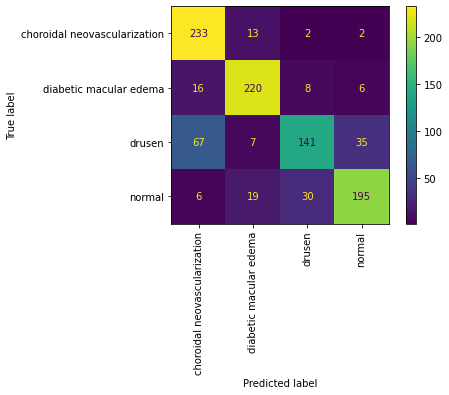

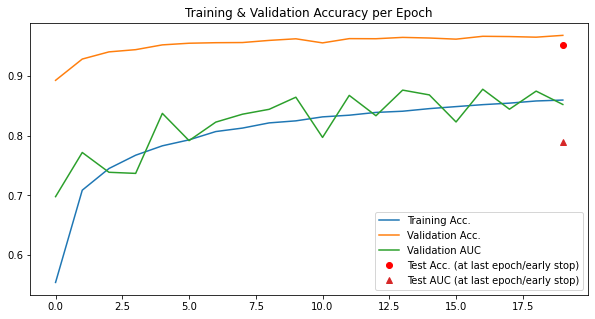

In [15]:
clf = run_classifier_pipeline(
    "octmnist", info_flags, octmnist_noWSR_GDA,
    DA_technique=DA_technique
)

#### PneumoniaMNIST

{
  "python_class": "PneumoniaMNIST",
  "description": "The PneumoniaMNIST is based on a prior dataset of 5,856 pediatric chest X-Ray images. The task is binary-class classification of pneumonia against normal. We split the source training set with a ratio of 9:1 into training and validation set and use its source validation set as the test set. The source images are gray-scale, and their sizes are (384\u22122,916)\u00d7(127\u22122,713). We center-crop the images and resize them into 1\u00d728\u00d728.",
  "url": "https://zenodo.org/record/5208230/files/pneumoniamnist.npz?download=1",
  "MD5": "28209eda62fecd6e6a2d98b1501bb15f",
  "task": "binary-class",
  "label": {
    "0": "normal",
    "1": "pneumonia"
  },
  "n_channels": 1,
  "n_samples": {
    "train": 4708,
    "val": 524,
    "test": 624
  },
  "license": "CC BY 4.0"
}
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           

100%|███████████████████████████████████████████| 37/37 [00:02<00:00, 14.12it/s]


train -- accuracy: 0.6
val -- accuracy: 0.93,  AUC: 0.78
Epoch 1



100%|███████████████████████████████████████████| 37/37 [00:02<00:00, 15.82it/s]


train -- accuracy: 0.87
val -- accuracy: 0.96,  AUC: 0.9
Epoch 2



100%|███████████████████████████████████████████| 37/37 [00:02<00:00, 16.55it/s]


train -- accuracy: 0.9
val -- accuracy: 0.96,  AUC: 0.9
Epoch 3



100%|███████████████████████████████████████████| 37/37 [00:02<00:00, 18.36it/s]


train -- accuracy: 0.92
val -- accuracy: 0.98,  AUC: 0.91
Epoch 4



100%|███████████████████████████████████████████| 37/37 [00:02<00:00, 17.34it/s]


train -- accuracy: 0.93
val -- accuracy: 0.98,  AUC: 0.94
Epoch 5



100%|███████████████████████████████████████████| 37/37 [00:01<00:00, 18.94it/s]


train -- accuracy: 0.93
val -- accuracy: 0.98,  AUC: 0.95
Epoch 6



100%|███████████████████████████████████████████| 37/37 [00:02<00:00, 17.47it/s]


train -- accuracy: 0.95
val -- accuracy: 0.98,  AUC: 0.95
Epoch 7



100%|███████████████████████████████████████████| 37/37 [00:02<00:00, 16.60it/s]


train -- accuracy: 0.94
val -- accuracy: 0.98,  AUC: 0.9
Epoch 8



100%|███████████████████████████████████████████| 37/37 [00:02<00:00, 14.29it/s]


train -- accuracy: 0.94
val -- accuracy: 0.99,  AUC: 0.92
Epoch 9



100%|███████████████████████████████████████████| 37/37 [00:02<00:00, 14.39it/s]


train -- accuracy: 0.95
val -- accuracy: 0.99,  AUC: 0.95
Epoch 10



100%|███████████████████████████████████████████| 37/37 [00:02<00:00, 16.02it/s]


train -- accuracy: 0.96
val -- accuracy: 0.99,  AUC: 0.96
Epoch 11



100%|███████████████████████████████████████████| 37/37 [00:02<00:00, 14.80it/s]


train -- accuracy: 0.96
val -- accuracy: 0.99,  AUC: 0.95
Epoch 12



100%|███████████████████████████████████████████| 37/37 [00:03<00:00, 12.23it/s]


train -- accuracy: 0.95
val -- accuracy: 0.99,  AUC: 0.96
Epoch 13



100%|███████████████████████████████████████████| 37/37 [00:02<00:00, 12.36it/s]


train -- accuracy: 0.96
val -- accuracy: 0.99,  AUC: 0.96
Epoch 14



100%|███████████████████████████████████████████| 37/37 [00:02<00:00, 16.30it/s]


train -- accuracy: 0.96
val -- accuracy: 0.99,  AUC: 0.96
Epoch 15



100%|███████████████████████████████████████████| 37/37 [00:02<00:00, 16.35it/s]


train -- accuracy: 0.97
val -- accuracy: 0.99,  AUC: 0.96
Epoch 16



100%|███████████████████████████████████████████| 37/37 [00:02<00:00, 16.35it/s]


train -- accuracy: 0.96
val -- accuracy: 0.99,  AUC: 0.96
Epoch 17



100%|███████████████████████████████████████████| 37/37 [00:02<00:00, 16.22it/s]


train -- accuracy: 0.96
val -- accuracy: 0.99,  AUC: 0.96
Epoch 18



100%|███████████████████████████████████████████| 37/37 [00:02<00:00, 14.22it/s]


train -- accuracy: 0.96
val -- accuracy: 0.99,  AUC: 0.95
Epoch 19



100%|███████████████████████████████████████████| 37/37 [00:02<00:00, 14.20it/s]


train -- accuracy: 0.97
val -- accuracy: 0.99,  AUC: 0.96
test -- accuracy: 0.97,  AUC: 0.87


<Figure size 720x720 with 0 Axes>

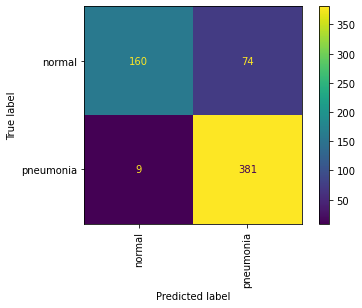

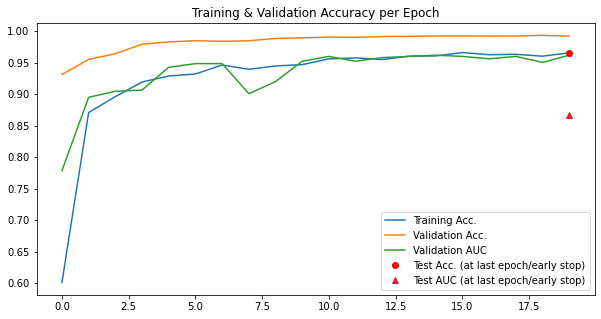

In [16]:
clf = run_classifier_pipeline(
    "pneumoniamnist", info_flags, pneumoniamnist_noWSR_GDA,
    DA_technique=DA_technique
)

#### BreastMNIST

{
  "python_class": "BreastMNIST",
  "description": "The BreastMNIST is based on a dataset of 780 breast ultrasound images. It is categorized into 3 classes: normal, benign, and malignant. As we use low-resolution images, we simplify the task into binary classification by combining normal and benign as positive and classifying them against malignant as negative. We split the source dataset with a ratio of 7:1:2 into training, validation and test set. The source images of 1\u00d7500\u00d7500 are resized into 1\u00d728\u00d728.",
  "url": "https://zenodo.org/record/5208230/files/breastmnist.npz?download=1",
  "MD5": "750601b1f35ba3300ea97c75c52ff8f6",
  "task": "binary-class",
  "label": {
    "0": "malignant",
    "1": "normal, benign"
  },
  "n_channels": 1,
  "n_samples": {
    "train": 546,
    "val": 78,
    "test": 156
  },
  "license": "CC BY 4.0"
}
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
    

100%|█████████████████████████████████████████████| 5/5 [00:00<00:00, 17.30it/s]


train -- accuracy: 0.46
val -- accuracy: 0.42,  AUC: 0.73
Epoch 1



100%|█████████████████████████████████████████████| 5/5 [00:00<00:00, 14.58it/s]


train -- accuracy: 0.41
val -- accuracy: 0.37,  AUC: 0.73
Epoch 2



100%|█████████████████████████████████████████████| 5/5 [00:00<00:00, 16.16it/s]


train -- accuracy: 0.49
val -- accuracy: 0.4,  AUC: 0.73
Epoch 3



100%|█████████████████████████████████████████████| 5/5 [00:00<00:00, 12.34it/s]


train -- accuracy: 0.53
val -- accuracy: 0.51,  AUC: 0.73
Epoch 4



100%|█████████████████████████████████████████████| 5/5 [00:00<00:00, 16.51it/s]


train -- accuracy: 0.55
val -- accuracy: 0.61,  AUC: 0.73
Epoch 5



100%|█████████████████████████████████████████████| 5/5 [00:00<00:00, 19.31it/s]


train -- accuracy: 0.62
val -- accuracy: 0.7,  AUC: 0.73
Epoch 6



100%|█████████████████████████████████████████████| 5/5 [00:00<00:00, 19.97it/s]


train -- accuracy: 0.64
val -- accuracy: 0.74,  AUC: 0.71
Epoch 7



100%|█████████████████████████████████████████████| 5/5 [00:00<00:00, 19.62it/s]


train -- accuracy: 0.6
val -- accuracy: 0.78,  AUC: 0.69
Epoch 8



100%|█████████████████████████████████████████████| 5/5 [00:00<00:00, 12.01it/s]


train -- accuracy: 0.66
val -- accuracy: 0.79,  AUC: 0.62
Epoch 9



100%|█████████████████████████████████████████████| 5/5 [00:00<00:00, 17.32it/s]


train -- accuracy: 0.67
val -- accuracy: 0.8,  AUC: 0.59
Epoch 10



100%|█████████████████████████████████████████████| 5/5 [00:00<00:00, 11.60it/s]


train -- accuracy: 0.69
val -- accuracy: 0.8,  AUC: 0.63
Epoch 11



100%|█████████████████████████████████████████████| 5/5 [00:00<00:00, 11.40it/s]


train -- accuracy: 0.67
val -- accuracy: 0.8,  AUC: 0.64
Epoch 12



100%|█████████████████████████████████████████████| 5/5 [00:00<00:00, 16.39it/s]


train -- accuracy: 0.7
val -- accuracy: 0.8,  AUC: 0.65
Epoch 13



100%|█████████████████████████████████████████████| 5/5 [00:00<00:00, 12.27it/s]


train -- accuracy: 0.7
val -- accuracy: 0.8,  AUC: 0.64
Epoch 14



100%|█████████████████████████████████████████████| 5/5 [00:00<00:00, 14.29it/s]


train -- accuracy: 0.68
val -- accuracy: 0.81,  AUC: 0.64
Epoch 15



100%|█████████████████████████████████████████████| 5/5 [00:00<00:00, 15.37it/s]


train -- accuracy: 0.68
val -- accuracy: 0.81,  AUC: 0.6
Epoch 16



100%|█████████████████████████████████████████████| 5/5 [00:00<00:00, 12.59it/s]


train -- accuracy: 0.69
val -- accuracy: 0.81,  AUC: 0.63
Epoch 17



100%|█████████████████████████████████████████████| 5/5 [00:00<00:00, 15.03it/s]


train -- accuracy: 0.72
val -- accuracy: 0.81,  AUC: 0.63
Epoch 18



100%|█████████████████████████████████████████████| 5/5 [00:00<00:00, 19.35it/s]


train -- accuracy: 0.69
val -- accuracy: 0.82,  AUC: 0.63
Epoch 19



100%|█████████████████████████████████████████████| 5/5 [00:00<00:00, 13.09it/s]

train -- accuracy: 0.72
val -- accuracy: 0.82,  AUC: 0.65
test -- accuracy: 0.75,  AUC: 0.65


<Figure size 720x720 with 0 Axes>

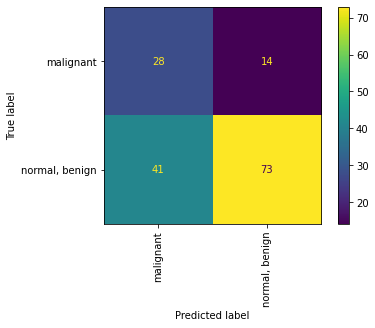

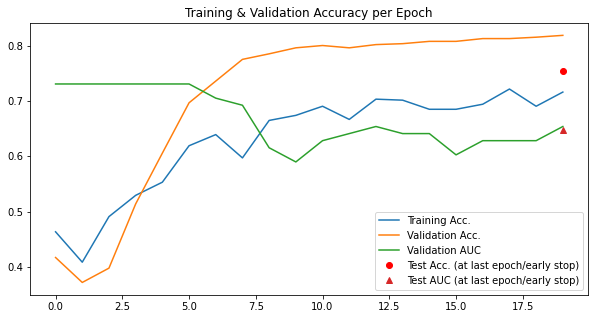

In [17]:
clf = run_classifier_pipeline(
    "breastmnist", info_flags, breastmnist_noWSR_GDA,
    DA_technique=DA_technique
)

#### OrganAMNIST

{
  "python_class": "OrganAMNIST",
  "description": "The OrganAMNIST is based on 3D computed tomography (CT) images from Liver Tumor Segmentation Benchmark (LiTS). It is renamed from OrganMNIST_Axial (in MedMNIST v1) for simplicity. We use bounding-box annotations of 11 body organs from another study to obtain the organ labels. Hounsfield-Unit (HU) of the 3D images are transformed into gray-scale with an abdominal window. We crop 2D images from the center slices of the 3D bounding boxes in axial views (planes). The images are resized into 1\u00d728\u00d728 to perform multi-class classification of 11 body organs. 115 and 16 CT scans from the source training set are used as training and validation set, respectively. The 70 CT scans from the source test set are treated as the test set.",
  "url": "https://zenodo.org/record/5208230/files/organamnist.npz?download=1",
  "MD5": "866b832ed4eeba67bfb9edee1d5544e6",
  "task": "multi-class",
  "label": {
    "0": "bladder",
    "1": "femur-left",

100%|█████████████████████████████████████████| 271/271 [00:20<00:00, 13.39it/s]


train -- accuracy: 0.36
val -- accuracy: 0.93,  AUC: 0.57
Epoch 1



100%|█████████████████████████████████████████| 271/271 [00:16<00:00, 16.85it/s]


train -- accuracy: 0.6
val -- accuracy: 0.97,  AUC: 0.73
Epoch 2



100%|█████████████████████████████████████████| 271/271 [00:15<00:00, 17.99it/s]


train -- accuracy: 0.73
val -- accuracy: 0.99,  AUC: 0.83
Epoch 3



100%|█████████████████████████████████████████| 271/271 [00:15<00:00, 17.11it/s]


train -- accuracy: 0.79
val -- accuracy: 0.99,  AUC: 0.89
Epoch 4



100%|█████████████████████████████████████████| 271/271 [00:15<00:00, 17.54it/s]


train -- accuracy: 0.83
val -- accuracy: 0.99,  AUC: 0.91
Epoch 5



100%|█████████████████████████████████████████| 271/271 [00:16<00:00, 16.17it/s]


train -- accuracy: 0.85
val -- accuracy: 1.0,  AUC: 0.92
Epoch 6



100%|█████████████████████████████████████████| 271/271 [00:15<00:00, 17.39it/s]


train -- accuracy: 0.87
val -- accuracy: 1.0,  AUC: 0.92
Epoch 7



100%|█████████████████████████████████████████| 271/271 [00:16<00:00, 16.10it/s]


train -- accuracy: 0.88
val -- accuracy: 1.0,  AUC: 0.92
Epoch 8



100%|█████████████████████████████████████████| 271/271 [00:17<00:00, 15.30it/s]


train -- accuracy: 0.9
val -- accuracy: 1.0,  AUC: 0.92
Epoch 9



100%|█████████████████████████████████████████| 271/271 [00:15<00:00, 17.39it/s]


train -- accuracy: 0.9
val -- accuracy: 1.0,  AUC: 0.93
Epoch 10



100%|█████████████████████████████████████████| 271/271 [00:14<00:00, 18.29it/s]


train -- accuracy: 0.91
val -- accuracy: 1.0,  AUC: 0.92
Epoch 11



100%|█████████████████████████████████████████| 271/271 [00:14<00:00, 18.28it/s]


train -- accuracy: 0.92
val -- accuracy: 1.0,  AUC: 0.93
Epoch 12



100%|█████████████████████████████████████████| 271/271 [00:16<00:00, 16.62it/s]


train -- accuracy: 0.92
val -- accuracy: 1.0,  AUC: 0.95
Epoch 13



100%|█████████████████████████████████████████| 271/271 [00:15<00:00, 16.96it/s]


train -- accuracy: 0.93
val -- accuracy: 1.0,  AUC: 0.93
Epoch 14



100%|█████████████████████████████████████████| 271/271 [00:14<00:00, 18.77it/s]


train -- accuracy: 0.93
val -- accuracy: 1.0,  AUC: 0.93
Epoch 15



100%|█████████████████████████████████████████| 271/271 [00:15<00:00, 17.33it/s]


train -- accuracy: 0.94
val -- accuracy: 1.0,  AUC: 0.93
Epoch 16



100%|█████████████████████████████████████████| 271/271 [00:14<00:00, 18.36it/s]


train -- accuracy: 0.94
val -- accuracy: 1.0,  AUC: 0.94
Epoch 17



100%|█████████████████████████████████████████| 271/271 [00:14<00:00, 18.82it/s]


train -- accuracy: 0.94
val -- accuracy: 1.0,  AUC: 0.94
Epoch 18



100%|█████████████████████████████████████████| 271/271 [00:14<00:00, 18.36it/s]


train -- accuracy: 0.95
val -- accuracy: 1.0,  AUC: 0.94
Epoch 19



100%|█████████████████████████████████████████| 271/271 [00:16<00:00, 16.20it/s]


train -- accuracy: 0.95
val -- accuracy: 1.0,  AUC: 0.94
test -- accuracy: 0.98,  AUC: 0.84


<Figure size 720x720 with 0 Axes>

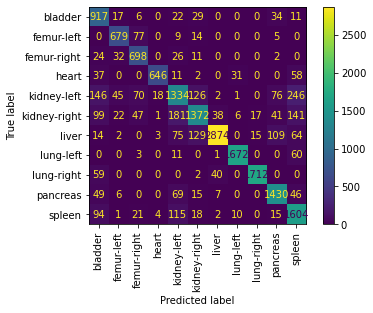

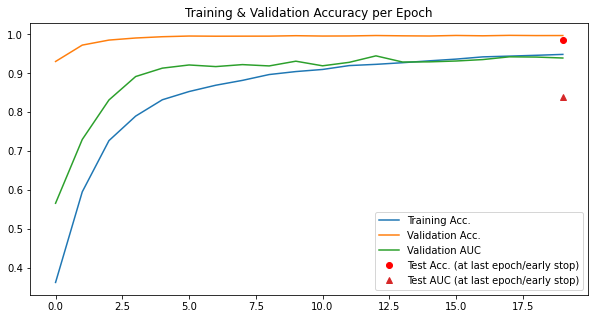

In [18]:
clf = run_classifier_pipeline(
    "organamnist", info_flags, organamnist_noWSR_GDA,
    DA_technique=DA_technique
)

#### OrganCMNIST

{
  "python_class": "OrganCMNIST",
  "description": "The OrganCMNIST is based on 3D computed tomography (CT) images from Liver Tumor Segmentation Benchmark (LiTS). It is renamed from OrganMNIST_Coronal (in MedMNIST v1) for simplicity. We use bounding-box annotations of 11 body organs from another study to obtain the organ labels. Hounsfield-Unit (HU) of the 3D images are transformed into gray-scale with an abdominal window. We crop 2D images from the center slices of the 3D bounding boxes in coronal views (planes). The images are resized into 1\u00d728\u00d728 to perform multi-class classification of 11 body organs. 115 and 16 CT scans from the source training set are used as training and validation set, respectively. The 70 CT scans from the source test set are treated as the test set.",
  "url": "https://zenodo.org/record/5208230/files/organcmnist.npz?download=1",
  "MD5": "0afa5834fb105f7705a7d93372119a21",
  "task": "multi-class",
  "label": {
    "0": "bladder",
    "1": "femur-le

100%|█████████████████████████████████████████| 102/102 [00:05<00:00, 18.06it/s]


train -- accuracy: 0.27
val -- accuracy: 0.88,  AUC: 0.46
Epoch 1



100%|█████████████████████████████████████████| 102/102 [00:05<00:00, 18.44it/s]


train -- accuracy: 0.41
val -- accuracy: 0.91,  AUC: 0.53
Epoch 2



100%|█████████████████████████████████████████| 102/102 [00:05<00:00, 17.73it/s]


train -- accuracy: 0.5
val -- accuracy: 0.94,  AUC: 0.65
Epoch 3



100%|█████████████████████████████████████████| 102/102 [00:05<00:00, 18.51it/s]


train -- accuracy: 0.57
val -- accuracy: 0.96,  AUC: 0.71
Epoch 4



100%|█████████████████████████████████████████| 102/102 [00:05<00:00, 18.81it/s]


train -- accuracy: 0.64
val -- accuracy: 0.97,  AUC: 0.76
Epoch 5



100%|█████████████████████████████████████████| 102/102 [00:05<00:00, 18.79it/s]


train -- accuracy: 0.67
val -- accuracy: 0.98,  AUC: 0.79
Epoch 6



100%|█████████████████████████████████████████| 102/102 [00:06<00:00, 16.95it/s]


train -- accuracy: 0.71
val -- accuracy: 0.98,  AUC: 0.83
Epoch 7



100%|█████████████████████████████████████████| 102/102 [00:05<00:00, 18.28it/s]


train -- accuracy: 0.73
val -- accuracy: 0.99,  AUC: 0.85
Epoch 8



100%|█████████████████████████████████████████| 102/102 [00:05<00:00, 18.66it/s]


train -- accuracy: 0.76
val -- accuracy: 0.99,  AUC: 0.85
Epoch 9



100%|█████████████████████████████████████████| 102/102 [00:05<00:00, 17.06it/s]


train -- accuracy: 0.77
val -- accuracy: 0.99,  AUC: 0.88
Epoch 10



100%|█████████████████████████████████████████| 102/102 [00:06<00:00, 16.96it/s]


train -- accuracy: 0.78
val -- accuracy: 0.99,  AUC: 0.9
Epoch 11



100%|█████████████████████████████████████████| 102/102 [00:05<00:00, 17.18it/s]


train -- accuracy: 0.8
val -- accuracy: 0.99,  AUC: 0.9
Epoch 12



100%|█████████████████████████████████████████| 102/102 [00:06<00:00, 16.58it/s]


train -- accuracy: 0.81
val -- accuracy: 0.99,  AUC: 0.9
Epoch 13



100%|█████████████████████████████████████████| 102/102 [00:05<00:00, 18.29it/s]


train -- accuracy: 0.82
val -- accuracy: 0.99,  AUC: 0.91
Epoch 14



100%|█████████████████████████████████████████| 102/102 [00:06<00:00, 16.22it/s]


train -- accuracy: 0.83
val -- accuracy: 0.99,  AUC: 0.92
Epoch 15



100%|█████████████████████████████████████████| 102/102 [00:05<00:00, 17.35it/s]


train -- accuracy: 0.84
val -- accuracy: 1.0,  AUC: 0.92
Epoch 16



100%|█████████████████████████████████████████| 102/102 [00:06<00:00, 16.93it/s]


train -- accuracy: 0.86
val -- accuracy: 1.0,  AUC: 0.92
Epoch 17



100%|█████████████████████████████████████████| 102/102 [00:07<00:00, 14.23it/s]


train -- accuracy: 0.85
val -- accuracy: 0.99,  AUC: 0.9
Epoch 18



100%|█████████████████████████████████████████| 102/102 [00:06<00:00, 16.68it/s]


train -- accuracy: 0.86
val -- accuracy: 1.0,  AUC: 0.92
Epoch 19



100%|█████████████████████████████████████████| 102/102 [00:05<00:00, 18.20it/s]


train -- accuracy: 0.86
val -- accuracy: 1.0,  AUC: 0.93
test -- accuracy: 0.97,  AUC: 0.79


<Figure size 720x720 with 0 Axes>

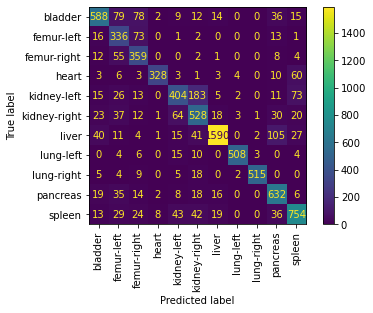

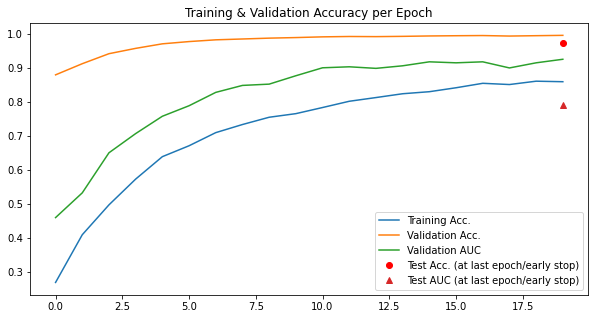

In [19]:
clf = run_classifier_pipeline(
    "organcmnist", info_flags, organcmnist_noWSR_GDA,
    DA_technique=DA_technique
)

#### OrganSMNIST

{
  "python_class": "OrganSMNIST",
  "description": "The OrganSMNIST is based on 3D computed tomography (CT) images from Liver Tumor Segmentation Benchmark (LiTS). It is renamed from OrganMNIST_Sagittal (in MedMNIST v1) for simplicity. We use bounding-box annotations of 11 body organs from another study to obtain the organ labels. Hounsfield-Unit (HU) of the 3D images are transformed into gray-scale with an abdominal window. We crop 2D images from the center slices of the 3D bounding boxes in sagittal views (planes). The images are resized into 1\u00d728\u00d728 to perform multi-class classification of 11 body organs. 115 and 16 CT scans from the source training set are used as training and validation set, respectively. The 70 CT scans from the source test set are treated as the test set.",
  "url": "https://zenodo.org/record/5208230/files/organsmnist.npz?download=1",
  "MD5": "e5c39f1af030238290b9557d9503af9d",
  "task": "multi-class",
  "label": {
    "0": "bladder",
    "1": "femur-

100%|█████████████████████████████████████████| 109/109 [00:06<00:00, 17.37it/s]


train -- accuracy: 0.15
val -- accuracy: 0.82,  AUC: 0.32
Epoch 1



100%|█████████████████████████████████████████| 109/109 [00:06<00:00, 17.24it/s]


train -- accuracy: 0.3
val -- accuracy: 0.86,  AUC: 0.36
Epoch 2



100%|█████████████████████████████████████████| 109/109 [00:06<00:00, 17.68it/s]


train -- accuracy: 0.37
val -- accuracy: 0.87,  AUC: 0.45
Epoch 3



100%|█████████████████████████████████████████| 109/109 [00:06<00:00, 17.86it/s]


train -- accuracy: 0.4
val -- accuracy: 0.88,  AUC: 0.46
Epoch 4



100%|█████████████████████████████████████████| 109/109 [00:06<00:00, 17.99it/s]


train -- accuracy: 0.44
val -- accuracy: 0.9,  AUC: 0.49
Epoch 5



100%|█████████████████████████████████████████| 109/109 [00:06<00:00, 17.52it/s]


train -- accuracy: 0.47
val -- accuracy: 0.9,  AUC: 0.5
Epoch 6



100%|█████████████████████████████████████████| 109/109 [00:06<00:00, 17.41it/s]


train -- accuracy: 0.49
val -- accuracy: 0.92,  AUC: 0.53
Epoch 7



100%|█████████████████████████████████████████| 109/109 [00:05<00:00, 18.54it/s]


train -- accuracy: 0.51
val -- accuracy: 0.93,  AUC: 0.57
Epoch 8



100%|█████████████████████████████████████████| 109/109 [00:05<00:00, 18.69it/s]


train -- accuracy: 0.55
val -- accuracy: 0.94,  AUC: 0.57
Epoch 9



100%|█████████████████████████████████████████| 109/109 [00:05<00:00, 18.56it/s]


train -- accuracy: 0.56
val -- accuracy: 0.95,  AUC: 0.54
Epoch 10



100%|█████████████████████████████████████████| 109/109 [00:05<00:00, 18.35it/s]


train -- accuracy: 0.58
val -- accuracy: 0.96,  AUC: 0.65
Epoch 11



100%|█████████████████████████████████████████| 109/109 [00:07<00:00, 15.33it/s]


train -- accuracy: 0.6
val -- accuracy: 0.97,  AUC: 0.63
Epoch 12



100%|█████████████████████████████████████████| 109/109 [00:05<00:00, 20.58it/s]


train -- accuracy: 0.62
val -- accuracy: 0.97,  AUC: 0.68
Epoch 13



100%|█████████████████████████████████████████| 109/109 [00:05<00:00, 21.56it/s]


train -- accuracy: 0.63
val -- accuracy: 0.97,  AUC: 0.68
Epoch 14



100%|█████████████████████████████████████████| 109/109 [00:04<00:00, 22.11it/s]


train -- accuracy: 0.64
val -- accuracy: 0.97,  AUC: 0.68
Epoch 15



100%|█████████████████████████████████████████| 109/109 [00:05<00:00, 18.93it/s]


train -- accuracy: 0.65
val -- accuracy: 0.98,  AUC: 0.71
Epoch 16



100%|█████████████████████████████████████████| 109/109 [00:05<00:00, 21.34it/s]


train -- accuracy: 0.66
val -- accuracy: 0.98,  AUC: 0.73
Epoch 17



100%|█████████████████████████████████████████| 109/109 [00:04<00:00, 21.95it/s]


train -- accuracy: 0.67
val -- accuracy: 0.98,  AUC: 0.73
Epoch 18



100%|█████████████████████████████████████████| 109/109 [00:05<00:00, 21.72it/s]


train -- accuracy: 0.68
val -- accuracy: 0.98,  AUC: 0.77
Epoch 19



100%|█████████████████████████████████████████| 109/109 [00:06<00:00, 18.10it/s]


train -- accuracy: 0.7
val -- accuracy: 0.98,  AUC: 0.76
test -- accuracy: 0.94,  AUC: 0.61


<Figure size 720x720 with 0 Axes>

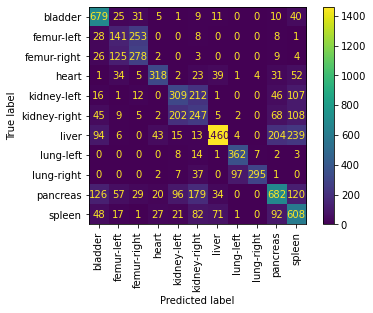

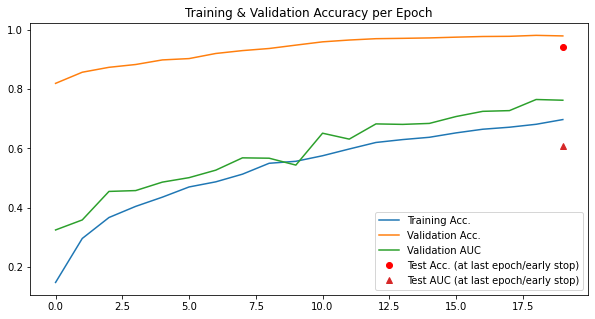

In [20]:
clf = run_classifier_pipeline(
    "organsmnist", info_flags, organsmnist_noWSR_GDA,
    DA_technique=DA_technique
)

## 4. Training a Conditional Variational Autoencoder 

We train a Conditional Variational Autoencoder for data augmentation for each of the datasets. 

For each dataset, we then retrain the underlying baseline classifier.

In [50]:
# Declares the Conditional VAE's hyperparameters
latent_dims = 150
epochs = 200

### PathMNIST

#### Training the Conditional VAE

In [52]:
# Declares the dataset name and retrieves the base dataset
name_dataset = "pathmnist"
base_dataset = pathmnist_noWRS_noGDA

# Retrieves the dataset parameters
n_classes  = len(info_flags[name_dataset][0]["label"])
n_channels = info_flags[name_dataset][0]["n_channels"]

# Retrieves the data loader
train_loader = base_dataset[3]
val_loader = base_dataset[5]
test_loader = base_dataset[4]

Testing Conditional Variational Autoencoder:
Clearing CUDA Pytorch Cache
Model Output size: torch.Size([10, 3, 28, 28])
Forward pass test:  True
{'loss': tensor(26646.1465, grad_fn=<AddBackward0>), 'Reconstruction_Loss': tensor(26646.0469, grad_fn=<MseLossBackward0>), 'KLD': tensor(-20.0212, grad_fn=<NegBackward0>)}
Loss test:  True
Cuda device:  cuda
Training phase:
Train epoch 1 -- average loss: 86.03148339931644
Validation set loss: 66.993648
Train epoch 2 -- average loss: 62.19562683078341
Validation set loss: 62.088601
Train epoch 3 -- average loss: 53.08028014067878
Validation set loss: 50.344548
Train epoch 4 -- average loss: 48.681226183972974
Validation set loss: 46.076276
Train epoch 5 -- average loss: 45.72913971754322
Validation set loss: 43.496473
Train epoch 6 -- average loss: 43.541585162574066
Validation set loss: 43.337773
Train epoch 7 -- average loss: 41.862527493355174
Validation set loss: 43.723314
Train epoch 8 -- average loss: 40.395047988460945
Validation set lo

Train epoch 97 -- average loss: 19.972902861980497
Validation set loss: 22.138664
Train epoch 98 -- average loss: 19.995290400086574
Validation set loss: 22.268427
Train epoch 99 -- average loss: 19.990328343477593
Validation set loss: 22.251341
Train epoch 100 -- average loss: 19.861918264211265
Validation set loss: 22.046413
Train epoch 101 -- average loss: 19.776498632550986
Validation set loss: 22.225343
Train epoch 102 -- average loss: 19.940566578146203
Validation set loss: 22.334545
Train epoch 103 -- average loss: 19.827751087439825
Validation set loss: 22.288841
Train epoch 104 -- average loss: 19.70945822045487
Validation set loss: 22.342569
Train epoch 105 -- average loss: 19.637848548748433
Validation set loss: 22.29091
==/!\== EARLY STOPPING: no validation loss improvement over the past 5 epochs
Testing phase:
Test set loss: 22.163671


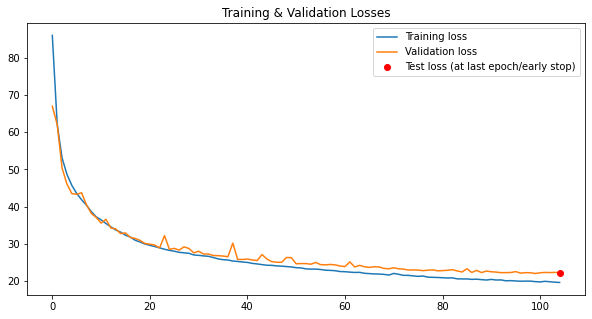

In [7]:
# Runs the conditional VAE
_, _, _, _ = run_encoder_pipeline(
    train_loader, val_loader, test_loader, n_channels, latent_dims,  
    n_classes=n_classes, epochs=epochs, name_dataset=name_dataset, 
    output_intermediary_info=False, model_type="CondVAE"
)

#### Generating an upgraded dataset without Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [53]:
# Fetches the generated VAE Model model to import
model_path = f"trained_models/CondVAE/{name_dataset}/"
model = [x for x in os.listdir(model_path) if x[-4:]==".pth"][-1]
model_path += model

# Calculates the number of images to generate
percentage = 4
nb_images_in_dataset = len(base_dataset[0])
n_generated_images = int((percentage/100)*nb_images_in_dataset)
print(f"Number of generated images: {n_generated_images}",
      f"({percentage}% of the dataset)")

# Creates the augmented dataloader
condVAE_loader = generate_augmented_dataset_condVAE(
    n_channels, n_classes, latent_dims, model_path, 
    base_dataset[0], 64, test_loader, val_loader, 
    n_generated_images, weighted_sampling=False
)

Number of generated images: 3599 (4% of the dataset)


2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "PathMNIST",
  "description": "The PathMNIST is based on a prior study for predicting survival from colorectal cancer histology slides, providing a dataset (NCT-CRC-HE-100K) of 100,000 non-overlapping image patches from hematoxylin & eosin stained histological images, and a test dataset (CRC-VAL-HE-7K) of 7,180 image patches from a different clinical center. The dataset is comprised of 9 types of tissues, resulting in a multi-class classification task. We resize the source images of 3\u00d7224\u00d7224 into 3\u00d728\u00d728, and split NCT-CRC-HE-100K into training and validation set with a ratio of 9:1. The CRC-VAL-HE-7K is treated as the test set.",
  "url": "https://zenodo.org/record/5208230/files/pathmnist.npz?download=1",
  "MD5": "a8b06965200029087d5bd730944a56c1",
  "task": "multi-class",
  "label": {
    "0": "adipose",
    "1": "background",
    "2": "debris",
    "3": "lymphocytes",
    "4": "mucus",
    "5": "smooth muscle",
    "6": "normal colon mucosa"

100%|███████████████████████████████████████| 1463/1463 [00:15<00:00, 95.64it/s]


train -- accuracy: 0.66
val -- accuracy: 0.98,  AUC: 0.79
Epoch 1



100%|███████████████████████████████████████| 1463/1463 [00:15<00:00, 96.55it/s]


train -- accuracy: 0.82
val -- accuracy: 0.98,  AUC: 0.82
Epoch 2



100%|███████████████████████████████████████| 1463/1463 [00:15<00:00, 93.90it/s]


train -- accuracy: 0.87
val -- accuracy: 0.99,  AUC: 0.89
Epoch 3



100%|███████████████████████████████████████| 1463/1463 [00:15<00:00, 96.60it/s]


train -- accuracy: 0.89
val -- accuracy: 0.99,  AUC: 0.88
Epoch 4



100%|███████████████████████████████████████| 1463/1463 [00:15<00:00, 96.54it/s]


train -- accuracy: 0.9
val -- accuracy: 0.99,  AUC: 0.86
Epoch 5



100%|███████████████████████████████████████| 1463/1463 [00:15<00:00, 95.13it/s]


train -- accuracy: 0.91
val -- accuracy: 0.99,  AUC: 0.91
Epoch 6



100%|███████████████████████████████████████| 1463/1463 [00:15<00:00, 94.63it/s]


train -- accuracy: 0.92
val -- accuracy: 1.0,  AUC: 0.93
Epoch 7



100%|███████████████████████████████████████| 1463/1463 [00:15<00:00, 94.95it/s]


train -- accuracy: 0.93
val -- accuracy: 1.0,  AUC: 0.91
Epoch 8



100%|███████████████████████████████████████| 1463/1463 [00:15<00:00, 97.22it/s]


train -- accuracy: 0.93
val -- accuracy: 1.0,  AUC: 0.92
Epoch 9



100%|███████████████████████████████████████| 1463/1463 [00:14<00:00, 97.62it/s]


train -- accuracy: 0.94
val -- accuracy: 1.0,  AUC: 0.93
Epoch 10



100%|███████████████████████████████████████| 1463/1463 [00:14<00:00, 97.83it/s]


train -- accuracy: 0.94
val -- accuracy: 1.0,  AUC: 0.94
Epoch 11



100%|███████████████████████████████████████| 1463/1463 [00:14<00:00, 97.62it/s]


train -- accuracy: 0.95
val -- accuracy: 1.0,  AUC: 0.92
Epoch 12



100%|███████████████████████████████████████| 1463/1463 [00:15<00:00, 96.12it/s]


train -- accuracy: 0.95
val -- accuracy: 1.0,  AUC: 0.95
Epoch 13



100%|███████████████████████████████████████| 1463/1463 [00:15<00:00, 94.00it/s]


train -- accuracy: 0.95
val -- accuracy: 1.0,  AUC: 0.94
Epoch 14



100%|███████████████████████████████████████| 1463/1463 [00:15<00:00, 94.67it/s]


train -- accuracy: 0.96
val -- accuracy: 1.0,  AUC: 0.94
Epoch 15



100%|███████████████████████████████████████| 1463/1463 [00:15<00:00, 95.17it/s]


train -- accuracy: 0.96
val -- accuracy: 1.0,  AUC: 0.94
Epoch 16



100%|███████████████████████████████████████| 1463/1463 [00:14<00:00, 97.71it/s]


train -- accuracy: 0.96
val -- accuracy: 1.0,  AUC: 0.93
Epoch 17



100%|███████████████████████████████████████| 1463/1463 [00:14<00:00, 97.85it/s]


train -- accuracy: 0.96
val -- accuracy: 1.0,  AUC: 0.95
Epoch 18



100%|███████████████████████████████████████| 1463/1463 [00:14<00:00, 98.52it/s]


train -- accuracy: 0.97
val -- accuracy: 1.0,  AUC: 0.95
Epoch 19



100%|███████████████████████████████████████| 1463/1463 [00:15<00:00, 95.89it/s]


train -- accuracy: 0.97
val -- accuracy: 1.0,  AUC: 0.94
test -- accuracy: 0.97,  AUC: 0.82


<Figure size 720x720 with 0 Axes>

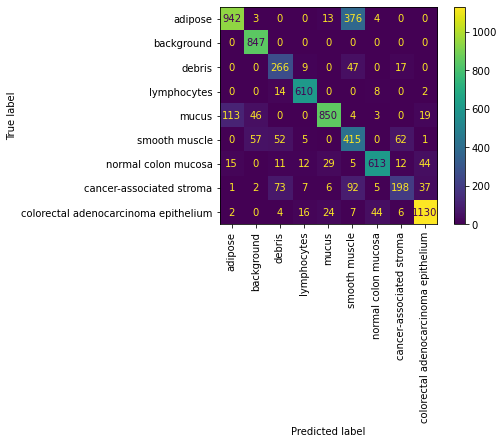

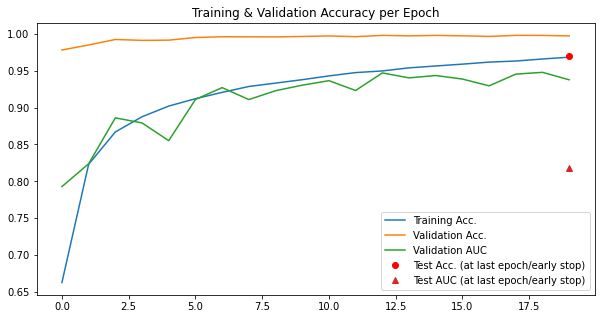

In [54]:
# Runs the classifier again 
clf = run_classifier_pipeline(name_dataset, info_flags, condVAE_loader)

#### Generating an upgraded dataset with Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [55]:
# Creates the augmented dataloader
condVAE_loader = generate_augmented_dataset_condVAE(
    n_channels, n_classes, latent_dims, model_path, 
    base_dataset[0], 64, test_loader, val_loader, 
    n_generated_images, weighted_sampling=True
)

2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "PathMNIST",
  "description": "The PathMNIST is based on a prior study for predicting survival from colorectal cancer histology slides, providing a dataset (NCT-CRC-HE-100K) of 100,000 non-overlapping image patches from hematoxylin & eosin stained histological images, and a test dataset (CRC-VAL-HE-7K) of 7,180 image patches from a different clinical center. The dataset is comprised of 9 types of tissues, resulting in a multi-class classification task. We resize the source images of 3\u00d7224\u00d7224 into 3\u00d728\u00d728, and split NCT-CRC-HE-100K into training and validation set with a ratio of 9:1. The CRC-VAL-HE-7K is treated as the test set.",
  "url": "https://zenodo.org/record/5208230/files/pathmnist.npz?download=1",
  "MD5": "a8b06965200029087d5bd730944a56c1",
  "task": "multi-class",
  "label": {
    "0": "adipose",
    "1": "background",
    "2": "debris",
    "3": "lymphocytes",
    "4": "mucus",
    "5": "smooth muscle",
    "6": "normal colon mucosa"

100%|███████████████████████████████████████| 1463/1463 [00:15<00:00, 96.16it/s]


train -- accuracy: 0.65
val -- accuracy: 0.97,  AUC: 0.74
Epoch 1



100%|███████████████████████████████████████| 1463/1463 [00:14<00:00, 98.30it/s]


train -- accuracy: 0.82
val -- accuracy: 0.98,  AUC: 0.82
Epoch 2



100%|███████████████████████████████████████| 1463/1463 [00:14<00:00, 98.62it/s]


train -- accuracy: 0.86
val -- accuracy: 0.99,  AUC: 0.84
Epoch 3



100%|███████████████████████████████████████| 1463/1463 [00:14<00:00, 98.48it/s]


train -- accuracy: 0.89
val -- accuracy: 0.99,  AUC: 0.88
Epoch 4



100%|███████████████████████████████████████| 1463/1463 [00:14<00:00, 99.26it/s]


train -- accuracy: 0.9
val -- accuracy: 0.99,  AUC: 0.9
Epoch 5



100%|███████████████████████████████████████| 1463/1463 [00:15<00:00, 96.94it/s]


train -- accuracy: 0.91
val -- accuracy: 0.99,  AUC: 0.88
Epoch 6



100%|███████████████████████████████████████| 1463/1463 [00:15<00:00, 96.23it/s]


train -- accuracy: 0.92
val -- accuracy: 0.99,  AUC: 0.9
Epoch 7



100%|███████████████████████████████████████| 1463/1463 [00:15<00:00, 96.72it/s]


train -- accuracy: 0.93
val -- accuracy: 1.0,  AUC: 0.93
Epoch 8



100%|███████████████████████████████████████| 1463/1463 [00:14<00:00, 99.09it/s]


train -- accuracy: 0.93
val -- accuracy: 1.0,  AUC: 0.92
Epoch 9



100%|███████████████████████████████████████| 1463/1463 [00:15<00:00, 95.92it/s]


train -- accuracy: 0.94
val -- accuracy: 1.0,  AUC: 0.93
Epoch 10



100%|███████████████████████████████████████| 1463/1463 [00:15<00:00, 97.05it/s]


train -- accuracy: 0.94
val -- accuracy: 1.0,  AUC: 0.92
Epoch 11



100%|███████████████████████████████████████| 1463/1463 [00:15<00:00, 97.12it/s]


train -- accuracy: 0.94
val -- accuracy: 1.0,  AUC: 0.93
Epoch 12



100%|███████████████████████████████████████| 1463/1463 [00:15<00:00, 96.31it/s]


train -- accuracy: 0.95
val -- accuracy: 1.0,  AUC: 0.92
Epoch 13



100%|███████████████████████████████████████| 1463/1463 [00:15<00:00, 96.87it/s]


train -- accuracy: 0.95
val -- accuracy: 1.0,  AUC: 0.93
Epoch 14



100%|███████████████████████████████████████| 1463/1463 [00:14<00:00, 98.60it/s]


train -- accuracy: 0.96
val -- accuracy: 1.0,  AUC: 0.94
Epoch 15



100%|███████████████████████████████████████| 1463/1463 [00:15<00:00, 97.44it/s]


train -- accuracy: 0.96
val -- accuracy: 1.0,  AUC: 0.94
Epoch 16



100%|███████████████████████████████████████| 1463/1463 [00:14<00:00, 97.65it/s]


train -- accuracy: 0.96
val -- accuracy: 1.0,  AUC: 0.94
Epoch 17



100%|███████████████████████████████████████| 1463/1463 [00:15<00:00, 96.54it/s]


train -- accuracy: 0.96
val -- accuracy: 1.0,  AUC: 0.94
Epoch 18



100%|███████████████████████████████████████| 1463/1463 [00:14<00:00, 98.12it/s]


train -- accuracy: 0.97
val -- accuracy: 1.0,  AUC: 0.94
Epoch 19



100%|███████████████████████████████████████| 1463/1463 [00:15<00:00, 94.88it/s]


train -- accuracy: 0.97
val -- accuracy: 1.0,  AUC: 0.94
test -- accuracy: 0.97,  AUC: 0.85


<Figure size 720x720 with 0 Axes>

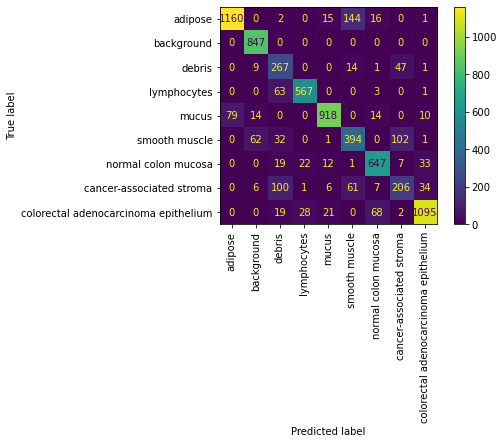

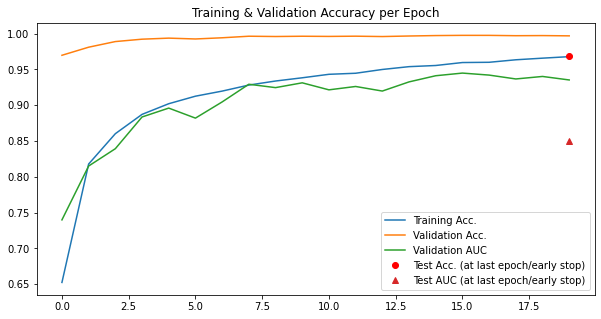

In [56]:
# Runs the classifier again 
clf = run_classifier_pipeline(name_dataset, info_flags, condVAE_loader)

### DermaMNIST

#### Training the Conditional VAE

In [57]:
# Declares the dataset name and retrieves the base dataset
name_dataset = "dermamnist"
base_dataset = dermamnist_noWRS_noGDA

# Retrieves the dataset parameters
n_classes  = len(info_flags[name_dataset][0]["label"])
n_channels = info_flags[name_dataset][0]["n_channels"]

# Retrieves the data loader
train_loader = base_dataset[3]
val_loader = base_dataset[5]
test_loader = base_dataset[4]

Testing Conditional Variational Autoencoder:
Clearing CUDA Pytorch Cache
Model Output size: torch.Size([10, 3, 28, 28])
Forward pass test:  True
{'loss': tensor(26745.2617, grad_fn=<AddBackward0>), 'Reconstruction_Loss': tensor(26745.1621, grad_fn=<MseLossBackward0>), 'KLD': tensor(-20.0586, grad_fn=<NegBackward0>)}
Loss test:  True
Cuda device:  cuda
Training phase:
Train epoch 1 -- average loss: 130.00432610079653
Validation set loss: 81.394848
Train epoch 2 -- average loss: 53.71683230971038
Validation set loss: 52.670733
Train epoch 3 -- average loss: 41.863740716593675
Validation set loss: 34.427116
Train epoch 4 -- average loss: 32.07389907107402
Validation set loss: 28.549798
Train epoch 5 -- average loss: 28.15626728182532
Validation set loss: 26.355714
Train epoch 6 -- average loss: 26.613163622092195
Validation set loss: 22.328216
Train epoch 7 -- average loss: 24.882499336600898
Validation set loss: 25.406387
Train epoch 8 -- average loss: 23.39594504964901
Validation set lo

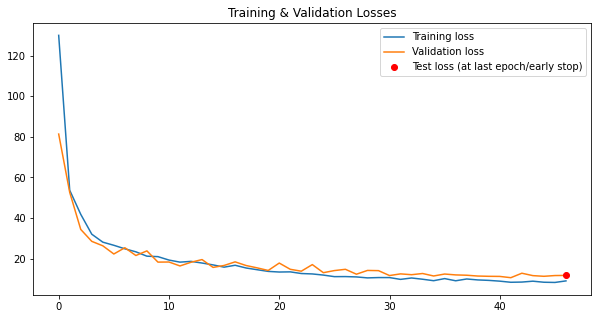

In [58]:
# Runs the conditional VAE
_, _, _, _ = run_encoder_pipeline(
    train_loader, val_loader, test_loader, n_channels, latent_dims,  
    n_classes=n_classes, epochs=epochs, name_dataset=name_dataset, 
    output_intermediary_info=False, model_type="CondVAE"
)

#### Generating an upgraded dataset without Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [59]:
# Fetches the generated VAE Model model to import
model_path = f"trained_models/CondVAE/{name_dataset}/"
model = [x for x in os.listdir(model_path) if x[-4:]==".pth"][-1]
model_path += model

# Calculates the number of images to generate
percentage = 10
nb_images_in_dataset = len(base_dataset[0])
n_generated_images = int((percentage/100)*nb_images_in_dataset)
print(f"Number of generated images: {n_generated_images}",
      f"({percentage}% of the dataset)")

# Creates the augmented dataloader
condVAE_loader = generate_augmented_dataset_condVAE(
    n_channels, n_classes, latent_dims, model_path, 
    base_dataset[0], 64, test_loader, val_loader, 
    n_generated_images, weighted_sampling=False
)

Number of generated images: 700 (10% of the dataset)


2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "DermaMNIST",
  "description": "The DermaMNIST is based on the HAM10000, a large collection of multi-source dermatoscopic images of common pigmented skin lesions. The dataset consists of 10,015 dermatoscopic images categorized as 7 different diseases, formulized as a multi-class classification task. We split the images into training, validation and test set with a ratio of 7:1:2. The source images of 3\u00d7600\u00d7450 are resized into 3\u00d728\u00d728.",
  "url": "https://zenodo.org/record/5208230/files/dermamnist.npz?download=1",
  "MD5": "0744692d530f8e62ec473284d019b0c7",
  "task": "multi-class",
  "label": {
    "0": "actinic keratoses and intraepithelial carcinoma",
    "1": "basal cell carcinoma",
    "2": "benign keratosis-like lesions",
    "3": "dermatofibroma",
    "4": "melanoma",
    "5": "melanocytic nevi",
    "6": "vascular lesions"
  },
  "n_channels": 3,
  "n_samples": {
    "train": 7007,
    "val": 1003,
    "test": 2005
  },
  "license": "CC B

100%|████████████████████████████████████████| 121/121 [00:01<00:00, 105.14it/s]


train -- accuracy: 0.62
val -- accuracy: 0.82,  AUC: 0.67
Epoch 1



100%|████████████████████████████████████████| 121/121 [00:01<00:00, 103.63it/s]


train -- accuracy: 0.63
val -- accuracy: 0.87,  AUC: 0.67
Epoch 2



100%|████████████████████████████████████████| 121/121 [00:01<00:00, 100.88it/s]


train -- accuracy: 0.64
val -- accuracy: 0.87,  AUC: 0.68
Epoch 3



100%|█████████████████████████████████████████| 121/121 [00:01<00:00, 98.76it/s]


train -- accuracy: 0.66
val -- accuracy: 0.89,  AUC: 0.71
Epoch 4



100%|████████████████████████████████████████| 121/121 [00:01<00:00, 101.05it/s]


train -- accuracy: 0.68
val -- accuracy: 0.88,  AUC: 0.72
Epoch 5



100%|████████████████████████████████████████| 121/121 [00:01<00:00, 102.45it/s]


train -- accuracy: 0.69
val -- accuracy: 0.9,  AUC: 0.73
Epoch 6



100%|████████████████████████████████████████| 121/121 [00:01<00:00, 100.55it/s]


train -- accuracy: 0.7
val -- accuracy: 0.9,  AUC: 0.72
Epoch 7



100%|████████████████████████████████████████| 121/121 [00:01<00:00, 101.72it/s]


train -- accuracy: 0.71
val -- accuracy: 0.91,  AUC: 0.74
Epoch 8



100%|████████████████████████████████████████| 121/121 [00:01<00:00, 102.07it/s]


train -- accuracy: 0.72
val -- accuracy: 0.9,  AUC: 0.72
Epoch 9



100%|████████████████████████████████████████| 121/121 [00:01<00:00, 101.19it/s]


train -- accuracy: 0.73
val -- accuracy: 0.9,  AUC: 0.72
Epoch 10



100%|████████████████████████████████████████| 121/121 [00:01<00:00, 101.31it/s]


train -- accuracy: 0.73
val -- accuracy: 0.9,  AUC: 0.74
Epoch 11



100%|████████████████████████████████████████| 121/121 [00:01<00:00, 101.96it/s]


train -- accuracy: 0.75
val -- accuracy: 0.91,  AUC: 0.71
Epoch 12



100%|████████████████████████████████████████| 121/121 [00:01<00:00, 102.00it/s]


train -- accuracy: 0.76
val -- accuracy: 0.92,  AUC: 0.75
Epoch 13



100%|████████████████████████████████████████| 121/121 [00:01<00:00, 102.28it/s]


train -- accuracy: 0.76
val -- accuracy: 0.91,  AUC: 0.73
Epoch 14



100%|████████████████████████████████████████| 121/121 [00:01<00:00, 102.29it/s]


train -- accuracy: 0.77
val -- accuracy: 0.91,  AUC: 0.74
Epoch 15



100%|████████████████████████████████████████| 121/121 [00:01<00:00, 102.24it/s]


train -- accuracy: 0.79
val -- accuracy: 0.92,  AUC: 0.73
Epoch 16



100%|████████████████████████████████████████| 121/121 [00:01<00:00, 102.55it/s]


train -- accuracy: 0.8
val -- accuracy: 0.92,  AUC: 0.74
Epoch 17



100%|████████████████████████████████████████| 121/121 [00:01<00:00, 101.45it/s]


train -- accuracy: 0.81
val -- accuracy: 0.92,  AUC: 0.75
Epoch 18



100%|████████████████████████████████████████| 121/121 [00:01<00:00, 102.52it/s]


train -- accuracy: 0.82
val -- accuracy: 0.91,  AUC: 0.71
Epoch 19



100%|████████████████████████████████████████| 121/121 [00:01<00:00, 102.37it/s]


train -- accuracy: 0.84
val -- accuracy: 0.91,  AUC: 0.7
test -- accuracy: 0.91,  AUC: 0.69


<Figure size 720x720 with 0 Axes>

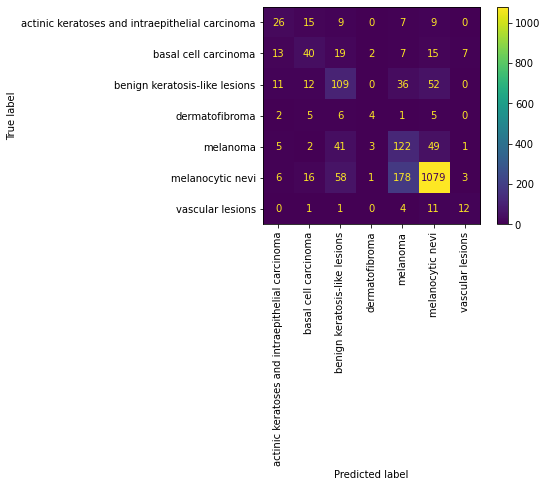

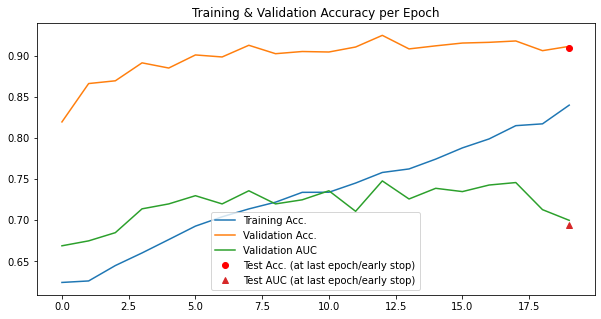

In [60]:
# Runs the classifier again 
clf = run_classifier_pipeline(name_dataset, info_flags, condVAE_loader)

#### Generating an upgraded dataset with Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [61]:
# Creates the augmented dataloader
condVAE_loader = generate_augmented_dataset_condVAE(
    n_channels, n_classes, latent_dims, model_path, 
    base_dataset[0], 64, test_loader, val_loader, 
    n_generated_images, weighted_sampling=True
)

2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "DermaMNIST",
  "description": "The DermaMNIST is based on the HAM10000, a large collection of multi-source dermatoscopic images of common pigmented skin lesions. The dataset consists of 10,015 dermatoscopic images categorized as 7 different diseases, formulized as a multi-class classification task. We split the images into training, validation and test set with a ratio of 7:1:2. The source images of 3\u00d7600\u00d7450 are resized into 3\u00d728\u00d728.",
  "url": "https://zenodo.org/record/5208230/files/dermamnist.npz?download=1",
  "MD5": "0744692d530f8e62ec473284d019b0c7",
  "task": "multi-class",
  "label": {
    "0": "actinic keratoses and intraepithelial carcinoma",
    "1": "basal cell carcinoma",
    "2": "benign keratosis-like lesions",
    "3": "dermatofibroma",
    "4": "melanoma",
    "5": "melanocytic nevi",
    "6": "vascular lesions"
  },
  "n_channels": 3,
  "n_samples": {
    "train": 7007,
    "val": 1003,
    "test": 2005
  },
  "license": "CC B

100%|████████████████████████████████████████| 121/121 [00:01<00:00, 110.76it/s]


train -- accuracy: 0.3
val -- accuracy: 0.8,  AUC: 0.4
Epoch 1



100%|████████████████████████████████████████| 121/121 [00:01<00:00, 109.39it/s]


train -- accuracy: 0.46
val -- accuracy: 0.86,  AUC: 0.58
Epoch 2



100%|████████████████████████████████████████| 121/121 [00:01<00:00, 109.19it/s]


train -- accuracy: 0.53
val -- accuracy: 0.88,  AUC: 0.6
Epoch 3



100%|████████████████████████████████████████| 121/121 [00:01<00:00, 103.13it/s]


train -- accuracy: 0.59
val -- accuracy: 0.89,  AUC: 0.59
Epoch 4



100%|████████████████████████████████████████| 121/121 [00:01<00:00, 108.91it/s]


train -- accuracy: 0.62
val -- accuracy: 0.88,  AUC: 0.66
Epoch 5



100%|████████████████████████████████████████| 121/121 [00:01<00:00, 110.12it/s]


train -- accuracy: 0.67
val -- accuracy: 0.89,  AUC: 0.59
Epoch 6



100%|████████████████████████████████████████| 121/121 [00:01<00:00, 107.29it/s]


train -- accuracy: 0.71
val -- accuracy: 0.9,  AUC: 0.65
Epoch 7



100%|████████████████████████████████████████| 121/121 [00:01<00:00, 107.23it/s]


train -- accuracy: 0.75
val -- accuracy: 0.9,  AUC: 0.66
Epoch 8



100%|████████████████████████████████████████| 121/121 [00:01<00:00, 111.17it/s]


train -- accuracy: 0.79
val -- accuracy: 0.89,  AUC: 0.6
Epoch 9



100%|████████████████████████████████████████| 121/121 [00:01<00:00, 110.49it/s]


train -- accuracy: 0.83
val -- accuracy: 0.89,  AUC: 0.64
Epoch 10



100%|████████████████████████████████████████| 121/121 [00:01<00:00, 111.75it/s]


train -- accuracy: 0.85
val -- accuracy: 0.89,  AUC: 0.62
Epoch 11



100%|████████████████████████████████████████| 121/121 [00:01<00:00, 110.49it/s]


train -- accuracy: 0.87
val -- accuracy: 0.89,  AUC: 0.64
Epoch 12



100%|████████████████████████████████████████| 121/121 [00:01<00:00, 111.59it/s]


train -- accuracy: 0.89
val -- accuracy: 0.88,  AUC: 0.59
Epoch 13



100%|████████████████████████████████████████| 121/121 [00:01<00:00, 109.69it/s]


train -- accuracy: 0.9
val -- accuracy: 0.88,  AUC: 0.55
Epoch 14



100%|████████████████████████████████████████| 121/121 [00:01<00:00, 111.29it/s]


train -- accuracy: 0.91
val -- accuracy: 0.89,  AUC: 0.66
Epoch 15



100%|████████████████████████████████████████| 121/121 [00:01<00:00, 111.23it/s]


train -- accuracy: 0.92
val -- accuracy: 0.89,  AUC: 0.68
Epoch 16



100%|████████████████████████████████████████| 121/121 [00:01<00:00, 110.97it/s]


train -- accuracy: 0.93
val -- accuracy: 0.89,  AUC: 0.64
Epoch 17



100%|████████████████████████████████████████| 121/121 [00:01<00:00, 110.93it/s]


train -- accuracy: 0.94
val -- accuracy: 0.9,  AUC: 0.65
Epoch 18



100%|████████████████████████████████████████| 121/121 [00:01<00:00, 110.65it/s]


train -- accuracy: 0.95
val -- accuracy: 0.89,  AUC: 0.69
Epoch 19



100%|████████████████████████████████████████| 121/121 [00:01<00:00, 109.94it/s]


train -- accuracy: 0.95
val -- accuracy: 0.9,  AUC: 0.71
test -- accuracy: 0.9,  AUC: 0.72


<Figure size 720x720 with 0 Axes>

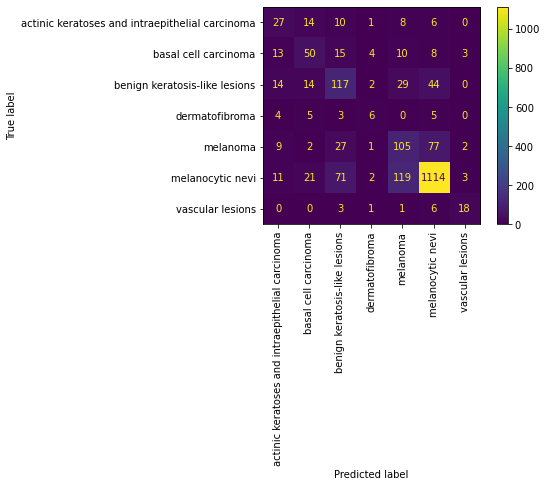

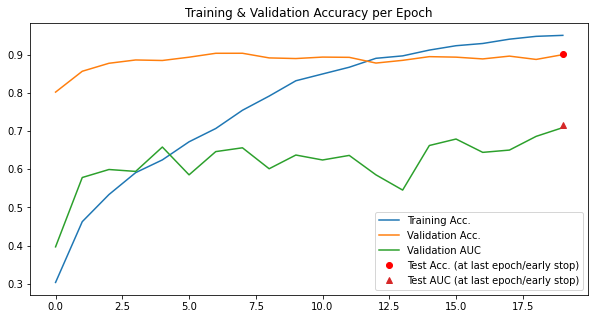

In [62]:
# Runs the classifier again 
clf = run_classifier_pipeline(name_dataset, info_flags, condVAE_loader)

### OctMNIST

#### Training the Conditional VAE

In [63]:
# Declares the dataset name and retrieves the base dataset
name_dataset = "octmnist"
base_dataset = octmnist_noWRS_noGDA

# Retrieves the dataset parameters
n_classes  = len(info_flags[name_dataset][0]["label"])
n_channels = info_flags[name_dataset][0]["n_channels"]

# Retrieves the data loader
train_loader = base_dataset[3]
val_loader = base_dataset[5]
test_loader = base_dataset[4]

Testing Conditional Variational Autoencoder:
Clearing CUDA Pytorch Cache
Model Output size: torch.Size([10, 1, 28, 28])
Forward pass test:  True
{'loss': tensor(9126.1826, grad_fn=<AddBackward0>), 'Reconstruction_Loss': tensor(9126.0869, grad_fn=<MseLossBackward0>), 'KLD': tensor(-19.1678, grad_fn=<NegBackward0>)}
Loss test:  True
Cuda device:  cuda
Training phase:
Train epoch 1 -- average loss: 19.53721921160729
Validation set loss: 8.334145
Train epoch 2 -- average loss: 7.233821851559975
Validation set loss: 5.566469
Train epoch 3 -- average loss: 5.337069534747419
Validation set loss: 4.472169
Train epoch 4 -- average loss: 4.26380370150143
Validation set loss: 3.516816
Train epoch 5 -- average loss: 3.7459836939273776
Validation set loss: 3.569156
Train epoch 6 -- average loss: 3.3990540673466962
Validation set loss: 2.796929
Train epoch 7 -- average loss: 3.106732538772067
Validation set loss: 2.690751
Train epoch 8 -- average loss: 2.8521910920745746
Validation set loss: 2.44634

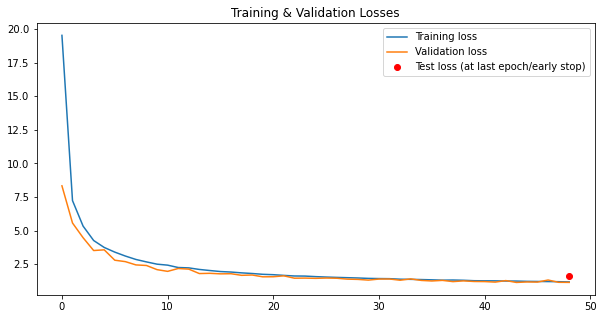

In [64]:
# Runs the conditional VAE
_, _, _, _ = run_encoder_pipeline(
    train_loader, val_loader, test_loader, n_channels, latent_dims,  
    n_classes=n_classes, epochs=epochs, name_dataset=name_dataset, 
    output_intermediary_info=False, model_type="CondVAE"
)

#### Generating an upgraded dataset without Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [65]:
# Fetches the generated VAE Model model to import
model_path = f"trained_models/CondVAE/{name_dataset}/"
model = [x for x in os.listdir(model_path) if x[-4:]==".pth"][-1]
model_path += model

# Calculates the number of images to generate
percentage = 4
nb_images_in_dataset = len(base_dataset[0])
n_generated_images = int((percentage/100)*nb_images_in_dataset)
print(f"Number of generated images: {n_generated_images}",
      f"({percentage}% of the dataset)")

# Creates the augmented dataloader
condVAE_loader = generate_augmented_dataset_condVAE(
    n_channels, n_classes, latent_dims, model_path, 
    base_dataset[0], 64, test_loader, val_loader, 
    n_generated_images, weighted_sampling=False
)

Number of generated images: 3899 (4% of the dataset)


2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "OCTMNIST",
  "description": "The OCTMNIST is based on a prior dataset of 109,309 valid optical coherence tomography (OCT) images for retinal diseases. The dataset is comprised of 4 diagnosis categories, leading to a multi-class classification task. We split the source training set with a ratio of 9:1 into training and validation set, and use its source validation set as the test set. The source images are gray-scale, and their sizes are (384\u22121,536)\u00d7(277\u2212512). We center-crop the images and resize them into 1\u00d728\u00d728.",
  "url": "https://zenodo.org/record/5208230/files/octmnist.npz?download=1",
  "MD5": "c68d92d5b585d8d81f7112f81e2d0842",
  "task": "multi-class",
  "label": {
    "0": "choroidal neovascularization",
    "1": "diabetic macular edema",
    "2": "drusen",
    "3": "normal"
  },
  "n_channels": 1,
  "n_samples": {
    "train": 97477,
    "val": 10832,
    "test": 1000
  },
  "license": "CC BY 4.0"
}
--------------------------------

100%|██████████████████████████████████████| 1584/1584 [00:14<00:00, 107.85it/s]


train -- accuracy: 0.79
val -- accuracy: 0.93,  AUC: 0.85
Epoch 1



100%|██████████████████████████████████████| 1584/1584 [00:14<00:00, 105.74it/s]


train -- accuracy: 0.85
val -- accuracy: 0.95,  AUC: 0.88
Epoch 2



100%|██████████████████████████████████████| 1584/1584 [00:15<00:00, 102.79it/s]


train -- accuracy: 0.87
val -- accuracy: 0.96,  AUC: 0.88
Epoch 3



100%|██████████████████████████████████████| 1584/1584 [00:15<00:00, 103.24it/s]


train -- accuracy: 0.88
val -- accuracy: 0.96,  AUC: 0.88
Epoch 4



100%|██████████████████████████████████████| 1584/1584 [00:15<00:00, 102.53it/s]


train -- accuracy: 0.89
val -- accuracy: 0.97,  AUC: 0.9
Epoch 5



100%|██████████████████████████████████████| 1584/1584 [00:15<00:00, 104.20it/s]


train -- accuracy: 0.9
val -- accuracy: 0.96,  AUC: 0.89
Epoch 6



100%|██████████████████████████████████████| 1584/1584 [00:15<00:00, 102.06it/s]


train -- accuracy: 0.91
val -- accuracy: 0.96,  AUC: 0.88
Epoch 7



100%|██████████████████████████████████████| 1584/1584 [00:15<00:00, 105.37it/s]


train -- accuracy: 0.91
val -- accuracy: 0.97,  AUC: 0.9
Epoch 8



100%|██████████████████████████████████████| 1584/1584 [00:15<00:00, 104.33it/s]


train -- accuracy: 0.92
val -- accuracy: 0.97,  AUC: 0.91
Epoch 9



100%|██████████████████████████████████████| 1584/1584 [00:14<00:00, 106.28it/s]


train -- accuracy: 0.93
val -- accuracy: 0.97,  AUC: 0.9
Epoch 10



100%|██████████████████████████████████████| 1584/1584 [00:14<00:00, 106.25it/s]


train -- accuracy: 0.93
val -- accuracy: 0.96,  AUC: 0.89
Epoch 11



100%|██████████████████████████████████████| 1584/1584 [00:15<00:00, 104.85it/s]


train -- accuracy: 0.94
val -- accuracy: 0.96,  AUC: 0.89
Epoch 12



100%|███████████████████████████████████████| 1584/1584 [00:16<00:00, 98.31it/s]


train -- accuracy: 0.94
val -- accuracy: 0.97,  AUC: 0.9
Epoch 13



100%|██████████████████████████████████████| 1584/1584 [00:14<00:00, 109.08it/s]


train -- accuracy: 0.94
val -- accuracy: 0.97,  AUC: 0.9
Epoch 14



100%|██████████████████████████████████████| 1584/1584 [00:14<00:00, 110.45it/s]


train -- accuracy: 0.95
val -- accuracy: 0.97,  AUC: 0.91
Epoch 15



100%|██████████████████████████████████████| 1584/1584 [00:15<00:00, 104.38it/s]


train -- accuracy: 0.95
val -- accuracy: 0.97,  AUC: 0.91
Epoch 16



100%|██████████████████████████████████████| 1584/1584 [00:14<00:00, 111.01it/s]


train -- accuracy: 0.95
val -- accuracy: 0.97,  AUC: 0.91
Epoch 17



100%|██████████████████████████████████████| 1584/1584 [00:15<00:00, 101.34it/s]


train -- accuracy: 0.96
val -- accuracy: 0.97,  AUC: 0.91
Epoch 18



100%|███████████████████████████████████████| 1584/1584 [00:15<00:00, 99.99it/s]


train -- accuracy: 0.96
val -- accuracy: 0.97,  AUC: 0.9
Epoch 19



100%|██████████████████████████████████████| 1584/1584 [00:14<00:00, 106.35it/s]


train -- accuracy: 0.96
val -- accuracy: 0.97,  AUC: 0.91
test -- accuracy: 0.93,  AUC: 0.7


<Figure size 720x720 with 0 Axes>

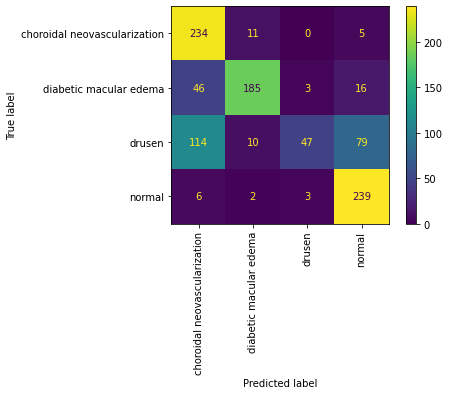

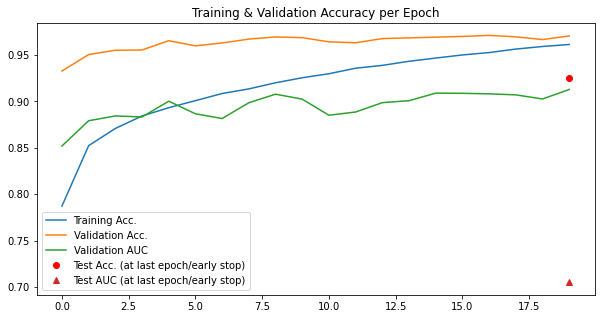

In [66]:
# Runs the classifier again 
clf = run_classifier_pipeline(name_dataset, info_flags, condVAE_loader)

#### Generating an upgraded dataset with Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [67]:
# Creates the augmented dataloader
condVAE_loader = generate_augmented_dataset_condVAE(
    n_channels, n_classes, latent_dims, model_path, 
    base_dataset[0], 64, test_loader, val_loader, 
    n_generated_images, weighted_sampling=True
)

2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "OCTMNIST",
  "description": "The OCTMNIST is based on a prior dataset of 109,309 valid optical coherence tomography (OCT) images for retinal diseases. The dataset is comprised of 4 diagnosis categories, leading to a multi-class classification task. We split the source training set with a ratio of 9:1 into training and validation set, and use its source validation set as the test set. The source images are gray-scale, and their sizes are (384\u22121,536)\u00d7(277\u2212512). We center-crop the images and resize them into 1\u00d728\u00d728.",
  "url": "https://zenodo.org/record/5208230/files/octmnist.npz?download=1",
  "MD5": "c68d92d5b585d8d81f7112f81e2d0842",
  "task": "multi-class",
  "label": {
    "0": "choroidal neovascularization",
    "1": "diabetic macular edema",
    "2": "drusen",
    "3": "normal"
  },
  "n_channels": 1,
  "n_samples": {
    "train": 97477,
    "val": 10832,
    "test": 1000
  },
  "license": "CC BY 4.0"
}
--------------------------------

100%|██████████████████████████████████████| 1584/1584 [00:15<00:00, 104.61it/s]


train -- accuracy: 0.67
val -- accuracy: 0.93,  AUC: 0.79
Epoch 1



100%|██████████████████████████████████████| 1584/1584 [00:15<00:00, 105.54it/s]


train -- accuracy: 0.8
val -- accuracy: 0.94,  AUC: 0.77
Epoch 2



100%|██████████████████████████████████████| 1584/1584 [00:15<00:00, 103.06it/s]


train -- accuracy: 0.83
val -- accuracy: 0.96,  AUC: 0.87
Epoch 3



100%|██████████████████████████████████████| 1584/1584 [00:15<00:00, 102.10it/s]


train -- accuracy: 0.86
val -- accuracy: 0.96,  AUC: 0.88
Epoch 4



100%|██████████████████████████████████████| 1584/1584 [00:15<00:00, 100.50it/s]


train -- accuracy: 0.88
val -- accuracy: 0.95,  AUC: 0.84
Epoch 5



100%|██████████████████████████████████████| 1584/1584 [00:15<00:00, 101.23it/s]


train -- accuracy: 0.89
val -- accuracy: 0.97,  AUC: 0.86
Epoch 6



100%|██████████████████████████████████████| 1584/1584 [00:15<00:00, 101.98it/s]


train -- accuracy: 0.91
val -- accuracy: 0.96,  AUC: 0.84
Epoch 7



100%|██████████████████████████████████████| 1584/1584 [00:15<00:00, 103.32it/s]


train -- accuracy: 0.92
val -- accuracy: 0.96,  AUC: 0.89
Epoch 8



100%|██████████████████████████████████████| 1584/1584 [00:15<00:00, 103.17it/s]


train -- accuracy: 0.92
val -- accuracy: 0.97,  AUC: 0.83
Epoch 9



100%|███████████████████████████████████████| 1584/1584 [00:15<00:00, 99.10it/s]


train -- accuracy: 0.93
val -- accuracy: 0.96,  AUC: 0.87
Epoch 10



100%|███████████████████████████████████████| 1584/1584 [00:15<00:00, 99.21it/s]


train -- accuracy: 0.94
val -- accuracy: 0.97,  AUC: 0.87
Epoch 11



100%|██████████████████████████████████████| 1584/1584 [00:15<00:00, 103.30it/s]


train -- accuracy: 0.94
val -- accuracy: 0.97,  AUC: 0.85
Epoch 12



100%|██████████████████████████████████████| 1584/1584 [00:15<00:00, 102.20it/s]


train -- accuracy: 0.95
val -- accuracy: 0.97,  AUC: 0.9
Epoch 13



100%|██████████████████████████████████████| 1584/1584 [00:15<00:00, 103.46it/s]


train -- accuracy: 0.95
val -- accuracy: 0.97,  AUC: 0.89
Epoch 14



100%|██████████████████████████████████████| 1584/1584 [00:15<00:00, 103.42it/s]


train -- accuracy: 0.96
val -- accuracy: 0.97,  AUC: 0.9
Epoch 15



100%|██████████████████████████████████████| 1584/1584 [00:15<00:00, 102.85it/s]


train -- accuracy: 0.96
val -- accuracy: 0.96,  AUC: 0.9
Epoch 16



100%|██████████████████████████████████████| 1584/1584 [00:15<00:00, 101.69it/s]


train -- accuracy: 0.96
val -- accuracy: 0.96,  AUC: 0.87
Epoch 17



100%|███████████████████████████████████████| 1584/1584 [00:15<00:00, 99.85it/s]


train -- accuracy: 0.97
val -- accuracy: 0.96,  AUC: 0.87
Epoch 18



100%|██████████████████████████████████████| 1584/1584 [00:15<00:00, 103.51it/s]


train -- accuracy: 0.97
val -- accuracy: 0.96,  AUC: 0.89
Epoch 19



100%|██████████████████████████████████████| 1584/1584 [00:15<00:00, 105.14it/s]


train -- accuracy: 0.97
val -- accuracy: 0.96,  AUC: 0.85
test -- accuracy: 0.91,  AUC: 0.69


<Figure size 720x720 with 0 Axes>

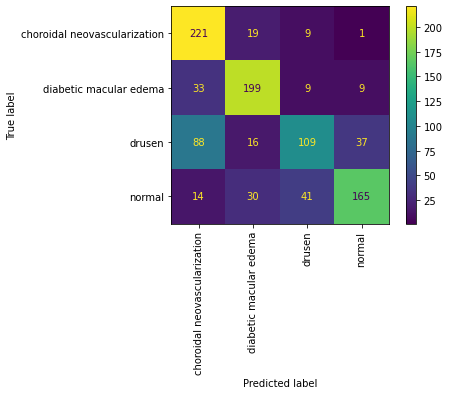

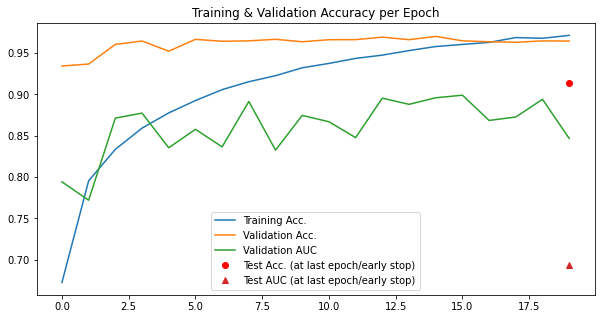

In [68]:
# Runs the classifier again 
clf = run_classifier_pipeline(name_dataset, info_flags, condVAE_loader)

### PneumoniaMNIST

#### Training the Conditional VAE

In [69]:
# Declares the dataset name and retrieves the base dataset
name_dataset = "pneumoniamnist"
base_dataset = pneumoniamnist_noWRS_noGDA

# Retrieves the dataset parameters
n_classes  = len(info_flags[name_dataset][0]["label"])
n_channels = info_flags[name_dataset][0]["n_channels"]

# Retrieves the data loader
train_loader = base_dataset[3]
val_loader = base_dataset[5]
test_loader = base_dataset[4]

Testing Conditional Variational Autoencoder:
Clearing CUDA Pytorch Cache
Model Output size: torch.Size([10, 1, 28, 28])
Forward pass test:  True
{'loss': tensor(8718.3467, grad_fn=<AddBackward0>), 'Reconstruction_Loss': tensor(8718.2480, grad_fn=<MseLossBackward0>), 'KLD': tensor(-19.6374, grad_fn=<NegBackward0>)}
Loss test:  True
Cuda device:  cuda
Training phase:
Train epoch 1 -- average loss: 51.021619928014815
Validation set loss: 29.141819
Train epoch 2 -- average loss: 23.80162039264948
Validation set loss: 18.265114
Train epoch 3 -- average loss: 16.355085944967342
Validation set loss: 13.637569
Train epoch 4 -- average loss: 13.34991159495805
Validation set loss: 11.987748
Train epoch 5 -- average loss: 11.447407141517763
Validation set loss: 11.586944
Train epoch 6 -- average loss: 9.980835751749847
Validation set loss: 8.717211
Train epoch 7 -- average loss: 9.10332562261045
Validation set loss: 8.219842
Train epoch 8 -- average loss: 7.8968904506582875
Validation set loss: 7

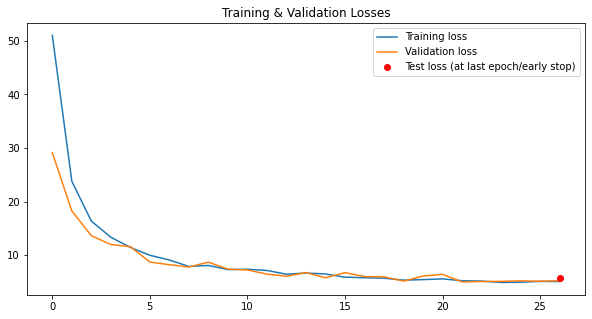

In [70]:
# Runs the conditional VAE
_, _, _, _ = run_encoder_pipeline(
    train_loader, val_loader, test_loader, n_channels, latent_dims,  
    n_classes=n_classes, epochs=epochs, name_dataset=name_dataset, 
    output_intermediary_info=False, model_type="CondVAE"
)

#### Generating an upgraded dataset without Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [71]:
# Fetches the generated VAE Model model to import
model_path = f"trained_models/CondVAE/{name_dataset}/"
model = [x for x in os.listdir(model_path) if x[-4:]==".pth"][-1]
model_path += model

# Calculates the number of images to generate
percentage = 10
nb_images_in_dataset = len(base_dataset[0])
n_generated_images = int((percentage/100)*nb_images_in_dataset)
print(f"Number of generated images: {n_generated_images}",
      f"({percentage}% of the dataset)")

# Creates the augmented dataloader
condVAE_loader = generate_augmented_dataset_condVAE(
    n_channels, n_classes, latent_dims, model_path, 
    base_dataset[0], 64, test_loader, val_loader, 
    n_generated_images, weighted_sampling=False
)

Number of generated images: 470 (10% of the dataset)


2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "PneumoniaMNIST",
  "description": "The PneumoniaMNIST is based on a prior dataset of 5,856 pediatric chest X-Ray images. The task is binary-class classification of pneumonia against normal. We split the source training set with a ratio of 9:1 into training and validation set and use its source validation set as the test set. The source images are gray-scale, and their sizes are (384\u22122,916)\u00d7(127\u22122,713). We center-crop the images and resize them into 1\u00d728\u00d728.",
  "url": "https://zenodo.org/record/5208230/files/pneumoniamnist.npz?download=1",
  "MD5": "28209eda62fecd6e6a2d98b1501bb15f",
  "task": "binary-class",
  "label": {
    "0": "normal",
    "1": "pneumonia"
  },
  "n_channels": 1,
  "n_samples": {
    "train": 4708,
    "val": 524,
    "test": 624
  },
  "license": "CC BY 4.0"
}
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           

100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 109.28it/s]


train -- accuracy: 0.81
val -- accuracy: 0.97,  AUC: 0.93
Epoch 1



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 109.02it/s]


train -- accuracy: 0.93
val -- accuracy: 0.99,  AUC: 0.95
Epoch 2



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 109.35it/s]


train -- accuracy: 0.95
val -- accuracy: 0.99,  AUC: 0.96
Epoch 3



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 108.70it/s]


train -- accuracy: 0.96
val -- accuracy: 1.0,  AUC: 0.97
Epoch 4



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 106.84it/s]


train -- accuracy: 0.97
val -- accuracy: 1.0,  AUC: 0.97
Epoch 5



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 108.22it/s]


train -- accuracy: 0.97
val -- accuracy: 1.0,  AUC: 0.98
Epoch 6



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 109.51it/s]


train -- accuracy: 0.98
val -- accuracy: 1.0,  AUC: 0.97
Epoch 7



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 109.60it/s]


train -- accuracy: 0.98
val -- accuracy: 1.0,  AUC: 0.98
Epoch 8



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 108.98it/s]


train -- accuracy: 0.99
val -- accuracy: 1.0,  AUC: 0.98
Epoch 9



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 109.09it/s]


train -- accuracy: 0.99
val -- accuracy: 1.0,  AUC: 0.98
Epoch 10



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 109.81it/s]


train -- accuracy: 0.99
val -- accuracy: 1.0,  AUC: 0.97
Epoch 11



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 110.34it/s]


train -- accuracy: 0.99
val -- accuracy: 1.0,  AUC: 0.98
Epoch 12



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 108.62it/s]


train -- accuracy: 1.0
val -- accuracy: 1.0,  AUC: 0.98
Epoch 13



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 107.95it/s]


train -- accuracy: 1.0
val -- accuracy: 1.0,  AUC: 0.98
Epoch 14



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 108.35it/s]


train -- accuracy: 1.0
val -- accuracy: 1.0,  AUC: 0.98
Epoch 15



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 107.92it/s]


train -- accuracy: 1.0
val -- accuracy: 1.0,  AUC: 0.98
Epoch 16



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 108.33it/s]


train -- accuracy: 1.0
val -- accuracy: 1.0,  AUC: 0.98
Epoch 17



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 109.03it/s]


train -- accuracy: 1.0
val -- accuracy: 1.0,  AUC: 0.97
Epoch 18



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 109.34it/s]


train -- accuracy: 1.0
val -- accuracy: 1.0,  AUC: 0.98
Epoch 19



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 109.13it/s]


train -- accuracy: 1.0
val -- accuracy: 1.0,  AUC: 0.98
test -- accuracy: 0.97,  AUC: 0.88


<Figure size 720x720 with 0 Axes>

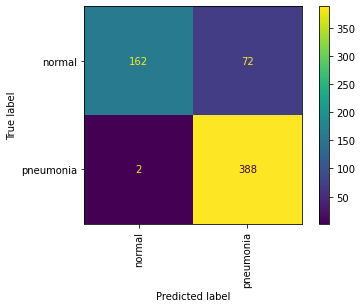

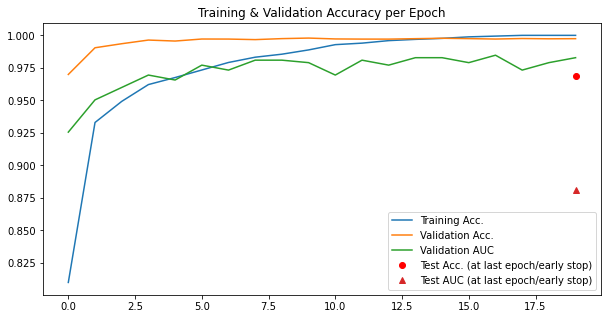

In [72]:
# Runs the classifier again 
clf = run_classifier_pipeline(name_dataset, info_flags, condVAE_loader)

#### Generating an upgraded dataset with Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [73]:
# Creates the augmented dataloader
condVAE_loader = generate_augmented_dataset_condVAE(
    n_channels, n_classes, latent_dims, model_path, 
    base_dataset[0], 64, test_loader, val_loader, 
    n_generated_images, weighted_sampling=True
)

2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "PneumoniaMNIST",
  "description": "The PneumoniaMNIST is based on a prior dataset of 5,856 pediatric chest X-Ray images. The task is binary-class classification of pneumonia against normal. We split the source training set with a ratio of 9:1 into training and validation set and use its source validation set as the test set. The source images are gray-scale, and their sizes are (384\u22122,916)\u00d7(127\u22122,713). We center-crop the images and resize them into 1\u00d728\u00d728.",
  "url": "https://zenodo.org/record/5208230/files/pneumoniamnist.npz?download=1",
  "MD5": "28209eda62fecd6e6a2d98b1501bb15f",
  "task": "binary-class",
  "label": {
    "0": "normal",
    "1": "pneumonia"
  },
  "n_channels": 1,
  "n_samples": {
    "train": 4708,
    "val": 524,
    "test": 624
  },
  "license": "CC BY 4.0"
}
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           

100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 106.40it/s]


train -- accuracy: 0.82
val -- accuracy: 0.98,  AUC: 0.92
Epoch 1



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 106.26it/s]


train -- accuracy: 0.94
val -- accuracy: 0.99,  AUC: 0.94
Epoch 2



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 106.73it/s]


train -- accuracy: 0.95
val -- accuracy: 0.99,  AUC: 0.94
Epoch 3



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 102.19it/s]


train -- accuracy: 0.96
val -- accuracy: 1.0,  AUC: 0.98
Epoch 4



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 105.91it/s]


train -- accuracy: 0.97
val -- accuracy: 0.99,  AUC: 0.97
Epoch 5



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 105.97it/s]


train -- accuracy: 0.98
val -- accuracy: 1.0,  AUC: 0.97
Epoch 6



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 105.03it/s]


train -- accuracy: 0.98
val -- accuracy: 1.0,  AUC: 0.97
Epoch 7



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 105.76it/s]


train -- accuracy: 0.99
val -- accuracy: 1.0,  AUC: 0.97
Epoch 8



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 102.26it/s]


train -- accuracy: 0.99
val -- accuracy: 1.0,  AUC: 0.96
Epoch 9



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 106.71it/s]


train -- accuracy: 0.99
val -- accuracy: 1.0,  AUC: 0.98
Epoch 10



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 106.53it/s]


train -- accuracy: 1.0
val -- accuracy: 1.0,  AUC: 0.97
Epoch 11



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 108.08it/s]


train -- accuracy: 1.0
val -- accuracy: 1.0,  AUC: 0.97
Epoch 12



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 107.55it/s]


train -- accuracy: 1.0
val -- accuracy: 1.0,  AUC: 0.97
Epoch 13



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 108.24it/s]


train -- accuracy: 1.0
val -- accuracy: 1.0,  AUC: 0.97
Epoch 14



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 107.25it/s]


train -- accuracy: 1.0
val -- accuracy: 1.0,  AUC: 0.97
Epoch 15



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 107.89it/s]


train -- accuracy: 1.0
val -- accuracy: 1.0,  AUC: 0.98
Epoch 16



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 107.21it/s]


train -- accuracy: 1.0
val -- accuracy: 1.0,  AUC: 0.97
Epoch 17



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 106.96it/s]


train -- accuracy: 1.0
val -- accuracy: 1.0,  AUC: 0.97
Epoch 18



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 108.22it/s]


train -- accuracy: 1.0
val -- accuracy: 1.0,  AUC: 0.97
Epoch 19



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 107.58it/s]


train -- accuracy: 1.0
val -- accuracy: 1.0,  AUC: 0.97
test -- accuracy: 0.95,  AUC: 0.87


<Figure size 720x720 with 0 Axes>

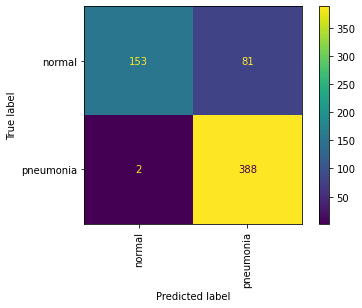

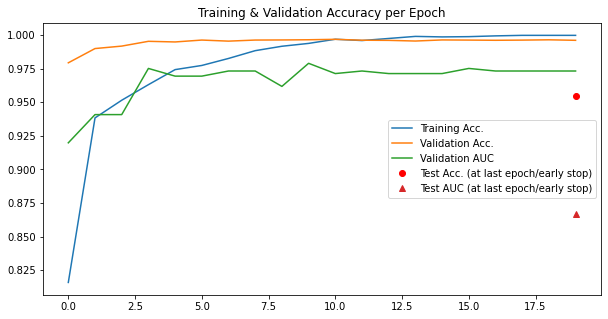

In [74]:
# Runs the classifier again 
clf = run_classifier_pipeline(name_dataset, info_flags, condVAE_loader)

### BreastMNIST

#### Training the Conditional VAE

In [75]:
# Declares the dataset name and retrieves the base dataset
name_dataset = "breastmnist"
base_dataset = breastmnist_noWRS_noGDA

# Retrieves the dataset parameters
n_classes  = len(info_flags[name_dataset][0]["label"])
n_channels = info_flags[name_dataset][0]["n_channels"]

# Retrieves the data loader
train_loader = base_dataset[3]
val_loader = base_dataset[5]
test_loader = base_dataset[4]

Testing Conditional Variational Autoencoder:
Clearing CUDA Pytorch Cache
Model Output size: torch.Size([10, 1, 28, 28])
Forward pass test:  True
{'loss': tensor(8242.1406, grad_fn=<AddBackward0>), 'Reconstruction_Loss': tensor(8242.0479, grad_fn=<MseLossBackward0>), 'KLD': tensor(-18.6498, grad_fn=<NegBackward0>)}
Loss test:  True
Cuda device:  cuda
Training phase:
Train epoch 1 -- average loss: 196.05818058894232
Validation set loss: 174.947867
Train epoch 2 -- average loss: 84.64344826722757
Validation set loss: 134.661195
Train epoch 3 -- average loss: 65.36123601333563
Validation set loss: 135.103128
Train epoch 4 -- average loss: 54.10938662574405
Validation set loss: 103.47824
Train epoch 5 -- average loss: 49.69551751552484
Validation set loss: 62.366211
Train epoch 6 -- average loss: 47.96497699891255
Validation set loss: 50.315445
Train epoch 7 -- average loss: 42.26672072637649
Validation set loss: 42.83211
Train epoch 8 -- average loss: 40.45967968392285
Validation set loss:

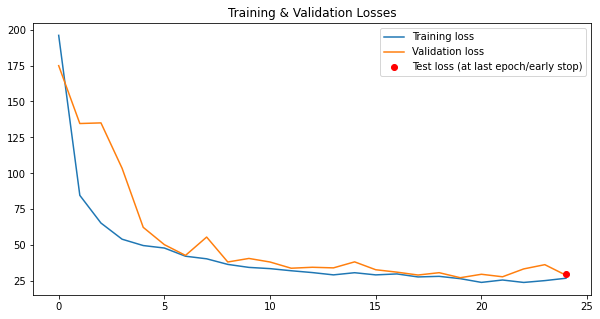

In [76]:
# Runs the conditional VAE
_, _, _, _ = run_encoder_pipeline(
    train_loader, val_loader, test_loader, n_channels, latent_dims,  
    n_classes=n_classes, epochs=epochs, name_dataset=name_dataset, 
    output_intermediary_info=False, model_type="CondVAE"
)

#### Generating an upgraded dataset without Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [77]:
# Fetches the generated VAE Model model to import
model_path = f"trained_models/CondVAE/{name_dataset}/"
model = [x for x in os.listdir(model_path) if x[-4:]==".pth"][-1]
model_path += model

# Calculates the number of images to generate
percentage = 10
nb_images_in_dataset = len(base_dataset[0])
n_generated_images = int((percentage/100)*nb_images_in_dataset)
print(f"Number of generated images: {n_generated_images}",
      f"({percentage}% of the dataset)")

# Creates the augmented dataloader
condVAE_loader = generate_augmented_dataset_condVAE(
    n_channels, n_classes, latent_dims, model_path, 
    base_dataset[0], 64, test_loader, val_loader, 
    n_generated_images, weighted_sampling=False
)

Number of generated images: 54 (10% of the dataset)


2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "BreastMNIST",
  "description": "The BreastMNIST is based on a dataset of 780 breast ultrasound images. It is categorized into 3 classes: normal, benign, and malignant. As we use low-resolution images, we simplify the task into binary classification by combining normal and benign as positive and classifying them against malignant as negative. We split the source dataset with a ratio of 7:1:2 into training, validation and test set. The source images of 1\u00d7500\u00d7500 are resized into 1\u00d728\u00d728.",
  "url": "https://zenodo.org/record/5208230/files/breastmnist.npz?download=1",
  "MD5": "750601b1f35ba3300ea97c75c52ff8f6",
  "task": "binary-class",
  "label": {
    "0": "malignant",
    "1": "normal, benign"
  },
  "n_channels": 1,
  "n_samples": {
    "train": 546,
    "val": 78,
    "test": 156
  },
  "license": "CC BY 4.0"
}
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
    

100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 106.82it/s]


train -- accuracy: 0.61
val -- accuracy: 0.71,  AUC: 0.73
Epoch 1



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 111.34it/s]


train -- accuracy: 0.73
val -- accuracy: 0.71,  AUC: 0.73
Epoch 2



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 111.07it/s]


train -- accuracy: 0.73
val -- accuracy: 0.67,  AUC: 0.73
Epoch 3



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 113.53it/s]


train -- accuracy: 0.73
val -- accuracy: 0.69,  AUC: 0.73
Epoch 4



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 112.56it/s]


train -- accuracy: 0.73
val -- accuracy: 0.72,  AUC: 0.73
Epoch 5



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 112.69it/s]


train -- accuracy: 0.73
val -- accuracy: 0.73,  AUC: 0.73
Epoch 6



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 113.53it/s]


train -- accuracy: 0.73
val -- accuracy: 0.74,  AUC: 0.73
Epoch 7



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 109.84it/s]


train -- accuracy: 0.73
val -- accuracy: 0.76,  AUC: 0.73
Epoch 8



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 113.96it/s]


train -- accuracy: 0.73
val -- accuracy: 0.77,  AUC: 0.73
Epoch 9



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 112.05it/s]


train -- accuracy: 0.73
val -- accuracy: 0.78,  AUC: 0.73
Epoch 10



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 111.69it/s]


train -- accuracy: 0.74
val -- accuracy: 0.79,  AUC: 0.73
Epoch 11



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 107.53it/s]


train -- accuracy: 0.74
val -- accuracy: 0.8,  AUC: 0.74
Epoch 12



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 112.33it/s]


train -- accuracy: 0.75
val -- accuracy: 0.81,  AUC: 0.76
Epoch 13



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 110.29it/s]


train -- accuracy: 0.76
val -- accuracy: 0.81,  AUC: 0.78
Epoch 14



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 110.41it/s]


train -- accuracy: 0.77
val -- accuracy: 0.82,  AUC: 0.78
Epoch 15



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 112.49it/s]


train -- accuracy: 0.79
val -- accuracy: 0.83,  AUC: 0.79
Epoch 16



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 111.45it/s]


train -- accuracy: 0.8
val -- accuracy: 0.84,  AUC: 0.81
Epoch 17



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 114.58it/s]


train -- accuracy: 0.81
val -- accuracy: 0.85,  AUC: 0.82
Epoch 18



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 111.32it/s]


train -- accuracy: 0.83
val -- accuracy: 0.86,  AUC: 0.82
Epoch 19



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 112.11it/s]

train -- accuracy: 0.83
val -- accuracy: 0.87,  AUC: 0.83
test -- accuracy: 0.85,  AUC: 0.79


<Figure size 720x720 with 0 Axes>

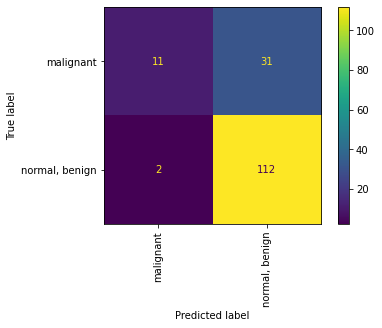

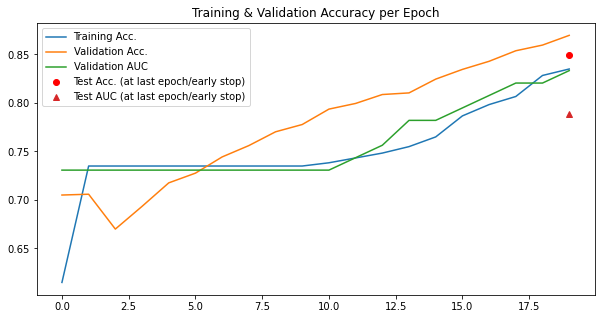

In [78]:
# Runs the classifier again 
clf = run_classifier_pipeline(name_dataset, info_flags, condVAE_loader)

#### Generating an upgraded dataset with Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [79]:
# Creates the augmented dataloader
condVAE_loader = generate_augmented_dataset_condVAE(
    n_channels, n_classes, latent_dims, model_path, 
    base_dataset[0], 64, test_loader, val_loader, 
    n_generated_images, weighted_sampling=True
)

2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "BreastMNIST",
  "description": "The BreastMNIST is based on a dataset of 780 breast ultrasound images. It is categorized into 3 classes: normal, benign, and malignant. As we use low-resolution images, we simplify the task into binary classification by combining normal and benign as positive and classifying them against malignant as negative. We split the source dataset with a ratio of 7:1:2 into training, validation and test set. The source images of 1\u00d7500\u00d7500 are resized into 1\u00d728\u00d728.",
  "url": "https://zenodo.org/record/5208230/files/breastmnist.npz?download=1",
  "MD5": "750601b1f35ba3300ea97c75c52ff8f6",
  "task": "binary-class",
  "label": {
    "0": "malignant",
    "1": "normal, benign"
  },
  "n_channels": 1,
  "n_samples": {
    "train": 546,
    "val": 78,
    "test": 156
  },
  "license": "CC BY 4.0"
}
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
    

100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 109.87it/s]


train -- accuracy: 0.48
val -- accuracy: 0.63,  AUC: 0.73
Epoch 1



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 112.17it/s]


train -- accuracy: 0.52
val -- accuracy: 0.63,  AUC: 0.73
Epoch 2



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 114.04it/s]


train -- accuracy: 0.66
val -- accuracy: 0.71,  AUC: 0.72
Epoch 3



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 112.29it/s]


train -- accuracy: 0.7
val -- accuracy: 0.75,  AUC: 0.76
Epoch 4



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 112.20it/s]


train -- accuracy: 0.67
val -- accuracy: 0.78,  AUC: 0.74
Epoch 5



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 112.72it/s]


train -- accuracy: 0.68
val -- accuracy: 0.8,  AUC: 0.77
Epoch 6



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 112.66it/s]


train -- accuracy: 0.73
val -- accuracy: 0.81,  AUC: 0.77
Epoch 7



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 114.27it/s]


train -- accuracy: 0.7
val -- accuracy: 0.81,  AUC: 0.77
Epoch 8



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 111.07it/s]


train -- accuracy: 0.72
val -- accuracy: 0.81,  AUC: 0.79
Epoch 9



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 113.50it/s]


train -- accuracy: 0.75
val -- accuracy: 0.82,  AUC: 0.78
Epoch 10



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 111.47it/s]


train -- accuracy: 0.78
val -- accuracy: 0.82,  AUC: 0.78
Epoch 11



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 111.41it/s]


train -- accuracy: 0.77
val -- accuracy: 0.85,  AUC: 0.78
Epoch 12



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 112.78it/s]


train -- accuracy: 0.79
val -- accuracy: 0.85,  AUC: 0.78
Epoch 13



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 110.96it/s]


train -- accuracy: 0.82
val -- accuracy: 0.86,  AUC: 0.77
Epoch 14



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 112.16it/s]


train -- accuracy: 0.88
val -- accuracy: 0.87,  AUC: 0.77
Epoch 15



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 114.30it/s]


train -- accuracy: 0.85
val -- accuracy: 0.87,  AUC: 0.78
Epoch 16



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 110.80it/s]


train -- accuracy: 0.89
val -- accuracy: 0.88,  AUC: 0.81
Epoch 17



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 111.96it/s]


train -- accuracy: 0.93
val -- accuracy: 0.89,  AUC: 0.77
Epoch 18



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 112.15it/s]


train -- accuracy: 0.91
val -- accuracy: 0.9,  AUC: 0.81
Epoch 19



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 114.25it/s]


train -- accuracy: 0.95
val -- accuracy: 0.9,  AUC: 0.85
test -- accuracy: 0.86,  AUC: 0.79


<Figure size 720x720 with 0 Axes>

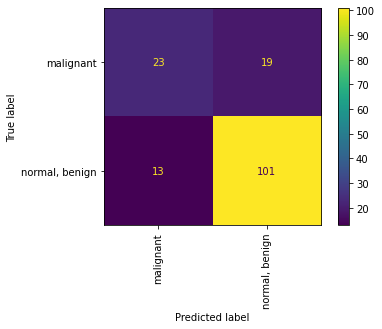

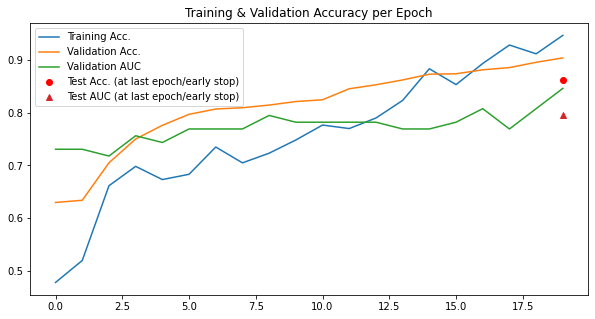

In [80]:
# Runs the classifier again 
clf = run_classifier_pipeline(name_dataset, info_flags, condVAE_loader)

### OrganaMNIST

#### Training the Conditional VAE

In [81]:
# Declares the dataset name and retrieves the base dataset
name_dataset = "organamnist"
base_dataset = organamnist_noWRS_noGDA

# Retrieves the dataset parameters
n_classes  = len(info_flags[name_dataset][0]["label"])
n_channels = info_flags[name_dataset][0]["n_channels"]

# Retrieves the data loader
train_loader = base_dataset[3]
val_loader = base_dataset[5]
test_loader = base_dataset[4]

Testing Conditional Variational Autoencoder:
Clearing CUDA Pytorch Cache
Model Output size: torch.Size([10, 1, 28, 28])
Forward pass test:  True
{'loss': tensor(8672.7139, grad_fn=<AddBackward0>), 'Reconstruction_Loss': tensor(8672.6211, grad_fn=<MseLossBackward0>), 'KLD': tensor(-18.5868, grad_fn=<NegBackward0>)}
Loss test:  True
Cuda device:  cuda
Training phase:
Train epoch 1 -- average loss: 109.14906746767328
Validation set loss: 93.103067
Train epoch 2 -- average loss: 69.89400843140471
Validation set loss: 73.177671
Train epoch 3 -- average loss: 59.06853817918551
Validation set loss: 67.700299
Train epoch 4 -- average loss: 53.639313498674305
Validation set loss: 64.907409
Train epoch 5 -- average loss: 49.65345338223686
Validation set loss: 62.648891
Train epoch 6 -- average loss: 47.109659724829704
Validation set loss: 60.400081
Train epoch 7 -- average loss: 44.22831594979507
Validation set loss: 59.79712
Train epoch 8 -- average loss: 43.134475562837295
Validation set loss:

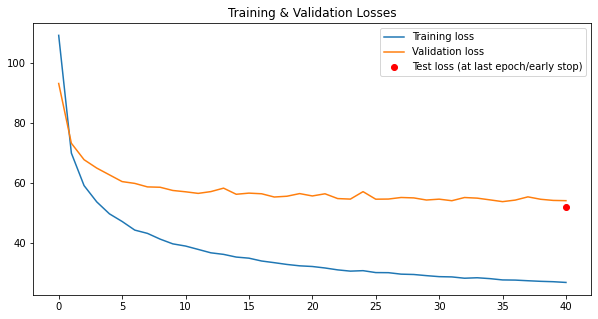

In [82]:
# Runs the conditional VAE
_, _, _, _ = run_encoder_pipeline(
    train_loader, val_loader, test_loader, n_channels, latent_dims,  
    n_classes=n_classes, epochs=epochs, name_dataset=name_dataset, 
    output_intermediary_info=False, model_type="CondVAE"
)

#### Generating an upgraded dataset without Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [83]:
# Fetches the generated VAE Model model to import
model_path = f"trained_models/CondVAE/{name_dataset}/"
model = [x for x in os.listdir(model_path) if x[-4:]==".pth"][-1]
model_path += model

# Calculates the number of images to generate
percentage = 5
nb_images_in_dataset = len(base_dataset[0])
n_generated_images = int((percentage/100)*nb_images_in_dataset)
print(f"Number of generated images: {n_generated_images}",
      f"({percentage}% of the dataset)")

# Creates the augmented dataloader
condVAE_loader = generate_augmented_dataset_condVAE(
    n_channels, n_classes, latent_dims, model_path, 
    base_dataset[0], 64, test_loader, val_loader, 
    n_generated_images, weighted_sampling=False
)

Number of generated images: 1729 (5% of the dataset)


2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "OrganAMNIST",
  "description": "The OrganAMNIST is based on 3D computed tomography (CT) images from Liver Tumor Segmentation Benchmark (LiTS). It is renamed from OrganMNIST_Axial (in MedMNIST v1) for simplicity. We use bounding-box annotations of 11 body organs from another study to obtain the organ labels. Hounsfield-Unit (HU) of the 3D images are transformed into gray-scale with an abdominal window. We crop 2D images from the center slices of the 3D bounding boxes in axial views (planes). The images are resized into 1\u00d728\u00d728 to perform multi-class classification of 11 body organs. 115 and 16 CT scans from the source training set are used as training and validation set, respectively. The 70 CT scans from the source test set are treated as the test set.",
  "url": "https://zenodo.org/record/5208230/files/organamnist.npz?download=1",
  "MD5": "866b832ed4eeba67bfb9edee1d5544e6",
  "task": "multi-class",
  "label": {
    "0": "bladder",
    "1": "femur-left",

100%|█████████████████████████████████████████| 568/568 [00:05<00:00, 97.86it/s]


train -- accuracy: 0.59
val -- accuracy: 0.99,  AUC: 0.9
Epoch 1



100%|█████████████████████████████████████████| 568/568 [00:06<00:00, 94.14it/s]


train -- accuracy: 0.86
val -- accuracy: 1.0,  AUC: 0.94
Epoch 2



100%|████████████████████████████████████████| 568/568 [00:05<00:00, 100.17it/s]


train -- accuracy: 0.92
val -- accuracy: 1.0,  AUC: 0.96
Epoch 3



100%|████████████████████████████████████████| 568/568 [00:05<00:00, 109.06it/s]


train -- accuracy: 0.95
val -- accuracy: 1.0,  AUC: 0.96
Epoch 4



100%|████████████████████████████████████████| 568/568 [00:05<00:00, 111.45it/s]


train -- accuracy: 0.96
val -- accuracy: 1.0,  AUC: 0.97
Epoch 5



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 114.20it/s]


train -- accuracy: 0.97
val -- accuracy: 1.0,  AUC: 0.96
Epoch 6



100%|████████████████████████████████████████| 568/568 [00:05<00:00, 110.83it/s]


train -- accuracy: 0.98
val -- accuracy: 1.0,  AUC: 0.97
Epoch 7



100%|████████████████████████████████████████| 568/568 [00:05<00:00, 104.19it/s]


train -- accuracy: 0.99
val -- accuracy: 1.0,  AUC: 0.96
Epoch 8



100%|████████████████████████████████████████| 568/568 [00:05<00:00, 111.24it/s]


train -- accuracy: 0.99
val -- accuracy: 1.0,  AUC: 0.97
Epoch 9



100%|████████████████████████████████████████| 568/568 [00:05<00:00, 103.15it/s]


train -- accuracy: 0.99
val -- accuracy: 1.0,  AUC: 0.96
Epoch 10



100%|████████████████████████████████████████| 568/568 [00:05<00:00, 107.27it/s]


train -- accuracy: 0.99
val -- accuracy: 1.0,  AUC: 0.97
Epoch 11



100%|█████████████████████████████████████████| 568/568 [00:06<00:00, 94.37it/s]


train -- accuracy: 1.0
val -- accuracy: 1.0,  AUC: 0.97
Epoch 12



100%|████████████████████████████████████████| 568/568 [00:05<00:00, 100.45it/s]


train -- accuracy: 1.0
val -- accuracy: 1.0,  AUC: 0.98
Epoch 13



100%|█████████████████████████████████████████| 568/568 [00:05<00:00, 98.01it/s]


train -- accuracy: 1.0
val -- accuracy: 1.0,  AUC: 0.97
Epoch 14



100%|█████████████████████████████████████████| 568/568 [00:05<00:00, 99.87it/s]


train -- accuracy: 1.0
val -- accuracy: 1.0,  AUC: 0.97
Epoch 15



100%|████████████████████████████████████████| 568/568 [00:05<00:00, 100.78it/s]


train -- accuracy: 1.0
val -- accuracy: 1.0,  AUC: 0.97
Epoch 16



100%|████████████████████████████████████████| 568/568 [00:05<00:00, 102.75it/s]


train -- accuracy: 1.0
val -- accuracy: 1.0,  AUC: 0.97
Epoch 17



100%|████████████████████████████████████████| 568/568 [00:05<00:00, 107.96it/s]


train -- accuracy: 1.0
val -- accuracy: 1.0,  AUC: 0.97
Epoch 18



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 116.51it/s]


train -- accuracy: 1.0
val -- accuracy: 1.0,  AUC: 0.97
Epoch 19



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 116.46it/s]


train -- accuracy: 1.0
val -- accuracy: 1.0,  AUC: 0.97
test -- accuracy: 0.99,  AUC: 0.88


<Figure size 720x720 with 0 Axes>

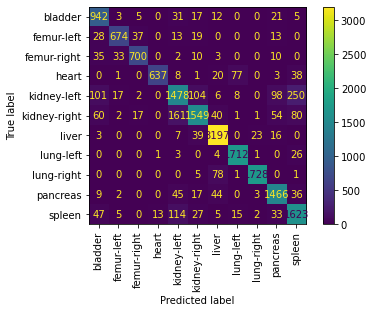

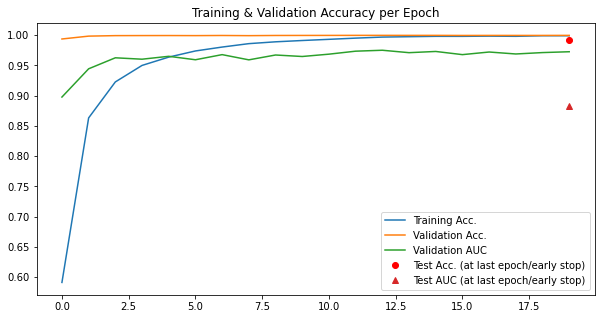

In [84]:
# Runs the classifier again 
clf = run_classifier_pipeline(name_dataset, info_flags, condVAE_loader)

#### Generating an upgraded dataset with Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [85]:
# Creates the augmented dataloader
condVAE_loader = generate_augmented_dataset_condVAE(
    n_channels, n_classes, latent_dims, model_path, 
    base_dataset[0], 64, test_loader, val_loader, 
    n_generated_images, weighted_sampling=True
)

2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "OrganAMNIST",
  "description": "The OrganAMNIST is based on 3D computed tomography (CT) images from Liver Tumor Segmentation Benchmark (LiTS). It is renamed from OrganMNIST_Axial (in MedMNIST v1) for simplicity. We use bounding-box annotations of 11 body organs from another study to obtain the organ labels. Hounsfield-Unit (HU) of the 3D images are transformed into gray-scale with an abdominal window. We crop 2D images from the center slices of the 3D bounding boxes in axial views (planes). The images are resized into 1\u00d728\u00d728 to perform multi-class classification of 11 body organs. 115 and 16 CT scans from the source training set are used as training and validation set, respectively. The 70 CT scans from the source test set are treated as the test set.",
  "url": "https://zenodo.org/record/5208230/files/organamnist.npz?download=1",
  "MD5": "866b832ed4eeba67bfb9edee1d5544e6",
  "task": "multi-class",
  "label": {
    "0": "bladder",
    "1": "femur-left",

100%|████████████████████████████████████████| 568/568 [00:04<00:00, 116.89it/s]


train -- accuracy: 0.58
val -- accuracy: 0.99,  AUC: 0.91
Epoch 1



100%|████████████████████████████████████████| 568/568 [00:05<00:00, 112.58it/s]


train -- accuracy: 0.86
val -- accuracy: 1.0,  AUC: 0.94
Epoch 2



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 115.63it/s]


train -- accuracy: 0.92
val -- accuracy: 1.0,  AUC: 0.97
Epoch 3



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 116.90it/s]


train -- accuracy: 0.95
val -- accuracy: 1.0,  AUC: 0.97
Epoch 4



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 116.89it/s]


train -- accuracy: 0.96
val -- accuracy: 1.0,  AUC: 0.97
Epoch 5



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 116.65it/s]


train -- accuracy: 0.97
val -- accuracy: 1.0,  AUC: 0.97
Epoch 6



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 115.75it/s]


train -- accuracy: 0.98
val -- accuracy: 1.0,  AUC: 0.96
Epoch 7



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 117.01it/s]


train -- accuracy: 0.98
val -- accuracy: 1.0,  AUC: 0.97
Epoch 8



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 116.52it/s]


train -- accuracy: 0.99
val -- accuracy: 1.0,  AUC: 0.97
Epoch 9



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 116.46it/s]


train -- accuracy: 0.99
val -- accuracy: 1.0,  AUC: 0.97
Epoch 10



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 116.86it/s]


train -- accuracy: 0.99
val -- accuracy: 1.0,  AUC: 0.97
Epoch 11



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 116.97it/s]


train -- accuracy: 0.99
val -- accuracy: 1.0,  AUC: 0.96
Epoch 12



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 116.83it/s]


train -- accuracy: 0.99
val -- accuracy: 1.0,  AUC: 0.97
Epoch 13



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 116.60it/s]


train -- accuracy: 1.0
val -- accuracy: 1.0,  AUC: 0.97
Epoch 14



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 116.64it/s]


train -- accuracy: 1.0
val -- accuracy: 1.0,  AUC: 0.97
Epoch 15



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 116.52it/s]


train -- accuracy: 1.0
val -- accuracy: 1.0,  AUC: 0.98
Epoch 16



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 116.66it/s]


train -- accuracy: 1.0
val -- accuracy: 1.0,  AUC: 0.97
Epoch 17



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 116.61it/s]


train -- accuracy: 1.0
val -- accuracy: 1.0,  AUC: 0.97
Epoch 18



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 116.64it/s]


train -- accuracy: 1.0
val -- accuracy: 1.0,  AUC: 0.97
Epoch 19



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 116.58it/s]


train -- accuracy: 1.0
val -- accuracy: 1.0,  AUC: 0.97
test -- accuracy: 0.99,  AUC: 0.89


<Figure size 720x720 with 0 Axes>

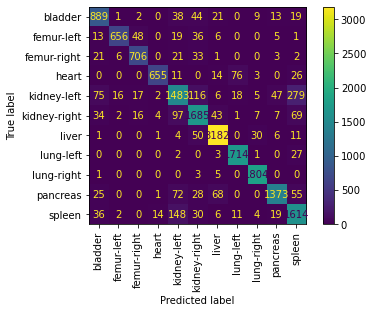

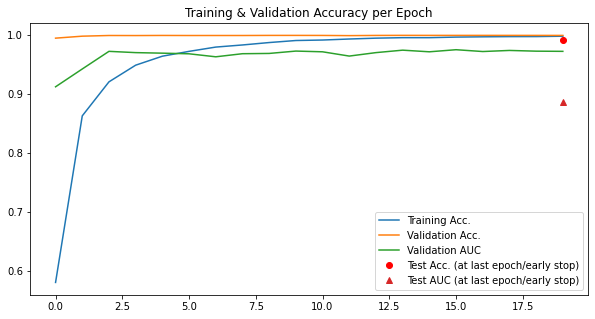

In [86]:
# Runs the classifier again 
clf = run_classifier_pipeline(name_dataset, info_flags, condVAE_loader)

### OrgancMNIST

#### Training the Conditional VAE

In [87]:
# Declares the dataset name and retrieves the base dataset
name_dataset = "organcmnist"
base_dataset = organcmnist_noWRS_noGDA

# Retrieves the dataset parameters
n_classes  = len(info_flags[name_dataset][0]["label"])
n_channels = info_flags[name_dataset][0]["n_channels"]

# Retrieves the data loader
train_loader = base_dataset[3]
val_loader = base_dataset[5]
test_loader = base_dataset[4]

Testing Conditional Variational Autoencoder:
Clearing CUDA Pytorch Cache
Model Output size: torch.Size([10, 1, 28, 28])
Forward pass test:  True
{'loss': tensor(8405.7178, grad_fn=<AddBackward0>), 'Reconstruction_Loss': tensor(8405.6191, grad_fn=<MseLossBackward0>), 'KLD': tensor(-19.7764, grad_fn=<NegBackward0>)}
Loss test:  True
Cuda device:  cuda
Training phase:
Train epoch 1 -- average loss: 142.11395560396636
Validation set loss: 111.26904
Train epoch 2 -- average loss: 91.65513739483173
Validation set loss: 93.161376
Train epoch 3 -- average loss: 76.84497712590144
Validation set loss: 79.905262
Train epoch 4 -- average loss: 67.93064017427885
Validation set loss: 74.53006
Train epoch 5 -- average loss: 62.73769685246394
Validation set loss: 69.121843
Train epoch 6 -- average loss: 60.22161508413461
Validation set loss: 66.990867
Train epoch 7 -- average loss: 56.11025495793269
Validation set loss: 65.397641
Train epoch 8 -- average loss: 53.40659001277043
Validation set loss: 63

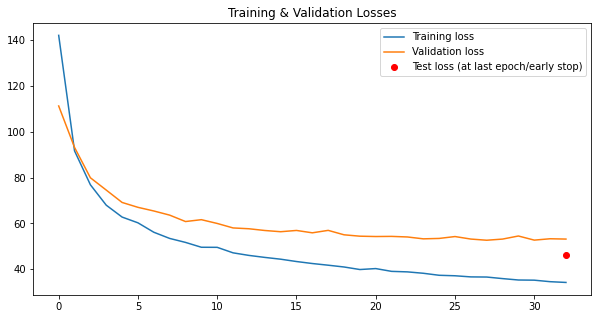

In [88]:
# Runs the conditional VAE
_, _, _, _ = run_encoder_pipeline(
    train_loader, val_loader, test_loader, n_channels, latent_dims,  
    n_classes=n_classes, epochs=epochs, name_dataset=name_dataset, 
    output_intermediary_info=False, model_type="CondVAE"
)

#### Generating an upgraded dataset without Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [89]:
# Fetches the generated VAE Model model to import
model_path = f"trained_models/CondVAE/{name_dataset}/"
model = [x for x in os.listdir(model_path) if x[-4:]==".pth"][-1]
model_path += model

# Calculates the number of images to generate
percentage = 10
nb_images_in_dataset = len(base_dataset[0])
n_generated_images = int((percentage/100)*nb_images_in_dataset)
print(f"Number of generated images: {n_generated_images}",
      f"({percentage}% of the dataset)")

# Creates the augmented dataloader
condVAE_loader = generate_augmented_dataset_condVAE(
    n_channels, n_classes, latent_dims, model_path, 
    base_dataset[0], 64, test_loader, val_loader, 
    n_generated_images, weighted_sampling=False
)

Number of generated images: 1300 (10% of the dataset)


2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "OrganCMNIST",
  "description": "The OrganCMNIST is based on 3D computed tomography (CT) images from Liver Tumor Segmentation Benchmark (LiTS). It is renamed from OrganMNIST_Coronal (in MedMNIST v1) for simplicity. We use bounding-box annotations of 11 body organs from another study to obtain the organ labels. Hounsfield-Unit (HU) of the 3D images are transformed into gray-scale with an abdominal window. We crop 2D images from the center slices of the 3D bounding boxes in coronal views (planes). The images are resized into 1\u00d728\u00d728 to perform multi-class classification of 11 body organs. 115 and 16 CT scans from the source training set are used as training and validation set, respectively. The 70 CT scans from the source test set are treated as the test set.",
  "url": "https://zenodo.org/record/5208230/files/organcmnist.npz?download=1",
  "MD5": "0afa5834fb105f7705a7d93372119a21",
  "task": "multi-class",
  "label": {
    "0": "bladder",
    "1": "femur-le

100%|████████████████████████████████████████| 224/224 [00:01<00:00, 119.13it/s]


train -- accuracy: 0.41
val -- accuracy: 0.95,  AUC: 0.64
Epoch 1



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 119.38it/s]


train -- accuracy: 0.66
val -- accuracy: 0.99,  AUC: 0.81
Epoch 2



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 118.93it/s]


train -- accuracy: 0.77
val -- accuracy: 0.99,  AUC: 0.88
Epoch 3



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 119.50it/s]


train -- accuracy: 0.81
val -- accuracy: 1.0,  AUC: 0.91
Epoch 4



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 113.48it/s]


train -- accuracy: 0.84
val -- accuracy: 1.0,  AUC: 0.92
Epoch 5



100%|████████████████████████████████████████| 224/224 [00:02<00:00, 111.66it/s]


train -- accuracy: 0.86
val -- accuracy: 1.0,  AUC: 0.94
Epoch 6



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 113.04it/s]


train -- accuracy: 0.89
val -- accuracy: 1.0,  AUC: 0.93
Epoch 7



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 115.07it/s]


train -- accuracy: 0.9
val -- accuracy: 1.0,  AUC: 0.94
Epoch 8



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 118.22it/s]


train -- accuracy: 0.91
val -- accuracy: 1.0,  AUC: 0.95
Epoch 9



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 112.81it/s]


train -- accuracy: 0.92
val -- accuracy: 1.0,  AUC: 0.95
Epoch 10



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 112.63it/s]


train -- accuracy: 0.93
val -- accuracy: 1.0,  AUC: 0.96
Epoch 11



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 114.23it/s]


train -- accuracy: 0.94
val -- accuracy: 1.0,  AUC: 0.95
Epoch 12



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 115.53it/s]


train -- accuracy: 0.95
val -- accuracy: 1.0,  AUC: 0.95
Epoch 13



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 119.13it/s]


train -- accuracy: 0.96
val -- accuracy: 1.0,  AUC: 0.94
Epoch 14



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 119.68it/s]


train -- accuracy: 0.97
val -- accuracy: 1.0,  AUC: 0.95
Epoch 15



100%|████████████████████████████████████████| 224/224 [00:02<00:00, 111.08it/s]


train -- accuracy: 0.97
val -- accuracy: 1.0,  AUC: 0.95
Epoch 16



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 114.73it/s]


train -- accuracy: 0.98
val -- accuracy: 1.0,  AUC: 0.96
Epoch 17



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 116.24it/s]


train -- accuracy: 0.98
val -- accuracy: 1.0,  AUC: 0.95
Epoch 18



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 118.91it/s]


train -- accuracy: 0.98
val -- accuracy: 1.0,  AUC: 0.96
Epoch 19



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 119.93it/s]


train -- accuracy: 0.99
val -- accuracy: 1.0,  AUC: 0.96
test -- accuracy: 0.99,  AUC: 0.86


<Figure size 720x720 with 0 Axes>

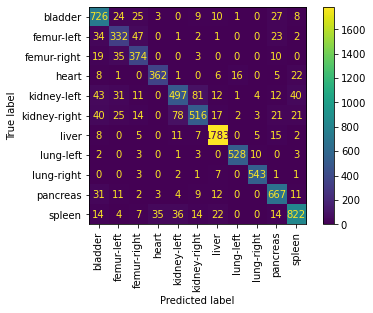

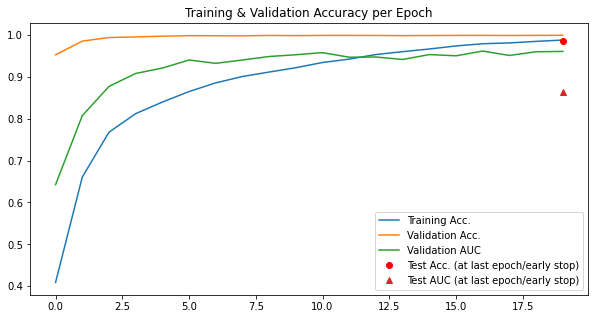

In [90]:
# Runs the classifier again 
clf = run_classifier_pipeline(name_dataset, info_flags, condVAE_loader)

#### Generating an upgraded dataset with Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [91]:
# Creates the augmented dataloader
condVAE_loader = generate_augmented_dataset_condVAE(
    n_channels, n_classes, latent_dims, model_path, 
    base_dataset[0], 64, test_loader, val_loader, 
    n_generated_images, weighted_sampling=True
)

2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "OrganCMNIST",
  "description": "The OrganCMNIST is based on 3D computed tomography (CT) images from Liver Tumor Segmentation Benchmark (LiTS). It is renamed from OrganMNIST_Coronal (in MedMNIST v1) for simplicity. We use bounding-box annotations of 11 body organs from another study to obtain the organ labels. Hounsfield-Unit (HU) of the 3D images are transformed into gray-scale with an abdominal window. We crop 2D images from the center slices of the 3D bounding boxes in coronal views (planes). The images are resized into 1\u00d728\u00d728 to perform multi-class classification of 11 body organs. 115 and 16 CT scans from the source training set are used as training and validation set, respectively. The 70 CT scans from the source test set are treated as the test set.",
  "url": "https://zenodo.org/record/5208230/files/organcmnist.npz?download=1",
  "MD5": "0afa5834fb105f7705a7d93372119a21",
  "task": "multi-class",
  "label": {
    "0": "bladder",
    "1": "femur-le

100%|████████████████████████████████████████| 224/224 [00:01<00:00, 115.25it/s]


train -- accuracy: 0.35
val -- accuracy: 0.95,  AUC: 0.67
Epoch 1



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 116.73it/s]


train -- accuracy: 0.62
val -- accuracy: 0.99,  AUC: 0.84
Epoch 2



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 118.66it/s]


train -- accuracy: 0.75
val -- accuracy: 1.0,  AUC: 0.91
Epoch 3



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 119.70it/s]


train -- accuracy: 0.81
val -- accuracy: 1.0,  AUC: 0.94
Epoch 4



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 116.71it/s]


train -- accuracy: 0.85
val -- accuracy: 1.0,  AUC: 0.95
Epoch 5



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 113.93it/s]


train -- accuracy: 0.87
val -- accuracy: 1.0,  AUC: 0.94
Epoch 6



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 116.83it/s]


train -- accuracy: 0.89
val -- accuracy: 1.0,  AUC: 0.94
Epoch 7



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 120.34it/s]


train -- accuracy: 0.91
val -- accuracy: 1.0,  AUC: 0.96
Epoch 8



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 119.27it/s]


train -- accuracy: 0.92
val -- accuracy: 1.0,  AUC: 0.96
Epoch 9



100%|████████████████████████████████████████| 224/224 [00:02<00:00, 111.47it/s]


train -- accuracy: 0.93
val -- accuracy: 1.0,  AUC: 0.95
Epoch 10



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 112.90it/s]


train -- accuracy: 0.95
val -- accuracy: 1.0,  AUC: 0.95
Epoch 11



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 116.59it/s]


train -- accuracy: 0.95
val -- accuracy: 1.0,  AUC: 0.94
Epoch 12



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 119.62it/s]


train -- accuracy: 0.97
val -- accuracy: 1.0,  AUC: 0.96
Epoch 13



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 117.26it/s]


train -- accuracy: 0.97
val -- accuracy: 1.0,  AUC: 0.96
Epoch 14



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 113.39it/s]


train -- accuracy: 0.97
val -- accuracy: 1.0,  AUC: 0.95
Epoch 15



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 115.88it/s]


train -- accuracy: 0.97
val -- accuracy: 1.0,  AUC: 0.95
Epoch 16



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 119.01it/s]


train -- accuracy: 0.98
val -- accuracy: 1.0,  AUC: 0.95
Epoch 17



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 117.00it/s]


train -- accuracy: 0.99
val -- accuracy: 1.0,  AUC: 0.96
Epoch 18



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 116.23it/s]


train -- accuracy: 0.99
val -- accuracy: 1.0,  AUC: 0.95
Epoch 19



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 115.62it/s]


train -- accuracy: 0.99
val -- accuracy: 1.0,  AUC: 0.96
test -- accuracy: 0.98,  AUC: 0.86


<Figure size 720x720 with 0 Axes>

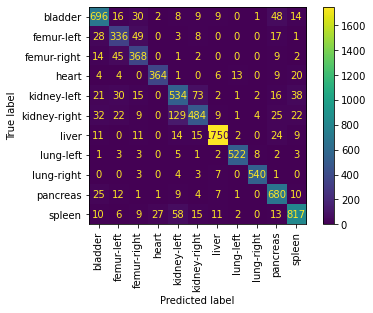

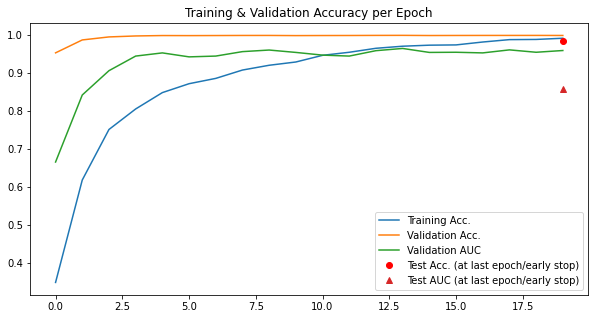

In [92]:
# Runs the classifier again 
clf = run_classifier_pipeline(name_dataset, info_flags, condVAE_loader)

### OrgansMNIST

#### Training the Conditional VAE

In [93]:
# Declares the dataset name and retrieves the base dataset
name_dataset = "organsmnist"
base_dataset = organsmnist_noWRS_noGDA

# Retrieves the dataset parameters
n_classes  = len(info_flags[name_dataset][0]["label"])
n_channels = info_flags[name_dataset][0]["n_channels"]

# Retrieves the data loader
train_loader = base_dataset[3]
val_loader = base_dataset[5]
test_loader = base_dataset[4]

Testing Conditional Variational Autoencoder:
Clearing CUDA Pytorch Cache
Model Output size: torch.Size([10, 1, 28, 28])
Forward pass test:  True
{'loss': tensor(8808.8926, grad_fn=<AddBackward0>), 'Reconstruction_Loss': tensor(8808.7930, grad_fn=<MseLossBackward0>), 'KLD': tensor(-19.9479, grad_fn=<NegBackward0>)}
Loss test:  True
Cuda device:  cuda
Training phase:
Train epoch 1 -- average loss: 144.58273873240225
Validation set loss: 112.667514
Train epoch 2 -- average loss: 94.03701213907819
Validation set loss: 94.924143
Train epoch 3 -- average loss: 78.15221197711173
Validation set loss: 77.870912
Train epoch 4 -- average loss: 69.94548739155533
Validation set loss: 72.940475
Train epoch 5 -- average loss: 63.9676162347561
Validation set loss: 68.335351
Train epoch 6 -- average loss: 59.18310977711397
Validation set loss: 64.595525
Train epoch 7 -- average loss: 56.390943608769724
Validation set loss: 63.243749
Train epoch 8 -- average loss: 53.302442141824336
Validation set loss:

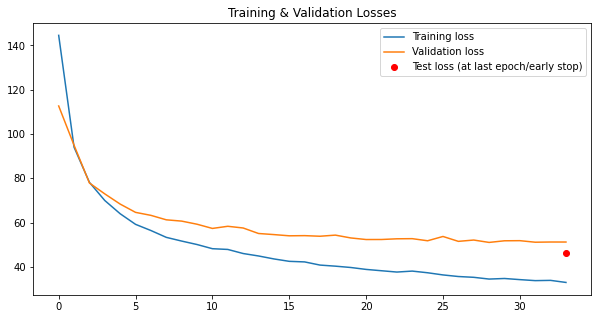

In [94]:
# Runs the conditional VAE
_, _, _, _ = run_encoder_pipeline(
    train_loader, val_loader, test_loader, n_channels, latent_dims,  
    n_classes=n_classes, epochs=epochs, name_dataset=name_dataset, 
    output_intermediary_info=False, model_type="CondVAE"
)

#### Generating an upgraded dataset without Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [95]:
# Fetches the generated VAE Model model to import
model_path = f"trained_models/CondVAE/{name_dataset}/"
model = [x for x in os.listdir(model_path) if x[-4:]==".pth"][-1]
model_path += model

# Calculates the number of images to generate
percentage = 10
nb_images_in_dataset = len(base_dataset[0])
n_generated_images = int((percentage/100)*nb_images_in_dataset)
print(f"Number of generated images: {n_generated_images}",
      f"({percentage}% of the dataset)")

# Creates the augmented dataloader
condVAE_loader = generate_augmented_dataset_condVAE(
    n_channels, n_classes, latent_dims, model_path, 
    base_dataset[0], 64, test_loader, val_loader, 
    n_generated_images, weighted_sampling=False
)

Number of generated images: 1394 (10% of the dataset)


2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "OrganSMNIST",
  "description": "The OrganSMNIST is based on 3D computed tomography (CT) images from Liver Tumor Segmentation Benchmark (LiTS). It is renamed from OrganMNIST_Sagittal (in MedMNIST v1) for simplicity. We use bounding-box annotations of 11 body organs from another study to obtain the organ labels. Hounsfield-Unit (HU) of the 3D images are transformed into gray-scale with an abdominal window. We crop 2D images from the center slices of the 3D bounding boxes in sagittal views (planes). The images are resized into 1\u00d728\u00d728 to perform multi-class classification of 11 body organs. 115 and 16 CT scans from the source training set are used as training and validation set, respectively. The 70 CT scans from the source test set are treated as the test set.",
  "url": "https://zenodo.org/record/5208230/files/organsmnist.npz?download=1",
  "MD5": "e5c39f1af030238290b9557d9503af9d",
  "task": "multi-class",
  "label": {
    "0": "bladder",
    "1": "femur-

100%|████████████████████████████████████████| 240/240 [00:02<00:00, 111.37it/s]


train -- accuracy: 0.3
val -- accuracy: 0.91,  AUC: 0.47
Epoch 1



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 118.20it/s]


train -- accuracy: 0.52
val -- accuracy: 0.97,  AUC: 0.66
Epoch 2



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 117.33it/s]


train -- accuracy: 0.64
val -- accuracy: 0.98,  AUC: 0.72
Epoch 3



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 118.59it/s]


train -- accuracy: 0.7
val -- accuracy: 0.99,  AUC: 0.81
Epoch 4



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 118.80it/s]


train -- accuracy: 0.73
val -- accuracy: 0.99,  AUC: 0.79
Epoch 5



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 118.48it/s]


train -- accuracy: 0.76
val -- accuracy: 0.99,  AUC: 0.83
Epoch 6



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 118.54it/s]


train -- accuracy: 0.79
val -- accuracy: 0.99,  AUC: 0.84
Epoch 7



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 118.77it/s]


train -- accuracy: 0.81
val -- accuracy: 0.99,  AUC: 0.84
Epoch 8



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 113.51it/s]


train -- accuracy: 0.83
val -- accuracy: 0.99,  AUC: 0.84
Epoch 9



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 109.96it/s]


train -- accuracy: 0.85
val -- accuracy: 0.99,  AUC: 0.85
Epoch 10



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 118.60it/s]


train -- accuracy: 0.86
val -- accuracy: 0.99,  AUC: 0.8
Epoch 11



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 119.21it/s]


train -- accuracy: 0.88
val -- accuracy: 0.99,  AUC: 0.86
Epoch 12



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 119.11it/s]


train -- accuracy: 0.89
val -- accuracy: 0.99,  AUC: 0.85
Epoch 13



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 118.78it/s]


train -- accuracy: 0.91
val -- accuracy: 0.99,  AUC: 0.85
Epoch 14



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 118.72it/s]


train -- accuracy: 0.92
val -- accuracy: 0.99,  AUC: 0.86
Epoch 15



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 115.32it/s]


train -- accuracy: 0.93
val -- accuracy: 0.99,  AUC: 0.85
Epoch 16



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 115.81it/s]


train -- accuracy: 0.93
val -- accuracy: 0.99,  AUC: 0.86
Epoch 17



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 118.50it/s]


train -- accuracy: 0.95
val -- accuracy: 0.99,  AUC: 0.87
Epoch 18



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 119.38it/s]


train -- accuracy: 0.95
val -- accuracy: 0.99,  AUC: 0.87
Epoch 19



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 118.88it/s]


train -- accuracy: 0.95
val -- accuracy: 0.99,  AUC: 0.85
test -- accuracy: 0.96,  AUC: 0.72


<Figure size 720x720 with 0 Axes>

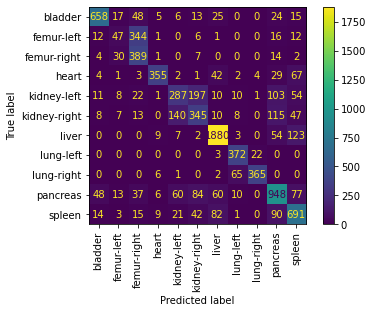

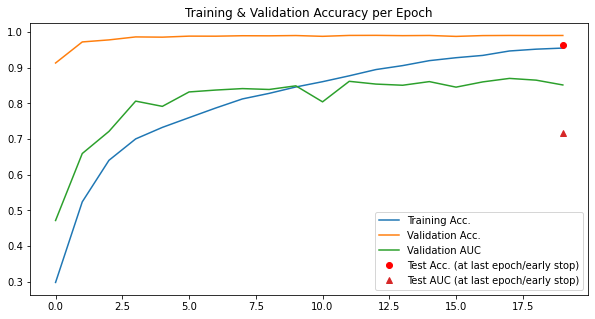

In [96]:
# Runs the classifier again 
clf = run_classifier_pipeline(name_dataset, info_flags, condVAE_loader)

#### Generating an upgraded dataset with Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [97]:
# Creates the augmented dataloader
condVAE_loader = generate_augmented_dataset_condVAE(
    n_channels, n_classes, latent_dims, model_path, 
    base_dataset[0], 64, test_loader, val_loader, 
    n_generated_images, weighted_sampling=True
)

2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "OrganSMNIST",
  "description": "The OrganSMNIST is based on 3D computed tomography (CT) images from Liver Tumor Segmentation Benchmark (LiTS). It is renamed from OrganMNIST_Sagittal (in MedMNIST v1) for simplicity. We use bounding-box annotations of 11 body organs from another study to obtain the organ labels. Hounsfield-Unit (HU) of the 3D images are transformed into gray-scale with an abdominal window. We crop 2D images from the center slices of the 3D bounding boxes in sagittal views (planes). The images are resized into 1\u00d728\u00d728 to perform multi-class classification of 11 body organs. 115 and 16 CT scans from the source training set are used as training and validation set, respectively. The 70 CT scans from the source test set are treated as the test set.",
  "url": "https://zenodo.org/record/5208230/files/organsmnist.npz?download=1",
  "MD5": "e5c39f1af030238290b9557d9503af9d",
  "task": "multi-class",
  "label": {
    "0": "bladder",
    "1": "femur-

100%|████████████████████████████████████████| 240/240 [00:02<00:00, 119.30it/s]


train -- accuracy: 0.31
val -- accuracy: 0.93,  AUC: 0.58
Epoch 1



100%|████████████████████████████████████████| 240/240 [00:01<00:00, 120.22it/s]


train -- accuracy: 0.51
val -- accuracy: 0.97,  AUC: 0.71
Epoch 2



100%|████████████████████████████████████████| 240/240 [00:01<00:00, 120.90it/s]


train -- accuracy: 0.64
val -- accuracy: 0.98,  AUC: 0.75
Epoch 3



100%|████████████████████████████████████████| 240/240 [00:01<00:00, 120.08it/s]


train -- accuracy: 0.69
val -- accuracy: 0.99,  AUC: 0.8
Epoch 4



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 113.79it/s]


train -- accuracy: 0.74
val -- accuracy: 0.99,  AUC: 0.83
Epoch 5



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 119.12it/s]


train -- accuracy: 0.76
val -- accuracy: 0.99,  AUC: 0.85
Epoch 6



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 119.18it/s]


train -- accuracy: 0.78
val -- accuracy: 0.99,  AUC: 0.79
Epoch 7



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 119.82it/s]


train -- accuracy: 0.81
val -- accuracy: 0.99,  AUC: 0.83
Epoch 8



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 119.57it/s]


train -- accuracy: 0.83
val -- accuracy: 0.99,  AUC: 0.83
Epoch 9



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 119.89it/s]


train -- accuracy: 0.85
val -- accuracy: 0.99,  AUC: 0.83
Epoch 10



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 117.10it/s]


train -- accuracy: 0.87
val -- accuracy: 0.99,  AUC: 0.85
Epoch 11



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 117.80it/s]


train -- accuracy: 0.89
val -- accuracy: 0.99,  AUC: 0.84
Epoch 12



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 119.20it/s]


train -- accuracy: 0.91
val -- accuracy: 0.99,  AUC: 0.86
Epoch 13



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 119.96it/s]


train -- accuracy: 0.92
val -- accuracy: 0.99,  AUC: 0.84
Epoch 14



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 118.94it/s]


train -- accuracy: 0.93
val -- accuracy: 0.99,  AUC: 0.84
Epoch 15



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 119.47it/s]


train -- accuracy: 0.94
val -- accuracy: 0.99,  AUC: 0.85
Epoch 16



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 119.51it/s]


train -- accuracy: 0.95
val -- accuracy: 0.99,  AUC: 0.86
Epoch 17



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 116.32it/s]


train -- accuracy: 0.96
val -- accuracy: 0.99,  AUC: 0.84
Epoch 18



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 118.87it/s]


train -- accuracy: 0.97
val -- accuracy: 0.99,  AUC: 0.84
Epoch 19



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 119.10it/s]


train -- accuracy: 0.98
val -- accuracy: 0.99,  AUC: 0.84
test -- accuracy: 0.96,  AUC: 0.72


<Figure size 720x720 with 0 Axes>

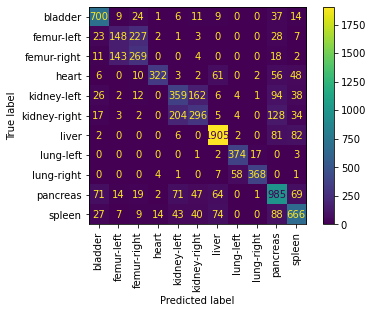

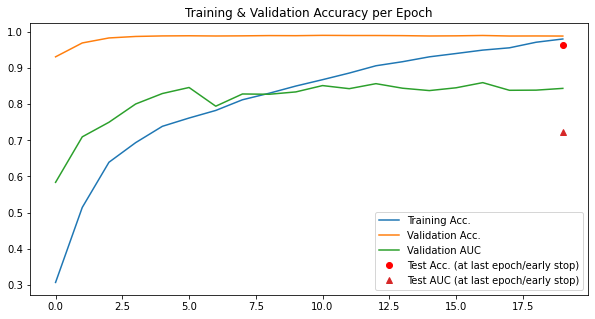

In [98]:
# Runs the classifier again 
clf = run_classifier_pipeline(name_dataset, info_flags, condVAE_loader)

## 5. Training a Joint Variational Autoencoder 

We train a Joint Variational Autoencoder for data augmentation for each of the datasets. 

For each dataset, we then retrain the underlying baseline classifier.

In [99]:
# Declares the Joint VAE's hyperparameters
latent_dims = 100
categorical_dims = 50
epochs = 200

### PathMNIST

#### Training the Joint VAE

In [100]:
# Declares the dataset name and retrieves the base dataset
name_dataset = "pathmnist"
base_dataset = pathmnist_noWRS_noGDA

# Retrieves the dataset parameters
n_channels = info_flags[name_dataset][0]["n_channels"]

# Retrieves the data loader
train_loader = base_dataset[3]
val_loader = base_dataset[5]
test_loader = base_dataset[4]

Testing Joint Variational Autoencoder:
Clearing CUDA Pytorch Cache
Model Output size: torch.Size([10, 3, 28, 28])
Forward pass test:  True
{'loss': tensor(790511.1250, grad_fn=<AddBackward0>), 'Reconstruction_Loss': tensor(26350.3066, grad_fn=<MseLossBackward0>), 'Capacity_Loss': tensor(381.5031, grad_fn=<AddBackward0>)}
Loss test:  True
Cuda device:  cuda
Training phase:
Train epoch 1 -- average loss: 2416.373039148962
Validation set loss: 2040.115334
Train epoch 2 -- average loss: 1843.400142740719
Validation set loss: 1651.038647
Train epoch 3 -- average loss: 1587.406320923291
Validation set loss: 1515.724797
Train epoch 4 -- average loss: 1444.422963373025
Validation set loss: 1434.540555
Train epoch 5 -- average loss: 1384.9318235758394
Validation set loss: 1323.705854
Train epoch 6 -- average loss: 1314.3116402612686
Validation set loss: 1278.075827
Train epoch 7 -- average loss: 1267.2054764282927
Validation set loss: 1264.642971
Train epoch 8 -- average loss: 1230.357212056646

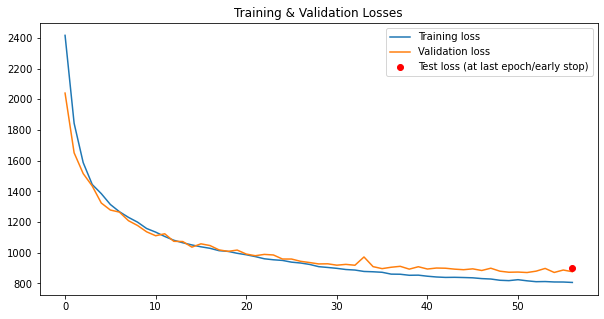

In [101]:
# Runs the Joint VAE
_, _, _, _ = run_encoder_pipeline(
    train_loader, val_loader, test_loader,  n_channels, 
    latent_dims, categorical_dims=categorical_dims,
    epochs=epochs, name_dataset=name_dataset, 
    output_intermediary_info=False, model_type="JointVAE"
)

#### Generating an upgraded dataset without Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [102]:
# Fetches the generated VAE Model model to import
model_path = f"trained_models/JointVAE/{name_dataset}/"
model = [x for x in os.listdir(model_path) if x[-4:]==".pth"][-1]
model_path += model

# Calculates the number of images to generate
percentage = 4
nb_images_in_dataset = len(base_dataset[0])
n_generated_images = int((percentage/100)*nb_images_in_dataset)
print(f"Number of generated images: {n_generated_images}",
      f"({percentage}% of the dataset)")

# Creates the augmented dataloader
jointVAE_loader = generate_augmented_dataset_jointVAE(
    n_channels, latent_dims, categorical_dims, model_path, 
    base_dataset[0], 64, test_loader, val_loader, 
    n_generated_images, weighted_sampling=False
)

Number of generated images: 3599 (4% of the dataset)


2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "PathMNIST",
  "description": "The PathMNIST is based on a prior study for predicting survival from colorectal cancer histology slides, providing a dataset (NCT-CRC-HE-100K) of 100,000 non-overlapping image patches from hematoxylin & eosin stained histological images, and a test dataset (CRC-VAL-HE-7K) of 7,180 image patches from a different clinical center. The dataset is comprised of 9 types of tissues, resulting in a multi-class classification task. We resize the source images of 3\u00d7224\u00d7224 into 3\u00d728\u00d728, and split NCT-CRC-HE-100K into training and validation set with a ratio of 9:1. The CRC-VAL-HE-7K is treated as the test set.",
  "url": "https://zenodo.org/record/5208230/files/pathmnist.npz?download=1",
  "MD5": "a8b06965200029087d5bd730944a56c1",
  "task": "multi-class",
  "label": {
    "0": "adipose",
    "1": "background",
    "2": "debris",
    "3": "lymphocytes",
    "4": "mucus",
    "5": "smooth muscle",
    "6": "normal colon mucosa"

100%|███████████████████████████████████████| 2813/2813 [04:17<00:00, 10.91it/s]


train -- accuracy: 0.41
val -- accuracy: 0.97,  AUC: 0.78
Epoch 1



100%|███████████████████████████████████████| 2813/2813 [04:19<00:00, 10.84it/s]


train -- accuracy: 0.49
val -- accuracy: 0.99,  AUC: 0.85
Epoch 2



100%|███████████████████████████████████████| 2813/2813 [04:17<00:00, 10.91it/s]


train -- accuracy: 0.51
val -- accuracy: 0.99,  AUC: 0.9
Epoch 3



100%|███████████████████████████████████████| 2813/2813 [04:17<00:00, 10.91it/s]


train -- accuracy: 0.52
val -- accuracy: 0.99,  AUC: 0.91
Epoch 4



100%|███████████████████████████████████████| 2813/2813 [04:17<00:00, 10.93it/s]


train -- accuracy: 0.53
val -- accuracy: 1.0,  AUC: 0.91
Epoch 5



100%|███████████████████████████████████████| 2813/2813 [04:17<00:00, 10.92it/s]


train -- accuracy: 0.53
val -- accuracy: 1.0,  AUC: 0.93
Epoch 6



100%|███████████████████████████████████████| 2813/2813 [04:17<00:00, 10.90it/s]


train -- accuracy: 0.54
val -- accuracy: 0.99,  AUC: 0.91
Epoch 7



100%|███████████████████████████████████████| 2813/2813 [04:18<00:00, 10.90it/s]


train -- accuracy: 0.54
val -- accuracy: 1.0,  AUC: 0.94
Epoch 8



100%|███████████████████████████████████████| 2813/2813 [04:18<00:00, 10.90it/s]


train -- accuracy: 0.54
val -- accuracy: 1.0,  AUC: 0.94
Epoch 9



100%|███████████████████████████████████████| 2813/2813 [04:17<00:00, 10.91it/s]


train -- accuracy: 0.55
val -- accuracy: 1.0,  AUC: 0.93
Epoch 10



100%|███████████████████████████████████████| 2813/2813 [04:18<00:00, 10.90it/s]


train -- accuracy: 0.55
val -- accuracy: 1.0,  AUC: 0.94
Epoch 11



100%|███████████████████████████████████████| 2813/2813 [04:17<00:00, 10.92it/s]


train -- accuracy: 0.55
val -- accuracy: 1.0,  AUC: 0.93
Epoch 12



100%|███████████████████████████████████████| 2813/2813 [04:17<00:00, 10.93it/s]


train -- accuracy: 0.55
val -- accuracy: 1.0,  AUC: 0.94
Epoch 13



100%|███████████████████████████████████████| 2813/2813 [04:17<00:00, 10.93it/s]


train -- accuracy: 0.55
val -- accuracy: 1.0,  AUC: 0.94
Epoch 14



100%|███████████████████████████████████████| 2813/2813 [04:18<00:00, 10.89it/s]


train -- accuracy: 0.55
val -- accuracy: 1.0,  AUC: 0.95
Epoch 15



100%|███████████████████████████████████████| 2813/2813 [04:17<00:00, 10.90it/s]


train -- accuracy: 0.56
val -- accuracy: 1.0,  AUC: 0.94
Epoch 16



100%|███████████████████████████████████████| 2813/2813 [04:17<00:00, 10.91it/s]


train -- accuracy: 0.56
val -- accuracy: 1.0,  AUC: 0.95
Epoch 17



100%|███████████████████████████████████████| 2813/2813 [04:17<00:00, 10.92it/s]


train -- accuracy: 0.56
val -- accuracy: 1.0,  AUC: 0.95
Epoch 18



100%|███████████████████████████████████████| 2813/2813 [04:17<00:00, 10.92it/s]


train -- accuracy: 0.56
val -- accuracy: 1.0,  AUC: 0.94
Epoch 19



100%|███████████████████████████████████████| 2813/2813 [04:17<00:00, 10.92it/s]


train -- accuracy: 0.56
val -- accuracy: 1.0,  AUC: 0.95
test -- accuracy: 0.97,  AUC: 0.82


<Figure size 720x720 with 0 Axes>

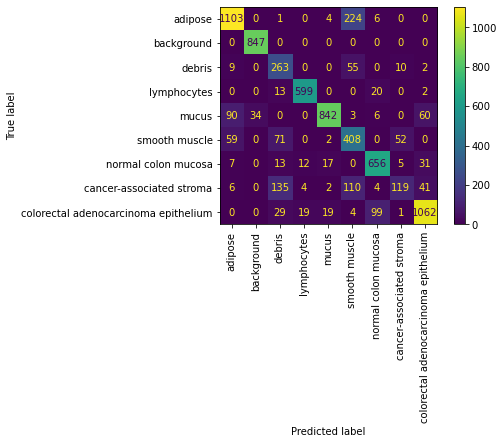

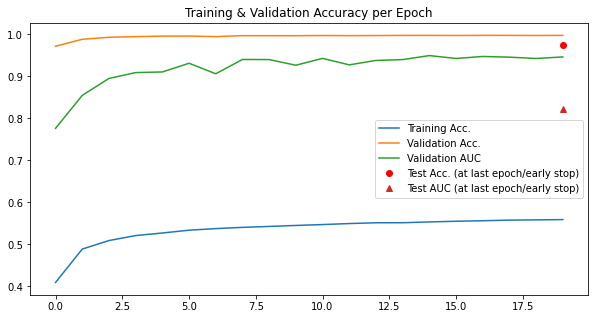

In [103]:
# Runs the classifier again 

clf = run_classifier_pipeline(name_dataset, info_flags, jointVAE_loader)

#### Generating an upgraded dataset with Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [104]:
# Creates the augmented dataloader
jointVAE_loader = generate_augmented_dataset_jointVAE(
    n_channels, latent_dims, categorical_dims, model_path, 
    base_dataset[0], 64, test_loader, val_loader, 
    n_generated_images, weighted_sampling=True
)

2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "PathMNIST",
  "description": "The PathMNIST is based on a prior study for predicting survival from colorectal cancer histology slides, providing a dataset (NCT-CRC-HE-100K) of 100,000 non-overlapping image patches from hematoxylin & eosin stained histological images, and a test dataset (CRC-VAL-HE-7K) of 7,180 image patches from a different clinical center. The dataset is comprised of 9 types of tissues, resulting in a multi-class classification task. We resize the source images of 3\u00d7224\u00d7224 into 3\u00d728\u00d728, and split NCT-CRC-HE-100K into training and validation set with a ratio of 9:1. The CRC-VAL-HE-7K is treated as the test set.",
  "url": "https://zenodo.org/record/5208230/files/pathmnist.npz?download=1",
  "MD5": "a8b06965200029087d5bd730944a56c1",
  "task": "multi-class",
  "label": {
    "0": "adipose",
    "1": "background",
    "2": "debris",
    "3": "lymphocytes",
    "4": "mucus",
    "5": "smooth muscle",
    "6": "normal colon mucosa"

100%|███████████████████████████████████████| 2813/2813 [04:24<00:00, 10.64it/s]


train -- accuracy: 0.4
val -- accuracy: 0.98,  AUC: 0.75
Epoch 1



100%|███████████████████████████████████████| 2813/2813 [04:20<00:00, 10.78it/s]


train -- accuracy: 0.47
val -- accuracy: 0.98,  AUC: 0.81
Epoch 2



100%|███████████████████████████████████████| 2813/2813 [04:21<00:00, 10.76it/s]


train -- accuracy: 0.49
val -- accuracy: 0.99,  AUC: 0.89
Epoch 3



100%|███████████████████████████████████████| 2813/2813 [04:20<00:00, 10.78it/s]


train -- accuracy: 0.5
val -- accuracy: 0.99,  AUC: 0.9
Epoch 4



100%|███████████████████████████████████████| 2813/2813 [04:21<00:00, 10.76it/s]


train -- accuracy: 0.51
val -- accuracy: 0.99,  AUC: 0.91
Epoch 5



100%|███████████████████████████████████████| 2813/2813 [04:20<00:00, 10.80it/s]


train -- accuracy: 0.52
val -- accuracy: 1.0,  AUC: 0.92
Epoch 6



100%|███████████████████████████████████████| 2813/2813 [04:20<00:00, 10.80it/s]


train -- accuracy: 0.52
val -- accuracy: 1.0,  AUC: 0.93
Epoch 7



100%|███████████████████████████████████████| 2813/2813 [04:21<00:00, 10.76it/s]


train -- accuracy: 0.53
val -- accuracy: 1.0,  AUC: 0.93
Epoch 8



100%|███████████████████████████████████████| 2813/2813 [04:21<00:00, 10.75it/s]


train -- accuracy: 0.53
val -- accuracy: 1.0,  AUC: 0.94
Epoch 9



100%|███████████████████████████████████████| 2813/2813 [04:20<00:00, 10.81it/s]


train -- accuracy: 0.53
val -- accuracy: 1.0,  AUC: 0.93
Epoch 10



100%|███████████████████████████████████████| 2813/2813 [04:21<00:00, 10.76it/s]


train -- accuracy: 0.53
val -- accuracy: 1.0,  AUC: 0.93
Epoch 11



100%|███████████████████████████████████████| 2813/2813 [04:21<00:00, 10.77it/s]


train -- accuracy: 0.53
val -- accuracy: 1.0,  AUC: 0.93
Epoch 12



100%|███████████████████████████████████████| 2813/2813 [04:20<00:00, 10.78it/s]


train -- accuracy: 0.54
val -- accuracy: 1.0,  AUC: 0.94
Epoch 13



100%|███████████████████████████████████████| 2813/2813 [04:20<00:00, 10.80it/s]


train -- accuracy: 0.54
val -- accuracy: 1.0,  AUC: 0.94
Epoch 14



100%|███████████████████████████████████████| 2813/2813 [04:25<00:00, 10.59it/s]


train -- accuracy: 0.54
val -- accuracy: 1.0,  AUC: 0.94
Epoch 15



100%|███████████████████████████████████████| 2813/2813 [04:32<00:00, 10.34it/s]


train -- accuracy: 0.54
val -- accuracy: 1.0,  AUC: 0.95
Epoch 16



100%|███████████████████████████████████████| 2813/2813 [04:23<00:00, 10.69it/s]


train -- accuracy: 0.54
val -- accuracy: 1.0,  AUC: 0.94
Epoch 17



100%|███████████████████████████████████████| 2813/2813 [04:41<00:00,  9.99it/s]


train -- accuracy: 0.55
val -- accuracy: 1.0,  AUC: 0.93
Epoch 18



100%|███████████████████████████████████████| 2813/2813 [04:56<00:00,  9.50it/s]


train -- accuracy: 0.54
val -- accuracy: 1.0,  AUC: 0.94
Epoch 19



100%|███████████████████████████████████████| 2813/2813 [04:53<00:00,  9.60it/s]


train -- accuracy: 0.54
val -- accuracy: 1.0,  AUC: 0.94
test -- accuracy: 0.97,  AUC: 0.83


<Figure size 720x720 with 0 Axes>

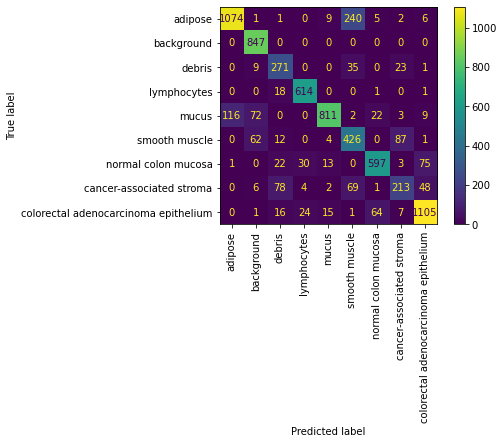

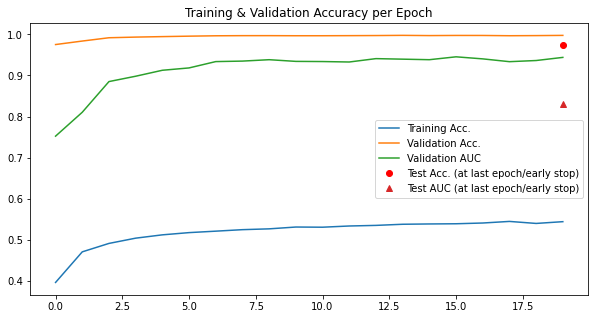

In [106]:
# Runs the classifier again 
clf = run_classifier_pipeline(name_dataset, info_flags, jointVAE_loader)

### DermaMNIST

#### Training the Joint VAE

In [107]:
# Declares the dataset name and retrieves the base dataset
name_dataset = "dermamnist"
base_dataset = dermamnist_noWRS_noGDA

# Retrieves the dataset parameters
n_channels = info_flags[name_dataset][0]["n_channels"]

# Retrieves the data loader
train_loader = base_dataset[3]
val_loader = base_dataset[5]
test_loader = base_dataset[4]

Testing Joint Variational Autoencoder:
Clearing CUDA Pytorch Cache
Model Output size: torch.Size([10, 3, 28, 28])
Forward pass test:  True
{'loss': tensor(803986.3125, grad_fn=<AddBackward0>), 'Reconstruction_Loss': tensor(26799.4863, grad_fn=<MseLossBackward0>), 'Capacity_Loss': tensor(351.2575, grad_fn=<AddBackward0>)}
Loss test:  True
Cuda device:  cuda
Training phase:
Train epoch 1 -- average loss: 4481.347462805052
Validation set loss: 3231.937188
Train epoch 2 -- average loss: 2113.8553522370485
Validation set loss: 2218.731477
Train epoch 3 -- average loss: 1771.8789335664335
Validation set loss: 1905.263693
Train epoch 4 -- average loss: 1326.9101746467818
Validation set loss: 1245.973065
Train epoch 5 -- average loss: 1157.482051430712
Validation set loss: 1017.909841
Train epoch 6 -- average loss: 987.645102665192
Validation set loss: 942.940507
Train epoch 7 -- average loss: 922.1622975239046
Validation set loss: 844.994929
Train epoch 8 -- average loss: 876.3482209754532
Va

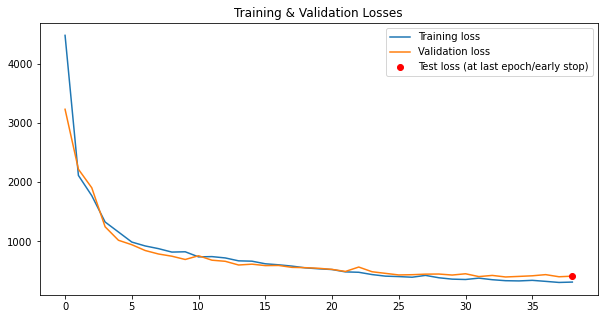

In [108]:
# Runs the Joint VAE
_, _, _, _ = run_encoder_pipeline(
    train_loader, val_loader, test_loader,  n_channels, 
    latent_dims, categorical_dims=categorical_dims,
    epochs=epochs, name_dataset=name_dataset, 
    output_intermediary_info=False, model_type="JointVAE"
)

#### Generating an upgraded dataset without Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [109]:
# Fetches the generated VAE Model model to import
model_path = f"trained_models/JointVAE/{name_dataset}/"
model = [x for x in os.listdir(model_path) if x[-4:]==".pth"][-1]
model_path += model

# Calculates the number of images to generate
percentage = 10
nb_images_in_dataset = len(base_dataset[0])
n_generated_images = int((percentage/100)*nb_images_in_dataset)
print(f"Number of generated images: {n_generated_images}",
      f"({percentage}% of the dataset)")

# Creates the augmented dataloader
jointVAE_loader = generate_augmented_dataset_jointVAE(
    n_channels, latent_dims, categorical_dims, model_path, 
    base_dataset[0], 64, test_loader, val_loader, 
    n_generated_images, weighted_sampling=False
)

Number of generated images: 700 (10% of the dataset)


2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "DermaMNIST",
  "description": "The DermaMNIST is based on the HAM10000, a large collection of multi-source dermatoscopic images of common pigmented skin lesions. The dataset consists of 10,015 dermatoscopic images categorized as 7 different diseases, formulized as a multi-class classification task. We split the images into training, validation and test set with a ratio of 7:1:2. The source images of 3\u00d7600\u00d7450 are resized into 3\u00d728\u00d728.",
  "url": "https://zenodo.org/record/5208230/files/dermamnist.npz?download=1",
  "MD5": "0744692d530f8e62ec473284d019b0c7",
  "task": "multi-class",
  "label": {
    "0": "actinic keratoses and intraepithelial carcinoma",
    "1": "basal cell carcinoma",
    "2": "benign keratosis-like lesions",
    "3": "dermatofibroma",
    "4": "melanoma",
    "5": "melanocytic nevi",
    "6": "vascular lesions"
  },
  "n_channels": 3,
  "n_samples": {
    "train": 7007,
    "val": 1003,
    "test": 2005
  },
  "license": "CC B

100%|█████████████████████████████████████████| 219/219 [00:23<00:00,  9.28it/s]


train -- accuracy: 0.65
val -- accuracy: 0.82,  AUC: 0.67
Epoch 1



100%|█████████████████████████████████████████| 219/219 [00:23<00:00,  9.35it/s]


train -- accuracy: 0.67
val -- accuracy: 0.86,  AUC: 0.67
Epoch 2



100%|█████████████████████████████████████████| 219/219 [00:24<00:00,  9.04it/s]


train -- accuracy: 0.67
val -- accuracy: 0.88,  AUC: 0.67
Epoch 3



100%|█████████████████████████████████████████| 219/219 [00:23<00:00,  9.51it/s]


train -- accuracy: 0.68
val -- accuracy: 0.89,  AUC: 0.68
Epoch 4



100%|█████████████████████████████████████████| 219/219 [00:22<00:00,  9.75it/s]


train -- accuracy: 0.68
val -- accuracy: 0.88,  AUC: 0.66
Epoch 5



100%|█████████████████████████████████████████| 219/219 [00:22<00:00,  9.76it/s]


train -- accuracy: 0.68
val -- accuracy: 0.89,  AUC: 0.7
Epoch 6



100%|█████████████████████████████████████████| 219/219 [00:22<00:00,  9.74it/s]


train -- accuracy: 0.69
val -- accuracy: 0.89,  AUC: 0.72
Epoch 7



100%|█████████████████████████████████████████| 219/219 [00:22<00:00,  9.80it/s]


train -- accuracy: 0.69
val -- accuracy: 0.9,  AUC: 0.7
Epoch 8



100%|█████████████████████████████████████████| 219/219 [00:22<00:00,  9.80it/s]


train -- accuracy: 0.69
val -- accuracy: 0.9,  AUC: 0.72
Epoch 9



100%|█████████████████████████████████████████| 219/219 [00:23<00:00,  9.45it/s]


train -- accuracy: 0.69
val -- accuracy: 0.9,  AUC: 0.72
Epoch 10



100%|█████████████████████████████████████████| 219/219 [00:24<00:00,  9.08it/s]


train -- accuracy: 0.7
val -- accuracy: 0.9,  AUC: 0.71
Epoch 11



100%|█████████████████████████████████████████| 219/219 [00:23<00:00,  9.29it/s]


train -- accuracy: 0.7
val -- accuracy: 0.91,  AUC: 0.74
Epoch 12



100%|█████████████████████████████████████████| 219/219 [00:24<00:00,  8.87it/s]


train -- accuracy: 0.71
val -- accuracy: 0.91,  AUC: 0.74
Epoch 13



100%|█████████████████████████████████████████| 219/219 [00:24<00:00,  8.89it/s]


train -- accuracy: 0.71
val -- accuracy: 0.92,  AUC: 0.74
Epoch 14



100%|█████████████████████████████████████████| 219/219 [00:24<00:00,  8.84it/s]


train -- accuracy: 0.71
val -- accuracy: 0.91,  AUC: 0.72
Epoch 15



100%|█████████████████████████████████████████| 219/219 [00:24<00:00,  8.97it/s]


train -- accuracy: 0.71
val -- accuracy: 0.91,  AUC: 0.72
Epoch 16



100%|█████████████████████████████████████████| 219/219 [00:24<00:00,  9.03it/s]


train -- accuracy: 0.72
val -- accuracy: 0.91,  AUC: 0.74
Epoch 17



100%|█████████████████████████████████████████| 219/219 [00:23<00:00,  9.32it/s]


train -- accuracy: 0.72
val -- accuracy: 0.92,  AUC: 0.75
Epoch 18



100%|█████████████████████████████████████████| 219/219 [00:22<00:00,  9.72it/s]


train -- accuracy: 0.72
val -- accuracy: 0.91,  AUC: 0.73
Epoch 19



100%|█████████████████████████████████████████| 219/219 [00:23<00:00,  9.32it/s]


train -- accuracy: 0.72
val -- accuracy: 0.92,  AUC: 0.75
test -- accuracy: 0.91,  AUC: 0.74


<Figure size 720x720 with 0 Axes>

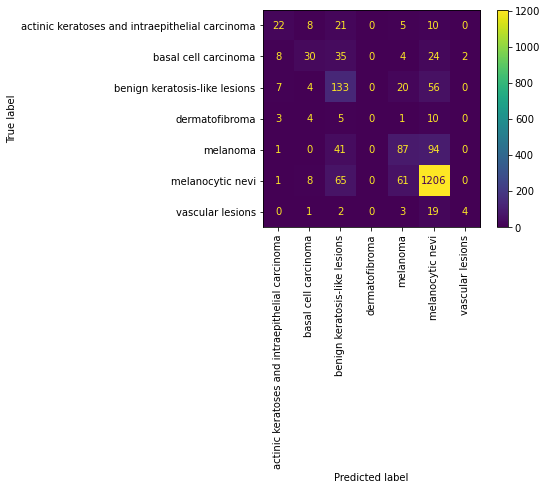

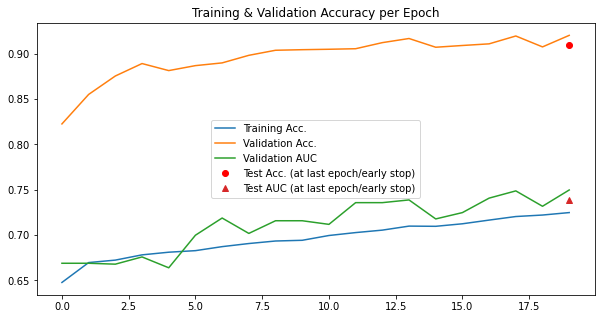

In [110]:
# Runs the classifier again 

clf = run_classifier_pipeline(name_dataset, info_flags, jointVAE_loader)

#### Generating an upgraded dataset with Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [111]:
# Creates the augmented dataloader
jointVAE_loader = generate_augmented_dataset_jointVAE(
    n_channels, latent_dims, categorical_dims, model_path, 
    base_dataset[0], 64, test_loader, val_loader, 
    n_generated_images, weighted_sampling=True
)

2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "DermaMNIST",
  "description": "The DermaMNIST is based on the HAM10000, a large collection of multi-source dermatoscopic images of common pigmented skin lesions. The dataset consists of 10,015 dermatoscopic images categorized as 7 different diseases, formulized as a multi-class classification task. We split the images into training, validation and test set with a ratio of 7:1:2. The source images of 3\u00d7600\u00d7450 are resized into 3\u00d728\u00d728.",
  "url": "https://zenodo.org/record/5208230/files/dermamnist.npz?download=1",
  "MD5": "0744692d530f8e62ec473284d019b0c7",
  "task": "multi-class",
  "label": {
    "0": "actinic keratoses and intraepithelial carcinoma",
    "1": "basal cell carcinoma",
    "2": "benign keratosis-like lesions",
    "3": "dermatofibroma",
    "4": "melanoma",
    "5": "melanocytic nevi",
    "6": "vascular lesions"
  },
  "n_channels": 3,
  "n_samples": {
    "train": 7007,
    "val": 1003,
    "test": 2005
  },
  "license": "CC B

100%|█████████████████████████████████████████| 219/219 [00:24<00:00,  9.02it/s]


train -- accuracy: 0.23
val -- accuracy: 0.83,  AUC: 0.47
Epoch 1



100%|█████████████████████████████████████████| 219/219 [00:23<00:00,  9.19it/s]


train -- accuracy: 0.3
val -- accuracy: 0.85,  AUC: 0.48
Epoch 2



100%|█████████████████████████████████████████| 219/219 [00:23<00:00,  9.34it/s]


train -- accuracy: 0.33
val -- accuracy: 0.86,  AUC: 0.54
Epoch 3



100%|█████████████████████████████████████████| 219/219 [00:22<00:00,  9.64it/s]


train -- accuracy: 0.36
val -- accuracy: 0.87,  AUC: 0.53
Epoch 4



100%|█████████████████████████████████████████| 219/219 [00:23<00:00,  9.34it/s]


train -- accuracy: 0.38
val -- accuracy: 0.87,  AUC: 0.56
Epoch 5



100%|█████████████████████████████████████████| 219/219 [00:22<00:00,  9.56it/s]


train -- accuracy: 0.42
val -- accuracy: 0.86,  AUC: 0.58
Epoch 6



100%|█████████████████████████████████████████| 219/219 [00:22<00:00,  9.61it/s]


train -- accuracy: 0.43
val -- accuracy: 0.88,  AUC: 0.59
Epoch 7



100%|█████████████████████████████████████████| 219/219 [00:22<00:00,  9.81it/s]


train -- accuracy: 0.44
val -- accuracy: 0.86,  AUC: 0.6
Epoch 8



100%|█████████████████████████████████████████| 219/219 [00:22<00:00,  9.93it/s]


train -- accuracy: 0.46
val -- accuracy: 0.86,  AUC: 0.58
Epoch 9



100%|█████████████████████████████████████████| 219/219 [00:22<00:00,  9.61it/s]


train -- accuracy: 0.46
val -- accuracy: 0.85,  AUC: 0.61
Epoch 10



100%|█████████████████████████████████████████| 219/219 [00:22<00:00,  9.83it/s]


train -- accuracy: 0.47
val -- accuracy: 0.88,  AUC: 0.63
Epoch 11



100%|█████████████████████████████████████████| 219/219 [00:22<00:00,  9.84it/s]


train -- accuracy: 0.49
val -- accuracy: 0.87,  AUC: 0.62
Epoch 12



100%|█████████████████████████████████████████| 219/219 [00:22<00:00,  9.87it/s]


train -- accuracy: 0.5
val -- accuracy: 0.87,  AUC: 0.66
Epoch 13



100%|█████████████████████████████████████████| 219/219 [00:21<00:00, 10.00it/s]


train -- accuracy: 0.51
val -- accuracy: 0.83,  AUC: 0.57
Epoch 14



100%|█████████████████████████████████████████| 219/219 [00:22<00:00,  9.67it/s]


train -- accuracy: 0.52
val -- accuracy: 0.88,  AUC: 0.68
Epoch 15



100%|█████████████████████████████████████████| 219/219 [00:23<00:00,  9.21it/s]


train -- accuracy: 0.52
val -- accuracy: 0.87,  AUC: 0.59
Epoch 16



100%|█████████████████████████████████████████| 219/219 [00:23<00:00,  9.39it/s]


train -- accuracy: 0.52
val -- accuracy: 0.86,  AUC: 0.59
Epoch 17



100%|█████████████████████████████████████████| 219/219 [00:23<00:00,  9.33it/s]


train -- accuracy: 0.54
val -- accuracy: 0.88,  AUC: 0.65
Epoch 18



100%|█████████████████████████████████████████| 219/219 [00:23<00:00,  9.48it/s]


train -- accuracy: 0.54
val -- accuracy: 0.86,  AUC: 0.63
Epoch 19



100%|█████████████████████████████████████████| 219/219 [00:23<00:00,  9.51it/s]


train -- accuracy: 0.53
val -- accuracy: 0.85,  AUC: 0.56
test -- accuracy: 0.87,  AUC: 0.56


<Figure size 720x720 with 0 Axes>

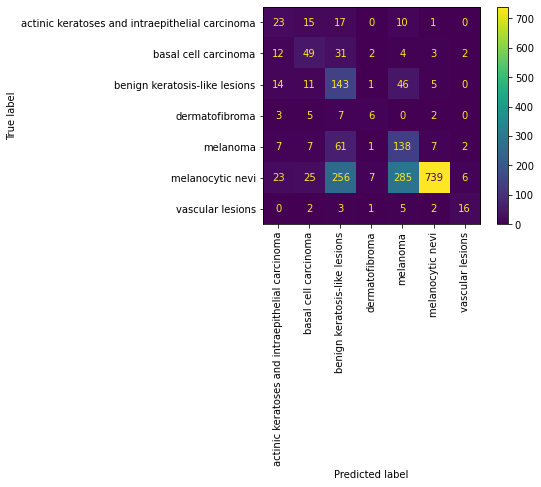

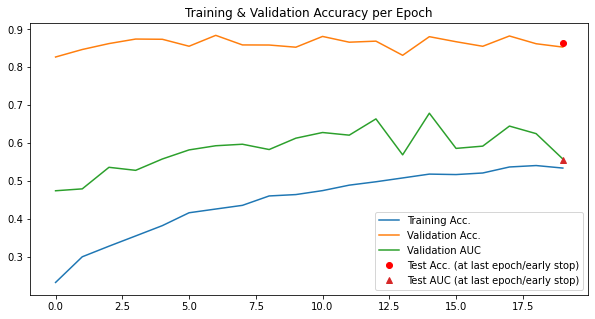

In [112]:
# Runs the classifier again 
clf = run_classifier_pipeline(name_dataset, info_flags, jointVAE_loader)

### OctMNIST

#### Training the Joint VAE

In [113]:
# Declares the dataset name and retrieves the base dataset
name_dataset = "octmnist"
base_dataset = octmnist_noWRS_noGDA

# Retrieves the dataset parameters
n_channels = info_flags[name_dataset][0]["n_channels"]

# Retrieves the data loader
train_loader = base_dataset[3]
val_loader = base_dataset[5]
test_loader = base_dataset[4]

Testing Joint Variational Autoencoder:
Clearing CUDA Pytorch Cache
Model Output size: torch.Size([10, 1, 28, 28])
Forward pass test:  True
{'loss': tensor(266859.5312, grad_fn=<AddBackward0>), 'Reconstruction_Loss': tensor(8895.2529, grad_fn=<MseLossBackward0>), 'Capacity_Loss': tensor(387.2392, grad_fn=<AddBackward0>)}
Loss test:  True
Cuda device:  cuda
Training phase:
Train epoch 1 -- average loss: 924.9552890321243
Validation set loss: 286.476514
Train epoch 2 -- average loss: 261.8322349438842
Validation set loss: 203.876314
Train epoch 3 -- average loss: 185.73988624600227
Validation set loss: 140.826749
Train epoch 4 -- average loss: 156.73194975842057
Validation set loss: 129.139775
Train epoch 5 -- average loss: 133.90133632084363
Validation set loss: 111.951154
Train epoch 6 -- average loss: 117.5028698376444
Validation set loss: 108.767595
Train epoch 7 -- average loss: 107.32592685526137
Validation set loss: 88.613197
Train epoch 8 -- average loss: 98.11490847179816
Validat

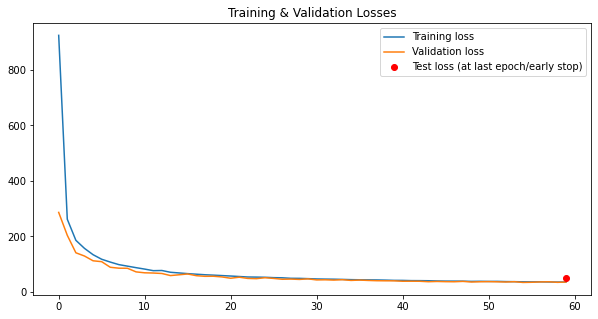

In [114]:
# Runs the Joint VAE
_, _, _, _ = run_encoder_pipeline(
    train_loader, val_loader, test_loader,  n_channels, 
    latent_dims, categorical_dims=categorical_dims,
    epochs=epochs, name_dataset=name_dataset, 
    output_intermediary_info=False, model_type="JointVAE"
)

#### Generating an upgraded dataset without Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [115]:
# Fetches the generated VAE Model model to import
model_path = f"trained_models/JointVAE/{name_dataset}/"
model = [x for x in os.listdir(model_path) if x[-4:]==".pth"][-1]
model_path += model

# Calculates the number of images to generate
percentage = 4
nb_images_in_dataset = len(base_dataset[0])
n_generated_images = int((percentage/100)*nb_images_in_dataset)
print(f"Number of generated images: {n_generated_images}",
      f"({percentage}% of the dataset)")

# Creates the augmented dataloader
jointVAE_loader = generate_augmented_dataset_jointVAE(
    n_channels, latent_dims, categorical_dims, model_path, 
    base_dataset[0], 64, test_loader, val_loader, 
    n_generated_images, weighted_sampling=False
)

Number of generated images: 3899 (4% of the dataset)


2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "OCTMNIST",
  "description": "The OCTMNIST is based on a prior dataset of 109,309 valid optical coherence tomography (OCT) images for retinal diseases. The dataset is comprised of 4 diagnosis categories, leading to a multi-class classification task. We split the source training set with a ratio of 9:1 into training and validation set, and use its source validation set as the test set. The source images are gray-scale, and their sizes are (384\u22121,536)\u00d7(277\u2212512). We center-crop the images and resize them into 1\u00d728\u00d728.",
  "url": "https://zenodo.org/record/5208230/files/octmnist.npz?download=1",
  "MD5": "c68d92d5b585d8d81f7112f81e2d0842",
  "task": "multi-class",
  "label": {
    "0": "choroidal neovascularization",
    "1": "diabetic macular edema",
    "2": "drusen",
    "3": "normal"
  },
  "n_channels": 1,
  "n_samples": {
    "train": 97477,
    "val": 10832,
    "test": 1000
  },
  "license": "CC BY 4.0"
}
--------------------------------

100%|███████████████████████████████████████| 3047/3047 [05:20<00:00,  9.52it/s]


train -- accuracy: 0.63
val -- accuracy: 0.93,  AUC: 0.85
Epoch 1



100%|███████████████████████████████████████| 3047/3047 [05:13<00:00,  9.70it/s]


train -- accuracy: 0.66
val -- accuracy: 0.95,  AUC: 0.88
Epoch 2



100%|███████████████████████████████████████| 3047/3047 [04:50<00:00, 10.50it/s]


train -- accuracy: 0.67
val -- accuracy: 0.96,  AUC: 0.89
Epoch 3



100%|███████████████████████████████████████| 3047/3047 [04:47<00:00, 10.61it/s]


train -- accuracy: 0.68
val -- accuracy: 0.96,  AUC: 0.88
Epoch 4



100%|███████████████████████████████████████| 3047/3047 [04:47<00:00, 10.59it/s]


train -- accuracy: 0.69
val -- accuracy: 0.96,  AUC: 0.89
Epoch 5



100%|███████████████████████████████████████| 3047/3047 [04:58<00:00, 10.22it/s]


train -- accuracy: 0.69
val -- accuracy: 0.97,  AUC: 0.9
Epoch 6



100%|███████████████████████████████████████| 3047/3047 [04:48<00:00, 10.55it/s]


train -- accuracy: 0.69
val -- accuracy: 0.97,  AUC: 0.9
Epoch 7



100%|███████████████████████████████████████| 3047/3047 [04:52<00:00, 10.43it/s]


train -- accuracy: 0.7
val -- accuracy: 0.97,  AUC: 0.91
Epoch 8



100%|███████████████████████████████████████| 3047/3047 [04:48<00:00, 10.57it/s]


train -- accuracy: 0.7
val -- accuracy: 0.97,  AUC: 0.91
Epoch 9



100%|███████████████████████████████████████| 3047/3047 [04:45<00:00, 10.66it/s]


train -- accuracy: 0.7
val -- accuracy: 0.97,  AUC: 0.9
Epoch 10



100%|███████████████████████████████████████| 3047/3047 [04:43<00:00, 10.73it/s]


train -- accuracy: 0.7
val -- accuracy: 0.97,  AUC: 0.91
Epoch 11



100%|███████████████████████████████████████| 3047/3047 [04:39<00:00, 10.88it/s]


train -- accuracy: 0.71
val -- accuracy: 0.97,  AUC: 0.9
Epoch 12



100%|███████████████████████████████████████| 3047/3047 [04:41<00:00, 10.81it/s]


train -- accuracy: 0.71
val -- accuracy: 0.97,  AUC: 0.91
Epoch 13



100%|███████████████████████████████████████| 3047/3047 [05:00<00:00, 10.15it/s]


train -- accuracy: 0.71
val -- accuracy: 0.97,  AUC: 0.9
Epoch 14



100%|███████████████████████████████████████| 3047/3047 [04:48<00:00, 10.56it/s]


train -- accuracy: 0.71
val -- accuracy: 0.97,  AUC: 0.91
Epoch 15



100%|███████████████████████████████████████| 3047/3047 [04:55<00:00, 10.32it/s]


train -- accuracy: 0.71
val -- accuracy: 0.97,  AUC: 0.91
Epoch 16



100%|███████████████████████████████████████| 3047/3047 [04:47<00:00, 10.60it/s]


train -- accuracy: 0.71
val -- accuracy: 0.97,  AUC: 0.92
Epoch 17



100%|███████████████████████████████████████| 3047/3047 [04:44<00:00, 10.73it/s]


train -- accuracy: 0.72
val -- accuracy: 0.97,  AUC: 0.91
Epoch 18



100%|███████████████████████████████████████| 3047/3047 [04:44<00:00, 10.70it/s]


train -- accuracy: 0.72
val -- accuracy: 0.97,  AUC: 0.92
Epoch 19



100%|███████████████████████████████████████| 3047/3047 [04:43<00:00, 10.74it/s]


train -- accuracy: 0.72
val -- accuracy: 0.98,  AUC: 0.91
test -- accuracy: 0.94,  AUC: 0.74


<Figure size 720x720 with 0 Axes>

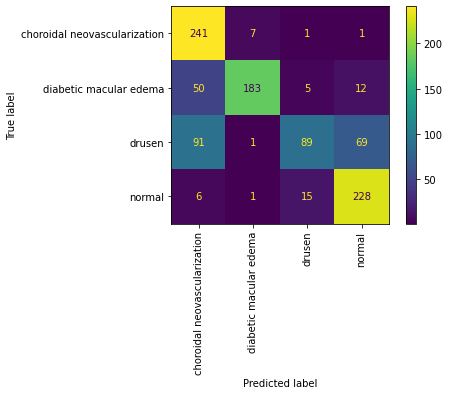

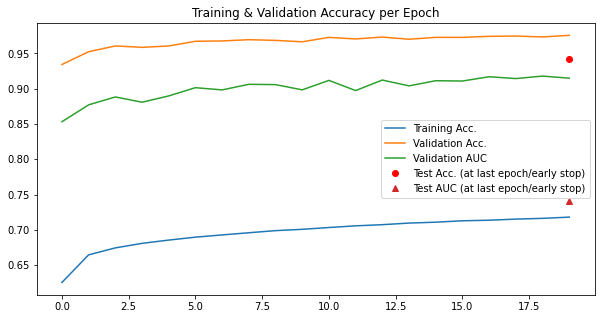

In [116]:
# Runs the classifier again 

clf = run_classifier_pipeline(name_dataset, info_flags, jointVAE_loader)

#### Generating an upgraded dataset with Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [117]:
# Creates the augmented dataloader
jointVAE_loader = generate_augmented_dataset_jointVAE(
    n_channels, latent_dims, categorical_dims, model_path, 
    base_dataset[0], 64, test_loader, val_loader, 
    n_generated_images, weighted_sampling=True
)

2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "OCTMNIST",
  "description": "The OCTMNIST is based on a prior dataset of 109,309 valid optical coherence tomography (OCT) images for retinal diseases. The dataset is comprised of 4 diagnosis categories, leading to a multi-class classification task. We split the source training set with a ratio of 9:1 into training and validation set, and use its source validation set as the test set. The source images are gray-scale, and their sizes are (384\u22121,536)\u00d7(277\u2212512). We center-crop the images and resize them into 1\u00d728\u00d728.",
  "url": "https://zenodo.org/record/5208230/files/octmnist.npz?download=1",
  "MD5": "c68d92d5b585d8d81f7112f81e2d0842",
  "task": "multi-class",
  "label": {
    "0": "choroidal neovascularization",
    "1": "diabetic macular edema",
    "2": "drusen",
    "3": "normal"
  },
  "n_channels": 1,
  "n_samples": {
    "train": 97477,
    "val": 10832,
    "test": 1000
  },
  "license": "CC BY 4.0"
}
--------------------------------

100%|███████████████████████████████████████| 3047/3047 [05:13<00:00,  9.73it/s]


train -- accuracy: 0.45
val -- accuracy: 0.91,  AUC: 0.75
Epoch 1



100%|███████████████████████████████████████| 3047/3047 [05:14<00:00,  9.68it/s]


train -- accuracy: 0.52
val -- accuracy: 0.96,  AUC: 0.86
Epoch 2



100%|███████████████████████████████████████| 3047/3047 [05:07<00:00,  9.91it/s]


train -- accuracy: 0.54
val -- accuracy: 0.96,  AUC: 0.78
Epoch 3



100%|███████████████████████████████████████| 3047/3047 [05:07<00:00,  9.89it/s]


train -- accuracy: 0.55
val -- accuracy: 0.97,  AUC: 0.9
Epoch 4



100%|███████████████████████████████████████| 3047/3047 [05:08<00:00,  9.87it/s]


train -- accuracy: 0.57
val -- accuracy: 0.97,  AUC: 0.9
Epoch 5



100%|███████████████████████████████████████| 3047/3047 [05:33<00:00,  9.14it/s]


train -- accuracy: 0.57
val -- accuracy: 0.97,  AUC: 0.88
Epoch 6



100%|███████████████████████████████████████| 3047/3047 [05:11<00:00,  9.77it/s]


train -- accuracy: 0.58
val -- accuracy: 0.97,  AUC: 0.89
Epoch 7



100%|███████████████████████████████████████| 3047/3047 [05:19<00:00,  9.55it/s]


train -- accuracy: 0.59
val -- accuracy: 0.97,  AUC: 0.9
Epoch 8



100%|███████████████████████████████████████| 3047/3047 [05:18<00:00,  9.55it/s]


train -- accuracy: 0.59
val -- accuracy: 0.97,  AUC: 0.9
Epoch 9



100%|███████████████████████████████████████| 3047/3047 [05:23<00:00,  9.42it/s]


train -- accuracy: 0.6
val -- accuracy: 0.96,  AUC: 0.81
Epoch 10



100%|███████████████████████████████████████| 3047/3047 [05:04<00:00, 10.01it/s]


train -- accuracy: 0.6
val -- accuracy: 0.97,  AUC: 0.9
Epoch 11



100%|███████████████████████████████████████| 3047/3047 [04:45<00:00, 10.68it/s]


train -- accuracy: 0.6
val -- accuracy: 0.97,  AUC: 0.9
Epoch 12



100%|███████████████████████████████████████| 3047/3047 [04:45<00:00, 10.65it/s]


train -- accuracy: 0.6
val -- accuracy: 0.97,  AUC: 0.88
Epoch 13



100%|███████████████████████████████████████| 3047/3047 [04:53<00:00, 10.39it/s]


train -- accuracy: 0.61
val -- accuracy: 0.97,  AUC: 0.89
Epoch 14



100%|███████████████████████████████████████| 3047/3047 [04:44<00:00, 10.71it/s]


train -- accuracy: 0.61
val -- accuracy: 0.97,  AUC: 0.9
Epoch 15



100%|███████████████████████████████████████| 3047/3047 [04:42<00:00, 10.80it/s]


train -- accuracy: 0.61
val -- accuracy: 0.97,  AUC: 0.9
Epoch 16



100%|███████████████████████████████████████| 3047/3047 [04:42<00:00, 10.80it/s]


train -- accuracy: 0.61
val -- accuracy: 0.97,  AUC: 0.9
Epoch 17



100%|███████████████████████████████████████| 3047/3047 [04:58<00:00, 10.20it/s]


train -- accuracy: 0.61
val -- accuracy: 0.97,  AUC: 0.9
Epoch 18



100%|███████████████████████████████████████| 3047/3047 [05:34<00:00,  9.12it/s]


train -- accuracy: 0.61
val -- accuracy: 0.97,  AUC: 0.9
Epoch 19



100%|███████████████████████████████████████| 3047/3047 [05:28<00:00,  9.29it/s]


train -- accuracy: 0.61
val -- accuracy: 0.97,  AUC: 0.9
test -- accuracy: 0.93,  AUC: 0.72


<Figure size 720x720 with 0 Axes>

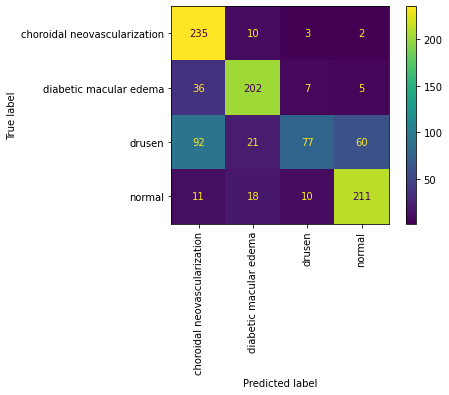

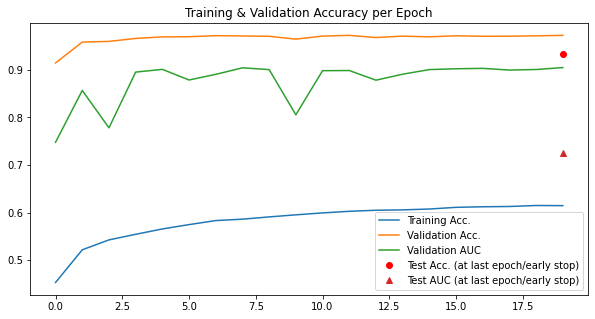

In [118]:
# Runs the classifier again 
clf = run_classifier_pipeline(name_dataset, info_flags, jointVAE_loader)

### PneumoniaMNIST

#### Training the Joint VAE

In [119]:
# Declares the dataset name and retrieves the base dataset
name_dataset = "pneumoniamnist"
base_dataset = pneumoniamnist_noWRS_noGDA

# Retrieves the dataset parameters
n_channels = info_flags[name_dataset][0]["n_channels"]

# Retrieves the data loader
train_loader = base_dataset[3]
val_loader = base_dataset[5]
test_loader = base_dataset[4]

Testing Joint Variational Autoencoder:
Clearing CUDA Pytorch Cache
Model Output size: torch.Size([10, 1, 28, 28])
Forward pass test:  True
{'loss': tensor(260980.3125, grad_fn=<AddBackward0>), 'Reconstruction_Loss': tensor(8699.2852, grad_fn=<MseLossBackward0>), 'Capacity_Loss': tensor(350.0140, grad_fn=<AddBackward0>)}
Loss test:  True
Cuda device:  cuda
Training phase:
Train epoch 1 -- average loss: 1777.785488131903
Validation set loss: 1159.508293
Train epoch 2 -- average loss: 792.251768100839
Validation set loss: 657.33626
Train epoch 3 -- average loss: 549.3675210413127
Validation set loss: 460.016104
Train epoch 4 -- average loss: 429.78854393452633
Validation set loss: 389.624261
Train epoch 5 -- average loss: 362.5733803333422
Validation set loss: 332.726986
Train epoch 6 -- average loss: 326.32133345170456
Validation set loss: 290.79636
Train epoch 7 -- average loss: 273.51094173149426
Validation set loss: 290.658557
Train epoch 8 -- average loss: 264.16536638102696
Validati

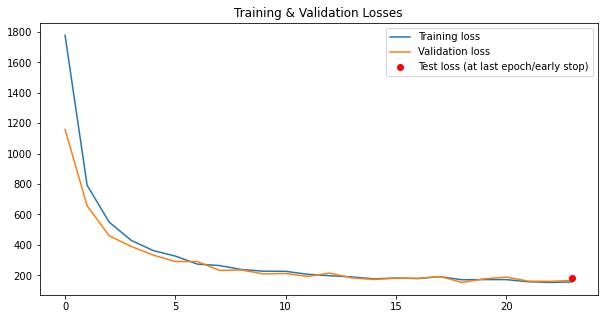

In [120]:
# Runs the Joint VAE
_, _, _, _ = run_encoder_pipeline(
    train_loader, val_loader, test_loader,  n_channels, 
    latent_dims, categorical_dims=categorical_dims,
    epochs=epochs, name_dataset=name_dataset, 
    output_intermediary_info=False, model_type="JointVAE"
)

#### Generating an upgraded dataset without Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [121]:
# Fetches the generated VAE Model model to import
model_path = f"trained_models/JointVAE/{name_dataset}/"
model = [x for x in os.listdir(model_path) if x[-4:]==".pth"][-1]
model_path += model

# Calculates the number of images to generate
percentage = 10
nb_images_in_dataset = len(base_dataset[0])
n_generated_images = int((percentage/100)*nb_images_in_dataset)
print(f"Number of generated images: {n_generated_images}",
      f"({percentage}% of the dataset)")

# Creates the augmented dataloader
jointVAE_loader = generate_augmented_dataset_jointVAE(
    n_channels, latent_dims, categorical_dims, model_path, 
    base_dataset[0], 64, test_loader, val_loader, 
    n_generated_images, weighted_sampling=False
)

Number of generated images: 470 (10% of the dataset)


2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "PneumoniaMNIST",
  "description": "The PneumoniaMNIST is based on a prior dataset of 5,856 pediatric chest X-Ray images. The task is binary-class classification of pneumonia against normal. We split the source training set with a ratio of 9:1 into training and validation set and use its source validation set as the test set. The source images are gray-scale, and their sizes are (384\u22122,916)\u00d7(127\u22122,713). We center-crop the images and resize them into 1\u00d728\u00d728.",
  "url": "https://zenodo.org/record/5208230/files/pneumoniamnist.npz?download=1",
  "MD5": "28209eda62fecd6e6a2d98b1501bb15f",
  "task": "binary-class",
  "label": {
    "0": "normal",
    "1": "pneumonia"
  },
  "n_channels": 1,
  "n_samples": {
    "train": 4708,
    "val": 524,
    "test": 624
  },
  "license": "CC BY 4.0"
}
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           

100%|█████████████████████████████████████████| 148/148 [00:16<00:00,  8.76it/s]


train -- accuracy: 0.79
val -- accuracy: 0.98,  AUC: 0.94
Epoch 1



100%|█████████████████████████████████████████| 148/148 [00:16<00:00,  8.77it/s]


train -- accuracy: 0.84
val -- accuracy: 0.99,  AUC: 0.95
Epoch 2



100%|█████████████████████████████████████████| 148/148 [00:16<00:00,  8.94it/s]


train -- accuracy: 0.84
val -- accuracy: 0.99,  AUC: 0.96
Epoch 3



100%|█████████████████████████████████████████| 148/148 [00:16<00:00,  9.00it/s]


train -- accuracy: 0.84
val -- accuracy: 0.99,  AUC: 0.95
Epoch 4



100%|█████████████████████████████████████████| 148/148 [00:16<00:00,  8.96it/s]


train -- accuracy: 0.85
val -- accuracy: 0.99,  AUC: 0.95
Epoch 5



100%|█████████████████████████████████████████| 148/148 [00:16<00:00,  8.83it/s]


train -- accuracy: 0.85
val -- accuracy: 0.99,  AUC: 0.97
Epoch 6



100%|█████████████████████████████████████████| 148/148 [00:16<00:00,  8.91it/s]


train -- accuracy: 0.85
val -- accuracy: 0.99,  AUC: 0.94
Epoch 7



100%|█████████████████████████████████████████| 148/148 [00:16<00:00,  8.89it/s]


train -- accuracy: 0.85
val -- accuracy: 0.99,  AUC: 0.97
Epoch 8



100%|█████████████████████████████████████████| 148/148 [00:16<00:00,  8.88it/s]


train -- accuracy: 0.86
val -- accuracy: 1.0,  AUC: 0.96
Epoch 9



100%|█████████████████████████████████████████| 148/148 [00:16<00:00,  8.98it/s]


train -- accuracy: 0.86
val -- accuracy: 0.99,  AUC: 0.97
Epoch 10



100%|█████████████████████████████████████████| 148/148 [00:16<00:00,  8.98it/s]


train -- accuracy: 0.86
val -- accuracy: 1.0,  AUC: 0.98
Epoch 11



100%|█████████████████████████████████████████| 148/148 [00:16<00:00,  9.00it/s]


train -- accuracy: 0.86
val -- accuracy: 0.99,  AUC: 0.96
Epoch 12



100%|█████████████████████████████████████████| 148/148 [00:16<00:00,  8.99it/s]


train -- accuracy: 0.86
val -- accuracy: 1.0,  AUC: 0.96
Epoch 13



100%|█████████████████████████████████████████| 148/148 [00:16<00:00,  8.99it/s]


train -- accuracy: 0.87
val -- accuracy: 1.0,  AUC: 0.98
Epoch 14



100%|█████████████████████████████████████████| 148/148 [00:16<00:00,  8.92it/s]


train -- accuracy: 0.87
val -- accuracy: 1.0,  AUC: 0.96
Epoch 15



100%|█████████████████████████████████████████| 148/148 [00:16<00:00,  8.90it/s]


train -- accuracy: 0.87
val -- accuracy: 1.0,  AUC: 0.98
Epoch 16



100%|█████████████████████████████████████████| 148/148 [00:16<00:00,  8.97it/s]


train -- accuracy: 0.87
val -- accuracy: 1.0,  AUC: 0.97
Epoch 17



100%|█████████████████████████████████████████| 148/148 [00:16<00:00,  8.97it/s]


train -- accuracy: 0.87
val -- accuracy: 1.0,  AUC: 0.97
Epoch 18



100%|█████████████████████████████████████████| 148/148 [00:16<00:00,  8.81it/s]


train -- accuracy: 0.87
val -- accuracy: 1.0,  AUC: 0.98
Epoch 19



100%|█████████████████████████████████████████| 148/148 [00:16<00:00,  8.90it/s]


train -- accuracy: 0.87
val -- accuracy: 1.0,  AUC: 0.97
test -- accuracy: 0.93,  AUC: 0.88


<Figure size 720x720 with 0 Axes>

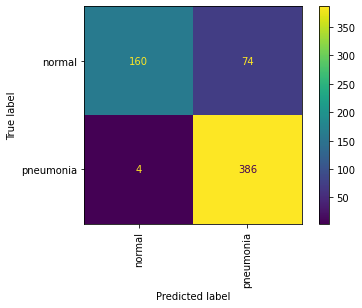

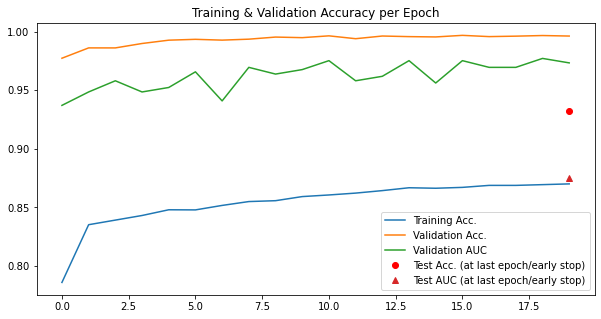

In [122]:
# Runs the classifier again 

clf = run_classifier_pipeline(name_dataset, info_flags, jointVAE_loader)

#### Generating an upgraded dataset with Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [123]:
# Creates the augmented dataloader
jointVAE_loader = generate_augmented_dataset_jointVAE(
    n_channels, latent_dims, categorical_dims, model_path, 
    base_dataset[0], 64, test_loader, val_loader, 
    n_generated_images, weighted_sampling=True
)

2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "PneumoniaMNIST",
  "description": "The PneumoniaMNIST is based on a prior dataset of 5,856 pediatric chest X-Ray images. The task is binary-class classification of pneumonia against normal. We split the source training set with a ratio of 9:1 into training and validation set and use its source validation set as the test set. The source images are gray-scale, and their sizes are (384\u22122,916)\u00d7(127\u22122,713). We center-crop the images and resize them into 1\u00d728\u00d728.",
  "url": "https://zenodo.org/record/5208230/files/pneumoniamnist.npz?download=1",
  "MD5": "28209eda62fecd6e6a2d98b1501bb15f",
  "task": "binary-class",
  "label": {
    "0": "normal",
    "1": "pneumonia"
  },
  "n_channels": 1,
  "n_samples": {
    "train": 4708,
    "val": 524,
    "test": 624
  },
  "license": "CC BY 4.0"
}
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           

100%|█████████████████████████████████████████| 148/148 [00:16<00:00,  9.09it/s]


train -- accuracy: 0.67
val -- accuracy: 0.98,  AUC: 0.88
Epoch 1



100%|█████████████████████████████████████████| 148/148 [00:16<00:00,  8.87it/s]


train -- accuracy: 0.72
val -- accuracy: 0.98,  AUC: 0.93
Epoch 2



100%|█████████████████████████████████████████| 148/148 [00:16<00:00,  9.06it/s]


train -- accuracy: 0.72
val -- accuracy: 0.99,  AUC: 0.9
Epoch 3



100%|█████████████████████████████████████████| 148/148 [00:16<00:00,  9.12it/s]


train -- accuracy: 0.73
val -- accuracy: 0.99,  AUC: 0.94
Epoch 4



100%|█████████████████████████████████████████| 148/148 [00:16<00:00,  9.03it/s]


train -- accuracy: 0.73
val -- accuracy: 0.99,  AUC: 0.96
Epoch 5



100%|█████████████████████████████████████████| 148/148 [00:16<00:00,  8.96it/s]


train -- accuracy: 0.72
val -- accuracy: 0.99,  AUC: 0.96
Epoch 6



100%|█████████████████████████████████████████| 148/148 [00:16<00:00,  9.17it/s]


train -- accuracy: 0.75
val -- accuracy: 0.99,  AUC: 0.96
Epoch 7



100%|█████████████████████████████████████████| 148/148 [00:16<00:00,  9.04it/s]


train -- accuracy: 0.74
val -- accuracy: 0.99,  AUC: 0.95
Epoch 8



100%|█████████████████████████████████████████| 148/148 [00:16<00:00,  9.13it/s]


train -- accuracy: 0.74
val -- accuracy: 1.0,  AUC: 0.97
Epoch 9



100%|█████████████████████████████████████████| 148/148 [00:16<00:00,  9.05it/s]


train -- accuracy: 0.75
val -- accuracy: 1.0,  AUC: 0.97
Epoch 10



100%|█████████████████████████████████████████| 148/148 [00:16<00:00,  9.17it/s]


train -- accuracy: 0.75
val -- accuracy: 1.0,  AUC: 0.97
Epoch 11



100%|█████████████████████████████████████████| 148/148 [00:16<00:00,  9.06it/s]


train -- accuracy: 0.75
val -- accuracy: 1.0,  AUC: 0.97
Epoch 12



100%|█████████████████████████████████████████| 148/148 [00:16<00:00,  9.15it/s]


train -- accuracy: 0.74
val -- accuracy: 1.0,  AUC: 0.98
Epoch 13



100%|█████████████████████████████████████████| 148/148 [00:14<00:00, 10.55it/s]


train -- accuracy: 0.76
val -- accuracy: 1.0,  AUC: 0.98
Epoch 14



100%|█████████████████████████████████████████| 148/148 [00:16<00:00,  9.08it/s]


train -- accuracy: 0.75
val -- accuracy: 1.0,  AUC: 0.98
Epoch 15



100%|█████████████████████████████████████████| 148/148 [00:16<00:00,  9.18it/s]


train -- accuracy: 0.75
val -- accuracy: 1.0,  AUC: 0.98
Epoch 16



100%|█████████████████████████████████████████| 148/148 [00:16<00:00,  9.20it/s]


train -- accuracy: 0.75
val -- accuracy: 1.0,  AUC: 0.98
Epoch 17



100%|█████████████████████████████████████████| 148/148 [00:16<00:00,  9.17it/s]


train -- accuracy: 0.75
val -- accuracy: 1.0,  AUC: 0.98
Epoch 18



100%|█████████████████████████████████████████| 148/148 [00:16<00:00,  9.20it/s]


train -- accuracy: 0.75
val -- accuracy: 1.0,  AUC: 0.97
Epoch 19



100%|█████████████████████████████████████████| 148/148 [00:16<00:00,  9.12it/s]


train -- accuracy: 0.75
val -- accuracy: 1.0,  AUC: 0.97
test -- accuracy: 0.93,  AUC: 0.87


<Figure size 720x720 with 0 Axes>

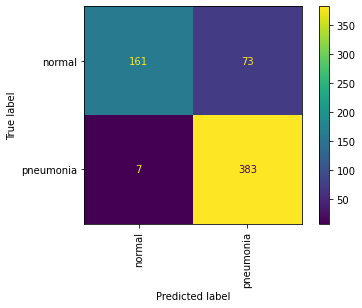

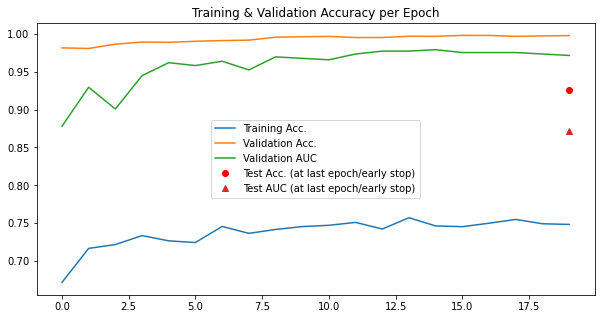

In [124]:
# Runs the classifier again 
clf = run_classifier_pipeline(name_dataset, info_flags, jointVAE_loader)

### BreastMNIST

#### Training the Joint VAE

In [125]:
# Declares the dataset name and retrieves the base dataset
name_dataset = "breastmnist"
base_dataset = breastmnist_noWRS_noGDA

# Retrieves the dataset parameters
n_channels = info_flags[name_dataset][0]["n_channels"]

# Retrieves the data loader
train_loader = base_dataset[3]
val_loader = base_dataset[5]
test_loader = base_dataset[4]

Testing Joint Variational Autoencoder:
Clearing CUDA Pytorch Cache
Model Output size: torch.Size([10, 1, 28, 28])
Forward pass test:  True
{'loss': tensor(267428.7812, grad_fn=<AddBackward0>), 'Reconstruction_Loss': tensor(8914.2324, grad_fn=<MseLossBackward0>), 'Capacity_Loss': tensor(362.1326, grad_fn=<AddBackward0>)}
Loss test:  True
Cuda device:  cuda
Training phase:
Train epoch 1 -- average loss: 6958.780448717948
Validation set loss: 4905.329728
Train epoch 2 -- average loss: 2655.4187843406594
Validation set loss: 3862.816106
Train epoch 3 -- average loss: 2162.553270947802
Validation set loss: 3465.519631
Train epoch 4 -- average loss: 1842.5023323031135
Validation set loss: 3106.23097
Train epoch 5 -- average loss: 1659.7577266483515
Validation set loss: 2244.473958
Train epoch 6 -- average loss: 1470.446564503205
Validation set loss: 1691.376202
Train epoch 7 -- average loss: 1413.5653545673076
Validation set loss: 1588.89403
Train epoch 8 -- average loss: 1225.304186698718
V

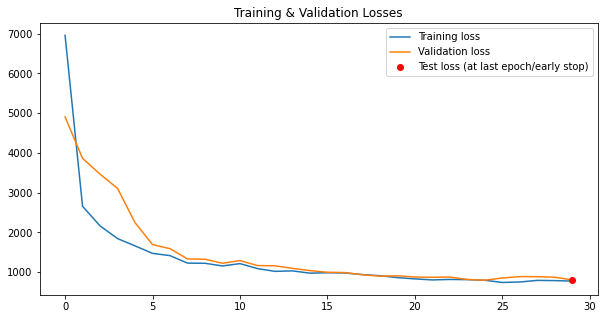

In [126]:
# Runs the Joint VAE
_, _, _, _ = run_encoder_pipeline(
    train_loader, val_loader, test_loader,  n_channels, 
    latent_dims, categorical_dims=categorical_dims,
    epochs=epochs, name_dataset=name_dataset, 
    output_intermediary_info=False, model_type="JointVAE"
)

#### Generating an upgraded dataset without Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [127]:
# Fetches the generated VAE Model model to import
model_path = f"trained_models/JointVAE/{name_dataset}/"
model = [x for x in os.listdir(model_path) if x[-4:]==".pth"][-1]
model_path += model

# Calculates the number of images to generate
percentage = 10
nb_images_in_dataset = len(base_dataset[0])
n_generated_images = int((percentage/100)*nb_images_in_dataset)
print(f"Number of generated images: {n_generated_images}",
      f"({percentage}% of the dataset)")

# Creates the augmented dataloader
jointVAE_loader = generate_augmented_dataset_jointVAE(
    n_channels, latent_dims, categorical_dims, model_path, 
    base_dataset[0], 64, test_loader, val_loader, 
    n_generated_images, weighted_sampling=False
)

Number of generated images: 54 (10% of the dataset)


2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "BreastMNIST",
  "description": "The BreastMNIST is based on a dataset of 780 breast ultrasound images. It is categorized into 3 classes: normal, benign, and malignant. As we use low-resolution images, we simplify the task into binary classification by combining normal and benign as positive and classifying them against malignant as negative. We split the source dataset with a ratio of 7:1:2 into training, validation and test set. The source images of 1\u00d7500\u00d7500 are resized into 1\u00d728\u00d728.",
  "url": "https://zenodo.org/record/5208230/files/breastmnist.npz?download=1",
  "MD5": "750601b1f35ba3300ea97c75c52ff8f6",
  "task": "binary-class",
  "label": {
    "0": "malignant",
    "1": "normal, benign"
  },
  "n_channels": 1,
  "n_samples": {
    "train": 546,
    "val": 78,
    "test": 156
  },
  "license": "CC BY 4.0"
}
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
    

100%|███████████████████████████████████████████| 18/18 [00:01<00:00,  9.49it/s]


train -- accuracy: 0.6
val -- accuracy: 0.49,  AUC: 0.73
Epoch 1



100%|███████████████████████████████████████████| 18/18 [00:01<00:00,  9.44it/s]


train -- accuracy: 0.73
val -- accuracy: 0.68,  AUC: 0.73
Epoch 2



100%|███████████████████████████████████████████| 18/18 [00:01<00:00,  9.55it/s]


train -- accuracy: 0.73
val -- accuracy: 0.74,  AUC: 0.73
Epoch 3



100%|███████████████████████████████████████████| 18/18 [00:01<00:00,  9.48it/s]


train -- accuracy: 0.73
val -- accuracy: 0.78,  AUC: 0.73
Epoch 4



100%|███████████████████████████████████████████| 18/18 [00:01<00:00,  9.42it/s]


train -- accuracy: 0.73
val -- accuracy: 0.79,  AUC: 0.73
Epoch 5



100%|███████████████████████████████████████████| 18/18 [00:01<00:00,  9.56it/s]


train -- accuracy: 0.73
val -- accuracy: 0.81,  AUC: 0.73
Epoch 6



100%|███████████████████████████████████████████| 18/18 [00:01<00:00,  9.56it/s]


train -- accuracy: 0.73
val -- accuracy: 0.8,  AUC: 0.73
Epoch 7



100%|███████████████████████████████████████████| 18/18 [00:01<00:00,  9.56it/s]


train -- accuracy: 0.73
val -- accuracy: 0.81,  AUC: 0.73
Epoch 8



100%|███████████████████████████████████████████| 18/18 [00:01<00:00,  9.35it/s]


train -- accuracy: 0.74
val -- accuracy: 0.81,  AUC: 0.73
Epoch 9



100%|███████████████████████████████████████████| 18/18 [00:01<00:00,  9.45it/s]


train -- accuracy: 0.74
val -- accuracy: 0.82,  AUC: 0.73
Epoch 10



100%|███████████████████████████████████████████| 18/18 [00:01<00:00,  9.43it/s]


train -- accuracy: 0.75
val -- accuracy: 0.81,  AUC: 0.78
Epoch 11



100%|███████████████████████████████████████████| 18/18 [00:01<00:00,  9.51it/s]


train -- accuracy: 0.75
val -- accuracy: 0.84,  AUC: 0.79
Epoch 12



100%|███████████████████████████████████████████| 18/18 [00:01<00:00,  9.48it/s]


train -- accuracy: 0.75
val -- accuracy: 0.83,  AUC: 0.82
Epoch 13



100%|███████████████████████████████████████████| 18/18 [00:01<00:00,  9.32it/s]


train -- accuracy: 0.77
val -- accuracy: 0.84,  AUC: 0.82
Epoch 14



100%|███████████████████████████████████████████| 18/18 [00:01<00:00,  9.45it/s]


train -- accuracy: 0.78
val -- accuracy: 0.85,  AUC: 0.85
Epoch 15



100%|███████████████████████████████████████████| 18/18 [00:01<00:00,  9.42it/s]


train -- accuracy: 0.78
val -- accuracy: 0.86,  AUC: 0.87
Epoch 16



100%|███████████████████████████████████████████| 18/18 [00:01<00:00,  9.65it/s]


train -- accuracy: 0.79
val -- accuracy: 0.87,  AUC: 0.86
Epoch 17



100%|███████████████████████████████████████████| 18/18 [00:01<00:00,  9.58it/s]


train -- accuracy: 0.79
val -- accuracy: 0.88,  AUC: 0.86
Epoch 18



100%|███████████████████████████████████████████| 18/18 [00:01<00:00,  9.47it/s]


train -- accuracy: 0.79
val -- accuracy: 0.87,  AUC: 0.85
Epoch 19



100%|███████████████████████████████████████████| 18/18 [00:01<00:00,  9.65it/s]


train -- accuracy: 0.79
val -- accuracy: 0.87,  AUC: 0.85
test -- accuracy: 0.82,  AUC: 0.8


<Figure size 720x720 with 0 Axes>

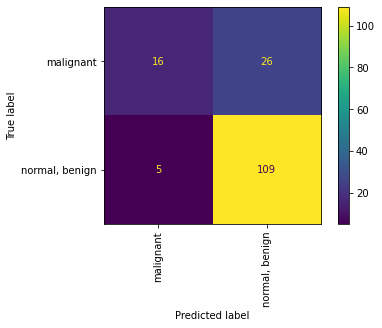

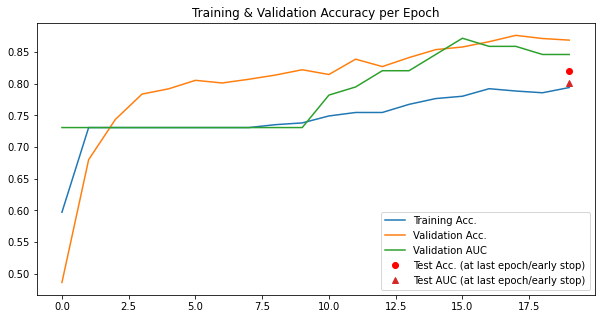

In [128]:
# Runs the classifier again 

clf = run_classifier_pipeline(name_dataset, info_flags, jointVAE_loader)

#### Generating an upgraded dataset with Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [129]:
# Creates the augmented dataloader
jointVAE_loader = generate_augmented_dataset_jointVAE(
    n_channels, latent_dims, categorical_dims, model_path, 
    base_dataset[0], 64, test_loader, val_loader, 
    n_generated_images, weighted_sampling=True
)

2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "BreastMNIST",
  "description": "The BreastMNIST is based on a dataset of 780 breast ultrasound images. It is categorized into 3 classes: normal, benign, and malignant. As we use low-resolution images, we simplify the task into binary classification by combining normal and benign as positive and classifying them against malignant as negative. We split the source dataset with a ratio of 7:1:2 into training, validation and test set. The source images of 1\u00d7500\u00d7500 are resized into 1\u00d728\u00d728.",
  "url": "https://zenodo.org/record/5208230/files/breastmnist.npz?download=1",
  "MD5": "750601b1f35ba3300ea97c75c52ff8f6",
  "task": "binary-class",
  "label": {
    "0": "malignant",
    "1": "normal, benign"
  },
  "n_channels": 1,
  "n_samples": {
    "train": 546,
    "val": 78,
    "test": 156
  },
  "license": "CC BY 4.0"
}
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
    

100%|███████████████████████████████████████████| 18/18 [00:02<00:00,  8.88it/s]


train -- accuracy: 0.53
val -- accuracy: 0.55,  AUC: 0.27
Epoch 1



100%|███████████████████████████████████████████| 18/18 [00:01<00:00,  9.64it/s]


train -- accuracy: 0.5
val -- accuracy: 0.69,  AUC: 0.47
Epoch 2



100%|███████████████████████████████████████████| 18/18 [00:01<00:00,  9.78it/s]


train -- accuracy: 0.61
val -- accuracy: 0.77,  AUC: 0.59
Epoch 3



100%|███████████████████████████████████████████| 18/18 [00:01<00:00,  9.94it/s]


train -- accuracy: 0.65
val -- accuracy: 0.81,  AUC: 0.74
Epoch 4



100%|███████████████████████████████████████████| 18/18 [00:01<00:00,  9.51it/s]


train -- accuracy: 0.64
val -- accuracy: 0.83,  AUC: 0.78
Epoch 5



100%|███████████████████████████████████████████| 18/18 [00:01<00:00,  9.25it/s]


train -- accuracy: 0.61
val -- accuracy: 0.85,  AUC: 0.77
Epoch 6



100%|███████████████████████████████████████████| 18/18 [00:01<00:00,  9.48it/s]


train -- accuracy: 0.65
val -- accuracy: 0.84,  AUC: 0.81
Epoch 7



100%|███████████████████████████████████████████| 18/18 [00:01<00:00,  9.47it/s]


train -- accuracy: 0.64
val -- accuracy: 0.85,  AUC: 0.81
Epoch 8



100%|███████████████████████████████████████████| 18/18 [00:02<00:00,  8.92it/s]


train -- accuracy: 0.65
val -- accuracy: 0.85,  AUC: 0.81
Epoch 9



100%|███████████████████████████████████████████| 18/18 [00:01<00:00,  9.50it/s]


train -- accuracy: 0.67
val -- accuracy: 0.85,  AUC: 0.79
Epoch 10



100%|███████████████████████████████████████████| 18/18 [00:01<00:00,  9.47it/s]


train -- accuracy: 0.66
val -- accuracy: 0.83,  AUC: 0.72
Epoch 11



100%|███████████████████████████████████████████| 18/18 [00:01<00:00,  9.81it/s]


train -- accuracy: 0.65
val -- accuracy: 0.86,  AUC: 0.87
Epoch 12



100%|███████████████████████████████████████████| 18/18 [00:01<00:00,  9.70it/s]


train -- accuracy: 0.65
val -- accuracy: 0.86,  AUC: 0.6
Epoch 13



100%|███████████████████████████████████████████| 18/18 [00:01<00:00,  9.53it/s]


train -- accuracy: 0.67
val -- accuracy: 0.85,  AUC: 0.81
Epoch 14



100%|███████████████████████████████████████████| 18/18 [00:01<00:00,  9.30it/s]


train -- accuracy: 0.68
val -- accuracy: 0.87,  AUC: 0.86
Epoch 15



100%|███████████████████████████████████████████| 18/18 [00:01<00:00, 10.05it/s]


train -- accuracy: 0.69
val -- accuracy: 0.84,  AUC: 0.79
Epoch 16



100%|███████████████████████████████████████████| 18/18 [00:01<00:00,  9.42it/s]


train -- accuracy: 0.69
val -- accuracy: 0.86,  AUC: 0.73
Epoch 17



100%|███████████████████████████████████████████| 18/18 [00:01<00:00,  9.27it/s]


train -- accuracy: 0.72
val -- accuracy: 0.85,  AUC: 0.76
Epoch 18



100%|███████████████████████████████████████████| 18/18 [00:01<00:00,  9.53it/s]


train -- accuracy: 0.71
val -- accuracy: 0.86,  AUC: 0.82
Epoch 19



100%|███████████████████████████████████████████| 18/18 [00:01<00:00,  9.36it/s]


train -- accuracy: 0.7
val -- accuracy: 0.89,  AUC: 0.85
test -- accuracy: 0.87,  AUC: 0.84


<Figure size 720x720 with 0 Axes>

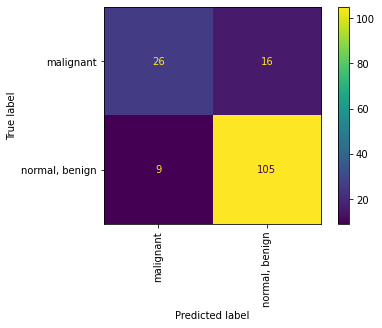

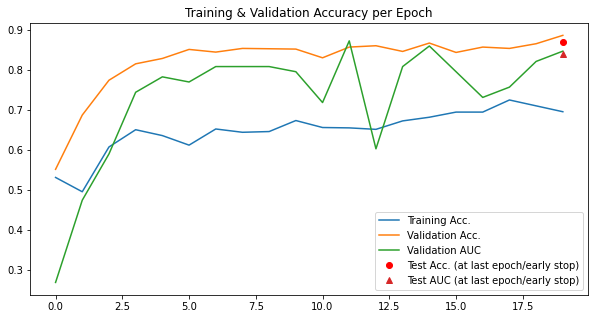

In [130]:
# Runs the classifier again 
clf = run_classifier_pipeline(name_dataset, info_flags, jointVAE_loader)

### OrganaMNIST

#### Training the Joint VAE

In [131]:
# Declares the dataset name and retrieves the base dataset
name_dataset = "organamnist"
base_dataset = organamnist_noWRS_noGDA

# Retrieves the dataset parameters
n_channels = info_flags[name_dataset][0]["n_channels"]

# Retrieves the data loader
train_loader = base_dataset[3]
val_loader = base_dataset[5]
test_loader = base_dataset[4]

Testing Joint Variational Autoencoder:
Clearing CUDA Pytorch Cache
Model Output size: torch.Size([10, 1, 28, 28])
Forward pass test:  True
{'loss': tensor(261026.4375, grad_fn=<AddBackward0>), 'Reconstruction_Loss': tensor(8700.8145, grad_fn=<MseLossBackward0>), 'Capacity_Loss': tensor(400.9841, grad_fn=<AddBackward0>)}
Loss test:  True
Cuda device:  cuda
Training phase:
Train epoch 1 -- average loss: 3315.4985679003644
Validation set loss: 2699.813836
Train epoch 2 -- average loss: 2081.9323917487204
Validation set loss: 2158.529912
Train epoch 3 -- average loss: 1750.4036433482258
Validation set loss: 2008.17109
Train epoch 4 -- average loss: 1585.2010327654637
Validation set loss: 1953.128575
Train epoch 5 -- average loss: 1476.9315810389014
Validation set loss: 1856.352712
Train epoch 6 -- average loss: 1401.6015676961338
Validation set loss: 1807.638196
Train epoch 7 -- average loss: 1342.0831124976505
Validation set loss: 1769.127097
Train epoch 8 -- average loss: 1285.7515907511

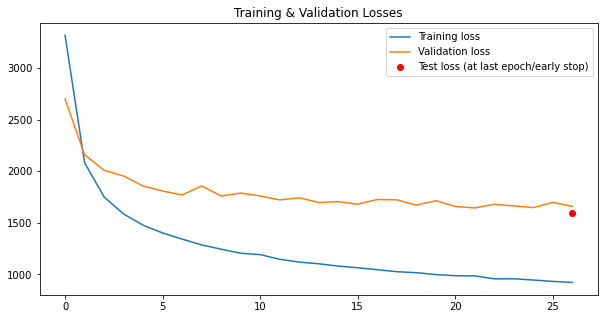

In [132]:
# Runs the Joint VAE
_, _, _, _ = run_encoder_pipeline(
    train_loader, val_loader, test_loader,  n_channels, 
    latent_dims, categorical_dims=categorical_dims,
    epochs=epochs, name_dataset=name_dataset, 
    output_intermediary_info=False, model_type="JointVAE"
)

#### Generating an upgraded dataset without Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [133]:
# Fetches the generated VAE Model model to import
model_path = f"trained_models/JointVAE/{name_dataset}/"
model = [x for x in os.listdir(model_path) if x[-4:]==".pth"][-1]
model_path += model

# Calculates the number of images to generate
percentage = 5
nb_images_in_dataset = len(base_dataset[0])
n_generated_images = int((percentage/100)*nb_images_in_dataset)
print(f"Number of generated images: {n_generated_images}",
      f"({percentage}% of the dataset)")

# Creates the augmented dataloader
jointVAE_loader = generate_augmented_dataset_jointVAE(
    n_channels, latent_dims, categorical_dims, model_path, 
    base_dataset[0], 64, test_loader, val_loader, 
    n_generated_images, weighted_sampling=False
)

Number of generated images: 1729 (5% of the dataset)


2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "OrganAMNIST",
  "description": "The OrganAMNIST is based on 3D computed tomography (CT) images from Liver Tumor Segmentation Benchmark (LiTS). It is renamed from OrganMNIST_Axial (in MedMNIST v1) for simplicity. We use bounding-box annotations of 11 body organs from another study to obtain the organ labels. Hounsfield-Unit (HU) of the 3D images are transformed into gray-scale with an abdominal window. We crop 2D images from the center slices of the 3D bounding boxes in axial views (planes). The images are resized into 1\u00d728\u00d728 to perform multi-class classification of 11 body organs. 115 and 16 CT scans from the source training set are used as training and validation set, respectively. The 70 CT scans from the source test set are treated as the test set.",
  "url": "https://zenodo.org/record/5208230/files/organamnist.npz?download=1",
  "MD5": "866b832ed4eeba67bfb9edee1d5544e6",
  "task": "multi-class",
  "label": {
    "0": "bladder",
    "1": "femur-left",

100%|███████████████████████████████████████| 1081/1081 [02:01<00:00,  8.91it/s]


train -- accuracy: 0.38
val -- accuracy: 0.99,  AUC: 0.89
Epoch 1



100%|███████████████████████████████████████| 1081/1081 [02:02<00:00,  8.85it/s]


train -- accuracy: 0.5
val -- accuracy: 1.0,  AUC: 0.94
Epoch 2



100%|███████████████████████████████████████| 1081/1081 [02:02<00:00,  8.84it/s]


train -- accuracy: 0.54
val -- accuracy: 1.0,  AUC: 0.95
Epoch 3



100%|███████████████████████████████████████| 1081/1081 [02:02<00:00,  8.79it/s]


train -- accuracy: 0.55
val -- accuracy: 1.0,  AUC: 0.95
Epoch 4



100%|███████████████████████████████████████| 1081/1081 [01:42<00:00, 10.53it/s]


train -- accuracy: 0.56
val -- accuracy: 1.0,  AUC: 0.97
Epoch 5



100%|███████████████████████████████████████| 1081/1081 [01:42<00:00, 10.58it/s]


train -- accuracy: 0.57
val -- accuracy: 1.0,  AUC: 0.96
Epoch 6



100%|███████████████████████████████████████| 1081/1081 [01:42<00:00, 10.50it/s]


train -- accuracy: 0.57
val -- accuracy: 1.0,  AUC: 0.97
Epoch 7



100%|███████████████████████████████████████| 1081/1081 [01:45<00:00, 10.20it/s]


train -- accuracy: 0.58
val -- accuracy: 1.0,  AUC: 0.96
Epoch 8



100%|███████████████████████████████████████| 1081/1081 [02:02<00:00,  8.79it/s]


train -- accuracy: 0.58
val -- accuracy: 1.0,  AUC: 0.97
Epoch 9



100%|███████████████████████████████████████| 1081/1081 [02:01<00:00,  8.89it/s]


train -- accuracy: 0.58
val -- accuracy: 1.0,  AUC: 0.96
Epoch 10



100%|███████████████████████████████████████| 1081/1081 [02:02<00:00,  8.83it/s]


train -- accuracy: 0.58
val -- accuracy: 1.0,  AUC: 0.97
Epoch 11



100%|███████████████████████████████████████| 1081/1081 [02:00<00:00,  8.96it/s]


train -- accuracy: 0.58
val -- accuracy: 1.0,  AUC: 0.98
Epoch 12



100%|███████████████████████████████████████| 1081/1081 [02:02<00:00,  8.82it/s]


train -- accuracy: 0.59
val -- accuracy: 1.0,  AUC: 0.97
Epoch 13



100%|███████████████████████████████████████| 1081/1081 [02:00<00:00,  9.00it/s]


train -- accuracy: 0.59
val -- accuracy: 1.0,  AUC: 0.97
Epoch 14



100%|███████████████████████████████████████| 1081/1081 [01:58<00:00,  9.13it/s]


train -- accuracy: 0.59
val -- accuracy: 1.0,  AUC: 0.97
Epoch 15



100%|███████████████████████████████████████| 1081/1081 [02:03<00:00,  8.72it/s]


train -- accuracy: 0.59
val -- accuracy: 1.0,  AUC: 0.97
Epoch 16



100%|███████████████████████████████████████| 1081/1081 [01:58<00:00,  9.13it/s]


train -- accuracy: 0.59
val -- accuracy: 1.0,  AUC: 0.97
Epoch 17



100%|███████████████████████████████████████| 1081/1081 [01:59<00:00,  9.03it/s]


train -- accuracy: 0.59
val -- accuracy: 1.0,  AUC: 0.97
Epoch 18



100%|███████████████████████████████████████| 1081/1081 [02:04<00:00,  8.69it/s]


train -- accuracy: 0.59
val -- accuracy: 1.0,  AUC: 0.97
Epoch 19



100%|███████████████████████████████████████| 1081/1081 [02:02<00:00,  8.86it/s]


train -- accuracy: 0.59
val -- accuracy: 1.0,  AUC: 0.97
test -- accuracy: 0.99,  AUC: 0.88


<Figure size 720x720 with 0 Axes>

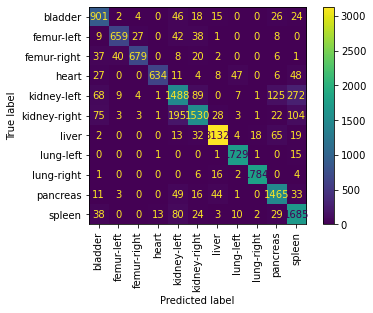

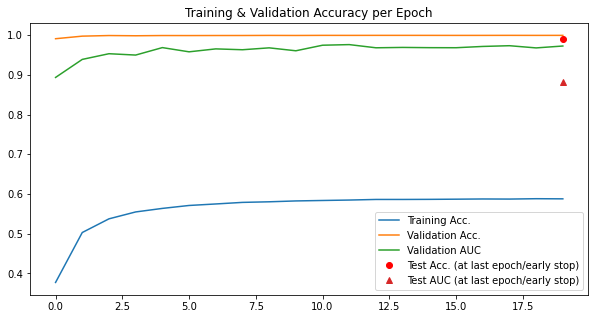

In [134]:
# Runs the classifier again 

clf = run_classifier_pipeline(name_dataset, info_flags, jointVAE_loader)

#### Generating an upgraded dataset with Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [135]:
# Creates the augmented dataloader
jointVAE_loader = generate_augmented_dataset_jointVAE(
    n_channels, latent_dims, categorical_dims, model_path, 
    base_dataset[0], 64, test_loader, val_loader, 
    n_generated_images, weighted_sampling=True
)

2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "OrganAMNIST",
  "description": "The OrganAMNIST is based on 3D computed tomography (CT) images from Liver Tumor Segmentation Benchmark (LiTS). It is renamed from OrganMNIST_Axial (in MedMNIST v1) for simplicity. We use bounding-box annotations of 11 body organs from another study to obtain the organ labels. Hounsfield-Unit (HU) of the 3D images are transformed into gray-scale with an abdominal window. We crop 2D images from the center slices of the 3D bounding boxes in axial views (planes). The images are resized into 1\u00d728\u00d728 to perform multi-class classification of 11 body organs. 115 and 16 CT scans from the source training set are used as training and validation set, respectively. The 70 CT scans from the source test set are treated as the test set.",
  "url": "https://zenodo.org/record/5208230/files/organamnist.npz?download=1",
  "MD5": "866b832ed4eeba67bfb9edee1d5544e6",
  "task": "multi-class",
  "label": {
    "0": "bladder",
    "1": "femur-left",

100%|███████████████████████████████████████| 1081/1081 [01:43<00:00, 10.44it/s]


train -- accuracy: 0.35
val -- accuracy: 0.99,  AUC: 0.86
Epoch 1



100%|███████████████████████████████████████| 1081/1081 [01:43<00:00, 10.46it/s]


train -- accuracy: 0.47
val -- accuracy: 1.0,  AUC: 0.94
Epoch 2



100%|███████████████████████████████████████| 1081/1081 [01:43<00:00, 10.42it/s]


train -- accuracy: 0.5
val -- accuracy: 1.0,  AUC: 0.93
Epoch 3



100%|███████████████████████████████████████| 1081/1081 [01:43<00:00, 10.45it/s]


train -- accuracy: 0.51
val -- accuracy: 1.0,  AUC: 0.95
Epoch 4



100%|███████████████████████████████████████| 1081/1081 [01:43<00:00, 10.44it/s]


train -- accuracy: 0.52
val -- accuracy: 1.0,  AUC: 0.95
Epoch 5



100%|███████████████████████████████████████| 1081/1081 [01:42<00:00, 10.50it/s]


train -- accuracy: 0.53
val -- accuracy: 1.0,  AUC: 0.96
Epoch 6



100%|███████████████████████████████████████| 1081/1081 [01:43<00:00, 10.49it/s]


train -- accuracy: 0.54
val -- accuracy: 1.0,  AUC: 0.96
Epoch 7



100%|███████████████████████████████████████| 1081/1081 [01:42<00:00, 10.51it/s]


train -- accuracy: 0.54
val -- accuracy: 1.0,  AUC: 0.96
Epoch 8



100%|███████████████████████████████████████| 1081/1081 [01:42<00:00, 10.52it/s]


train -- accuracy: 0.54
val -- accuracy: 1.0,  AUC: 0.96
Epoch 9



100%|███████████████████████████████████████| 1081/1081 [01:43<00:00, 10.45it/s]


train -- accuracy: 0.54
val -- accuracy: 1.0,  AUC: 0.96
Epoch 10



100%|███████████████████████████████████████| 1081/1081 [01:44<00:00, 10.39it/s]


train -- accuracy: 0.54
val -- accuracy: 1.0,  AUC: 0.97
Epoch 11



100%|███████████████████████████████████████| 1081/1081 [01:43<00:00, 10.49it/s]


train -- accuracy: 0.54
val -- accuracy: 1.0,  AUC: 0.97
Epoch 12



100%|███████████████████████████████████████| 1081/1081 [01:43<00:00, 10.45it/s]


train -- accuracy: 0.54
val -- accuracy: 1.0,  AUC: 0.97
Epoch 13



100%|███████████████████████████████████████| 1081/1081 [01:43<00:00, 10.44it/s]


train -- accuracy: 0.54
val -- accuracy: 1.0,  AUC: 0.96
Epoch 14



100%|███████████████████████████████████████| 1081/1081 [01:42<00:00, 10.50it/s]


train -- accuracy: 0.54
val -- accuracy: 1.0,  AUC: 0.97
Epoch 15



100%|███████████████████████████████████████| 1081/1081 [01:43<00:00, 10.48it/s]


train -- accuracy: 0.54
val -- accuracy: 1.0,  AUC: 0.97
Epoch 16



100%|███████████████████████████████████████| 1081/1081 [01:43<00:00, 10.47it/s]


train -- accuracy: 0.54
val -- accuracy: 1.0,  AUC: 0.97
Epoch 17



100%|███████████████████████████████████████| 1081/1081 [01:43<00:00, 10.43it/s]


train -- accuracy: 0.54
val -- accuracy: 1.0,  AUC: 0.96
Epoch 18



100%|███████████████████████████████████████| 1081/1081 [01:43<00:00, 10.48it/s]


train -- accuracy: 0.54
val -- accuracy: 1.0,  AUC: 0.97
Epoch 19



100%|███████████████████████████████████████| 1081/1081 [01:42<00:00, 10.56it/s]


train -- accuracy: 0.55
val -- accuracy: 1.0,  AUC: 0.97
test -- accuracy: 0.99,  AUC: 0.89


<Figure size 720x720 with 0 Axes>

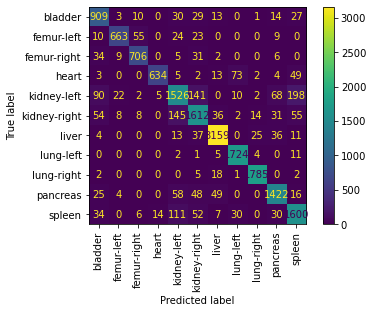

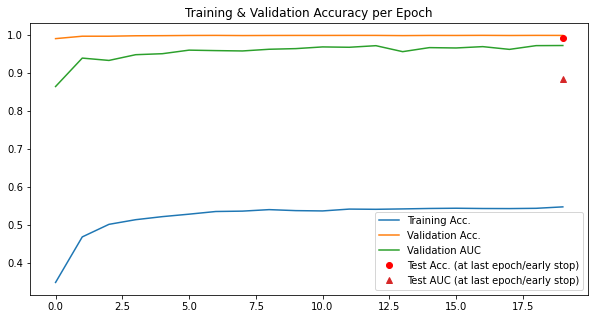

In [136]:
# Runs the classifier again 
clf = run_classifier_pipeline(name_dataset, info_flags, jointVAE_loader)

### OrgancMNIST

#### Training the Joint VAE

In [137]:
# Declares the dataset name and retrieves the base dataset
name_dataset = "organcmnist"
base_dataset = organcmnist_noWRS_noGDA

# Retrieves the dataset parameters
n_channels = info_flags[name_dataset][0]["n_channels"]

# Retrieves the data loader
train_loader = base_dataset[3]
val_loader = base_dataset[5]
test_loader = base_dataset[4]

Testing Joint Variational Autoencoder:
Clearing CUDA Pytorch Cache
Model Output size: torch.Size([10, 1, 28, 28])
Forward pass test:  True
{'loss': tensor(262632.0625, grad_fn=<AddBackward0>), 'Reconstruction_Loss': tensor(8754.3398, grad_fn=<MseLossBackward0>), 'Capacity_Loss': tensor(377.0732, grad_fn=<AddBackward0>)}
Loss test:  True
Cuda device:  cuda
Training phase:
Train epoch 1 -- average loss: 4518.521792067308
Validation set loss: 3467.048508
Train epoch 2 -- average loss: 2851.3373894230767
Validation set loss: 2842.182451
Train epoch 3 -- average loss: 2425.959268028846
Validation set loss: 2537.551722
Train epoch 4 -- average loss: 2165.778706730769
Validation set loss: 2315.534457
Train epoch 5 -- average loss: 1992.4970709134616
Validation set loss: 2228.726856
Train epoch 6 -- average loss: 1863.1232217548077
Validation set loss: 2098.643421
Train epoch 7 -- average loss: 1753.6938100961538
Validation set loss: 2006.950558
Train epoch 8 -- average loss: 1706.639128605769

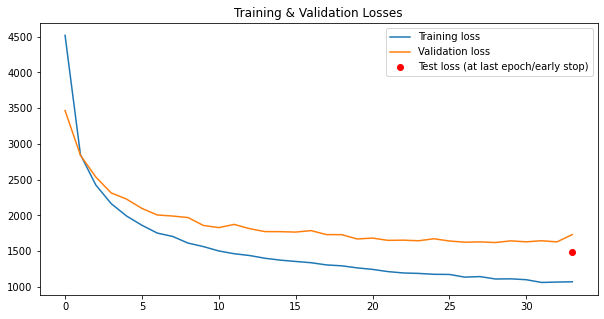

In [138]:
# Runs the Joint VAE
_, _, _, _ = run_encoder_pipeline(
    train_loader, val_loader, test_loader,  n_channels, 
    latent_dims, categorical_dims=categorical_dims,
    epochs=epochs, name_dataset=name_dataset, 
    output_intermediary_info=False, model_type="JointVAE"
)

#### Generating an upgraded dataset without Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [139]:
# Fetches the generated VAE Model model to import
model_path = f"trained_models/JointVAE/{name_dataset}/"
model = [x for x in os.listdir(model_path) if x[-4:]==".pth"][-1]
model_path += model

# Calculates the number of images to generate
percentage = 10
nb_images_in_dataset = len(base_dataset[0])
n_generated_images = int((percentage/100)*nb_images_in_dataset)
print(f"Number of generated images: {n_generated_images}",
      f"({percentage}% of the dataset)")

# Creates the augmented dataloader
jointVAE_loader = generate_augmented_dataset_jointVAE(
    n_channels, latent_dims, categorical_dims, model_path, 
    base_dataset[0], 64, test_loader, val_loader, 
    n_generated_images, weighted_sampling=False
)

Number of generated images: 1300 (10% of the dataset)


2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "OrganCMNIST",
  "description": "The OrganCMNIST is based on 3D computed tomography (CT) images from Liver Tumor Segmentation Benchmark (LiTS). It is renamed from OrganMNIST_Coronal (in MedMNIST v1) for simplicity. We use bounding-box annotations of 11 body organs from another study to obtain the organ labels. Hounsfield-Unit (HU) of the 3D images are transformed into gray-scale with an abdominal window. We crop 2D images from the center slices of the 3D bounding boxes in coronal views (planes). The images are resized into 1\u00d728\u00d728 to perform multi-class classification of 11 body organs. 115 and 16 CT scans from the source training set are used as training and validation set, respectively. The 70 CT scans from the source test set are treated as the test set.",
  "url": "https://zenodo.org/record/5208230/files/organcmnist.npz?download=1",
  "MD5": "0afa5834fb105f7705a7d93372119a21",
  "task": "multi-class",
  "label": {
    "0": "bladder",
    "1": "femur-le

100%|█████████████████████████████████████████| 407/407 [00:38<00:00, 10.51it/s]


train -- accuracy: 0.3
val -- accuracy: 0.96,  AUC: 0.62
Epoch 1



100%|█████████████████████████████████████████| 407/407 [00:38<00:00, 10.52it/s]


train -- accuracy: 0.43
val -- accuracy: 0.99,  AUC: 0.82
Epoch 2



100%|█████████████████████████████████████████| 407/407 [00:38<00:00, 10.55it/s]


train -- accuracy: 0.5
val -- accuracy: 0.99,  AUC: 0.91
Epoch 3



100%|█████████████████████████████████████████| 407/407 [00:38<00:00, 10.52it/s]


train -- accuracy: 0.52
val -- accuracy: 1.0,  AUC: 0.9
Epoch 4



100%|█████████████████████████████████████████| 407/407 [00:38<00:00, 10.53it/s]


train -- accuracy: 0.54
val -- accuracy: 0.99,  AUC: 0.88
Epoch 5



100%|█████████████████████████████████████████| 407/407 [00:38<00:00, 10.55it/s]


train -- accuracy: 0.55
val -- accuracy: 1.0,  AUC: 0.93
Epoch 6



100%|█████████████████████████████████████████| 407/407 [00:38<00:00, 10.52it/s]


train -- accuracy: 0.56
val -- accuracy: 1.0,  AUC: 0.92
Epoch 7



100%|█████████████████████████████████████████| 407/407 [00:38<00:00, 10.54it/s]


train -- accuracy: 0.57
val -- accuracy: 1.0,  AUC: 0.95
Epoch 8



100%|█████████████████████████████████████████| 407/407 [00:38<00:00, 10.55it/s]


train -- accuracy: 0.58
val -- accuracy: 1.0,  AUC: 0.93
Epoch 9



100%|█████████████████████████████████████████| 407/407 [00:38<00:00, 10.53it/s]


train -- accuracy: 0.58
val -- accuracy: 1.0,  AUC: 0.95
Epoch 10



100%|█████████████████████████████████████████| 407/407 [00:38<00:00, 10.53it/s]


train -- accuracy: 0.58
val -- accuracy: 1.0,  AUC: 0.93
Epoch 11



100%|█████████████████████████████████████████| 407/407 [00:38<00:00, 10.52it/s]


train -- accuracy: 0.59
val -- accuracy: 1.0,  AUC: 0.96
Epoch 12



100%|█████████████████████████████████████████| 407/407 [00:38<00:00, 10.54it/s]


train -- accuracy: 0.59
val -- accuracy: 1.0,  AUC: 0.95
Epoch 13



100%|█████████████████████████████████████████| 407/407 [00:38<00:00, 10.55it/s]


train -- accuracy: 0.59
val -- accuracy: 1.0,  AUC: 0.96
Epoch 14



100%|█████████████████████████████████████████| 407/407 [00:38<00:00, 10.51it/s]


train -- accuracy: 0.6
val -- accuracy: 1.0,  AUC: 0.96
Epoch 15



100%|█████████████████████████████████████████| 407/407 [00:38<00:00, 10.54it/s]


train -- accuracy: 0.6
val -- accuracy: 1.0,  AUC: 0.95
Epoch 16



100%|█████████████████████████████████████████| 407/407 [00:38<00:00, 10.55it/s]


train -- accuracy: 0.6
val -- accuracy: 1.0,  AUC: 0.96
Epoch 17



100%|█████████████████████████████████████████| 407/407 [00:38<00:00, 10.55it/s]


train -- accuracy: 0.6
val -- accuracy: 1.0,  AUC: 0.94
Epoch 18



100%|█████████████████████████████████████████| 407/407 [00:38<00:00, 10.56it/s]


train -- accuracy: 0.6
val -- accuracy: 1.0,  AUC: 0.96
Epoch 19



100%|█████████████████████████████████████████| 407/407 [00:38<00:00, 10.54it/s]


train -- accuracy: 0.6
val -- accuracy: 1.0,  AUC: 0.95
test -- accuracy: 0.99,  AUC: 0.86


<Figure size 720x720 with 0 Axes>

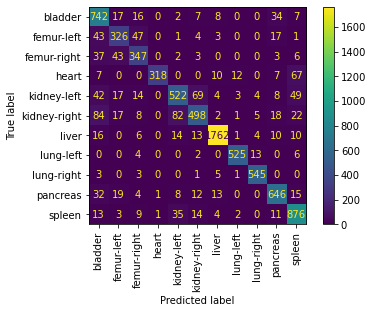

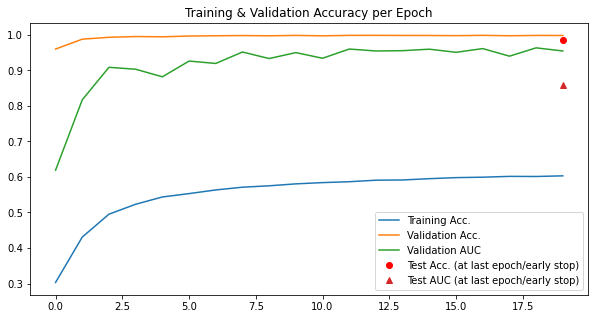

In [140]:
# Runs the classifier again 

clf = run_classifier_pipeline(name_dataset, info_flags, jointVAE_loader)

#### Generating an upgraded dataset with Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [141]:
# Creates the augmented dataloader
jointVAE_loader = generate_augmented_dataset_jointVAE(
    n_channels, latent_dims, categorical_dims, model_path, 
    base_dataset[0], 64, test_loader, val_loader, 
    n_generated_images, weighted_sampling=True
)

2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "OrganCMNIST",
  "description": "The OrganCMNIST is based on 3D computed tomography (CT) images from Liver Tumor Segmentation Benchmark (LiTS). It is renamed from OrganMNIST_Coronal (in MedMNIST v1) for simplicity. We use bounding-box annotations of 11 body organs from another study to obtain the organ labels. Hounsfield-Unit (HU) of the 3D images are transformed into gray-scale with an abdominal window. We crop 2D images from the center slices of the 3D bounding boxes in coronal views (planes). The images are resized into 1\u00d728\u00d728 to perform multi-class classification of 11 body organs. 115 and 16 CT scans from the source training set are used as training and validation set, respectively. The 70 CT scans from the source test set are treated as the test set.",
  "url": "https://zenodo.org/record/5208230/files/organcmnist.npz?download=1",
  "MD5": "0afa5834fb105f7705a7d93372119a21",
  "task": "multi-class",
  "label": {
    "0": "bladder",
    "1": "femur-le

100%|█████████████████████████████████████████| 407/407 [00:38<00:00, 10.62it/s]


train -- accuracy: 0.25
val -- accuracy: 0.95,  AUC: 0.73
Epoch 1



100%|█████████████████████████████████████████| 407/407 [00:38<00:00, 10.56it/s]


train -- accuracy: 0.37
val -- accuracy: 0.99,  AUC: 0.84
Epoch 2



100%|█████████████████████████████████████████| 407/407 [00:38<00:00, 10.51it/s]


train -- accuracy: 0.43
val -- accuracy: 1.0,  AUC: 0.91
Epoch 3



100%|█████████████████████████████████████████| 407/407 [00:38<00:00, 10.44it/s]


train -- accuracy: 0.46
val -- accuracy: 1.0,  AUC: 0.92
Epoch 4



100%|█████████████████████████████████████████| 407/407 [00:38<00:00, 10.48it/s]


train -- accuracy: 0.48
val -- accuracy: 1.0,  AUC: 0.94
Epoch 5



100%|█████████████████████████████████████████| 407/407 [00:38<00:00, 10.58it/s]


train -- accuracy: 0.49
val -- accuracy: 1.0,  AUC: 0.95
Epoch 6



100%|█████████████████████████████████████████| 407/407 [00:38<00:00, 10.59it/s]


train -- accuracy: 0.5
val -- accuracy: 1.0,  AUC: 0.96
Epoch 7



100%|█████████████████████████████████████████| 407/407 [00:38<00:00, 10.45it/s]


train -- accuracy: 0.5
val -- accuracy: 1.0,  AUC: 0.93
Epoch 8



100%|█████████████████████████████████████████| 407/407 [00:38<00:00, 10.49it/s]


train -- accuracy: 0.51
val -- accuracy: 1.0,  AUC: 0.95
Epoch 9



100%|█████████████████████████████████████████| 407/407 [00:38<00:00, 10.56it/s]


train -- accuracy: 0.51
val -- accuracy: 1.0,  AUC: 0.96
Epoch 10



100%|█████████████████████████████████████████| 407/407 [00:38<00:00, 10.51it/s]


train -- accuracy: 0.52
val -- accuracy: 1.0,  AUC: 0.94
Epoch 11



100%|█████████████████████████████████████████| 407/407 [00:38<00:00, 10.56it/s]


train -- accuracy: 0.52
val -- accuracy: 1.0,  AUC: 0.96
Epoch 12



100%|█████████████████████████████████████████| 407/407 [00:38<00:00, 10.59it/s]


train -- accuracy: 0.52
val -- accuracy: 1.0,  AUC: 0.95
Epoch 13



100%|█████████████████████████████████████████| 407/407 [00:38<00:00, 10.52it/s]


train -- accuracy: 0.53
val -- accuracy: 1.0,  AUC: 0.96
Epoch 14



100%|█████████████████████████████████████████| 407/407 [00:38<00:00, 10.60it/s]


train -- accuracy: 0.53
val -- accuracy: 1.0,  AUC: 0.95
Epoch 15



100%|█████████████████████████████████████████| 407/407 [00:38<00:00, 10.53it/s]


train -- accuracy: 0.53
val -- accuracy: 1.0,  AUC: 0.96
Epoch 16



100%|█████████████████████████████████████████| 407/407 [00:38<00:00, 10.47it/s]


train -- accuracy: 0.53
val -- accuracy: 1.0,  AUC: 0.96
Epoch 17



100%|█████████████████████████████████████████| 407/407 [00:38<00:00, 10.57it/s]


train -- accuracy: 0.54
val -- accuracy: 1.0,  AUC: 0.96
Epoch 18



100%|█████████████████████████████████████████| 407/407 [00:38<00:00, 10.59it/s]


train -- accuracy: 0.54
val -- accuracy: 1.0,  AUC: 0.95
Epoch 19



100%|█████████████████████████████████████████| 407/407 [00:38<00:00, 10.45it/s]


train -- accuracy: 0.53
val -- accuracy: 1.0,  AUC: 0.96
test -- accuracy: 0.98,  AUC: 0.86


<Figure size 720x720 with 0 Axes>

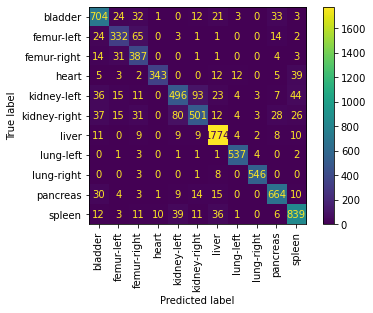

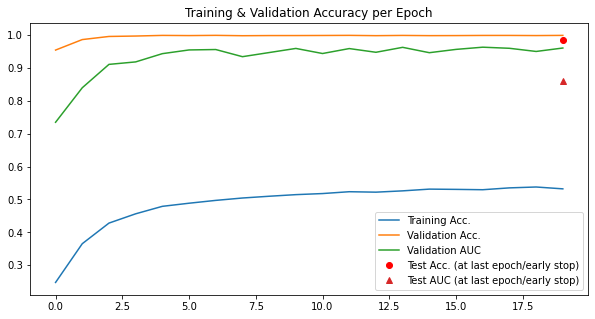

In [142]:
# Runs the classifier again 
clf = run_classifier_pipeline(name_dataset, info_flags, jointVAE_loader)

### OrgansMNIST

#### Training the Joint VAE

In [143]:
# Declares the dataset name and retrieves the base dataset
name_dataset = "organsmnist"
base_dataset = organsmnist_noWRS_noGDA

# Retrieves the dataset parameters
n_channels = info_flags[name_dataset][0]["n_channels"]

# Retrieves the data loader
train_loader = base_dataset[3]
val_loader = base_dataset[5]
test_loader = base_dataset[4]

Testing Joint Variational Autoencoder:
Clearing CUDA Pytorch Cache
Model Output size: torch.Size([10, 1, 28, 28])
Forward pass test:  True
{'loss': tensor(259297.0938, grad_fn=<AddBackward0>), 'Reconstruction_Loss': tensor(8643.1738, grad_fn=<MseLossBackward0>), 'Capacity_Loss': tensor(373.7627, grad_fn=<AddBackward0>)}
Loss test:  True
Cuda device:  cuda
Training phase:
Train epoch 1 -- average loss: 4249.357489687948
Validation set loss: 3381.22763
Train epoch 2 -- average loss: 2711.8622108142035
Validation set loss: 2581.565656
Train epoch 3 -- average loss: 2248.8248778246057
Validation set loss: 2218.45114
Train epoch 4 -- average loss: 2002.3534859218078
Validation set loss: 2207.750505
Train epoch 5 -- average loss: 1843.5891476865136
Validation set loss: 1976.271881
Train epoch 6 -- average loss: 1724.1299049497848
Validation set loss: 1946.73954
Train epoch 7 -- average loss: 1657.3148829806312
Validation set loss: 1843.138307
Train epoch 8 -- average loss: 1568.725418086442


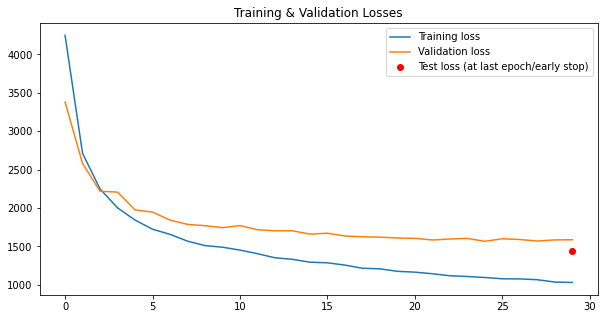

In [144]:
# Runs the Joint VAE
_, _, _, _ = run_encoder_pipeline(
    train_loader, val_loader, test_loader,  n_channels, 
    latent_dims, categorical_dims=categorical_dims,
    epochs=epochs, name_dataset=name_dataset, 
    output_intermediary_info=False, model_type="JointVAE"
)

#### Generating an upgraded dataset without Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [145]:
# Fetches the generated VAE Model model to import
model_path = f"trained_models/JointVAE/{name_dataset}/"
model = [x for x in os.listdir(model_path) if x[-4:]==".pth"][-1]
model_path += model

# Calculates the number of images to generate
percentage = 10
nb_images_in_dataset = len(base_dataset[0])
n_generated_images = int((percentage/100)*nb_images_in_dataset)
print(f"Number of generated images: {n_generated_images}",
      f"({percentage}% of the dataset)")

# Creates the augmented dataloader
jointVAE_loader = generate_augmented_dataset_jointVAE(
    n_channels, latent_dims, categorical_dims, model_path, 
    base_dataset[0], 64, test_loader, val_loader, 
    n_generated_images, weighted_sampling=False
)

Number of generated images: 1394 (10% of the dataset)


2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "OrganSMNIST",
  "description": "The OrganSMNIST is based on 3D computed tomography (CT) images from Liver Tumor Segmentation Benchmark (LiTS). It is renamed from OrganMNIST_Sagittal (in MedMNIST v1) for simplicity. We use bounding-box annotations of 11 body organs from another study to obtain the organ labels. Hounsfield-Unit (HU) of the 3D images are transformed into gray-scale with an abdominal window. We crop 2D images from the center slices of the 3D bounding boxes in sagittal views (planes). The images are resized into 1\u00d728\u00d728 to perform multi-class classification of 11 body organs. 115 and 16 CT scans from the source training set are used as training and validation set, respectively. The 70 CT scans from the source test set are treated as the test set.",
  "url": "https://zenodo.org/record/5208230/files/organsmnist.npz?download=1",
  "MD5": "e5c39f1af030238290b9557d9503af9d",
  "task": "multi-class",
  "label": {
    "0": "bladder",
    "1": "femur-

100%|█████████████████████████████████████████| 436/436 [00:41<00:00, 10.53it/s]


train -- accuracy: 0.28
val -- accuracy: 0.93,  AUC: 0.43
Epoch 1



100%|█████████████████████████████████████████| 436/436 [00:41<00:00, 10.53it/s]


train -- accuracy: 0.38
val -- accuracy: 0.96,  AUC: 0.62
Epoch 2



100%|█████████████████████████████████████████| 436/436 [00:41<00:00, 10.54it/s]


train -- accuracy: 0.44
val -- accuracy: 0.97,  AUC: 0.7
Epoch 3



100%|█████████████████████████████████████████| 436/436 [00:41<00:00, 10.52it/s]


train -- accuracy: 0.48
val -- accuracy: 0.98,  AUC: 0.78
Epoch 4



100%|█████████████████████████████████████████| 436/436 [00:41<00:00, 10.53it/s]


train -- accuracy: 0.5
val -- accuracy: 0.99,  AUC: 0.8
Epoch 5



100%|█████████████████████████████████████████| 436/436 [00:41<00:00, 10.54it/s]


train -- accuracy: 0.51
val -- accuracy: 0.99,  AUC: 0.82
Epoch 6



100%|█████████████████████████████████████████| 436/436 [00:41<00:00, 10.52it/s]


train -- accuracy: 0.52
val -- accuracy: 0.99,  AUC: 0.83
Epoch 7



100%|█████████████████████████████████████████| 436/436 [00:41<00:00, 10.51it/s]


train -- accuracy: 0.53
val -- accuracy: 0.99,  AUC: 0.83
Epoch 8



100%|█████████████████████████████████████████| 436/436 [00:41<00:00, 10.52it/s]


train -- accuracy: 0.54
val -- accuracy: 0.99,  AUC: 0.83
Epoch 9



100%|█████████████████████████████████████████| 436/436 [00:41<00:00, 10.54it/s]


train -- accuracy: 0.55
val -- accuracy: 0.99,  AUC: 0.81
Epoch 10



100%|█████████████████████████████████████████| 436/436 [00:41<00:00, 10.54it/s]


train -- accuracy: 0.55
val -- accuracy: 0.99,  AUC: 0.84
Epoch 11



100%|█████████████████████████████████████████| 436/436 [00:41<00:00, 10.52it/s]


train -- accuracy: 0.56
val -- accuracy: 0.99,  AUC: 0.84
Epoch 12



100%|█████████████████████████████████████████| 436/436 [00:41<00:00, 10.54it/s]


train -- accuracy: 0.57
val -- accuracy: 0.99,  AUC: 0.85
Epoch 13



100%|█████████████████████████████████████████| 436/436 [00:41<00:00, 10.53it/s]


train -- accuracy: 0.57
val -- accuracy: 0.99,  AUC: 0.83
Epoch 14



100%|█████████████████████████████████████████| 436/436 [00:41<00:00, 10.51it/s]


train -- accuracy: 0.58
val -- accuracy: 0.99,  AUC: 0.85
Epoch 15



100%|█████████████████████████████████████████| 436/436 [00:41<00:00, 10.53it/s]


train -- accuracy: 0.58
val -- accuracy: 0.99,  AUC: 0.85
Epoch 16



100%|█████████████████████████████████████████| 436/436 [00:41<00:00, 10.52it/s]


train -- accuracy: 0.59
val -- accuracy: 0.99,  AUC: 0.86
Epoch 17



100%|█████████████████████████████████████████| 436/436 [00:41<00:00, 10.51it/s]


train -- accuracy: 0.59
val -- accuracy: 0.99,  AUC: 0.85
Epoch 18



100%|█████████████████████████████████████████| 436/436 [00:41<00:00, 10.54it/s]


train -- accuracy: 0.59
val -- accuracy: 0.99,  AUC: 0.86
Epoch 19



100%|█████████████████████████████████████████| 436/436 [00:41<00:00, 10.53it/s]


train -- accuracy: 0.6
val -- accuracy: 0.99,  AUC: 0.87
test -- accuracy: 0.96,  AUC: 0.72


<Figure size 720x720 with 0 Axes>

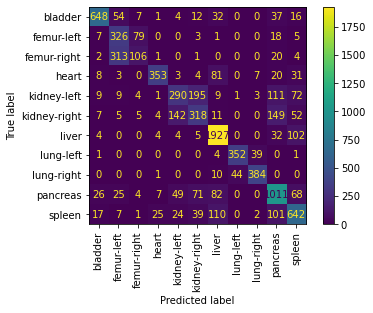

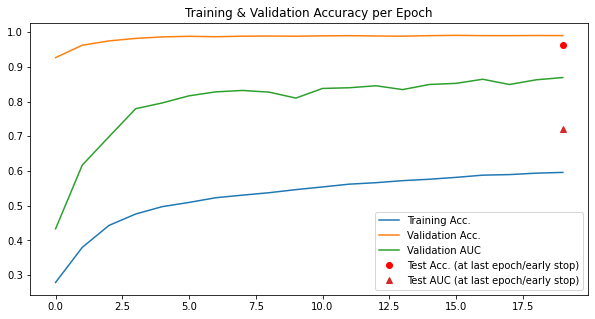

In [146]:
# Runs the classifier again 

clf = run_classifier_pipeline(name_dataset, info_flags, jointVAE_loader)

#### Generating an upgraded dataset with Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [147]:
# Creates the augmented dataloader
jointVAE_loader = generate_augmented_dataset_jointVAE(
    n_channels, latent_dims, categorical_dims, model_path, 
    base_dataset[0], 64, test_loader, val_loader, 
    n_generated_images, weighted_sampling=True
)

2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "OrganSMNIST",
  "description": "The OrganSMNIST is based on 3D computed tomography (CT) images from Liver Tumor Segmentation Benchmark (LiTS). It is renamed from OrganMNIST_Sagittal (in MedMNIST v1) for simplicity. We use bounding-box annotations of 11 body organs from another study to obtain the organ labels. Hounsfield-Unit (HU) of the 3D images are transformed into gray-scale with an abdominal window. We crop 2D images from the center slices of the 3D bounding boxes in sagittal views (planes). The images are resized into 1\u00d728\u00d728 to perform multi-class classification of 11 body organs. 115 and 16 CT scans from the source training set are used as training and validation set, respectively. The 70 CT scans from the source test set are treated as the test set.",
  "url": "https://zenodo.org/record/5208230/files/organsmnist.npz?download=1",
  "MD5": "e5c39f1af030238290b9557d9503af9d",
  "task": "multi-class",
  "label": {
    "0": "bladder",
    "1": "femur-

100%|█████████████████████████████████████████| 436/436 [00:41<00:00, 10.59it/s]


train -- accuracy: 0.22
val -- accuracy: 0.93,  AUC: 0.53
Epoch 1



100%|█████████████████████████████████████████| 436/436 [00:41<00:00, 10.63it/s]


train -- accuracy: 0.31
val -- accuracy: 0.96,  AUC: 0.65
Epoch 2



100%|█████████████████████████████████████████| 436/436 [00:41<00:00, 10.52it/s]


train -- accuracy: 0.36
val -- accuracy: 0.98,  AUC: 0.73
Epoch 3



100%|█████████████████████████████████████████| 436/436 [00:40<00:00, 10.66it/s]


train -- accuracy: 0.39
val -- accuracy: 0.99,  AUC: 0.76
Epoch 4



100%|█████████████████████████████████████████| 436/436 [00:42<00:00, 10.23it/s]


train -- accuracy: 0.41
val -- accuracy: 0.99,  AUC: 0.81
Epoch 5



100%|█████████████████████████████████████████| 436/436 [00:42<00:00, 10.17it/s]


train -- accuracy: 0.42
val -- accuracy: 0.99,  AUC: 0.84
Epoch 6



100%|█████████████████████████████████████████| 436/436 [00:43<00:00, 10.09it/s]


train -- accuracy: 0.44
val -- accuracy: 0.99,  AUC: 0.84
Epoch 7



100%|█████████████████████████████████████████| 436/436 [00:44<00:00,  9.80it/s]


train -- accuracy: 0.45
val -- accuracy: 0.99,  AUC: 0.85
Epoch 8



100%|█████████████████████████████████████████| 436/436 [00:45<00:00,  9.65it/s]


train -- accuracy: 0.45
val -- accuracy: 0.99,  AUC: 0.84
Epoch 9



100%|█████████████████████████████████████████| 436/436 [00:42<00:00, 10.33it/s]


train -- accuracy: 0.46
val -- accuracy: 0.99,  AUC: 0.84
Epoch 10



100%|█████████████████████████████████████████| 436/436 [00:41<00:00, 10.56it/s]


train -- accuracy: 0.47
val -- accuracy: 0.99,  AUC: 0.84
Epoch 11



100%|█████████████████████████████████████████| 436/436 [00:42<00:00, 10.38it/s]


train -- accuracy: 0.48
val -- accuracy: 0.99,  AUC: 0.86
Epoch 12



100%|█████████████████████████████████████████| 436/436 [00:41<00:00, 10.41it/s]


train -- accuracy: 0.48
val -- accuracy: 0.99,  AUC: 0.84
Epoch 13



100%|█████████████████████████████████████████| 436/436 [00:41<00:00, 10.53it/s]


train -- accuracy: 0.49
val -- accuracy: 0.99,  AUC: 0.84
Epoch 14



100%|█████████████████████████████████████████| 436/436 [00:41<00:00, 10.43it/s]


train -- accuracy: 0.49
val -- accuracy: 0.99,  AUC: 0.84
Epoch 15



100%|█████████████████████████████████████████| 436/436 [00:41<00:00, 10.44it/s]


train -- accuracy: 0.5
val -- accuracy: 0.99,  AUC: 0.87
Epoch 16



100%|█████████████████████████████████████████| 436/436 [00:41<00:00, 10.40it/s]


train -- accuracy: 0.5
val -- accuracy: 0.99,  AUC: 0.87
Epoch 17



100%|█████████████████████████████████████████| 436/436 [00:41<00:00, 10.51it/s]


train -- accuracy: 0.52
val -- accuracy: 0.99,  AUC: 0.87
Epoch 18



100%|█████████████████████████████████████████| 436/436 [00:41<00:00, 10.39it/s]


train -- accuracy: 0.52
val -- accuracy: 0.99,  AUC: 0.86
Epoch 19



100%|█████████████████████████████████████████| 436/436 [00:41<00:00, 10.44it/s]


train -- accuracy: 0.52
val -- accuracy: 0.99,  AUC: 0.87
test -- accuracy: 0.96,  AUC: 0.71


<Figure size 720x720 with 0 Axes>

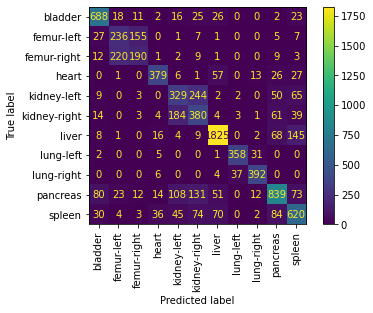

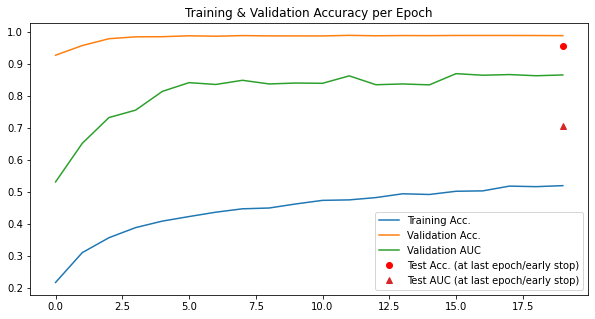

In [148]:
# Runs the classifier again 
clf = run_classifier_pipeline(name_dataset, info_flags, jointVAE_loader)

## 6. Training a Conditional Generative Adversarial Network 

We train a Conditional Generative Adversarial Network Autoencoder for data augmentation for each of the datasets. 

For each dataset, we then retrain the underlying baseline classifier.

In [149]:
# Declares the number of epochs and the model's latent dimensions
latent_dims = 128
epochs = 100

### PathMNIST

#### Training the Conditional GAN

In [150]:
# Declares the dataset name and retrieves the base dataset
name_dataset = "pathmnist"
base_dataset = pathmnist_noWRS_noGDA_upscaled

# Retrieves the dataset parameters
n_classes  = len(info_flags[name_dataset][0]["label"])
n_channels = info_flags[name_dataset][0]["n_channels"]

# Retrieves the data loader
train_loader = base_dataset[3] #####################################################
val_loader = base_dataset[5]   ### OF NOTE #########################################
test_loader = base_dataset[4]  ### EVALUATE/TEST NOT IMPLEMENTED YET IN ############
                               ### TORCHFUSION AT THE TIME OF CREATION OF NOTEBOOK #
                               ### Thus the use of None below in the pipeline ######
                               #####################################################

Path trained_models/conditionalGAN/pathmnist/ created.
Epoch 1 of 100


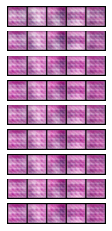

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_1.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_1.pth
Epoch: 1, Duration: 73.13625836372375 , Gen Loss: 4.3723214087292765 Disc Loss: 0.22713244720598694
Epoch 2 of 100


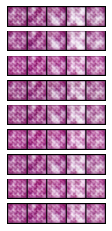

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_2.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_2.pth
Epoch: 2, Duration: 76.37819528579712 , Gen Loss: 5.8603250422240984 Disc Loss: 0.24091704422974355
Epoch 3 of 100


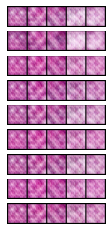

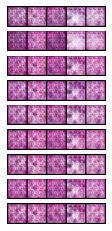

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_3.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_3.pth
Epoch: 3, Duration: 82.10688185691833 , Gen Loss: 2.9838326147828793 Disc Loss: 0.322355819980888
Epoch 4 of 100


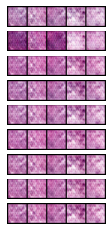

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_4.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_4.pth
Epoch: 4, Duration: 80.1883590221405 , Gen Loss: 2.0987613338370594 Disc Loss: 0.38193225254455754
Epoch 5 of 100


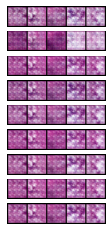

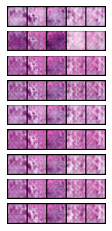

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_5.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_5.pth
Epoch: 5, Duration: 81.7737877368927 , Gen Loss: 2.0129276578959066 Disc Loss: 0.35258633022578784
Epoch 6 of 100


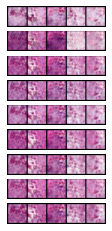

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_6.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_6.pth
Epoch: 6, Duration: 80.3929717540741 , Gen Loss: 1.8979454642428553 Disc Loss: 0.37928387094981997
Epoch 7 of 100


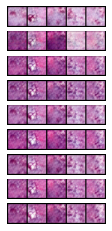

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_7.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_7.pth
Epoch: 7, Duration: 80.39682602882385 , Gen Loss: 1.8312954534090404 Disc Loss: 0.3791274403862394
Epoch 8 of 100


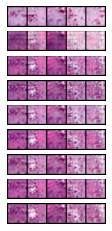

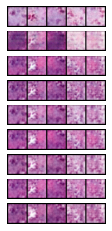

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_8.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_8.pth
Epoch: 8, Duration: 79.21908640861511 , Gen Loss: 1.8894278981843637 Disc Loss: 0.3763504072403218
Epoch 9 of 100


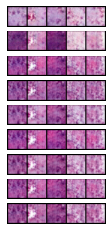

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_9.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_9.pth
Epoch: 9, Duration: 79.69829845428467 , Gen Loss: 1.9364381472509888 Disc Loss: 0.3662305998322148
Epoch 10 of 100


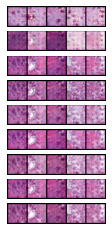

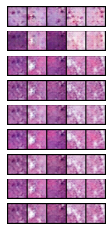

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_10.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_10.pth
Epoch: 10, Duration: 79.48176598548889 , Gen Loss: 1.9201169357527001 Disc Loss: 0.37476791503233475
Epoch 11 of 100


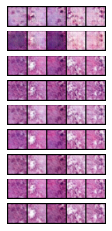

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_11.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_11.pth
Epoch: 11, Duration: 77.06545662879944 , Gen Loss: 1.8664813922285435 Disc Loss: 0.3773238446014267
Epoch 12 of 100


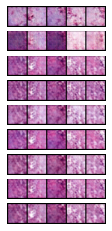

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_12.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_12.pth
Epoch: 12, Duration: 76.03452658653259 , Gen Loss: 1.847985952153429 Disc Loss: 0.38683372906851415
Epoch 13 of 100


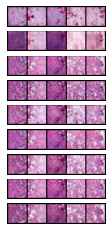

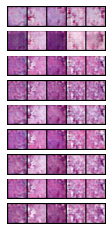

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_13.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_13.pth
Epoch: 13, Duration: 75.75049829483032 , Gen Loss: 1.8311301682852572 Disc Loss: 0.38366835401017824
Epoch 14 of 100


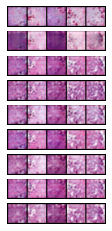

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_14.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_14.pth
Epoch: 14, Duration: 75.84160089492798 , Gen Loss: 1.821821247611005 Disc Loss: 0.3885676602987911
Epoch 15 of 100


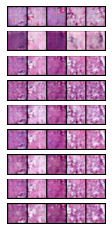

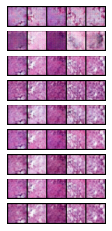

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_15.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_15.pth
Epoch: 15, Duration: 79.85341620445251 , Gen Loss: 1.7981941558513712 Disc Loss: 0.39014654991610737
Epoch 16 of 100


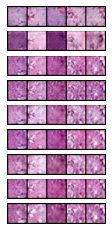

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_16.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_16.pth
Epoch: 16, Duration: 81.37345695495605 , Gen Loss: 1.8002909504311302 Disc Loss: 0.38453249831936975
Epoch 17 of 100


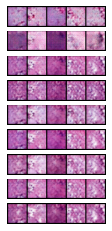

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_17.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_17.pth
Epoch: 17, Duration: 81.5174469947815 , Gen Loss: 1.8536629405751366 Disc Loss: 0.37705556010822705
Epoch 18 of 100


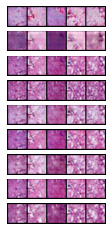

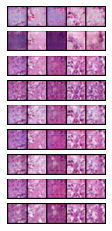

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_18.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_18.pth
Epoch: 18, Duration: 78.15206742286682 , Gen Loss: 1.8425053266256277 Disc Loss: 0.3802986729965776
Epoch 19 of 100


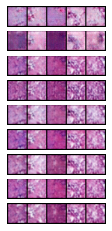

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_19.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_19.pth
Epoch: 19, Duration: 82.2882285118103 , Gen Loss: 1.887419475587804 Disc Loss: 0.37541399409418197
Epoch 20 of 100


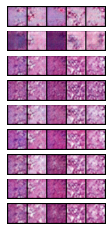

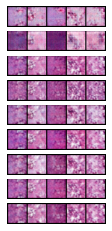

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_20.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_20.pth
Epoch: 20, Duration: 82.77072954177856 , Gen Loss: 1.8965559927663451 Disc Loss: 0.37595368821947645
Epoch 21 of 100


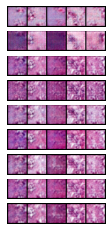

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_21.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_21.pth
Epoch: 21, Duration: 79.44766139984131 , Gen Loss: 1.9196929585759368 Disc Loss: 0.37204040665696253
Epoch 22 of 100


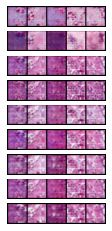

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_22.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_22.pth
Epoch: 22, Duration: 78.46221256256104 , Gen Loss: 1.9552987077203432 Disc Loss: 0.36998992489944
Epoch 23 of 100


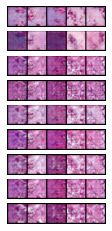

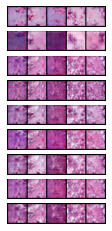

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_23.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_23.pth
Epoch: 23, Duration: 77.82685923576355 , Gen Loss: 1.9839388695053113 Disc Loss: 0.36336371894306413
Epoch 24 of 100


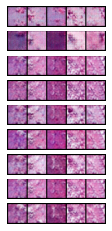

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_24.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_24.pth
Epoch: 24, Duration: 80.15341067314148 , Gen Loss: 2.019970679252411 Disc Loss: 0.3606398131583626
Epoch 25 of 100


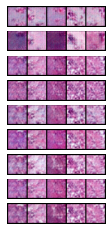

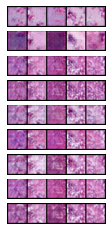

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_25.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_25.pth
Epoch: 25, Duration: 80.69321894645691 , Gen Loss: 2.0717910379350193 Disc Loss: 0.3538171574986666
Epoch 26 of 100


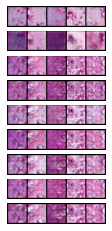

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_26.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_26.pth
Epoch: 26, Duration: 77.84198331832886 , Gen Loss: 2.0687898628827948 Disc Loss: 0.3522241830539691
Epoch 27 of 100


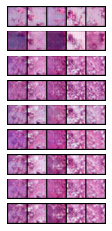

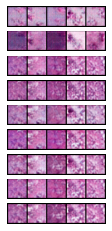

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_27.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_27.pth
Epoch: 27, Duration: 77.44811224937439 , Gen Loss: 2.1179870147006534 Disc Loss: 0.34688293003994625
Epoch 28 of 100


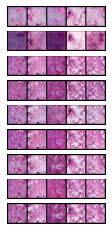

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_28.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_28.pth
Epoch: 28, Duration: 75.3374502658844 , Gen Loss: 2.123623376316725 Disc Loss: 0.3464033297313214
Epoch 29 of 100


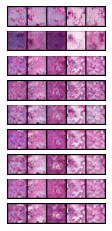

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_29.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_29.pth
Epoch: 29, Duration: 79.56568598747253 , Gen Loss: 2.1126458050913373 Disc Loss: 0.34681382974659986
Epoch 30 of 100


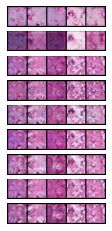

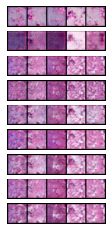

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_30.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_30.pth
Epoch: 30, Duration: 77.53467154502869 , Gen Loss: 2.1267516403506823 Disc Loss: 0.34132819097515443
Epoch 31 of 100


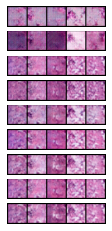

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_31.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_31.pth
Epoch: 31, Duration: 77.47079348564148 , Gen Loss: 2.1313152112316103 Disc Loss: 0.3420868835489911
Epoch 32 of 100


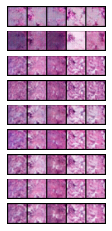

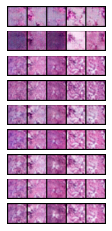

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_32.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_32.pth
Epoch: 32, Duration: 76.06888842582703 , Gen Loss: 2.1897256197497668 Disc Loss: 0.33450082590476243
Epoch 33 of 100


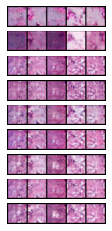

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_33.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_33.pth
Epoch: 33, Duration: 81.91040349006653 , Gen Loss: 2.171943926674519 Disc Loss: 0.3351094250022223
Epoch 34 of 100


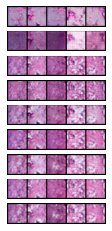

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_34.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_34.pth
Epoch: 34, Duration: 79.20136880874634 , Gen Loss: 2.1815974807213654 Disc Loss: 0.3340494820603138
Epoch 35 of 100


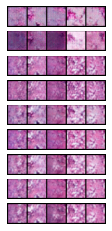

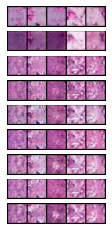

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_35.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_35.pth
Epoch: 35, Duration: 79.78993391990662 , Gen Loss: 2.1504771739855104 Disc Loss: 0.3383559017553558
Epoch 36 of 100


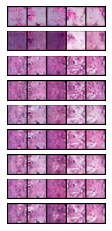

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_36.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_36.pth
Epoch: 36, Duration: 80.2011308670044 , Gen Loss: 2.131105132450331 Disc Loss: 0.3389560803396818
Epoch 37 of 100


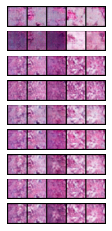

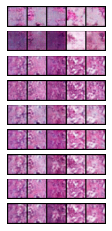

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_37.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_37.pth
Epoch: 37, Duration: 78.79126453399658 , Gen Loss: 2.1239872813791725 Disc Loss: 0.3439323865782924
Epoch 38 of 100


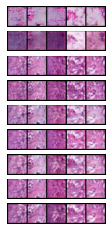

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_38.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_38.pth
Epoch: 38, Duration: 77.82822608947754 , Gen Loss: 2.101718756944753 Disc Loss: 0.34438874366638517
Epoch 39 of 100


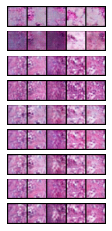

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_39.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_39.pth
Epoch: 39, Duration: 77.73205065727234 , Gen Loss: 2.094667228265701 Disc Loss: 0.34821686519400863
Epoch 40 of 100


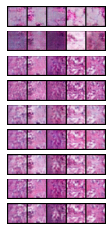

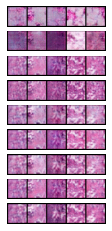

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_40.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_40.pth
Epoch: 40, Duration: 79.57152533531189 , Gen Loss: 2.1046119410862705 Disc Loss: 0.3479582816527957
Epoch 41 of 100


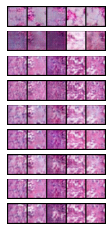

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_41.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_41.pth
Epoch: 41, Duration: 77.37190961837769 , Gen Loss: 2.108429645484244 Disc Loss: 0.3482567975243344
Epoch 42 of 100


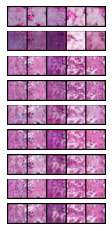

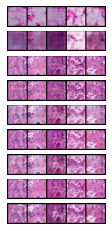

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_42.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_42.pth
Epoch: 42, Duration: 79.17552924156189 , Gen Loss: 2.0957806458064803 Disc Loss: 0.3481526479301858
Epoch 43 of 100


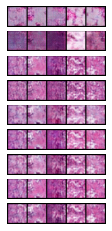

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_43.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_43.pth
Epoch: 43, Duration: 79.02764654159546 , Gen Loss: 2.102132316991866 Disc Loss: 0.3491364156115272
Epoch 44 of 100


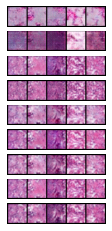

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_44.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_44.pth
Epoch: 44, Duration: 73.28761076927185 , Gen Loss: 2.079108550657807 Disc Loss: 0.34709910718254144
Epoch 45 of 100


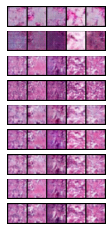

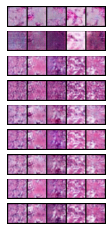

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_45.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_45.pth
Epoch: 45, Duration: 73.79657077789307 , Gen Loss: 2.1005846787635005 Disc Loss: 0.3461507360396573
Epoch 46 of 100


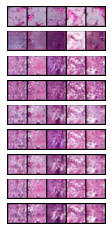

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_46.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_46.pth
Epoch: 46, Duration: 73.32592153549194 , Gen Loss: 2.059379722432108 Disc Loss: 0.34849719449336636
Epoch 47 of 100


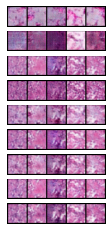

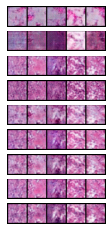

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_47.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_47.pth
Epoch: 47, Duration: 73.53268957138062 , Gen Loss: 2.068696455953598 Disc Loss: 0.34740734570842036
Epoch 48 of 100


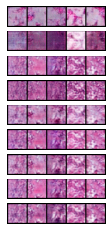

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_48.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_48.pth
Epoch: 48, Duration: 72.53867077827454 , Gen Loss: 2.078555748311036 Disc Loss: 0.3487222913032246
Epoch 49 of 100


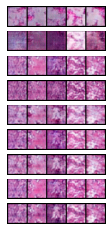

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_49.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_49.pth
Epoch: 49, Duration: 73.34341478347778 , Gen Loss: 2.0638582200875595 Disc Loss: 0.34859765468743054
Epoch 50 of 100


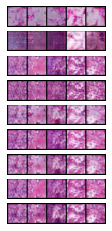

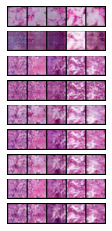

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_50.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_50.pth
Epoch: 50, Duration: 73.83191466331482 , Gen Loss: 2.0609349998888837 Disc Loss: 0.3441018168515823
Epoch 51 of 100


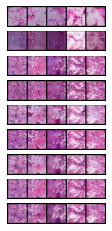

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_51.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_51.pth
Epoch: 51, Duration: 73.89675545692444 , Gen Loss: 2.0810444005844704 Disc Loss: 0.3454837576114494
Epoch 52 of 100


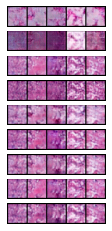

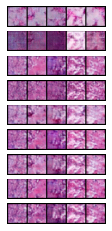

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_52.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_52.pth
Epoch: 52, Duration: 74.15387964248657 , Gen Loss: 2.0718825350571137 Disc Loss: 0.35264062951408953
Epoch 53 of 100


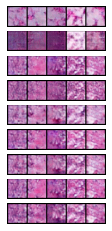

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_53.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_53.pth
Epoch: 53, Duration: 73.39813256263733 , Gen Loss: 2.03794283218143 Disc Loss: 0.35954466899917775
Epoch 54 of 100


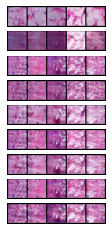

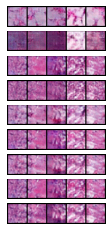

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_54.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_54.pth
Epoch: 54, Duration: 74.19278645515442 , Gen Loss: 2.06136852610116 Disc Loss: 0.36117184635289346
Epoch 55 of 100


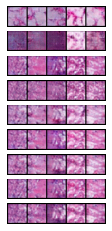

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_55.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_55.pth
Epoch: 55, Duration: 73.36512899398804 , Gen Loss: 2.035750200008889 Disc Loss: 0.3596703256255834
Epoch 56 of 100


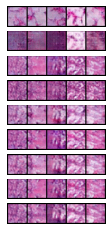

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_56.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_56.pth
Epoch: 56, Duration: 73.69678449630737 , Gen Loss: 2.0377115719031957 Disc Loss: 0.3684668971398729
Epoch 57 of 100


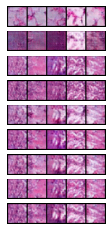

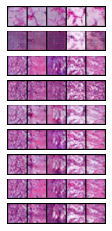

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_57.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_57.pth
Epoch: 57, Duration: 74.38864874839783 , Gen Loss: 1.9959591954086848 Disc Loss: 0.3724788376011156
Epoch 58 of 100


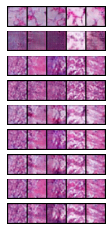

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_58.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_58.pth
Epoch: 58, Duration: 73.24604630470276 , Gen Loss: 1.9991525665029557 Disc Loss: 0.37533104769934217
Epoch 59 of 100


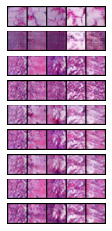

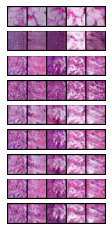

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_59.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_59.pth
Epoch: 59, Duration: 75.0735719203949 , Gen Loss: 1.9811175635583804 Disc Loss: 0.37564972505722477
Epoch 60 of 100


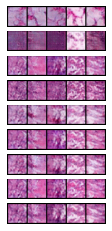

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_60.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_60.pth
Epoch: 60, Duration: 74.42925429344177 , Gen Loss: 1.9508146542624116 Disc Loss: 0.38251700075558914
Epoch 61 of 100


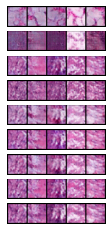

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_61.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_61.pth
Epoch: 61, Duration: 86.85459113121033 , Gen Loss: 1.9337666743521935 Disc Loss: 0.387941113355038
Epoch 62 of 100


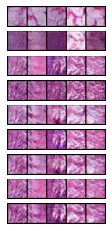

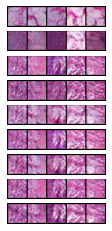

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_62.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_62.pth
Epoch: 62, Duration: 90.78564739227295 , Gen Loss: 1.9238454000733365 Disc Loss: 0.3899834350276679
Epoch 63 of 100


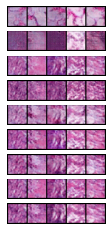

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_63.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_63.pth
Epoch: 63, Duration: 82.97166776657104 , Gen Loss: 1.8889504464087292 Disc Loss: 0.3923831944614205
Epoch 64 of 100


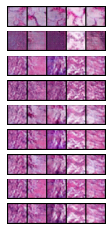

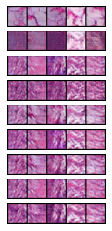

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_64.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_64.pth
Epoch: 64, Duration: 86.91158890724182 , Gen Loss: 1.8589055346904306 Disc Loss: 0.39609807310880485
Epoch 65 of 100


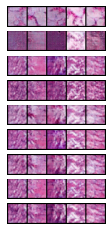

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_65.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_65.pth
Epoch: 65, Duration: 86.41960191726685 , Gen Loss: 1.8580225093337481 Disc Loss: 0.39634048839670655
Epoch 66 of 100


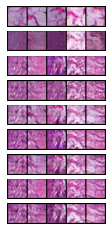

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_66.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_66.pth
Epoch: 66, Duration: 82.50853252410889 , Gen Loss: 1.8618947300435575 Disc Loss: 0.39959093668051915
Epoch 67 of 100


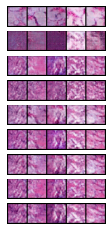

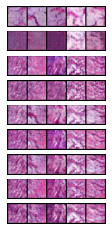

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_67.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_67.pth
Epoch: 67, Duration: 84.91573166847229 , Gen Loss: 1.8270454381305836 Disc Loss: 0.40489972297379884
Epoch 68 of 100


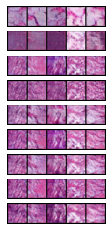

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_68.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_68.pth
Epoch: 68, Duration: 75.60672116279602 , Gen Loss: 1.831299099404418 Disc Loss: 0.40153972120983156
Epoch 69 of 100


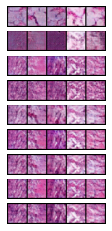

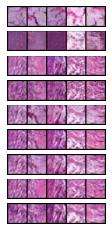

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_69.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_69.pth
Epoch: 69, Duration: 83.53291153907776 , Gen Loss: 1.799949789435086 Disc Loss: 0.4082664958720388
Epoch 70 of 100


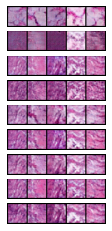

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_70.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_70.pth
Epoch: 70, Duration: 86.76342439651489 , Gen Loss: 1.765198418540824 Disc Loss: 0.41475610721587625
Epoch 71 of 100


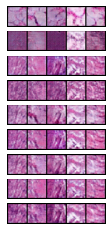

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_71.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_71.pth
Epoch: 71, Duration: 85.08526659011841 , Gen Loss: 1.7813989649539979 Disc Loss: 0.4111797329881328
Epoch 72 of 100


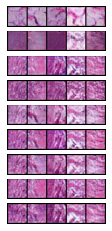

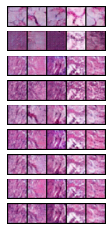

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_72.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_72.pth
Epoch: 72, Duration: 81.37119436264038 , Gen Loss: 1.8199038012800568 Disc Loss: 0.4060095379239077
Epoch 73 of 100


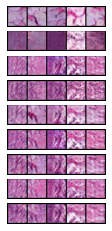

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_73.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_73.pth
Epoch: 73, Duration: 80.59167671203613 , Gen Loss: 1.7643122680452465 Disc Loss: 0.41432383974009956
Epoch 74 of 100


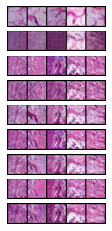

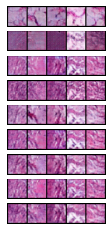

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_74.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_74.pth
Epoch: 74, Duration: 83.46123003959656 , Gen Loss: 1.7494142100760033 Disc Loss: 0.41981501261167165
Epoch 75 of 100


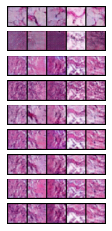

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_75.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_75.pth
Epoch: 75, Duration: 80.0831356048584 , Gen Loss: 1.7370591470732033 Disc Loss: 0.4196891823664385
Epoch 76 of 100


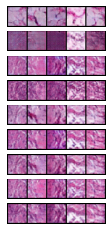

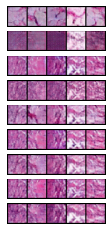

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_76.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_76.pth
Epoch: 76, Duration: 82.2480697631836 , Gen Loss: 1.7566362324436642 Disc Loss: 0.4151130241205165
Epoch 77 of 100


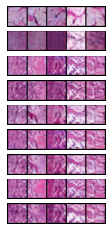

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_77.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_77.pth
Epoch: 77, Duration: 83.25059914588928 , Gen Loss: 1.7481830789701764 Disc Loss: 0.4233360024334415
Epoch 78 of 100


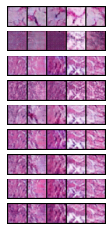

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_78.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_78.pth
Epoch: 78, Duration: 80.65781712532043 , Gen Loss: 1.7148097207098094 Disc Loss: 0.42565910915485133
Epoch 79 of 100


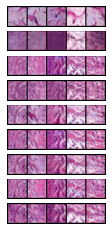

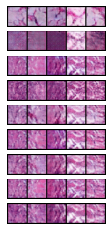

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_79.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_79.pth
Epoch: 79, Duration: 82.46887159347534 , Gen Loss: 1.6908886922752122 Disc Loss: 0.4304914419807547
Epoch 80 of 100


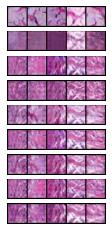

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_80.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_80.pth
Epoch: 80, Duration: 82.44063377380371 , Gen Loss: 1.6966571778190143 Disc Loss: 0.4286776460898262
Epoch 81 of 100


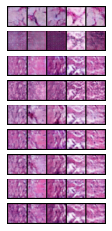

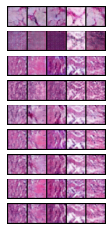

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_81.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_81.pth
Epoch: 81, Duration: 79.36345767974854 , Gen Loss: 1.6739013053357927 Disc Loss: 0.43439621622072094
Epoch 82 of 100


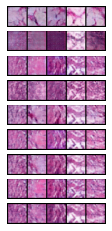

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_82.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_82.pth
Epoch: 82, Duration: 79.78855657577515 , Gen Loss: 1.657582871738744 Disc Loss: 0.43558112131372506
Epoch 83 of 100


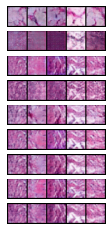

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_83.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_83.pth
Epoch: 83, Duration: 79.62340116500854 , Gen Loss: 1.66847571697631 Disc Loss: 0.43451050081392506
Epoch 84 of 100


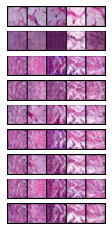

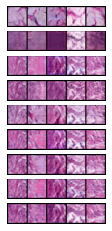

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_84.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_84.pth
Epoch: 84, Duration: 79.80562043190002 , Gen Loss: 1.6773978149028845 Disc Loss: 0.4334895787034979
Epoch 85 of 100


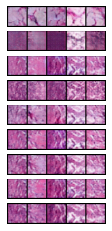

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_85.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_85.pth
Epoch: 85, Duration: 79.16110563278198 , Gen Loss: 1.6528331814747321 Disc Loss: 0.43649869681708076
Epoch 86 of 100


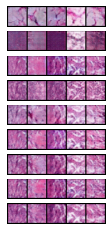

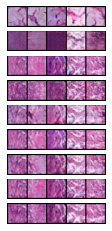

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_86.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_86.pth
Epoch: 86, Duration: 79.60576462745667 , Gen Loss: 1.6323642161873861 Disc Loss: 0.44236440890428463
Epoch 87 of 100


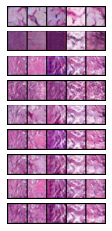

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_87.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_87.pth
Epoch: 87, Duration: 80.36381649971008 , Gen Loss: 1.62827063147251 Disc Loss: 0.439509768142473
Epoch 88 of 100


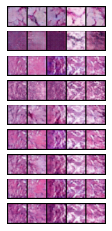

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_88.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_88.pth
Epoch: 88, Duration: 78.93173909187317 , Gen Loss: 1.605823279645762 Disc Loss: 0.4450344928524601
Epoch 89 of 100


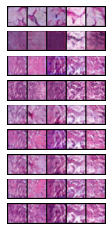

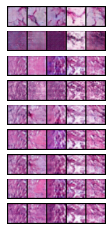

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_89.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_89.pth
Epoch: 89, Duration: 79.19365191459656 , Gen Loss: 1.5963884853215697 Disc Loss: 0.45029058583159254
Epoch 90 of 100


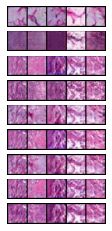

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_90.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_90.pth
Epoch: 90, Duration: 78.86764025688171 , Gen Loss: 1.6018755347459888 Disc Loss: 0.4479790681669185
Epoch 91 of 100


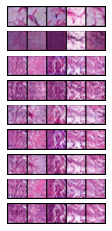

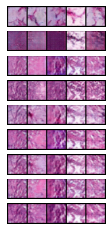

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_91.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_91.pth
Epoch: 91, Duration: 81.2136218547821 , Gen Loss: 1.5995835926041158 Disc Loss: 0.45051290474021066
Epoch 92 of 100


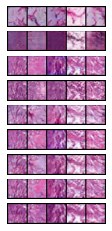

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_92.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_92.pth
Epoch: 92, Duration: 78.96638655662537 , Gen Loss: 1.5998252700120006 Disc Loss: 0.4479080146617627
Epoch 93 of 100


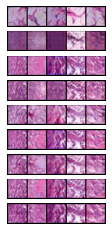

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_93.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_93.pth
Epoch: 93, Duration: 79.74821209907532 , Gen Loss: 1.566253812669452 Disc Loss: 0.45241081895306456
Epoch 94 of 100


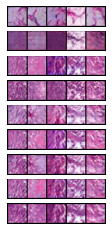

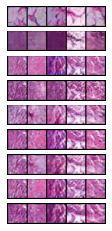

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_94.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_94.pth
Epoch: 94, Duration: 79.5668375492096 , Gen Loss: 1.5430838592826348 Disc Loss: 0.4564657734788213
Epoch 95 of 100


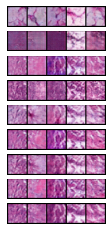

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_95.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_95.pth
Epoch: 95, Duration: 84.39168357849121 , Gen Loss: 1.574277085926041 Disc Loss: 0.45488189232021425
Epoch 96 of 100


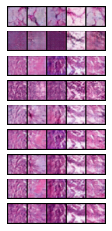

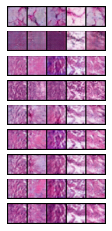

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_96.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_96.pth
Epoch: 96, Duration: 80.86964392662048 , Gen Loss: 1.5215808202586782 Disc Loss: 0.4636483409679319
Epoch 97 of 100


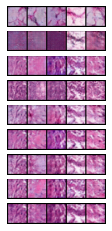

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_97.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_97.pth
Epoch: 97, Duration: 82.99763870239258 , Gen Loss: 1.5316633864282858 Disc Loss: 0.458285776242833
Epoch 98 of 100


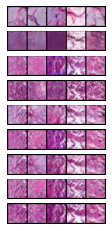

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_98.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_98.pth
Epoch: 98, Duration: 85.85849380493164 , Gen Loss: 1.5267852182319215 Disc Loss: 0.4587268982788124
Epoch 99 of 100


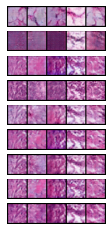

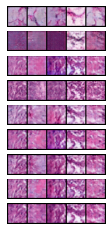

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_99.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_99.pth
Epoch: 99, Duration: 84.81401777267456 , Gen Loss: 1.5396271084270412 Disc Loss: 0.4563569578786835
Epoch 100 of 100


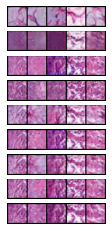

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_100.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_100.pth
Epoch: 100, Duration: 81.83354353904724 , Gen Loss: 1.5148647231543624 Disc Loss: 0.4608691809913774


In [151]:
# Runs the Cond GAN
run_GAN_pipeline(
    train_loader, None, None, #val_loader, test_loader, 
    n_channels, latent_dims, n_classes,
    epochs=epochs, name_dataset=name_dataset
)

#### Generating an upgraded dataset without Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [152]:
# Removes saved intermediary models
model_path = f"trained_models/conditionalGAN/{name_dataset}/gen_models/"
models = [x for x in os.listdir(model_path) 
          if x[-(4+len(str(epochs))):]!=f"{epochs}.pth"]
for model in models:
    os.remove(model_path+model)
# Fetches the generated GAN Model model to import
model_path += f"gen_model_{epochs}.pth"

# Calculates the number of images to generate
percentage = 4
nb_images_in_dataset = len(base_dataset[0])
n_generated_images = int((percentage/100)*nb_images_in_dataset)
print(f"Number of generated images: {n_generated_images}",
      f"({percentage}% of the dataset)")

# Creates the augmented dataloader
condGAN_loader = generate_augmented_dataset_condGAN(
    n_channels, n_classes, latent_dims, model_path,
    base_dataset[0], 64, 
    test_loader, val_loader, n_generated_images,
    weighted_sampling=False
)

Number of generated images: 3599 (4% of the dataset)


2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "PathMNIST",
  "description": "The PathMNIST is based on a prior study for predicting survival from colorectal cancer histology slides, providing a dataset (NCT-CRC-HE-100K) of 100,000 non-overlapping image patches from hematoxylin & eosin stained histological images, and a test dataset (CRC-VAL-HE-7K) of 7,180 image patches from a different clinical center. The dataset is comprised of 9 types of tissues, resulting in a multi-class classification task. We resize the source images of 3\u00d7224\u00d7224 into 3\u00d728\u00d728, and split NCT-CRC-HE-100K into training and validation set with a ratio of 9:1. The CRC-VAL-HE-7K is treated as the test set.",
  "url": "https://zenodo.org/record/5208230/files/pathmnist.npz?download=1",
  "MD5": "a8b06965200029087d5bd730944a56c1",
  "task": "multi-class",
  "label": {
    "0": "adipose",
    "1": "background",
    "2": "debris",
    "3": "lymphocytes",
    "4": "mucus",
    "5": "smooth muscle",
    "6": "normal colon mucosa"

100%|███████████████████████████████████████| 1463/1463 [00:16<00:00, 90.33it/s]


train -- accuracy: 0.68
val -- accuracy: 0.98,  AUC: 0.8
Epoch 1



100%|███████████████████████████████████████| 1463/1463 [00:15<00:00, 91.62it/s]


train -- accuracy: 0.83
val -- accuracy: 0.98,  AUC: 0.82
Epoch 2



100%|███████████████████████████████████████| 1463/1463 [00:16<00:00, 87.55it/s]


train -- accuracy: 0.87
val -- accuracy: 0.99,  AUC: 0.87
Epoch 3



100%|███████████████████████████████████████| 1463/1463 [00:16<00:00, 88.96it/s]


train -- accuracy: 0.89
val -- accuracy: 0.99,  AUC: 0.85
Epoch 4



100%|███████████████████████████████████████| 1463/1463 [00:15<00:00, 91.61it/s]


train -- accuracy: 0.9
val -- accuracy: 0.99,  AUC: 0.9
Epoch 5



100%|███████████████████████████████████████| 1463/1463 [00:15<00:00, 92.12it/s]


train -- accuracy: 0.91
val -- accuracy: 0.99,  AUC: 0.92
Epoch 6



100%|███████████████████████████████████████| 1463/1463 [00:15<00:00, 92.10it/s]


train -- accuracy: 0.92
val -- accuracy: 1.0,  AUC: 0.92
Epoch 7



100%|███████████████████████████████████████| 1463/1463 [00:16<00:00, 88.40it/s]


train -- accuracy: 0.93
val -- accuracy: 1.0,  AUC: 0.93
Epoch 8



100%|███████████████████████████████████████| 1463/1463 [00:15<00:00, 95.66it/s]


train -- accuracy: 0.93
val -- accuracy: 1.0,  AUC: 0.93
Epoch 9



100%|███████████████████████████████████████| 1463/1463 [00:15<00:00, 97.41it/s]


train -- accuracy: 0.94
val -- accuracy: 1.0,  AUC: 0.93
Epoch 10



100%|███████████████████████████████████████| 1463/1463 [00:15<00:00, 91.99it/s]


train -- accuracy: 0.94
val -- accuracy: 1.0,  AUC: 0.93
Epoch 11



100%|███████████████████████████████████████| 1463/1463 [00:15<00:00, 92.21it/s]


train -- accuracy: 0.95
val -- accuracy: 1.0,  AUC: 0.94
Epoch 12



100%|███████████████████████████████████████| 1463/1463 [00:15<00:00, 93.18it/s]


train -- accuracy: 0.95
val -- accuracy: 1.0,  AUC: 0.94
Epoch 13



100%|███████████████████████████████████████| 1463/1463 [00:15<00:00, 93.09it/s]


train -- accuracy: 0.95
val -- accuracy: 1.0,  AUC: 0.93
Epoch 14



100%|███████████████████████████████████████| 1463/1463 [00:15<00:00, 93.32it/s]


train -- accuracy: 0.96
val -- accuracy: 1.0,  AUC: 0.95
Epoch 15



100%|███████████████████████████████████████| 1463/1463 [00:15<00:00, 93.42it/s]


train -- accuracy: 0.96
val -- accuracy: 1.0,  AUC: 0.94
Epoch 16



100%|███████████████████████████████████████| 1463/1463 [00:15<00:00, 93.75it/s]


train -- accuracy: 0.96
val -- accuracy: 1.0,  AUC: 0.92
Epoch 17



100%|███████████████████████████████████████| 1463/1463 [00:15<00:00, 93.58it/s]


train -- accuracy: 0.96
val -- accuracy: 1.0,  AUC: 0.94
Epoch 18



100%|███████████████████████████████████████| 1463/1463 [00:16<00:00, 89.21it/s]


train -- accuracy: 0.97
val -- accuracy: 1.0,  AUC: 0.93
Epoch 19



100%|███████████████████████████████████████| 1463/1463 [00:16<00:00, 88.83it/s]


train -- accuracy: 0.97
val -- accuracy: 1.0,  AUC: 0.95
test -- accuracy: 0.97,  AUC: 0.85


<Figure size 720x720 with 0 Axes>

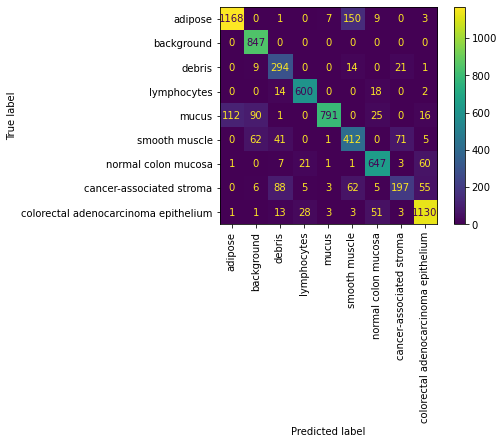

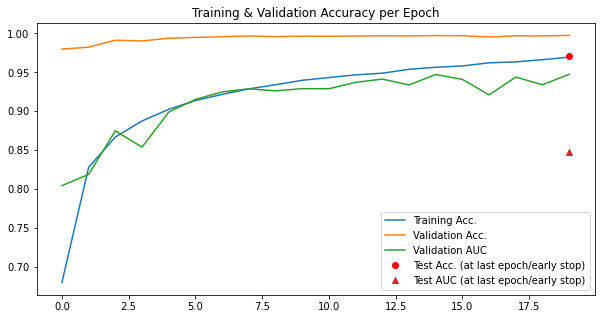

In [153]:
# Runs the classifier again 

clf = run_classifier_pipeline(name_dataset, info_flags, condGAN_loader)

#### Generating an upgraded dataset with Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [154]:
# Creates the augmented dataloader
condGAN_loader = generate_augmented_dataset_condGAN(
    n_channels, n_classes, latent_dims, model_path,
    base_dataset[0], 64, 
    test_loader, val_loader, n_generated_images,
    weighted_sampling=True
)

2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "PathMNIST",
  "description": "The PathMNIST is based on a prior study for predicting survival from colorectal cancer histology slides, providing a dataset (NCT-CRC-HE-100K) of 100,000 non-overlapping image patches from hematoxylin & eosin stained histological images, and a test dataset (CRC-VAL-HE-7K) of 7,180 image patches from a different clinical center. The dataset is comprised of 9 types of tissues, resulting in a multi-class classification task. We resize the source images of 3\u00d7224\u00d7224 into 3\u00d728\u00d728, and split NCT-CRC-HE-100K into training and validation set with a ratio of 9:1. The CRC-VAL-HE-7K is treated as the test set.",
  "url": "https://zenodo.org/record/5208230/files/pathmnist.npz?download=1",
  "MD5": "a8b06965200029087d5bd730944a56c1",
  "task": "multi-class",
  "label": {
    "0": "adipose",
    "1": "background",
    "2": "debris",
    "3": "lymphocytes",
    "4": "mucus",
    "5": "smooth muscle",
    "6": "normal colon mucosa"

100%|███████████████████████████████████████| 1463/1463 [00:15<00:00, 93.68it/s]


train -- accuracy: 0.67
val -- accuracy: 0.98,  AUC: 0.76
Epoch 1



100%|███████████████████████████████████████| 1463/1463 [00:15<00:00, 93.81it/s]


train -- accuracy: 0.82
val -- accuracy: 0.99,  AUC: 0.83
Epoch 2



100%|███████████████████████████████████████| 1463/1463 [00:15<00:00, 93.54it/s]


train -- accuracy: 0.86
val -- accuracy: 0.99,  AUC: 0.87
Epoch 3



100%|███████████████████████████████████████| 1463/1463 [00:15<00:00, 93.22it/s]


train -- accuracy: 0.89
val -- accuracy: 0.99,  AUC: 0.86
Epoch 4



100%|███████████████████████████████████████| 1463/1463 [00:15<00:00, 93.90it/s]


train -- accuracy: 0.9
val -- accuracy: 0.99,  AUC: 0.9
Epoch 5



100%|███████████████████████████████████████| 1463/1463 [00:15<00:00, 93.82it/s]


train -- accuracy: 0.91
val -- accuracy: 0.99,  AUC: 0.9
Epoch 6



100%|███████████████████████████████████████| 1463/1463 [00:15<00:00, 93.79it/s]


train -- accuracy: 0.92
val -- accuracy: 0.98,  AUC: 0.8
Epoch 7



100%|███████████████████████████████████████| 1463/1463 [00:15<00:00, 93.76it/s]


train -- accuracy: 0.93
val -- accuracy: 0.99,  AUC: 0.91
Epoch 8



100%|███████████████████████████████████████| 1463/1463 [00:15<00:00, 93.58it/s]


train -- accuracy: 0.93
val -- accuracy: 0.99,  AUC: 0.86
Epoch 9



100%|███████████████████████████████████████| 1463/1463 [00:15<00:00, 93.50it/s]


train -- accuracy: 0.94
val -- accuracy: 1.0,  AUC: 0.93
Epoch 10



100%|███████████████████████████████████████| 1463/1463 [00:15<00:00, 94.14it/s]


train -- accuracy: 0.94
val -- accuracy: 1.0,  AUC: 0.92
Epoch 11



100%|███████████████████████████████████████| 1463/1463 [00:15<00:00, 94.02it/s]


train -- accuracy: 0.95
val -- accuracy: 1.0,  AUC: 0.94
Epoch 12



100%|███████████████████████████████████████| 1463/1463 [00:15<00:00, 94.17it/s]


train -- accuracy: 0.95
val -- accuracy: 1.0,  AUC: 0.92
Epoch 13



100%|███████████████████████████████████████| 1463/1463 [00:15<00:00, 94.22it/s]


train -- accuracy: 0.95
val -- accuracy: 1.0,  AUC: 0.94
Epoch 14



100%|███████████████████████████████████████| 1463/1463 [00:15<00:00, 94.16it/s]


train -- accuracy: 0.96
val -- accuracy: 1.0,  AUC: 0.94
Epoch 15



100%|███████████████████████████████████████| 1463/1463 [00:15<00:00, 94.67it/s]


train -- accuracy: 0.96
val -- accuracy: 1.0,  AUC: 0.92
Epoch 16



100%|███████████████████████████████████████| 1463/1463 [00:15<00:00, 94.08it/s]


train -- accuracy: 0.96
val -- accuracy: 0.99,  AUC: 0.89
Epoch 17



100%|███████████████████████████████████████| 1463/1463 [00:15<00:00, 94.61it/s]


train -- accuracy: 0.96
val -- accuracy: 1.0,  AUC: 0.94
Epoch 18



100%|███████████████████████████████████████| 1463/1463 [00:15<00:00, 94.05it/s]


train -- accuracy: 0.97
val -- accuracy: 1.0,  AUC: 0.94
Epoch 19



100%|███████████████████████████████████████| 1463/1463 [00:15<00:00, 95.29it/s]


train -- accuracy: 0.97
val -- accuracy: 1.0,  AUC: 0.94
test -- accuracy: 0.97,  AUC: 0.86


<Figure size 720x720 with 0 Axes>

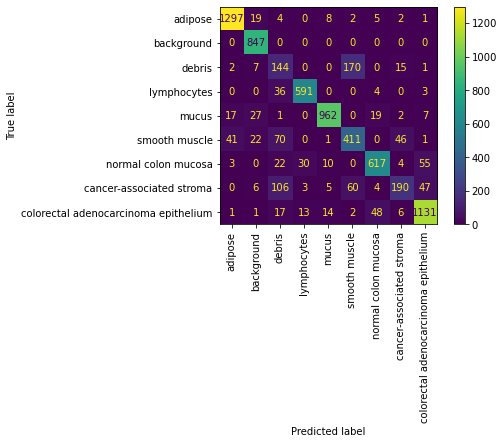

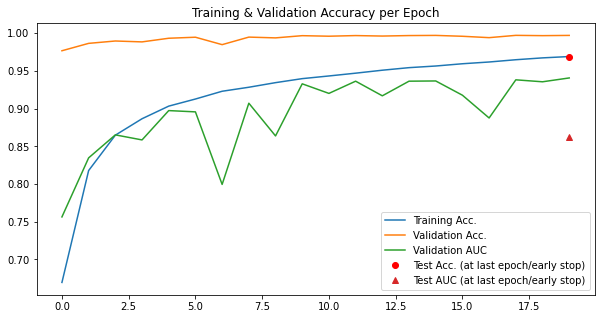

In [155]:
# Runs the classifier again 

clf = run_classifier_pipeline(name_dataset, info_flags, condGAN_loader)

### DermaMNIST

#### Training the Conditional GAN

In [164]:
# Declares the dataset name and retrieves the base dataset
name_dataset = "dermamnist"
base_dataset = dermamnist_noWRS_noGDA_upscaled

# Retrieves the dataset parameters
n_classes  = len(info_flags[name_dataset][0]["label"])
n_channels = info_flags[name_dataset][0]["n_channels"]

# Retrieves the data loader
train_loader = base_dataset[3] #####################################################
val_loader = base_dataset[5]   ### OF NOTE #########################################
test_loader = base_dataset[4]  ### EVALUATE/TEST NOT IMPLEMENTED YET IN ############
                               ### TORCHFUSION AT THE TIME OF CREATION OF NOTEBOOK #
                               ### Thus the use of None below in the pipeline ######
                               #####################################################

Path trained_models/conditionalGAN/dermamnist/ created.
Epoch 1 of 100
New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_1.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_1.pth
Epoch: 1, Duration: 6.914281368255615 , Gen Loss: 2.03008013192165 Disc Loss: 0.26472132777936347
Epoch 2 of 100
New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_2.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_2.pth
Epoch: 2, Duration: 6.1795244216918945 , Gen Loss: 3.2374999442521766 Disc Loss: 0.13495714490587538
Epoch 3 of 100
New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_3.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_3.pth
Epoch: 3, Duration: 6.099104166030884 , Gen Loss: 2.0231548585343226 Disc Loss: 0.34889737076539534


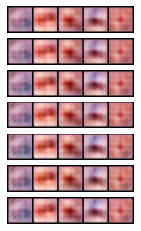

New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_10.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_10.pth
Epoch: 10, Duration: 6.488825559616089 , Gen Loss: 1.5966739733480806 Disc Loss: 0.41082177448667406
Epoch 11 of 100
New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_11.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_11.pth
Epoch: 11, Duration: 6.611282110214233 , Gen Loss: 1.5291342307246325 Disc Loss: 0.40724042977112174
Epoch 12 of 100
New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_12.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_12.pth
Epoch: 12, Duration: 7.061625957489014 , Gen Loss: 1.5168814165744968 Disc Loss: 0.4194342209130156
Epoch 13 of 100
New Generator model saved at trained_models/

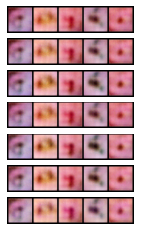

New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_19.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_19.pth
Epoch: 19, Duration: 7.053448915481567 , Gen Loss: 1.6185389666137433 Disc Loss: 0.42359419319519764
Epoch 20 of 100
New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_20.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_20.pth
Epoch: 20, Duration: 6.690417766571045 , Gen Loss: 1.56384630994006 Disc Loss: 0.43282223496369704
Epoch 21 of 100
New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_21.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_21.pth
Epoch: 21, Duration: 6.224534273147583 , Gen Loss: 1.6288765642839305 Disc Loss: 0.41593949437838945
Epoch 22 of 100
New Generator model saved at trained_models/c

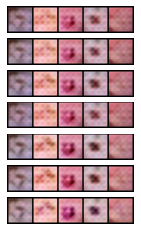

New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_28.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_28.pth
Epoch: 28, Duration: 6.949438095092773 , Gen Loss: 1.3728794921596261 Disc Loss: 0.483404221336699
Epoch 29 of 100
New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_29.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_29.pth
Epoch: 29, Duration: 6.406429052352905 , Gen Loss: 1.3868607675806337 Disc Loss: 0.47929236639476597
Epoch 30 of 100
New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_30.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_30.pth
Epoch: 30, Duration: 6.562816381454468 , Gen Loss: 1.3219151105590838 Disc Loss: 0.4945901963549843
Epoch 31 of 100
New Generator model saved at trained_models/co

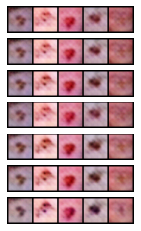

New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_37.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_37.pth
Epoch: 37, Duration: 6.624948024749756 , Gen Loss: 1.2671899807781504 Disc Loss: 0.5030660257711039
Epoch 38 of 100
New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_38.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_38.pth
Epoch: 38, Duration: 5.983748435974121 , Gen Loss: 1.2933762665905524 Disc Loss: 0.5049806499304267
Epoch 39 of 100
New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_39.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_39.pth
Epoch: 39, Duration: 6.150897741317749 , Gen Loss: 1.2857363061046096 Disc Loss: 0.49972021561028257
Epoch 40 of 100
New Generator model saved at trained_models/c

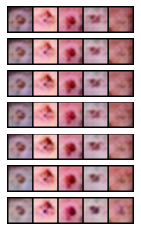

New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_46.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_46.pth
Epoch: 46, Duration: 6.4899396896362305 , Gen Loss: 1.2842255400849152 Disc Loss: 0.5114919957274868
Epoch 47 of 100
New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_47.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_47.pth
Epoch: 47, Duration: 6.091795921325684 , Gen Loss: 1.2795351969459112 Disc Loss: 0.5235926183191808
Epoch 48 of 100
New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_48.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_48.pth
Epoch: 48, Duration: 6.316291093826294 , Gen Loss: 1.2593575509312116 Disc Loss: 0.5503696916922364
Epoch 49 of 100
New Generator model saved at trained_models/c

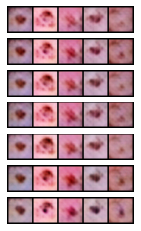

New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_55.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_55.pth
Epoch: 55, Duration: 6.363499641418457 , Gen Loss: 1.1938176221100327 Disc Loss: 0.5352264922577422
Epoch 56 of 100
New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_56.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_56.pth
Epoch: 56, Duration: 6.1840784549713135 , Gen Loss: 1.2038688153364492 Disc Loss: 0.5311120589789675
Epoch 57 of 100
New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_57.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_57.pth
Epoch: 57, Duration: 6.048892021179199 , Gen Loss: 1.2057700948604966 Disc Loss: 0.5276530110514486
Epoch 58 of 100
New Generator model saved at trained_models/c

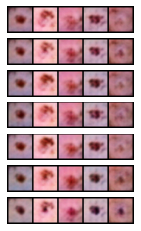

New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_64.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_64.pth
Epoch: 64, Duration: 6.537227392196655 , Gen Loss: 1.2946017431229484 Disc Loss: 0.5214653510551948
Epoch 65 of 100
New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_65.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_65.pth
Epoch: 65, Duration: 6.283690690994263 , Gen Loss: 1.2942954088322391 Disc Loss: 0.5218106739800378
Epoch 66 of 100
New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_66.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_66.pth
Epoch: 66, Duration: 6.363704204559326 , Gen Loss: 1.2869231772691594 Disc Loss: 0.5149863389958256
Epoch 67 of 100
New Generator model saved at trained_models/co

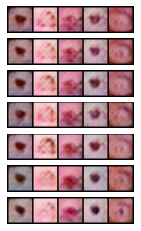

New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_73.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_73.pth
Epoch: 73, Duration: 6.514411687850952 , Gen Loss: 1.2636021902204937 Disc Loss: 0.49896305563855786
Epoch 74 of 100
New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_74.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_74.pth
Epoch: 74, Duration: 6.207046985626221 , Gen Loss: 1.3365956030576567 Disc Loss: 0.49216763983784073
Epoch 75 of 100
New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_75.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_75.pth
Epoch: 75, Duration: 6.311459064483643 , Gen Loss: 1.356400992980234 Disc Loss: 0.5078212802822177
Epoch 76 of 100
New Generator model saved at trained_models/c

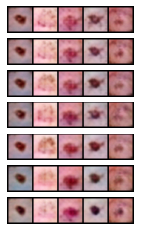

New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_82.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_82.pth
Epoch: 82, Duration: 6.497299671173096 , Gen Loss: 1.3588108320251178 Disc Loss: 0.5076967535812402
Epoch 83 of 100
New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_83.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_83.pth
Epoch: 83, Duration: 6.399780511856079 , Gen Loss: 1.3747331072944913 Disc Loss: 0.4947516559891002
Epoch 84 of 100
New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_84.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_84.pth
Epoch: 84, Duration: 6.0542731285095215 , Gen Loss: 1.3656407766340801 Disc Loss: 0.4879739401223776
Epoch 85 of 100
New Generator model saved at trained_models/c

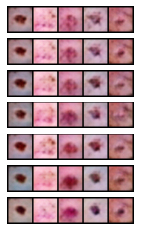

New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_91.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_91.pth
Epoch: 91, Duration: 6.388499736785889 , Gen Loss: 1.388649436500999 Disc Loss: 0.4961999147615777
Epoch 92 of 100
New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_92.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_92.pth
Epoch: 92, Duration: 6.165777921676636 , Gen Loss: 1.457233893338804 Disc Loss: 0.4759352672996646
Epoch 93 of 100
New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_93.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_93.pth
Epoch: 93, Duration: 5.996846675872803 , Gen Loss: 1.475170755583702 Disc Loss: 0.4740195978686492
Epoch 94 of 100
New Generator model saved at trained_models/condi

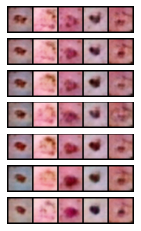

New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_100.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_100.pth
Epoch: 100, Duration: 6.436075687408447 , Gen Loss: 1.530992026946268 Disc Loss: 0.4366428075272941


In [165]:
# Runs the Cond GAN
run_GAN_pipeline(
    train_loader, None, None, #val_loader, test_loader, 
    n_channels, latent_dims, n_classes,
    epochs=epochs, name_dataset=name_dataset
)

#### Generating an upgraded dataset without Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [166]:
# Removes saved intermediary models
model_path = f"trained_models/conditionalGAN/{name_dataset}/gen_models/"
models = [x for x in os.listdir(model_path) 
          if x[-(4+len(str(epochs))):]!=f"{epochs}.pth"]
for model in models:
    os.remove(model_path+model)
# Fetches the generated GAN Model model to import
model_path += f"gen_model_{epochs}.pth"

# Calculates the number of images to generate
percentage = 10
nb_images_in_dataset = len(base_dataset[0])
n_generated_images = int((percentage/100)*nb_images_in_dataset)
print(f"Number of generated images: {n_generated_images}",
      f"({percentage}% of the dataset)")

# Creates the augmented dataloader
condGAN_loader = generate_augmented_dataset_condGAN(
    n_channels, n_classes, latent_dims, model_path,
    base_dataset[0], 64, 
    test_loader, val_loader, n_generated_images,
    weighted_sampling=False
)

Number of generated images: 700 (10% of the dataset)


2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "DermaMNIST",
  "description": "The DermaMNIST is based on the HAM10000, a large collection of multi-source dermatoscopic images of common pigmented skin lesions. The dataset consists of 10,015 dermatoscopic images categorized as 7 different diseases, formulized as a multi-class classification task. We split the images into training, validation and test set with a ratio of 7:1:2. The source images of 3\u00d7600\u00d7450 are resized into 3\u00d728\u00d728.",
  "url": "https://zenodo.org/record/5208230/files/dermamnist.npz?download=1",
  "MD5": "0744692d530f8e62ec473284d019b0c7",
  "task": "multi-class",
  "label": {
    "0": "actinic keratoses and intraepithelial carcinoma",
    "1": "basal cell carcinoma",
    "2": "benign keratosis-like lesions",
    "3": "dermatofibroma",
    "4": "melanoma",
    "5": "melanocytic nevi",
    "6": "vascular lesions"
  },
  "n_channels": 3,
  "n_samples": {
    "train": 7007,
    "val": 1003,
    "test": 2005
  },
  "license": "CC B

100%|█████████████████████████████████████████| 121/121 [00:01<00:00, 93.71it/s]


train -- accuracy: 0.62
val -- accuracy: 0.83,  AUC: 0.67
Epoch 1



100%|█████████████████████████████████████████| 121/121 [00:01<00:00, 93.37it/s]


train -- accuracy: 0.63
val -- accuracy: 0.86,  AUC: 0.68
Epoch 2



100%|█████████████████████████████████████████| 121/121 [00:01<00:00, 94.20it/s]


train -- accuracy: 0.65
val -- accuracy: 0.86,  AUC: 0.68
Epoch 3



100%|█████████████████████████████████████████| 121/121 [00:01<00:00, 92.37it/s]


train -- accuracy: 0.65
val -- accuracy: 0.88,  AUC: 0.7
Epoch 4



100%|█████████████████████████████████████████| 121/121 [00:01<00:00, 92.75it/s]


train -- accuracy: 0.67
val -- accuracy: 0.88,  AUC: 0.7
Epoch 5



100%|█████████████████████████████████████████| 121/121 [00:01<00:00, 94.45it/s]


train -- accuracy: 0.68
val -- accuracy: 0.89,  AUC: 0.72
Epoch 6



100%|█████████████████████████████████████████| 121/121 [00:01<00:00, 93.51it/s]


train -- accuracy: 0.69
val -- accuracy: 0.9,  AUC: 0.72
Epoch 7



100%|█████████████████████████████████████████| 121/121 [00:01<00:00, 93.72it/s]


train -- accuracy: 0.7
val -- accuracy: 0.9,  AUC: 0.72
Epoch 8



100%|█████████████████████████████████████████| 121/121 [00:01<00:00, 93.98it/s]


train -- accuracy: 0.72
val -- accuracy: 0.9,  AUC: 0.73
Epoch 9



100%|█████████████████████████████████████████| 121/121 [00:01<00:00, 91.22it/s]


train -- accuracy: 0.72
val -- accuracy: 0.9,  AUC: 0.73
Epoch 10



100%|█████████████████████████████████████████| 121/121 [00:01<00:00, 94.48it/s]


train -- accuracy: 0.73
val -- accuracy: 0.91,  AUC: 0.74
Epoch 11



100%|█████████████████████████████████████████| 121/121 [00:01<00:00, 93.69it/s]


train -- accuracy: 0.75
val -- accuracy: 0.91,  AUC: 0.74
Epoch 12



100%|█████████████████████████████████████████| 121/121 [00:01<00:00, 93.62it/s]


train -- accuracy: 0.75
val -- accuracy: 0.92,  AUC: 0.75
Epoch 13



100%|█████████████████████████████████████████| 121/121 [00:01<00:00, 93.98it/s]


train -- accuracy: 0.76
val -- accuracy: 0.92,  AUC: 0.74
Epoch 14



100%|█████████████████████████████████████████| 121/121 [00:01<00:00, 93.84it/s]


train -- accuracy: 0.77
val -- accuracy: 0.92,  AUC: 0.74
Epoch 15



100%|█████████████████████████████████████████| 121/121 [00:01<00:00, 92.83it/s]


train -- accuracy: 0.78
val -- accuracy: 0.91,  AUC: 0.75
Epoch 16



100%|█████████████████████████████████████████| 121/121 [00:01<00:00, 93.53it/s]


train -- accuracy: 0.8
val -- accuracy: 0.92,  AUC: 0.73
Epoch 17



100%|█████████████████████████████████████████| 121/121 [00:01<00:00, 94.17it/s]


train -- accuracy: 0.8
val -- accuracy: 0.92,  AUC: 0.72
Epoch 18



100%|█████████████████████████████████████████| 121/121 [00:01<00:00, 93.88it/s]


train -- accuracy: 0.83
val -- accuracy: 0.9,  AUC: 0.75
Epoch 19



100%|█████████████████████████████████████████| 121/121 [00:01<00:00, 92.98it/s]


train -- accuracy: 0.84
val -- accuracy: 0.91,  AUC: 0.72
test -- accuracy: 0.91,  AUC: 0.72


<Figure size 720x720 with 0 Axes>

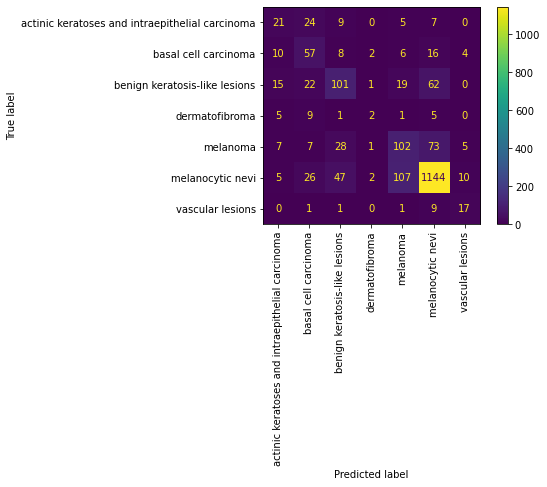

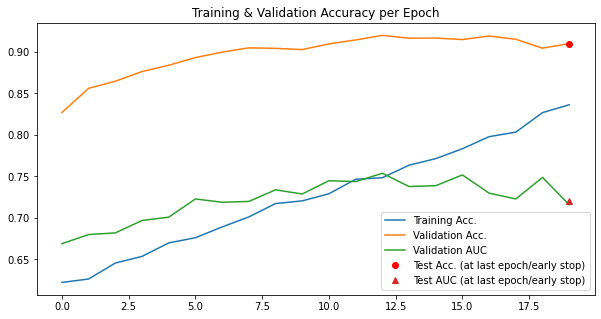

In [167]:
# Runs the classifier again 

clf = run_classifier_pipeline(name_dataset, info_flags, condGAN_loader)

#### Generating an upgraded dataset with Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [168]:
# Creates the augmented dataloader
condGAN_loader = generate_augmented_dataset_condGAN(
    n_channels, n_classes, latent_dims, model_path,
    base_dataset[0], 64, 
    test_loader, val_loader, n_generated_images,
    weighted_sampling=True
)

2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "DermaMNIST",
  "description": "The DermaMNIST is based on the HAM10000, a large collection of multi-source dermatoscopic images of common pigmented skin lesions. The dataset consists of 10,015 dermatoscopic images categorized as 7 different diseases, formulized as a multi-class classification task. We split the images into training, validation and test set with a ratio of 7:1:2. The source images of 3\u00d7600\u00d7450 are resized into 3\u00d728\u00d728.",
  "url": "https://zenodo.org/record/5208230/files/dermamnist.npz?download=1",
  "MD5": "0744692d530f8e62ec473284d019b0c7",
  "task": "multi-class",
  "label": {
    "0": "actinic keratoses and intraepithelial carcinoma",
    "1": "basal cell carcinoma",
    "2": "benign keratosis-like lesions",
    "3": "dermatofibroma",
    "4": "melanoma",
    "5": "melanocytic nevi",
    "6": "vascular lesions"
  },
  "n_channels": 3,
  "n_samples": {
    "train": 7007,
    "val": 1003,
    "test": 2005
  },
  "license": "CC B

100%|█████████████████████████████████████████| 121/121 [00:01<00:00, 95.04it/s]


train -- accuracy: 0.32
val -- accuracy: 0.85,  AUC: 0.58
Epoch 1



100%|█████████████████████████████████████████| 121/121 [00:01<00:00, 95.33it/s]


train -- accuracy: 0.46
val -- accuracy: 0.87,  AUC: 0.6
Epoch 2



100%|█████████████████████████████████████████| 121/121 [00:01<00:00, 95.08it/s]


train -- accuracy: 0.53
val -- accuracy: 0.88,  AUC: 0.59
Epoch 3



100%|█████████████████████████████████████████| 121/121 [00:01<00:00, 93.97it/s]


train -- accuracy: 0.59
val -- accuracy: 0.88,  AUC: 0.58
Epoch 4



100%|█████████████████████████████████████████| 121/121 [00:01<00:00, 93.73it/s]


train -- accuracy: 0.64
val -- accuracy: 0.89,  AUC: 0.6
Epoch 5



100%|█████████████████████████████████████████| 121/121 [00:01<00:00, 95.01it/s]


train -- accuracy: 0.69
val -- accuracy: 0.9,  AUC: 0.64
Epoch 6



100%|█████████████████████████████████████████| 121/121 [00:01<00:00, 93.73it/s]


train -- accuracy: 0.75
val -- accuracy: 0.89,  AUC: 0.59
Epoch 7



100%|█████████████████████████████████████████| 121/121 [00:01<00:00, 95.03it/s]


train -- accuracy: 0.8
val -- accuracy: 0.9,  AUC: 0.58
Epoch 8



100%|█████████████████████████████████████████| 121/121 [00:01<00:00, 95.39it/s]


train -- accuracy: 0.83
val -- accuracy: 0.9,  AUC: 0.64
Epoch 9



100%|█████████████████████████████████████████| 121/121 [00:01<00:00, 94.75it/s]


train -- accuracy: 0.87
val -- accuracy: 0.9,  AUC: 0.59
Epoch 10



100%|█████████████████████████████████████████| 121/121 [00:01<00:00, 94.93it/s]


train -- accuracy: 0.89
val -- accuracy: 0.9,  AUC: 0.67
Epoch 11



100%|█████████████████████████████████████████| 121/121 [00:01<00:00, 95.45it/s]


train -- accuracy: 0.9
val -- accuracy: 0.9,  AUC: 0.64
Epoch 12



100%|█████████████████████████████████████████| 121/121 [00:01<00:00, 92.31it/s]


train -- accuracy: 0.91
val -- accuracy: 0.9,  AUC: 0.59
Epoch 13



100%|█████████████████████████████████████████| 121/121 [00:01<00:00, 91.68it/s]


train -- accuracy: 0.93
val -- accuracy: 0.89,  AUC: 0.64
Epoch 14



100%|█████████████████████████████████████████| 121/121 [00:01<00:00, 92.82it/s]


train -- accuracy: 0.93
val -- accuracy: 0.9,  AUC: 0.6
Epoch 15



100%|█████████████████████████████████████████| 121/121 [00:01<00:00, 94.03it/s]


train -- accuracy: 0.93
val -- accuracy: 0.91,  AUC: 0.69
Epoch 16



100%|█████████████████████████████████████████| 121/121 [00:01<00:00, 95.39it/s]


train -- accuracy: 0.95
val -- accuracy: 0.89,  AUC: 0.67
Epoch 17



100%|█████████████████████████████████████████| 121/121 [00:01<00:00, 95.26it/s]


train -- accuracy: 0.96
val -- accuracy: 0.89,  AUC: 0.66
Epoch 18



100%|█████████████████████████████████████████| 121/121 [00:01<00:00, 93.97it/s]


train -- accuracy: 0.96
val -- accuracy: 0.9,  AUC: 0.71
Epoch 19



100%|█████████████████████████████████████████| 121/121 [00:01<00:00, 96.12it/s]


train -- accuracy: 0.97
val -- accuracy: 0.89,  AUC: 0.7
test -- accuracy: 0.89,  AUC: 0.71


<Figure size 720x720 with 0 Axes>

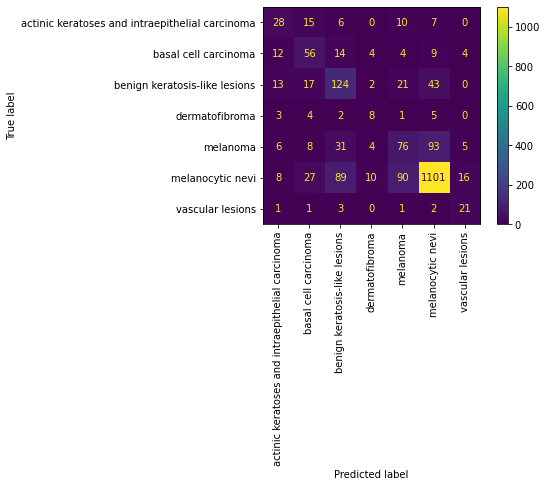

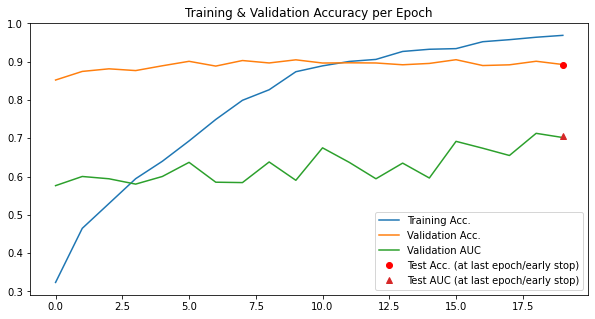

In [169]:
# Runs the classifier again 

clf = run_classifier_pipeline(name_dataset, info_flags, condGAN_loader)

### OctMNIST

#### Training the Conditional GAN

In [170]:
# Declares the dataset name and retrieves the base dataset
name_dataset = "octmnist"
base_dataset = octmnist_noWRS_noGDA_upscaled

# Retrieves the dataset parameters
n_classes  = len(info_flags[name_dataset][0]["label"])
n_channels = info_flags[name_dataset][0]["n_channels"]

# Retrieves the data loader
train_loader = base_dataset[3] #####################################################
val_loader = base_dataset[5]   ### OF NOTE #########################################
test_loader = base_dataset[4]  ### EVALUATE/TEST NOT IMPLEMENTED YET IN ############
                               ### TORCHFUSION AT THE TIME OF CREATION OF NOTEBOOK #
                               ### Thus the use of None below in the pipeline ######
                               #####################################################

Epoch 1 of 100


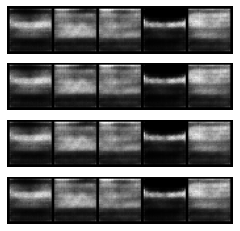

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_1.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_1.pth
Epoch: 1, Duration: 84.5006103515625 , Gen Loss: 4.7153283595104485 Disc Loss: 0.1659646213818388
Epoch 2 of 100


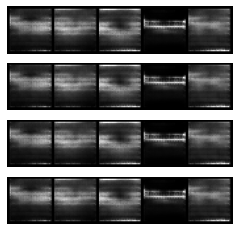

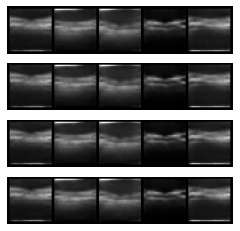

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_2.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_2.pth
Epoch: 2, Duration: 78.24914836883545 , Gen Loss: 6.053567764703469 Disc Loss: 0.11429872760048525
Epoch 3 of 100


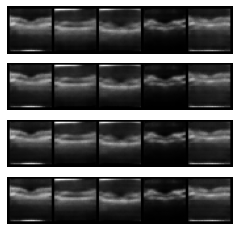

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_3.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_3.pth
Epoch: 3, Duration: 78.41724252700806 , Gen Loss: 5.7844286344471 Disc Loss: 0.14120333153910666
Epoch 4 of 100


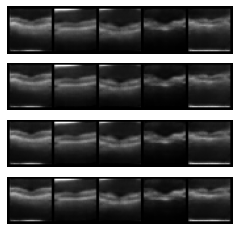

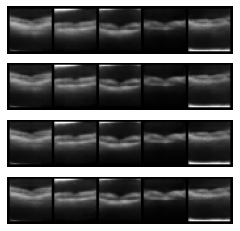

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_4.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_4.pth
Epoch: 4, Duration: 76.79300737380981 , Gen Loss: 6.31826930968331 Disc Loss: 0.1603111342932179
Epoch 5 of 100


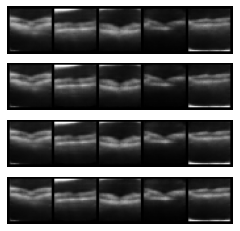

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_5.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_5.pth
Epoch: 5, Duration: 77.63834929466248 , Gen Loss: 4.876398727392103 Disc Loss: 0.20591946930429741
Epoch 6 of 100


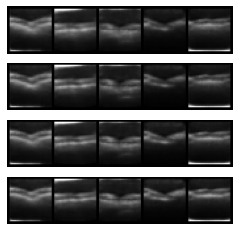

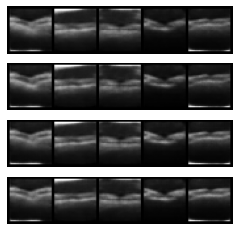

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_6.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_6.pth
Epoch: 6, Duration: 75.75766849517822 , Gen Loss: 4.273152577018168 Disc Loss: 0.24353306982031658
Epoch 7 of 100


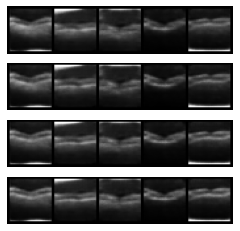

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_7.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_7.pth
Epoch: 7, Duration: 79.12023520469666 , Gen Loss: 4.22767133528935 Disc Loss: 0.2663332800622198
Epoch 8 of 100


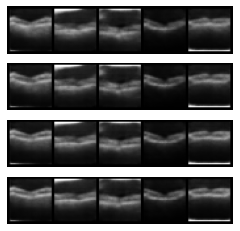

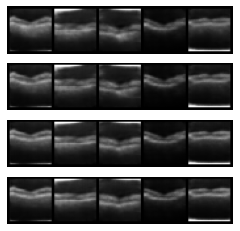

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_8.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_8.pth
Epoch: 8, Duration: 80.17973470687866 , Gen Loss: 4.3874462052586765 Disc Loss: 0.2757911601903526
Epoch 9 of 100


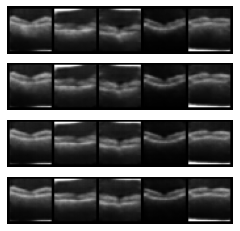

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_9.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_9.pth
Epoch: 9, Duration: 84.00777220726013 , Gen Loss: 4.775466905013491 Disc Loss: 0.2748938531653621
Epoch 10 of 100


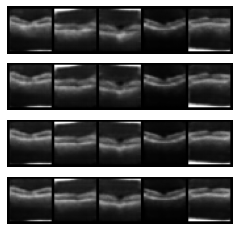

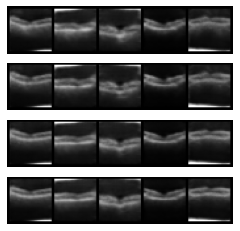

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_10.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_10.pth
Epoch: 10, Duration: 80.68276929855347 , Gen Loss: 4.7084389137950495 Disc Loss: 0.28926653450942275
Epoch 11 of 100


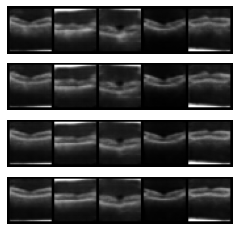

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_11.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_11.pth
Epoch: 11, Duration: 78.14368486404419 , Gen Loss: 4.400063925336233 Disc Loss: 0.30588441696502766
Epoch 12 of 100


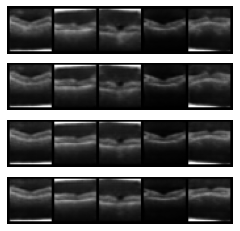

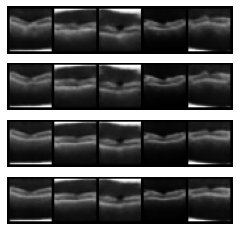

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_12.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_12.pth
Epoch: 12, Duration: 76.70537781715393 , Gen Loss: 3.980318434092145 Disc Loss: 0.33901546967489765
Epoch 13 of 100


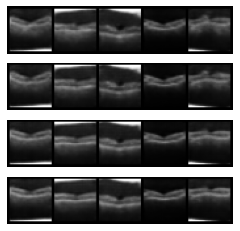

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_13.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_13.pth
Epoch: 13, Duration: 74.65804934501648 , Gen Loss: 3.7492309083168336 Disc Loss: 0.34257035473752784
Epoch 14 of 100


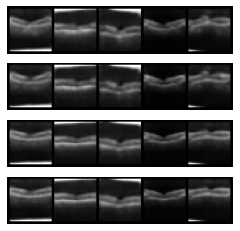

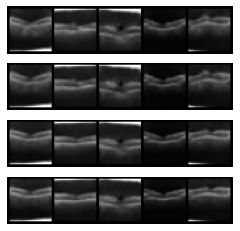

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_14.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_14.pth
Epoch: 14, Duration: 77.04096221923828 , Gen Loss: 3.620066143808283 Disc Loss: 0.35256493999866634
Epoch 15 of 100


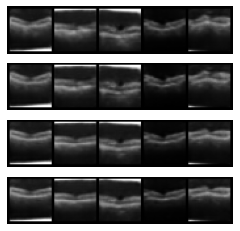

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_15.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_15.pth
Epoch: 15, Duration: 82.60986399650574 , Gen Loss: 3.8190973896406333 Disc Loss: 0.342120328705746
Epoch 16 of 100


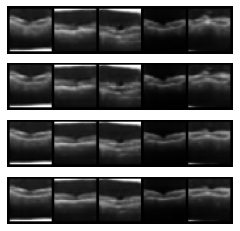

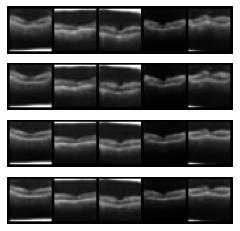

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_16.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_16.pth
Epoch: 16, Duration: 80.29743480682373 , Gen Loss: 4.130308303497236 Disc Loss: 0.3397701348779712
Epoch 17 of 100


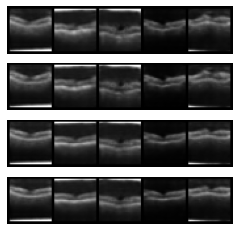

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_17.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_17.pth
Epoch: 17, Duration: 79.7498779296875 , Gen Loss: 4.450995170655641 Disc Loss: 0.3340911309526863
Epoch 18 of 100


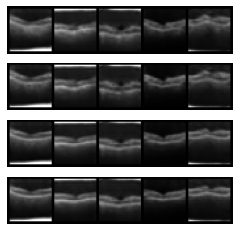

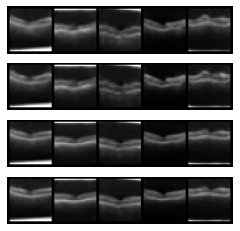

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_18.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_18.pth
Epoch: 18, Duration: 80.25618696212769 , Gen Loss: 3.8524212763010763 Disc Loss: 0.3625882579993229
Epoch 19 of 100


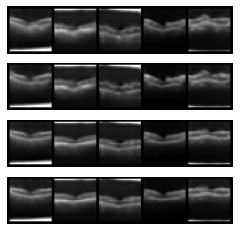

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_19.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_19.pth
Epoch: 19, Duration: 80.52421641349792 , Gen Loss: 3.4215270012413184 Disc Loss: 0.39266229950398557
Epoch 20 of 100


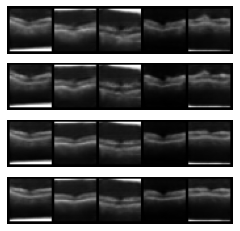

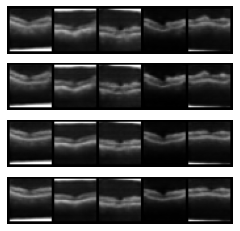

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_20.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_20.pth
Epoch: 20, Duration: 81.38718795776367 , Gen Loss: 3.6979024539122047 Disc Loss: 0.3733770610631226
Epoch 21 of 100


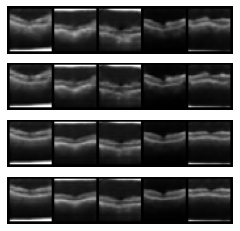

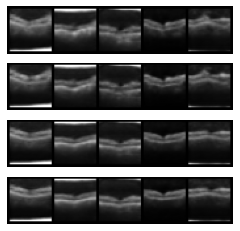

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_21.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_21.pth
Epoch: 21, Duration: 80.71103429794312 , Gen Loss: 3.589315941196385 Disc Loss: 0.38160119662843545
Epoch 22 of 100


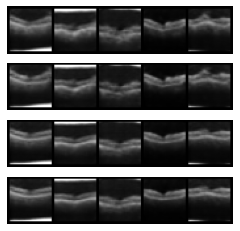

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_22.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_22.pth
Epoch: 22, Duration: 79.33404970169067 , Gen Loss: 3.8676088333658196 Disc Loss: 0.360646053043282
Epoch 23 of 100


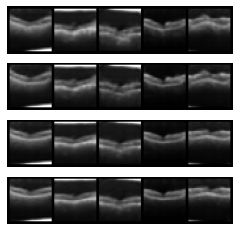

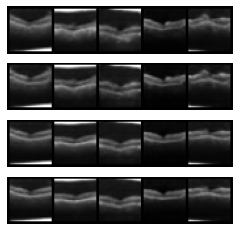

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_23.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_23.pth
Epoch: 23, Duration: 84.65662288665771 , Gen Loss: 3.659089131282251 Disc Loss: 0.38425931565907856
Epoch 24 of 100


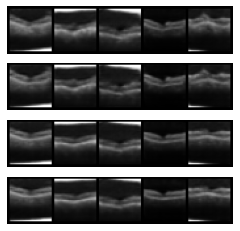

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_24.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_24.pth
Epoch: 24, Duration: 83.51298260688782 , Gen Loss: 3.5128757937769937 Disc Loss: 0.39467050560645073
Epoch 25 of 100


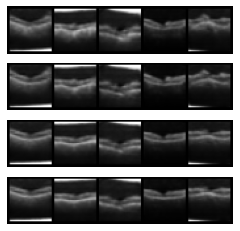

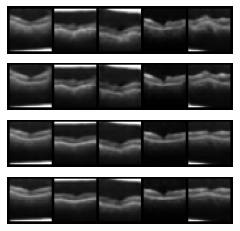

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_25.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_25.pth
Epoch: 25, Duration: 84.40735244750977 , Gen Loss: 3.6139791309744864 Disc Loss: 0.3903657641674446
Epoch 26 of 100


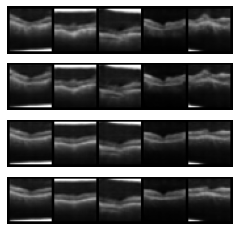

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_26.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_26.pth
Epoch: 26, Duration: 86.53633856773376 , Gen Loss: 3.337269945730788 Disc Loss: 0.4043493112477815
Epoch 27 of 100


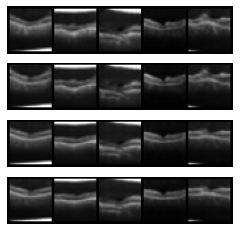

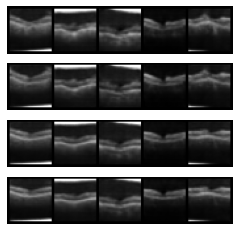

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_27.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_27.pth
Epoch: 27, Duration: 83.2788622379303 , Gen Loss: 3.4288075648614544 Disc Loss: 0.38569114380828295
Epoch 28 of 100


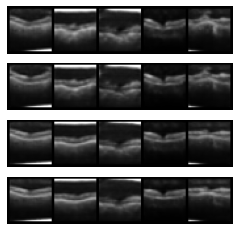

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_28.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_28.pth
Epoch: 28, Duration: 83.56323266029358 , Gen Loss: 3.459816161761236 Disc Loss: 0.3936820112052074
Epoch 29 of 100


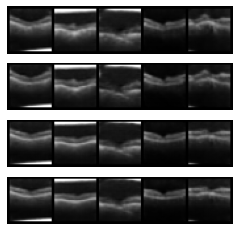

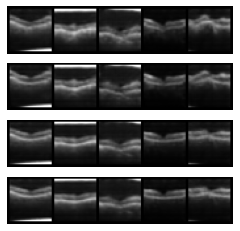

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_29.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_29.pth
Epoch: 29, Duration: 85.79035997390747 , Gen Loss: 3.594503062260841 Disc Loss: 0.38239781884444535
Epoch 30 of 100


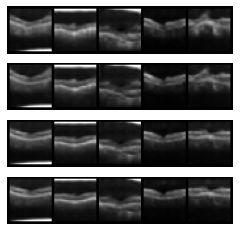

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_30.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_30.pth
Epoch: 30, Duration: 84.03198885917664 , Gen Loss: 3.8942955774182626 Disc Loss: 0.3768341666495686
Epoch 31 of 100


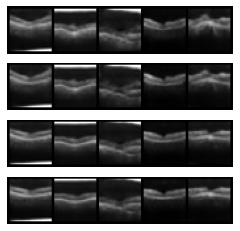

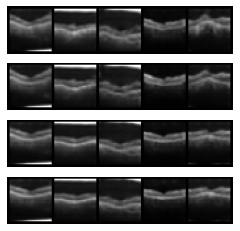

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_31.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_31.pth
Epoch: 31, Duration: 81.07245564460754 , Gen Loss: 3.9437043482052174 Disc Loss: 0.372217452578557
Epoch 32 of 100


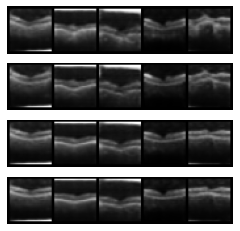

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_32.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_32.pth
Epoch: 32, Duration: 79.08630061149597 , Gen Loss: 3.729669563076418 Disc Loss: 0.39372649285216
Epoch 33 of 100


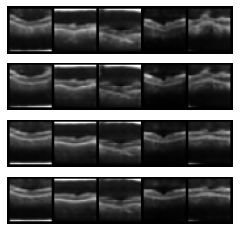

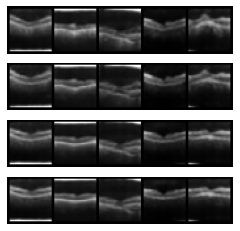

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_33.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_33.pth
Epoch: 33, Duration: 81.58143615722656 , Gen Loss: 3.56602358761554 Disc Loss: 0.38577802327728594
Epoch 34 of 100


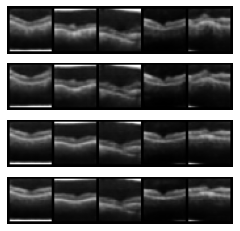

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_34.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_34.pth
Epoch: 34, Duration: 79.3696231842041 , Gen Loss: 4.2058886327030995 Disc Loss: 0.36176142032222985
Epoch 35 of 100


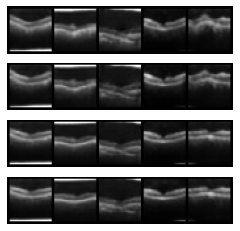

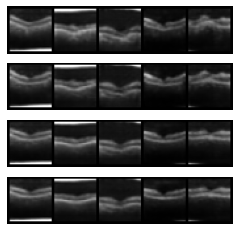

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_35.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_35.pth
Epoch: 35, Duration: 79.35128402709961 , Gen Loss: 4.2024253157155025 Disc Loss: 0.3595948034536352
Epoch 36 of 100


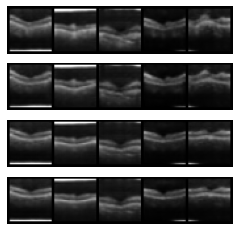

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_36.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_36.pth
Epoch: 36, Duration: 79.75700998306274 , Gen Loss: 4.448248689434431 Disc Loss: 0.3609102579967582
Epoch 37 of 100


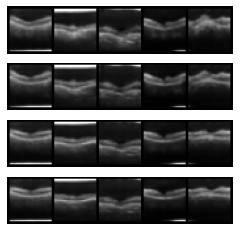

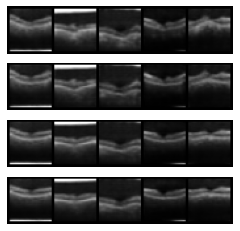

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_37.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_37.pth
Epoch: 37, Duration: 79.89620637893677 , Gen Loss: 3.840359136001313 Disc Loss: 0.3857267691994009
Epoch 38 of 100


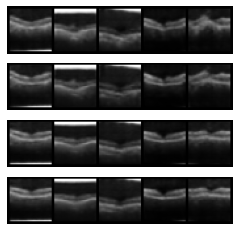

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_38.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_38.pth
Epoch: 38, Duration: 80.46312284469604 , Gen Loss: 3.531129458744114 Disc Loss: 0.3913180320742329
Epoch 39 of 100


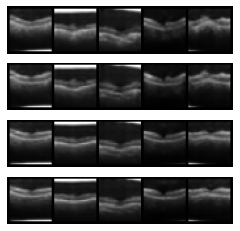

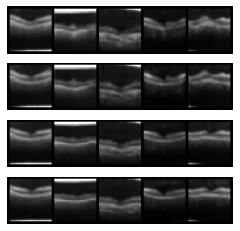

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_39.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_39.pth
Epoch: 39, Duration: 80.51561498641968 , Gen Loss: 4.181264875303918 Disc Loss: 0.35903357330447183
Epoch 40 of 100


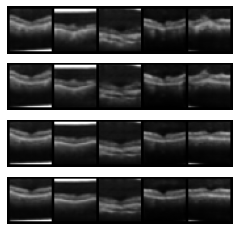

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_40.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_40.pth
Epoch: 40, Duration: 80.14564657211304 , Gen Loss: 4.3827345168603875 Disc Loss: 0.35623687991782677
Epoch 41 of 100


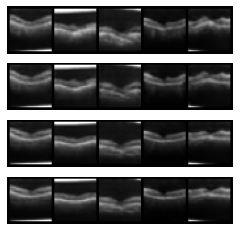

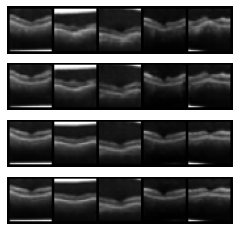

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_41.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_41.pth
Epoch: 41, Duration: 80.06216311454773 , Gen Loss: 4.0969985227284385 Disc Loss: 0.3754039013690409
Epoch 42 of 100


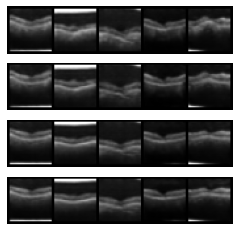

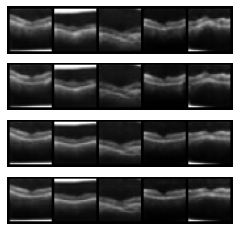

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_42.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_42.pth
Epoch: 42, Duration: 80.8513720035553 , Gen Loss: 4.359473260358854 Disc Loss: 0.3633164746555598
Epoch 43 of 100


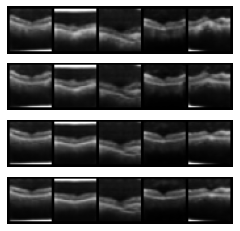

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_43.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_43.pth
Epoch: 43, Duration: 80.8525869846344 , Gen Loss: 4.566218505391015 Disc Loss: 0.3540236575038214
Epoch 44 of 100


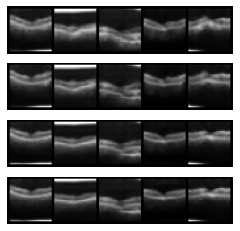

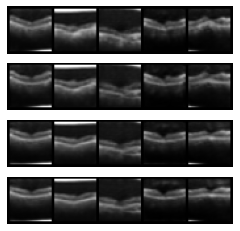

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_44.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_44.pth
Epoch: 44, Duration: 79.61091494560242 , Gen Loss: 4.327960057244273 Disc Loss: 0.36671443167362555
Epoch 45 of 100


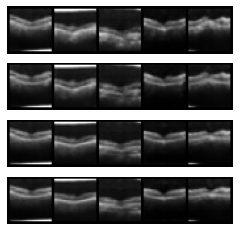

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_45.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_45.pth
Epoch: 45, Duration: 79.28267574310303 , Gen Loss: 4.47002882731311 Disc Loss: 0.3558751760030571
Epoch 46 of 100


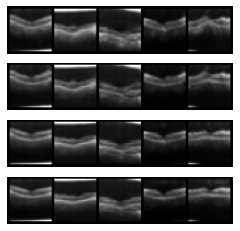

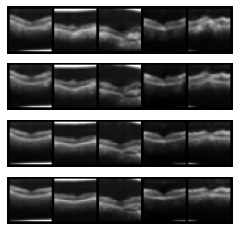

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_46.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_46.pth
Epoch: 46, Duration: 79.65488386154175 , Gen Loss: 4.786842665449285 Disc Loss: 0.349093968961909
Epoch 47 of 100


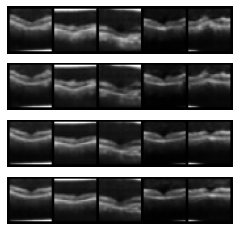

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_47.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_47.pth
Epoch: 47, Duration: 84.63104891777039 , Gen Loss: 4.674148773556839 Disc Loss: 0.3629903159847964
Epoch 48 of 100


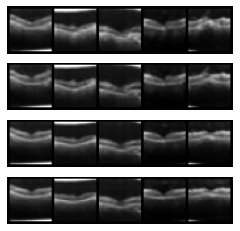

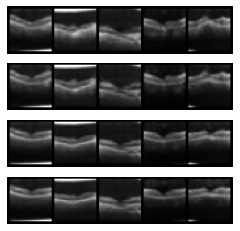

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_48.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_48.pth
Epoch: 48, Duration: 88.15460658073425 , Gen Loss: 4.027810085968998 Disc Loss: 0.37729016364116663
Epoch 49 of 100


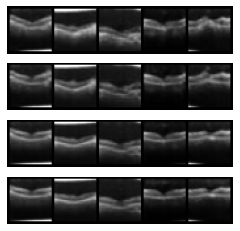

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_49.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_49.pth
Epoch: 49, Duration: 87.14506340026855 , Gen Loss: 4.734639325174143 Disc Loss: 0.35069001854283577
Epoch 50 of 100


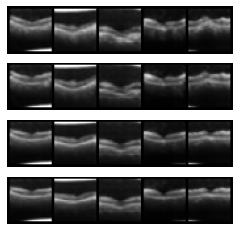

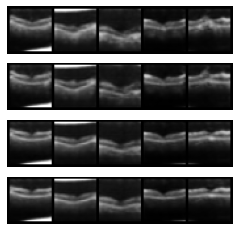

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_50.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_50.pth
Epoch: 50, Duration: 86.68795490264893 , Gen Loss: 4.221594581285842 Disc Loss: 0.36737833027278227
Epoch 51 of 100


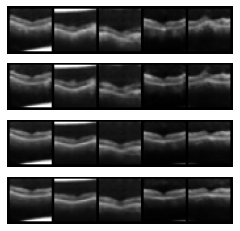

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_51.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_51.pth
Epoch: 51, Duration: 86.51593399047852 , Gen Loss: 4.634152800147727 Disc Loss: 0.35017250864306454
Epoch 52 of 100


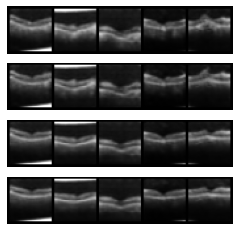

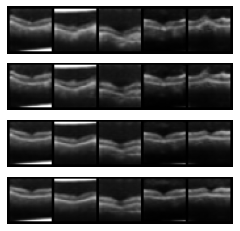

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_52.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_52.pth
Epoch: 52, Duration: 87.88206338882446 , Gen Loss: 4.565113116427465 Disc Loss: 0.3669846075869179
Epoch 53 of 100


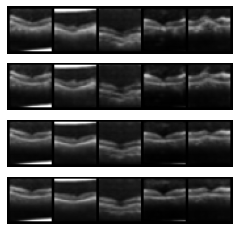

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_53.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_53.pth
Epoch: 53, Duration: 87.63020634651184 , Gen Loss: 4.571747694327892 Disc Loss: 0.35340736628897074
Epoch 54 of 100


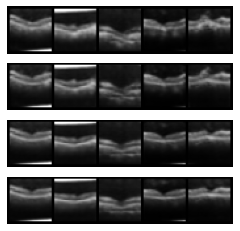

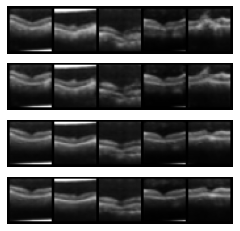

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_54.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_54.pth
Epoch: 54, Duration: 87.94495868682861 , Gen Loss: 4.981351370066785 Disc Loss: 0.34603487393179927
Epoch 55 of 100


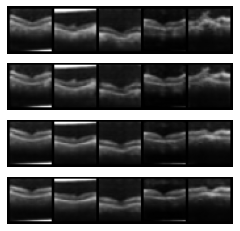

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_55.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_55.pth
Epoch: 55, Duration: 88.71669316291809 , Gen Loss: 5.270704243052207 Disc Loss: 0.3394797218189932
Epoch 56 of 100


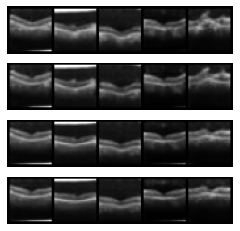

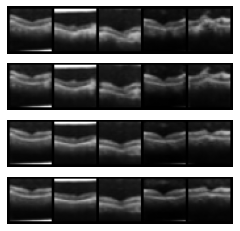

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_56.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_56.pth
Epoch: 56, Duration: 88.15092444419861 , Gen Loss: 4.918114978405162 Disc Loss: 0.3436803521599967
Epoch 57 of 100


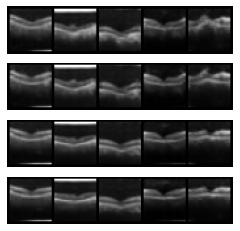

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_57.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_57.pth
Epoch: 57, Duration: 91.34298133850098 , Gen Loss: 4.479707713101552 Disc Loss: 0.3756519967530802
Epoch 58 of 100


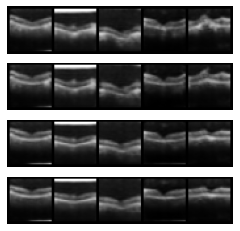

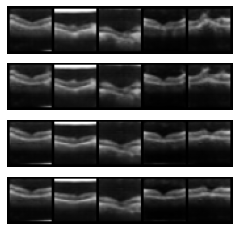

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_58.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_58.pth
Epoch: 58, Duration: 90.55128288269043 , Gen Loss: 3.9401544723370643 Disc Loss: 0.37608915917344604
Epoch 59 of 100


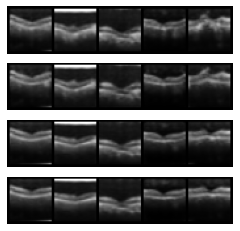

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_59.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_59.pth
Epoch: 59, Duration: 89.94578433036804 , Gen Loss: 3.749807646932097 Disc Loss: 0.390356467102496
Epoch 60 of 100


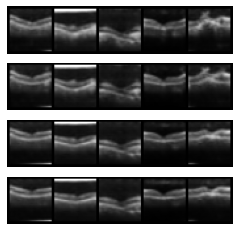

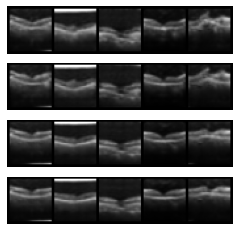

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_60.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_60.pth
Epoch: 60, Duration: 84.52495121955872 , Gen Loss: 4.258080431794167 Disc Loss: 0.359937392282282
Epoch 61 of 100


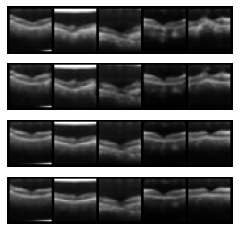

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_61.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_61.pth
Epoch: 61, Duration: 85.32214999198914 , Gen Loss: 3.941597761523231 Disc Loss: 0.3761866581347395
Epoch 62 of 100


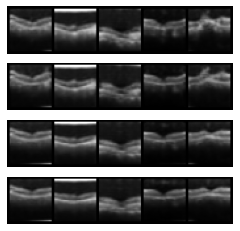

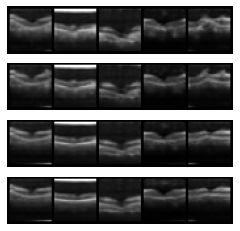

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_62.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_62.pth
Epoch: 62, Duration: 87.56751275062561 , Gen Loss: 4.649718651579347 Disc Loss: 0.3464999676205669
Epoch 63 of 100


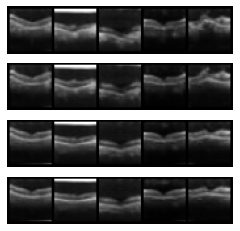

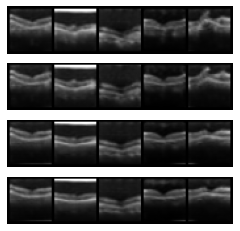

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_63.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_63.pth
Epoch: 63, Duration: 85.033611536026 , Gen Loss: 4.909667472839747 Disc Loss: 0.34775503131507945
Epoch 64 of 100


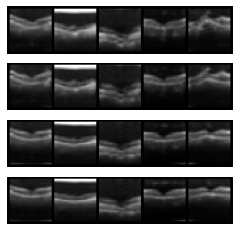

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_64.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_64.pth
Epoch: 64, Duration: 88.8060781955719 , Gen Loss: 4.257146557649497 Disc Loss: 0.36725273974886385
Epoch 65 of 100


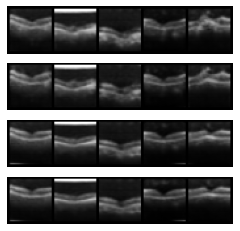

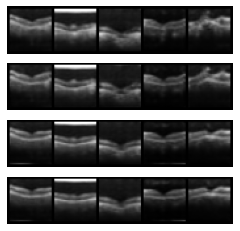

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_65.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_65.pth
Epoch: 65, Duration: 83.34703540802002 , Gen Loss: 4.251977389538045 Disc Loss: 0.365558029073525
Epoch 66 of 100


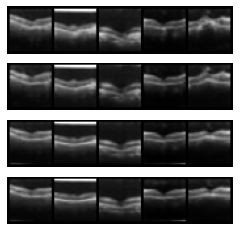

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_66.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_66.pth
Epoch: 66, Duration: 81.76191592216492 , Gen Loss: 4.864086848692512 Disc Loss: 0.33752701759132925
Epoch 67 of 100


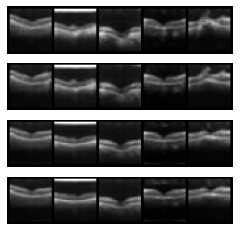

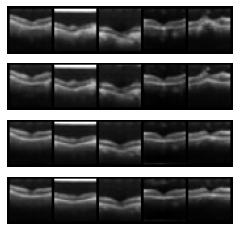

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_67.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_67.pth
Epoch: 67, Duration: 81.94752669334412 , Gen Loss: 4.8102747955928065 Disc Loss: 0.34221726663725804
Epoch 68 of 100


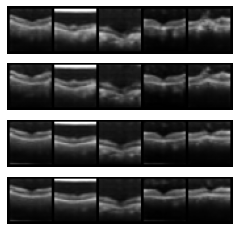

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_68.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_68.pth
Epoch: 68, Duration: 84.06091713905334 , Gen Loss: 4.491567241503124 Disc Loss: 0.35447873280363573
Epoch 69 of 100


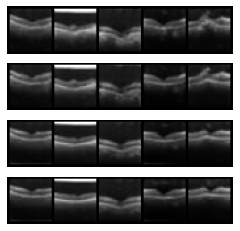

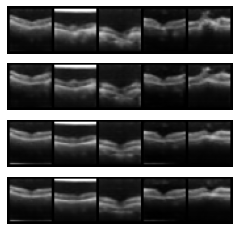

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_69.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_69.pth
Epoch: 69, Duration: 87.28275632858276 , Gen Loss: 4.995451491120982 Disc Loss: 0.344050070785929
Epoch 70 of 100


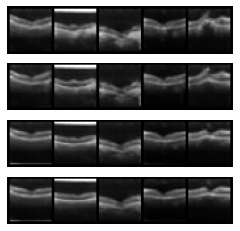

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_70.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_70.pth
Epoch: 70, Duration: 80.88723731040955 , Gen Loss: 4.7750430870872105 Disc Loss: 0.358281112146968
Epoch 71 of 100


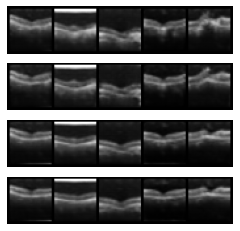

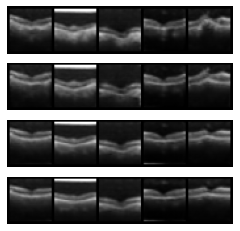

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_71.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_71.pth
Epoch: 71, Duration: 74.1431212425232 , Gen Loss: 4.6591288842496175 Disc Loss: 0.34559494643608235
Epoch 72 of 100


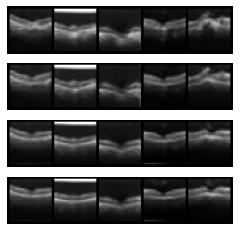

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_72.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_72.pth
Epoch: 72, Duration: 74.50581407546997 , Gen Loss: 5.634241923735855 Disc Loss: 0.32705744047313723
Epoch 73 of 100


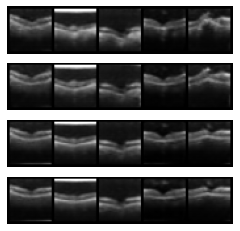

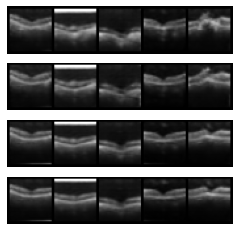

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_73.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_73.pth
Epoch: 73, Duration: 74.66168785095215 , Gen Loss: 5.2963618981913685 Disc Loss: 0.34167535194199655
Epoch 74 of 100


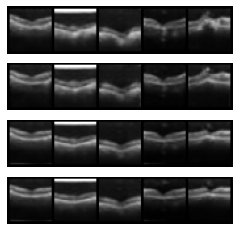

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_74.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_74.pth
Epoch: 74, Duration: 73.76316523551941 , Gen Loss: 5.306124136975902 Disc Loss: 0.34393862622721255
Epoch 75 of 100


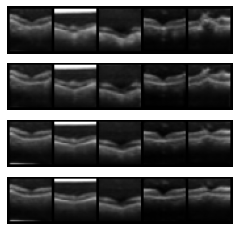

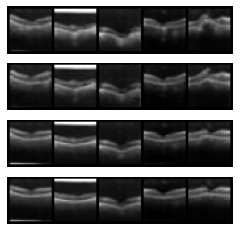

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_75.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_75.pth
Epoch: 75, Duration: 74.96361374855042 , Gen Loss: 5.09811481169917 Disc Loss: 0.34347469467156355
Epoch 76 of 100


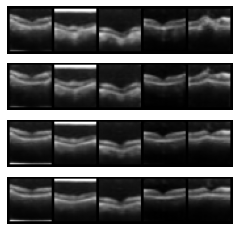

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_76.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_76.pth
Epoch: 76, Duration: 77.10810136795044 , Gen Loss: 5.499690952737569 Disc Loss: 0.33043097265893495
Epoch 77 of 100


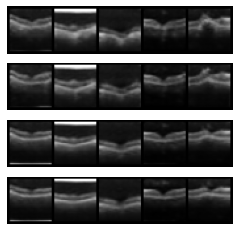

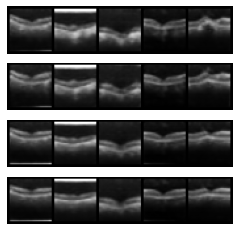

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_77.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_77.pth
Epoch: 77, Duration: 91.53962326049805 , Gen Loss: 5.357999194681822 Disc Loss: 0.3450226960590703
Epoch 78 of 100


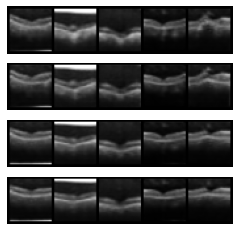

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_78.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_78.pth
Epoch: 78, Duration: 86.98651766777039 , Gen Loss: 4.961454368722878 Disc Loss: 0.3544536868312525
Epoch 79 of 100


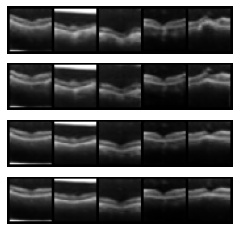

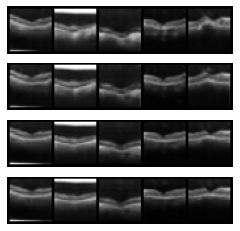

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_79.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_79.pth
Epoch: 79, Duration: 86.75847792625427 , Gen Loss: 3.9699467566708044 Disc Loss: 0.3892191795885183
Epoch 80 of 100


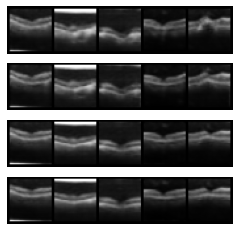

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_80.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_80.pth
Epoch: 80, Duration: 86.46567749977112 , Gen Loss: 4.784930996542774 Disc Loss: 0.3464095616786524
Epoch 81 of 100


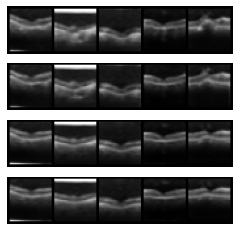

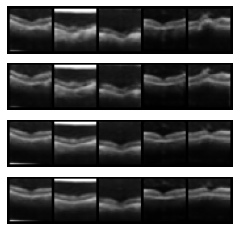

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_81.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_81.pth
Epoch: 81, Duration: 88.10102391242981 , Gen Loss: 5.11508516111493 Disc Loss: 0.34049558645885697
Epoch 82 of 100


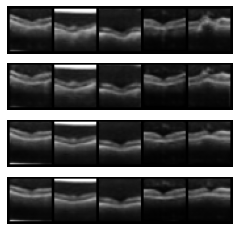

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_82.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_82.pth
Epoch: 82, Duration: 90.23014116287231 , Gen Loss: 4.554208621008033 Disc Loss: 0.36343849863301086
Epoch 83 of 100


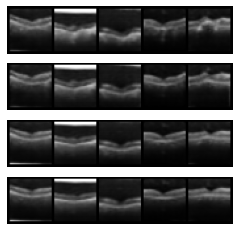

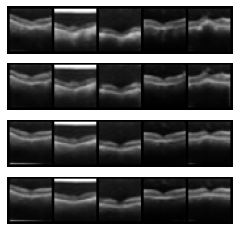

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_83.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_83.pth
Epoch: 83, Duration: 90.66191840171814 , Gen Loss: 5.07738428039435 Disc Loss: 0.34054086957692586
Epoch 84 of 100


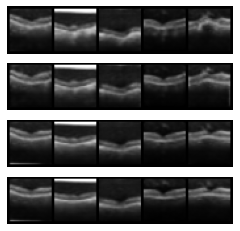

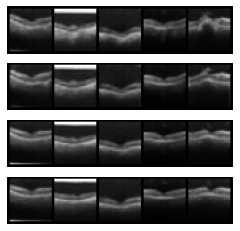

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_84.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_84.pth
Epoch: 84, Duration: 86.05785655975342 , Gen Loss: 5.072560065451337 Disc Loss: 0.3439227570991106
Epoch 85 of 100


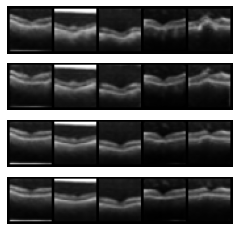

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_85.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_85.pth
Epoch: 85, Duration: 89.51311039924622 , Gen Loss: 4.647401758876453 Disc Loss: 0.3575953333863373
Epoch 86 of 100


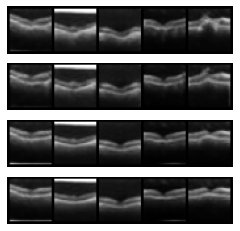

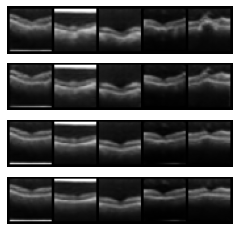

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_86.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_86.pth
Epoch: 86, Duration: 83.35999035835266 , Gen Loss: 4.693924271879521 Disc Loss: 0.353472726258502
Epoch 87 of 100


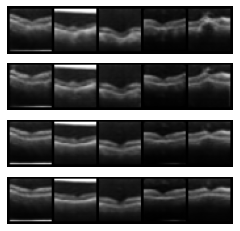

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_87.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_87.pth
Epoch: 87, Duration: 92.97914242744446 , Gen Loss: 5.389468156590786 Disc Loss: 0.3389695854534916
Epoch 88 of 100


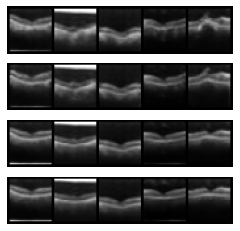

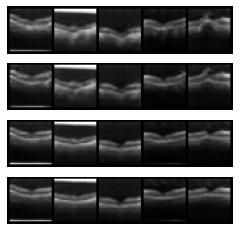

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_88.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_88.pth
Epoch: 88, Duration: 82.43959069252014 , Gen Loss: 4.600179721883111 Disc Loss: 0.3658284454281523
Epoch 89 of 100


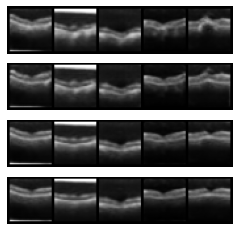

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_89.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_89.pth
Epoch: 89, Duration: 86.05284571647644 , Gen Loss: 4.659158057798249 Disc Loss: 0.35833457027042276
Epoch 90 of 100


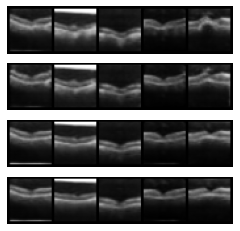

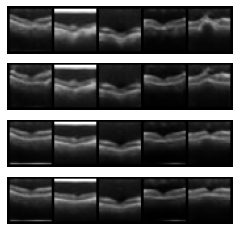

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_90.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_90.pth
Epoch: 90, Duration: 87.90063142776489 , Gen Loss: 3.9258655246878753 Disc Loss: 0.386651827161792
Epoch 91 of 100


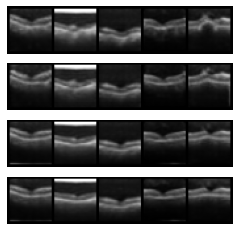

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_91.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_91.pth
Epoch: 91, Duration: 86.06109690666199 , Gen Loss: 3.8942064538301344 Disc Loss: 0.38334339446741283
Epoch 92 of 100


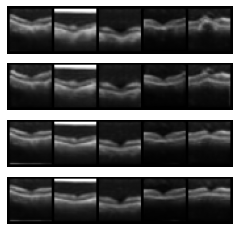

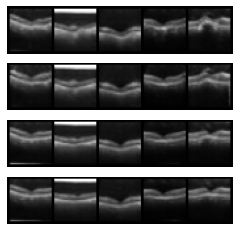

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_92.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_92.pth
Epoch: 92, Duration: 87.96600127220154 , Gen Loss: 4.4674734168060155 Disc Loss: 0.3520364098710465
Epoch 93 of 100


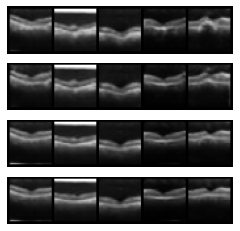

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_93.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_93.pth
Epoch: 93, Duration: 87.54978394508362 , Gen Loss: 4.2753136637360605 Disc Loss: 0.3673810552745776
Epoch 94 of 100


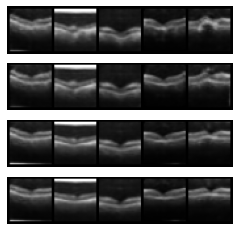

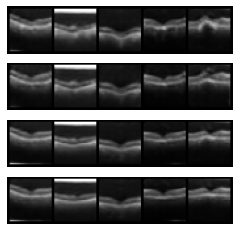

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_94.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_94.pth
Epoch: 94, Duration: 83.51067423820496 , Gen Loss: 4.7827458656913935 Disc Loss: 0.34870557605896774
Epoch 95 of 100


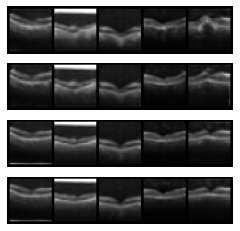

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_95.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_95.pth
Epoch: 95, Duration: 81.47733211517334 , Gen Loss: 4.844445997517363 Disc Loss: 0.36131604282292235
Epoch 96 of 100


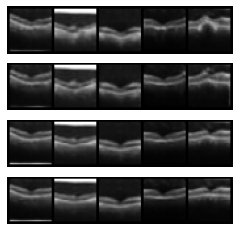

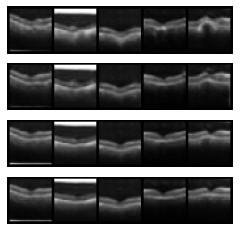

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_96.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_96.pth
Epoch: 96, Duration: 79.43251633644104 , Gen Loss: 3.2122888604491315 Disc Loss: 0.4203239129486956
Epoch 97 of 100


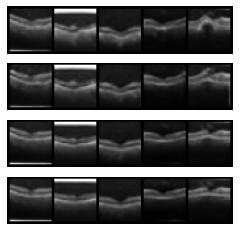

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_97.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_97.pth
Epoch: 97, Duration: 77.77014255523682 , Gen Loss: 3.982623465022518 Disc Loss: 0.36878631465627787
Epoch 98 of 100


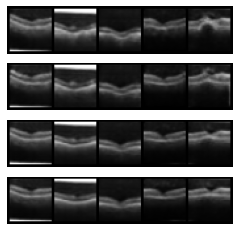

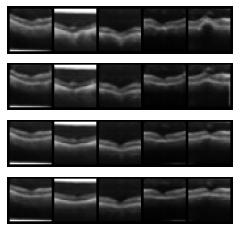

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_98.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_98.pth
Epoch: 98, Duration: 82.47279810905457 , Gen Loss: 4.650569813904818 Disc Loss: 0.35068340640612655
Epoch 99 of 100


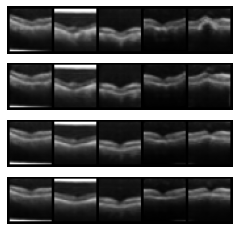

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_99.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_99.pth
Epoch: 99, Duration: 84.59456944465637 , Gen Loss: 4.666082127065872 Disc Loss: 0.35328514194374055
Epoch 100 of 100


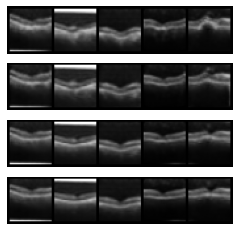

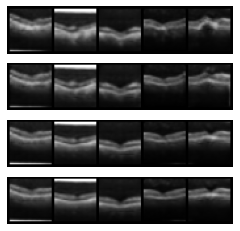

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_100.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_100.pth
Epoch: 100, Duration: 84.27623772621155 , Gen Loss: 4.883026572935154 Disc Loss: 0.346544769855966


In [172]:
# Runs the Cond GAN
run_GAN_pipeline(
    train_loader, None, None, #val_loader, test_loader, 
    n_channels, latent_dims, n_classes,
    epochs=epochs, name_dataset=name_dataset
)

#### Generating an upgraded dataset without Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [173]:
# Removes saved intermediary models
model_path = f"trained_models/conditionalGAN/{name_dataset}/gen_models/"
models = [x for x in os.listdir(model_path) 
          if x[-(4+len(str(epochs))):]!=f"{epochs}.pth"]
for model in models:
    os.remove(model_path+model)
# Fetches the generated GAN Model model to import
model_path += f"gen_model_{epochs}.pth"

# Calculates the number of images to generate
percentage = 4
nb_images_in_dataset = len(base_dataset[0])
n_generated_images = int((percentage/100)*nb_images_in_dataset)
print(f"Number of generated images: {n_generated_images}",
      f"({percentage}% of the dataset)")

# Creates the augmented dataloader
condGAN_loader = generate_augmented_dataset_condGAN(
    n_channels, n_classes, latent_dims, model_path,
    base_dataset[0], 64, 
    test_loader, val_loader, n_generated_images,
    weighted_sampling=False
)

Number of generated images: 3899 (4% of the dataset)


2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "OCTMNIST",
  "description": "The OCTMNIST is based on a prior dataset of 109,309 valid optical coherence tomography (OCT) images for retinal diseases. The dataset is comprised of 4 diagnosis categories, leading to a multi-class classification task. We split the source training set with a ratio of 9:1 into training and validation set, and use its source validation set as the test set. The source images are gray-scale, and their sizes are (384\u22121,536)\u00d7(277\u2212512). We center-crop the images and resize them into 1\u00d728\u00d728.",
  "url": "https://zenodo.org/record/5208230/files/octmnist.npz?download=1",
  "MD5": "c68d92d5b585d8d81f7112f81e2d0842",
  "task": "multi-class",
  "label": {
    "0": "choroidal neovascularization",
    "1": "diabetic macular edema",
    "2": "drusen",
    "3": "normal"
  },
  "n_channels": 1,
  "n_samples": {
    "train": 97477,
    "val": 10832,
    "test": 1000
  },
  "license": "CC BY 4.0"
}
--------------------------------

100%|██████████████████████████████████████| 1584/1584 [00:15<00:00, 105.43it/s]


train -- accuracy: 0.78
val -- accuracy: 0.9,  AUC: 0.78
Epoch 1



100%|██████████████████████████████████████| 1584/1584 [00:15<00:00, 103.61it/s]


train -- accuracy: 0.85
val -- accuracy: 0.95,  AUC: 0.87
Epoch 2



100%|██████████████████████████████████████| 1584/1584 [00:15<00:00, 105.30it/s]


train -- accuracy: 0.87
val -- accuracy: 0.95,  AUC: 0.84
Epoch 3



100%|███████████████████████████████████████| 1584/1584 [00:16<00:00, 96.46it/s]


train -- accuracy: 0.88
val -- accuracy: 0.96,  AUC: 0.89
Epoch 4



100%|███████████████████████████████████████| 1584/1584 [00:16<00:00, 95.97it/s]


train -- accuracy: 0.89
val -- accuracy: 0.96,  AUC: 0.89
Epoch 5



100%|███████████████████████████████████████| 1584/1584 [00:16<00:00, 97.02it/s]


train -- accuracy: 0.9
val -- accuracy: 0.96,  AUC: 0.89
Epoch 6



100%|███████████████████████████████████████| 1584/1584 [00:16<00:00, 97.37it/s]


train -- accuracy: 0.91
val -- accuracy: 0.97,  AUC: 0.9
Epoch 7



100%|███████████████████████████████████████| 1584/1584 [00:15<00:00, 99.39it/s]


train -- accuracy: 0.92
val -- accuracy: 0.97,  AUC: 0.9
Epoch 8



100%|██████████████████████████████████████| 1584/1584 [00:15<00:00, 101.19it/s]


train -- accuracy: 0.92
val -- accuracy: 0.97,  AUC: 0.9
Epoch 9



100%|██████████████████████████████████████| 1584/1584 [00:15<00:00, 101.66it/s]


train -- accuracy: 0.93
val -- accuracy: 0.96,  AUC: 0.89
Epoch 10



100%|██████████████████████████████████████| 1584/1584 [00:15<00:00, 103.22it/s]


train -- accuracy: 0.93
val -- accuracy: 0.97,  AUC: 0.9
Epoch 11



100%|██████████████████████████████████████| 1584/1584 [00:15<00:00, 101.99it/s]


train -- accuracy: 0.94
val -- accuracy: 0.97,  AUC: 0.9
Epoch 12



100%|██████████████████████████████████████| 1584/1584 [00:15<00:00, 102.31it/s]


train -- accuracy: 0.94
val -- accuracy: 0.97,  AUC: 0.91
Epoch 13



100%|██████████████████████████████████████| 1584/1584 [00:15<00:00, 103.39it/s]


train -- accuracy: 0.94
val -- accuracy: 0.96,  AUC: 0.88
Epoch 14



100%|██████████████████████████████████████| 1584/1584 [00:15<00:00, 101.63it/s]


train -- accuracy: 0.95
val -- accuracy: 0.97,  AUC: 0.91
Epoch 15



100%|██████████████████████████████████████| 1584/1584 [00:15<00:00, 103.88it/s]


train -- accuracy: 0.95
val -- accuracy: 0.97,  AUC: 0.89
Epoch 16



100%|██████████████████████████████████████| 1584/1584 [00:15<00:00, 101.60it/s]


train -- accuracy: 0.95
val -- accuracy: 0.97,  AUC: 0.9
Epoch 17



100%|██████████████████████████████████████| 1584/1584 [00:15<00:00, 103.09it/s]


train -- accuracy: 0.96
val -- accuracy: 0.97,  AUC: 0.89
Epoch 18



100%|██████████████████████████████████████| 1584/1584 [00:15<00:00, 101.64it/s]


train -- accuracy: 0.96
val -- accuracy: 0.97,  AUC: 0.91
Epoch 19



100%|██████████████████████████████████████| 1584/1584 [00:14<00:00, 106.81it/s]


train -- accuracy: 0.96
val -- accuracy: 0.97,  AUC: 0.89
test -- accuracy: 0.93,  AUC: 0.71


<Figure size 720x720 with 0 Axes>

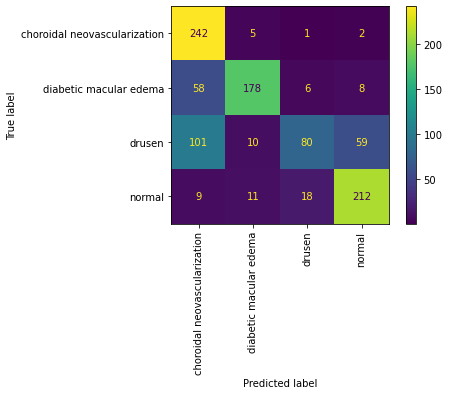

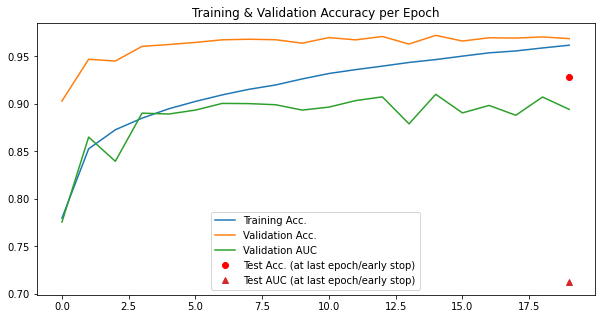

In [174]:
# Runs the classifier again 

clf = run_classifier_pipeline(name_dataset, info_flags, condGAN_loader)

#### Generating an upgraded dataset with Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [175]:
# Creates the augmented dataloader
condGAN_loader = generate_augmented_dataset_condGAN(
    n_channels, n_classes, latent_dims, model_path,
    base_dataset[0], 64, 
    test_loader, val_loader, n_generated_images,
    weighted_sampling=True
)

2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "OCTMNIST",
  "description": "The OCTMNIST is based on a prior dataset of 109,309 valid optical coherence tomography (OCT) images for retinal diseases. The dataset is comprised of 4 diagnosis categories, leading to a multi-class classification task. We split the source training set with a ratio of 9:1 into training and validation set, and use its source validation set as the test set. The source images are gray-scale, and their sizes are (384\u22121,536)\u00d7(277\u2212512). We center-crop the images and resize them into 1\u00d728\u00d728.",
  "url": "https://zenodo.org/record/5208230/files/octmnist.npz?download=1",
  "MD5": "c68d92d5b585d8d81f7112f81e2d0842",
  "task": "multi-class",
  "label": {
    "0": "choroidal neovascularization",
    "1": "diabetic macular edema",
    "2": "drusen",
    "3": "normal"
  },
  "n_channels": 1,
  "n_samples": {
    "train": 97477,
    "val": 10832,
    "test": 1000
  },
  "license": "CC BY 4.0"
}
--------------------------------

100%|██████████████████████████████████████| 1584/1584 [00:13<00:00, 113.90it/s]


train -- accuracy: 0.7
val -- accuracy: 0.94,  AUC: 0.67
Epoch 1



100%|██████████████████████████████████████| 1584/1584 [00:13<00:00, 114.61it/s]


train -- accuracy: 0.82
val -- accuracy: 0.96,  AUC: 0.77
Epoch 2



100%|██████████████████████████████████████| 1584/1584 [00:13<00:00, 114.90it/s]


train -- accuracy: 0.85
val -- accuracy: 0.96,  AUC: 0.86
Epoch 3



100%|██████████████████████████████████████| 1584/1584 [00:13<00:00, 114.85it/s]


train -- accuracy: 0.87
val -- accuracy: 0.96,  AUC: 0.88
Epoch 4



100%|██████████████████████████████████████| 1584/1584 [00:13<00:00, 114.54it/s]


train -- accuracy: 0.89
val -- accuracy: 0.96,  AUC: 0.86
Epoch 5



100%|██████████████████████████████████████| 1584/1584 [00:13<00:00, 114.84it/s]


train -- accuracy: 0.9
val -- accuracy: 0.97,  AUC: 0.85
Epoch 6



100%|██████████████████████████████████████| 1584/1584 [00:13<00:00, 115.07it/s]


train -- accuracy: 0.91
val -- accuracy: 0.97,  AUC: 0.87
Epoch 7



100%|██████████████████████████████████████| 1584/1584 [00:13<00:00, 115.10it/s]


train -- accuracy: 0.92
val -- accuracy: 0.97,  AUC: 0.9
Epoch 8



100%|██████████████████████████████████████| 1584/1584 [00:13<00:00, 115.26it/s]


train -- accuracy: 0.93
val -- accuracy: 0.97,  AUC: 0.85
Epoch 9



100%|██████████████████████████████████████| 1584/1584 [00:13<00:00, 114.75it/s]


train -- accuracy: 0.94
val -- accuracy: 0.97,  AUC: 0.89
Epoch 10



100%|██████████████████████████████████████| 1584/1584 [00:13<00:00, 114.88it/s]


train -- accuracy: 0.94
val -- accuracy: 0.97,  AUC: 0.9
Epoch 11



100%|██████████████████████████████████████| 1584/1584 [00:13<00:00, 114.94it/s]


train -- accuracy: 0.95
val -- accuracy: 0.97,  AUC: 0.88
Epoch 12



100%|██████████████████████████████████████| 1584/1584 [00:13<00:00, 114.27it/s]


train -- accuracy: 0.96
val -- accuracy: 0.97,  AUC: 0.89
Epoch 13



100%|██████████████████████████████████████| 1584/1584 [00:13<00:00, 114.82it/s]


train -- accuracy: 0.96
val -- accuracy: 0.97,  AUC: 0.86
Epoch 14



100%|██████████████████████████████████████| 1584/1584 [00:13<00:00, 115.03it/s]


train -- accuracy: 0.96
val -- accuracy: 0.97,  AUC: 0.91
Epoch 15



100%|██████████████████████████████████████| 1584/1584 [00:13<00:00, 113.66it/s]


train -- accuracy: 0.97
val -- accuracy: 0.97,  AUC: 0.91
Epoch 16



100%|██████████████████████████████████████| 1584/1584 [00:14<00:00, 109.80it/s]


train -- accuracy: 0.97
val -- accuracy: 0.97,  AUC: 0.91
Epoch 17



100%|██████████████████████████████████████| 1584/1584 [00:14<00:00, 108.73it/s]


train -- accuracy: 0.97
val -- accuracy: 0.97,  AUC: 0.91
Epoch 18



100%|██████████████████████████████████████| 1584/1584 [00:14<00:00, 111.34it/s]


train -- accuracy: 0.97
val -- accuracy: 0.97,  AUC: 0.89
Epoch 19



100%|██████████████████████████████████████| 1584/1584 [00:13<00:00, 114.57it/s]


train -- accuracy: 0.98
val -- accuracy: 0.97,  AUC: 0.89
test -- accuracy: 0.93,  AUC: 0.71


<Figure size 720x720 with 0 Axes>

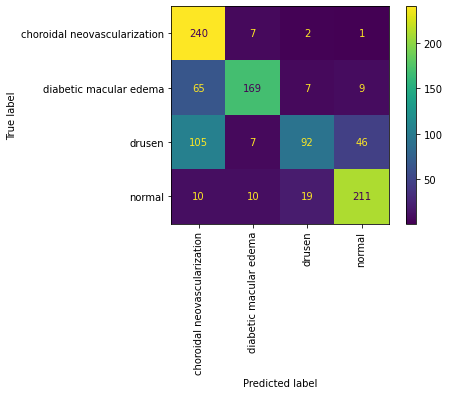

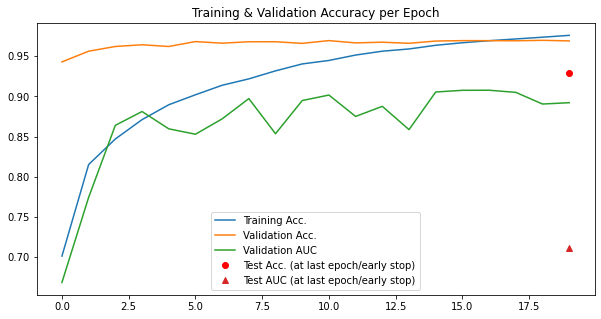

In [176]:
# Runs the classifier again 

clf = run_classifier_pipeline(name_dataset, info_flags, condGAN_loader)

### PneumoniaMNIST

#### Training the Conditional GAN

In [177]:
# Declares the dataset name and retrieves the base dataset
name_dataset = "pneumoniamnist"
base_dataset = pneumoniamnist_noWRS_noGDA_upscaled

# Retrieves the dataset parameters
n_classes  = len(info_flags[name_dataset][0]["label"])
n_channels = info_flags[name_dataset][0]["n_channels"]

# Retrieves the data loader
train_loader = base_dataset[3] #####################################################
val_loader = base_dataset[5]   ### OF NOTE #########################################
test_loader = base_dataset[4]  ### EVALUATE/TEST NOT IMPLEMENTED YET IN ############
                               ### TORCHFUSION AT THE TIME OF CREATION OF NOTEBOOK #
                               ### Thus the use of None below in the pipeline ######
                               #####################################################

Path trained_models/conditionalGAN/pneumoniamnist/ created.
Epoch 1 of 100
New Generator model saved at trained_models/conditionalGAN/pneumoniamnist/gen_models/gen_model_1.pth
New Discriminator model saved at trained_models/conditionalGAN/pneumoniamnist/disc_models/disc_model_1.pth
Epoch: 1, Duration: 4.044856786727905 , Gen Loss: 1.3565436325138063 Disc Loss: 0.39265196872344943
Epoch 2 of 100
New Generator model saved at trained_models/conditionalGAN/pneumoniamnist/gen_models/gen_model_2.pth
New Discriminator model saved at trained_models/conditionalGAN/pneumoniamnist/disc_models/disc_model_2.pth
Epoch: 2, Duration: 3.562565326690674 , Gen Loss: 2.007999183570518 Disc Loss: 0.2186219661845529
Epoch 3 of 100
New Generator model saved at trained_models/conditionalGAN/pneumoniamnist/gen_models/gen_model_3.pth
New Discriminator model saved at trained_models/conditionalGAN/pneumoniamnist/disc_models/disc_model_3.pth
Epoch: 3, Duration: 3.5473926067352295 , Gen Loss: 2.0393180490654204 Dis

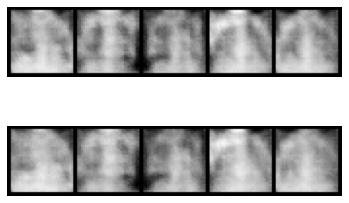

New Generator model saved at trained_models/conditionalGAN/pneumoniamnist/gen_models/gen_model_14.pth
New Discriminator model saved at trained_models/conditionalGAN/pneumoniamnist/disc_models/disc_model_14.pth
Epoch: 14, Duration: 3.6524548530578613 , Gen Loss: 2.638624166976423 Disc Loss: 0.277481610631173
Epoch 15 of 100
New Generator model saved at trained_models/conditionalGAN/pneumoniamnist/gen_models/gen_model_15.pth
New Discriminator model saved at trained_models/conditionalGAN/pneumoniamnist/disc_models/disc_model_15.pth
Epoch: 15, Duration: 3.5386745929718018 , Gen Loss: 2.365817242592396 Disc Loss: 0.30965201249037544
Epoch 16 of 100
New Generator model saved at trained_models/conditionalGAN/pneumoniamnist/gen_models/gen_model_16.pth
New Discriminator model saved at trained_models/conditionalGAN/pneumoniamnist/disc_models/disc_model_16.pth
Epoch: 16, Duration: 3.5383286476135254 , Gen Loss: 1.9115806456430544 Disc Loss: 0.36366073621362577
Epoch 17 of 100
New Generator model 

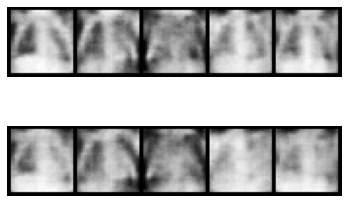

New Generator model saved at trained_models/conditionalGAN/pneumoniamnist/gen_models/gen_model_28.pth
New Discriminator model saved at trained_models/conditionalGAN/pneumoniamnist/disc_models/disc_model_28.pth
Epoch: 28, Duration: 3.651517629623413 , Gen Loss: 1.1489822011735344 Disc Loss: 0.48068649564239063
Epoch 29 of 100
New Generator model saved at trained_models/conditionalGAN/pneumoniamnist/gen_models/gen_model_29.pth
New Discriminator model saved at trained_models/conditionalGAN/pneumoniamnist/disc_models/disc_model_29.pth
Epoch: 29, Duration: 3.541666269302368 , Gen Loss: 1.134902422571952 Disc Loss: 0.5023950464966547
Epoch 30 of 100
New Generator model saved at trained_models/conditionalGAN/pneumoniamnist/gen_models/gen_model_30.pth
New Discriminator model saved at trained_models/conditionalGAN/pneumoniamnist/disc_models/disc_model_30.pth
Epoch: 30, Duration: 3.54329252243042 , Gen Loss: 1.116798368468564 Disc Loss: 0.4828848502548853
Epoch 31 of 100
New Generator model save

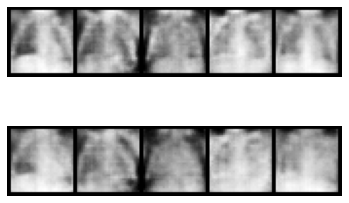

New Generator model saved at trained_models/conditionalGAN/pneumoniamnist/gen_models/gen_model_41.pth
New Discriminator model saved at trained_models/conditionalGAN/pneumoniamnist/disc_models/disc_model_41.pth
Epoch: 41, Duration: 3.6544225215911865 , Gen Loss: 1.1305072690433835 Disc Loss: 0.4805710111114061
Epoch 42 of 100
New Generator model saved at trained_models/conditionalGAN/pneumoniamnist/gen_models/gen_model_42.pth
New Discriminator model saved at trained_models/conditionalGAN/pneumoniamnist/disc_models/disc_model_42.pth
Epoch: 42, Duration: 3.542539596557617 , Gen Loss: 1.1800330720316483 Disc Loss: 0.47914734146001486
Epoch 43 of 100
New Generator model saved at trained_models/conditionalGAN/pneumoniamnist/gen_models/gen_model_43.pth
New Discriminator model saved at trained_models/conditionalGAN/pneumoniamnist/disc_models/disc_model_43.pth
Epoch: 43, Duration: 3.615574836730957 , Gen Loss: 1.144560289666525 Disc Loss: 0.48872789044246495
Epoch 44 of 100
New Generator model 

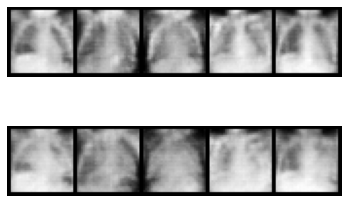

New Generator model saved at trained_models/conditionalGAN/pneumoniamnist/gen_models/gen_model_55.pth
New Discriminator model saved at trained_models/conditionalGAN/pneumoniamnist/disc_models/disc_model_55.pth
Epoch: 55, Duration: 3.6577463150024414 , Gen Loss: 1.1305343381611088 Disc Loss: 0.4772491325436757
Epoch 56 of 100
New Generator model saved at trained_models/conditionalGAN/pneumoniamnist/gen_models/gen_model_56.pth
New Discriminator model saved at trained_models/conditionalGAN/pneumoniamnist/disc_models/disc_model_56.pth
Epoch: 56, Duration: 3.550534725189209 , Gen Loss: 1.132917976217343 Disc Loss: 0.47013000643850894
Epoch 57 of 100
New Generator model saved at trained_models/conditionalGAN/pneumoniamnist/gen_models/gen_model_57.pth
New Discriminator model saved at trained_models/conditionalGAN/pneumoniamnist/disc_models/disc_model_57.pth
Epoch: 57, Duration: 3.5477263927459717 , Gen Loss: 1.142590881710652 Disc Loss: 0.48188738956629673
Epoch 58 of 100
New Generator model 

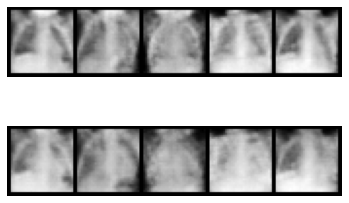

New Generator model saved at trained_models/conditionalGAN/pneumoniamnist/gen_models/gen_model_68.pth
New Discriminator model saved at trained_models/conditionalGAN/pneumoniamnist/disc_models/disc_model_68.pth
Epoch: 68, Duration: 3.800257682800293 , Gen Loss: 1.0642703825270816 Disc Loss: 0.506175596225839
Epoch 69 of 100
New Generator model saved at trained_models/conditionalGAN/pneumoniamnist/gen_models/gen_model_69.pth
New Discriminator model saved at trained_models/conditionalGAN/pneumoniamnist/disc_models/disc_model_69.pth
Epoch: 69, Duration: 3.560234308242798 , Gen Loss: 1.0794062715723236 Disc Loss: 0.5117835706842078
Epoch 70 of 100
New Generator model saved at trained_models/conditionalGAN/pneumoniamnist/gen_models/gen_model_70.pth
New Discriminator model saved at trained_models/conditionalGAN/pneumoniamnist/disc_models/disc_model_70.pth
Epoch: 70, Duration: 3.5630595684051514 , Gen Loss: 1.0596293252509028 Disc Loss: 0.49633120113038975
Epoch 71 of 100
New Generator model s

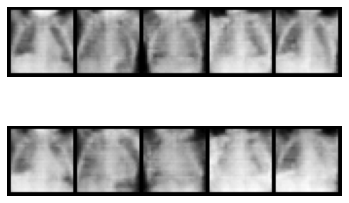

New Generator model saved at trained_models/conditionalGAN/pneumoniamnist/gen_models/gen_model_82.pth
New Discriminator model saved at trained_models/conditionalGAN/pneumoniamnist/disc_models/disc_model_82.pth
Epoch: 82, Duration: 3.76102352142334 , Gen Loss: 1.0098070065247982 Disc Loss: 0.5413753538690792
Epoch 83 of 100
New Generator model saved at trained_models/conditionalGAN/pneumoniamnist/gen_models/gen_model_83.pth
New Discriminator model saved at trained_models/conditionalGAN/pneumoniamnist/disc_models/disc_model_83.pth
Epoch: 83, Duration: 3.560809850692749 , Gen Loss: 1.01500697366849 Disc Loss: 0.5463414998406967
Epoch 84 of 100
New Generator model saved at trained_models/conditionalGAN/pneumoniamnist/gen_models/gen_model_84.pth
New Discriminator model saved at trained_models/conditionalGAN/pneumoniamnist/disc_models/disc_model_84.pth
Epoch: 84, Duration: 3.5714778900146484 , Gen Loss: 1.079345703125 Disc Loss: 0.5532000986518957
Epoch 85 of 100
New Generator model saved at

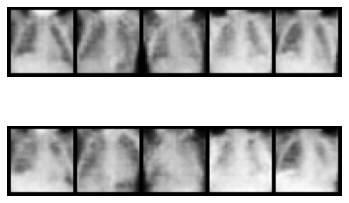

New Generator model saved at trained_models/conditionalGAN/pneumoniamnist/gen_models/gen_model_95.pth
New Discriminator model saved at trained_models/conditionalGAN/pneumoniamnist/disc_models/disc_model_95.pth
Epoch: 95, Duration: 3.685019016265869 , Gen Loss: 0.9894234423122876 Disc Loss: 0.5568081735045401
Epoch 96 of 100
New Generator model saved at trained_models/conditionalGAN/pneumoniamnist/gen_models/gen_model_96.pth
New Discriminator model saved at trained_models/conditionalGAN/pneumoniamnist/disc_models/disc_model_96.pth
Epoch: 96, Duration: 3.558730363845825 , Gen Loss: 1.0103771174065421 Disc Loss: 0.5577634229635726
Epoch 97 of 100
New Generator model saved at trained_models/conditionalGAN/pneumoniamnist/gen_models/gen_model_97.pth
New Discriminator model saved at trained_models/conditionalGAN/pneumoniamnist/disc_models/disc_model_97.pth
Epoch: 97, Duration: 3.5588362216949463 , Gen Loss: 0.992006935502071 Disc Loss: 0.5631558816110875
Epoch 98 of 100
New Generator model sa

In [178]:
# Runs the Cond GAN
run_GAN_pipeline(
    train_loader, None, None, #val_loader, test_loader, 
    n_channels, latent_dims, n_classes,
    epochs=epochs, name_dataset=name_dataset
)

#### Generating an upgraded dataset without Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [179]:
# Removes saved intermediary models
model_path = f"trained_models/conditionalGAN/{name_dataset}/gen_models/"
models = [x for x in os.listdir(model_path) 
          if x[-(4+len(str(epochs))):]!=f"{epochs}.pth"]
for model in models:
    os.remove(model_path+model)
# Fetches the generated GAN Model model to import
model_path += f"gen_model_{epochs}.pth"

# Calculates the number of images to generate
percentage = 10
nb_images_in_dataset = len(base_dataset[0])
n_generated_images = int((percentage/100)*nb_images_in_dataset)
print(f"Number of generated images: {n_generated_images}",
      f"({percentage}% of the dataset)")

# Creates the augmented dataloader
condGAN_loader = generate_augmented_dataset_condGAN(
    n_channels, n_classes, latent_dims, model_path,
    base_dataset[0], 64, 
    test_loader, val_loader, n_generated_images,
    weighted_sampling=False
)

Number of generated images: 470 (10% of the dataset)


2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "PneumoniaMNIST",
  "description": "The PneumoniaMNIST is based on a prior dataset of 5,856 pediatric chest X-Ray images. The task is binary-class classification of pneumonia against normal. We split the source training set with a ratio of 9:1 into training and validation set and use its source validation set as the test set. The source images are gray-scale, and their sizes are (384\u22122,916)\u00d7(127\u22122,713). We center-crop the images and resize them into 1\u00d728\u00d728.",
  "url": "https://zenodo.org/record/5208230/files/pneumoniamnist.npz?download=1",
  "MD5": "28209eda62fecd6e6a2d98b1501bb15f",
  "task": "binary-class",
  "label": {
    "0": "normal",
    "1": "pneumonia"
  },
  "n_channels": 1,
  "n_samples": {
    "train": 4708,
    "val": 524,
    "test": 624
  },
  "license": "CC BY 4.0"
}
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           

100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 115.59it/s]


train -- accuracy: 0.82
val -- accuracy: 0.97,  AUC: 0.9
Epoch 1



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 112.01it/s]


train -- accuracy: 0.94
val -- accuracy: 0.99,  AUC: 0.95
Epoch 2



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 114.50it/s]


train -- accuracy: 0.96
val -- accuracy: 0.99,  AUC: 0.96
Epoch 3



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 112.78it/s]


train -- accuracy: 0.96
val -- accuracy: 0.99,  AUC: 0.96
Epoch 4



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 114.61it/s]


train -- accuracy: 0.97
val -- accuracy: 1.0,  AUC: 0.97
Epoch 5



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 114.52it/s]


train -- accuracy: 0.98
val -- accuracy: 1.0,  AUC: 0.96
Epoch 6



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 114.92it/s]


train -- accuracy: 0.98
val -- accuracy: 1.0,  AUC: 0.97
Epoch 7



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 114.64it/s]


train -- accuracy: 0.98
val -- accuracy: 1.0,  AUC: 0.97
Epoch 8



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 114.91it/s]


train -- accuracy: 0.99
val -- accuracy: 1.0,  AUC: 0.96
Epoch 9



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 115.49it/s]


train -- accuracy: 0.99
val -- accuracy: 1.0,  AUC: 0.98
Epoch 10



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 114.86it/s]


train -- accuracy: 0.99
val -- accuracy: 1.0,  AUC: 0.98
Epoch 11



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 114.59it/s]


train -- accuracy: 0.99
val -- accuracy: 1.0,  AUC: 0.97
Epoch 12



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 114.54it/s]


train -- accuracy: 1.0
val -- accuracy: 1.0,  AUC: 0.99
Epoch 13



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 115.39it/s]


train -- accuracy: 1.0
val -- accuracy: 1.0,  AUC: 0.98
Epoch 14



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 115.10it/s]


train -- accuracy: 1.0
val -- accuracy: 1.0,  AUC: 0.98
Epoch 15



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 115.01it/s]


train -- accuracy: 1.0
val -- accuracy: 1.0,  AUC: 0.98
Epoch 16



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 115.07it/s]


train -- accuracy: 1.0
val -- accuracy: 1.0,  AUC: 0.98
Epoch 17



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 114.62it/s]


train -- accuracy: 1.0
val -- accuracy: 1.0,  AUC: 0.98
Epoch 18



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 114.59it/s]


train -- accuracy: 1.0
val -- accuracy: 1.0,  AUC: 0.98
Epoch 19



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 115.53it/s]


train -- accuracy: 1.0
val -- accuracy: 1.0,  AUC: 0.98
test -- accuracy: 0.96,  AUC: 0.87


<Figure size 720x720 with 0 Axes>

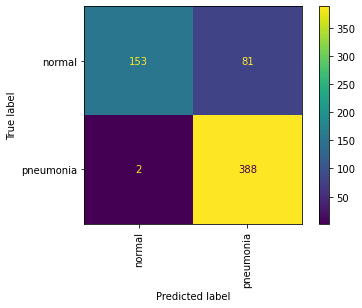

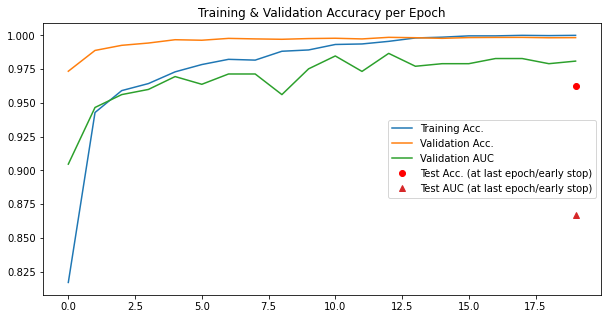

In [180]:
# Runs the classifier again 

clf = run_classifier_pipeline(name_dataset, info_flags, condGAN_loader)

#### Generating an upgraded dataset with Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [181]:
# Creates the augmented dataloader
condGAN_loader = generate_augmented_dataset_condGAN(
    n_channels, n_classes, latent_dims, model_path,
    base_dataset[0], 64, 
    test_loader, val_loader, n_generated_images,
    weighted_sampling=True
)

2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "PneumoniaMNIST",
  "description": "The PneumoniaMNIST is based on a prior dataset of 5,856 pediatric chest X-Ray images. The task is binary-class classification of pneumonia against normal. We split the source training set with a ratio of 9:1 into training and validation set and use its source validation set as the test set. The source images are gray-scale, and their sizes are (384\u22122,916)\u00d7(127\u22122,713). We center-crop the images and resize them into 1\u00d728\u00d728.",
  "url": "https://zenodo.org/record/5208230/files/pneumoniamnist.npz?download=1",
  "MD5": "28209eda62fecd6e6a2d98b1501bb15f",
  "task": "binary-class",
  "label": {
    "0": "normal",
    "1": "pneumonia"
  },
  "n_channels": 1,
  "n_samples": {
    "train": 4708,
    "val": 524,
    "test": 624
  },
  "license": "CC BY 4.0"
}
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           

100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 114.64it/s]


train -- accuracy: 0.82
val -- accuracy: 0.98,  AUC: 0.93
Epoch 1



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 113.68it/s]


train -- accuracy: 0.94
val -- accuracy: 0.99,  AUC: 0.95
Epoch 2



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 114.04it/s]


train -- accuracy: 0.96
val -- accuracy: 0.99,  AUC: 0.95
Epoch 3



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 114.51it/s]


train -- accuracy: 0.97
val -- accuracy: 1.0,  AUC: 0.97
Epoch 4



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 114.39it/s]


train -- accuracy: 0.97
val -- accuracy: 1.0,  AUC: 0.94
Epoch 5



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 114.48it/s]


train -- accuracy: 0.98
val -- accuracy: 1.0,  AUC: 0.97
Epoch 6



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 114.29it/s]


train -- accuracy: 0.99
val -- accuracy: 1.0,  AUC: 0.94
Epoch 7



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 113.84it/s]


train -- accuracy: 0.99
val -- accuracy: 1.0,  AUC: 0.98
Epoch 8



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 113.60it/s]


train -- accuracy: 0.99
val -- accuracy: 1.0,  AUC: 0.97
Epoch 9



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 114.60it/s]


train -- accuracy: 0.99
val -- accuracy: 1.0,  AUC: 0.97
Epoch 10



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 112.68it/s]


train -- accuracy: 0.99
val -- accuracy: 1.0,  AUC: 0.97
Epoch 11



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 114.17it/s]


train -- accuracy: 1.0
val -- accuracy: 1.0,  AUC: 0.98
Epoch 12



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 114.57it/s]


train -- accuracy: 1.0
val -- accuracy: 1.0,  AUC: 0.97
Epoch 13



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 114.31it/s]


train -- accuracy: 1.0
val -- accuracy: 1.0,  AUC: 0.97
Epoch 14



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 113.99it/s]


train -- accuracy: 1.0
val -- accuracy: 1.0,  AUC: 0.97
Epoch 15



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 114.81it/s]


train -- accuracy: 1.0
val -- accuracy: 1.0,  AUC: 0.98
Epoch 16



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 114.55it/s]


train -- accuracy: 1.0
val -- accuracy: 1.0,  AUC: 0.97
Epoch 17



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 115.08it/s]


train -- accuracy: 1.0
val -- accuracy: 1.0,  AUC: 0.98
Epoch 18



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 114.63it/s]


train -- accuracy: 1.0
val -- accuracy: 1.0,  AUC: 0.97
Epoch 19



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 115.20it/s]


train -- accuracy: 1.0
val -- accuracy: 1.0,  AUC: 0.98
test -- accuracy: 0.97,  AUC: 0.87


<Figure size 720x720 with 0 Axes>

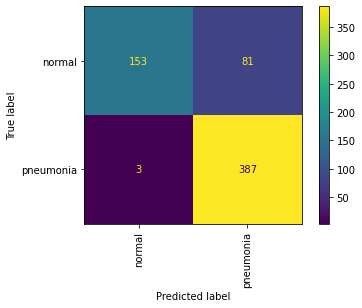

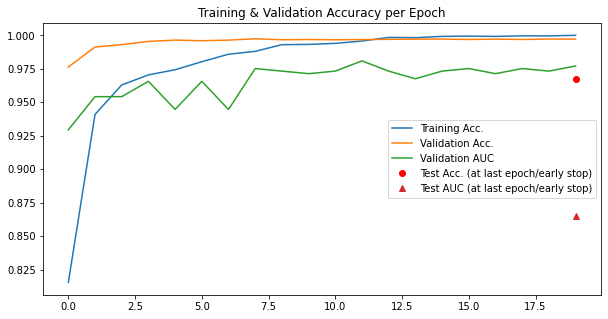

In [182]:
# Runs the classifier again 

clf = run_classifier_pipeline(name_dataset, info_flags, condGAN_loader)

### BreastMNIST

#### Training the Conditional GAN

In [183]:
# Declares the dataset name and retrieves the base dataset
name_dataset = "breastmnist"
base_dataset = breastmnist_noWRS_noGDA_upscaled

# Retrieves the dataset parameters
n_classes  = len(info_flags[name_dataset][0]["label"])
n_channels = info_flags[name_dataset][0]["n_channels"]

# Retrieves the data loader
train_loader = base_dataset[3] #####################################################
val_loader = base_dataset[5]   ### OF NOTE #########################################
test_loader = base_dataset[4]  ### EVALUATE/TEST NOT IMPLEMENTED YET IN ############
                               ### TORCHFUSION AT THE TIME OF CREATION OF NOTEBOOK #
                               ### Thus the use of None below in the pipeline ######
                               #####################################################

Path trained_models/conditionalGAN/breastmnist/ created.
Epoch 1 of 100
New Generator model saved at trained_models/conditionalGAN/breastmnist/gen_models/gen_model_1.pth
New Discriminator model saved at trained_models/conditionalGAN/breastmnist/disc_models/disc_model_1.pth
Epoch: 1, Duration: 0.5047628879547119 , Gen Loss: 0.7643274439996852 Disc Loss: 0.6548790564903846
Epoch 2 of 100
New Generator model saved at trained_models/conditionalGAN/breastmnist/gen_models/gen_model_2.pth
New Discriminator model saved at trained_models/conditionalGAN/breastmnist/disc_models/disc_model_2.pth
Epoch: 2, Duration: 0.42822813987731934 , Gen Loss: 0.9587338625729739 Disc Loss: 0.5349932660113325
Epoch 3 of 100
New Generator model saved at trained_models/conditionalGAN/breastmnist/gen_models/gen_model_3.pth
New Discriminator model saved at trained_models/conditionalGAN/breastmnist/disc_models/disc_model_3.pth
Epoch: 3, Duration: 0.43047499656677246 , Gen Loss: 1.4319119296231113 Disc Loss: 0.3434645

New Generator model saved at trained_models/conditionalGAN/breastmnist/gen_models/gen_model_27.pth
New Discriminator model saved at trained_models/conditionalGAN/breastmnist/disc_models/disc_model_27.pth
Epoch: 27, Duration: 0.4296860694885254 , Gen Loss: 1.4212691198775182 Disc Loss: 0.47817998753362523
Epoch 28 of 100
New Generator model saved at trained_models/conditionalGAN/breastmnist/gen_models/gen_model_28.pth
New Discriminator model saved at trained_models/conditionalGAN/breastmnist/disc_models/disc_model_28.pth
Epoch: 28, Duration: 0.4273641109466553 , Gen Loss: 1.3806861066992904 Disc Loss: 0.46740731040200034
Epoch 29 of 100
New Generator model saved at trained_models/conditionalGAN/breastmnist/gen_models/gen_model_29.pth
New Discriminator model saved at trained_models/conditionalGAN/breastmnist/disc_models/disc_model_29.pth
Epoch: 29, Duration: 0.42835521697998047 , Gen Loss: 1.2646881215301626 Disc Loss: 0.46182860210265
Epoch 30 of 100
New Generator model saved at trained

New Generator model saved at trained_models/conditionalGAN/breastmnist/gen_models/gen_model_53.pth
New Discriminator model saved at trained_models/conditionalGAN/breastmnist/disc_models/disc_model_53.pth
Epoch: 53, Duration: 0.42875194549560547 , Gen Loss: 1.3073150299407623 Disc Loss: 0.5379113277672848
Epoch 54 of 100
New Generator model saved at trained_models/conditionalGAN/breastmnist/gen_models/gen_model_54.pth
New Discriminator model saved at trained_models/conditionalGAN/breastmnist/disc_models/disc_model_54.pth
Epoch: 54, Duration: 0.4289069175720215 , Gen Loss: 1.2207709791022778 Disc Loss: 0.5345793224516369
Epoch 55 of 100
New Generator model saved at trained_models/conditionalGAN/breastmnist/gen_models/gen_model_55.pth
New Discriminator model saved at trained_models/conditionalGAN/breastmnist/disc_models/disc_model_55.pth
Epoch: 55, Duration: 0.42956995964050293 , Gen Loss: 1.1380291054973672 Disc Loss: 0.5739719824039893
Epoch 56 of 100
New Generator model saved at traine

New Generator model saved at trained_models/conditionalGAN/breastmnist/gen_models/gen_model_79.pth
New Discriminator model saved at trained_models/conditionalGAN/breastmnist/disc_models/disc_model_79.pth
Epoch: 79, Duration: 0.4283113479614258 , Gen Loss: 1.1920870267427885 Disc Loss: 0.5379546448424622
Epoch 80 of 100
New Generator model saved at trained_models/conditionalGAN/breastmnist/gen_models/gen_model_80.pth
New Discriminator model saved at trained_models/conditionalGAN/breastmnist/disc_models/disc_model_80.pth
Epoch: 80, Duration: 0.4280698299407959 , Gen Loss: 1.2341121911129236 Disc Loss: 0.47741872487050707
Epoch 81 of 100
New Generator model saved at trained_models/conditionalGAN/breastmnist/gen_models/gen_model_81.pth
New Discriminator model saved at trained_models/conditionalGAN/breastmnist/disc_models/disc_model_81.pth
Epoch: 81, Duration: 0.428328275680542 , Gen Loss: 1.1537680154318337 Disc Loss: 0.5236240149417639
Epoch 82 of 100
New Generator model saved at trained_

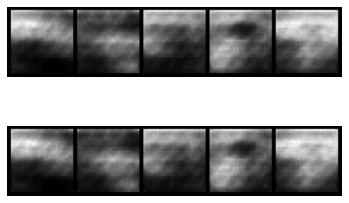

New Generator model saved at trained_models/conditionalGAN/breastmnist/gen_models/gen_model_100.pth
New Discriminator model saved at trained_models/conditionalGAN/breastmnist/disc_models/disc_model_100.pth
Epoch: 100, Duration: 0.5364770889282227 , Gen Loss: 0.9727051004822 Disc Loss: 0.6588050926124657


In [184]:
# Runs the Cond GAN
run_GAN_pipeline(
    train_loader, None, None, #val_loader, test_loader, 
    n_channels, latent_dims, n_classes,
    epochs=epochs, name_dataset=name_dataset
)

#### Generating an upgraded dataset without Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [185]:
# Removes saved intermediary models
model_path = f"trained_models/conditionalGAN/{name_dataset}/gen_models/"
models = [x for x in os.listdir(model_path) 
          if x[-(4+len(str(epochs))):]!=f"{epochs}.pth"]
for model in models:
    os.remove(model_path+model)
# Fetches the generated GAN Model model to import
model_path += f"gen_model_{epochs}.pth"

# Calculates the number of images to generate
percentage = 10
nb_images_in_dataset = len(base_dataset[0])
n_generated_images = int((percentage/100)*nb_images_in_dataset)
print(f"Number of generated images: {n_generated_images}",
      f"({percentage}% of the dataset)")

# Creates the augmented dataloader
condGAN_loader = generate_augmented_dataset_condGAN(
    n_channels, n_classes, latent_dims, model_path,
    base_dataset[0], 64, 
    test_loader, val_loader, n_generated_images,
    weighted_sampling=False
)

Number of generated images: 54 (10% of the dataset)


2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "BreastMNIST",
  "description": "The BreastMNIST is based on a dataset of 780 breast ultrasound images. It is categorized into 3 classes: normal, benign, and malignant. As we use low-resolution images, we simplify the task into binary classification by combining normal and benign as positive and classifying them against malignant as negative. We split the source dataset with a ratio of 7:1:2 into training, validation and test set. The source images of 1\u00d7500\u00d7500 are resized into 1\u00d728\u00d728.",
  "url": "https://zenodo.org/record/5208230/files/breastmnist.npz?download=1",
  "MD5": "750601b1f35ba3300ea97c75c52ff8f6",
  "task": "binary-class",
  "label": {
    "0": "malignant",
    "1": "normal, benign"
  },
  "n_channels": 1,
  "n_samples": {
    "train": 546,
    "val": 78,
    "test": 156
  },
  "license": "CC BY 4.0"
}
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
    

100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 113.83it/s]


train -- accuracy: 0.67
val -- accuracy: 0.37,  AUC: 0.73
Epoch 1



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 116.28it/s]


train -- accuracy: 0.73
val -- accuracy: 0.44,  AUC: 0.73
Epoch 2



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 112.91it/s]


train -- accuracy: 0.73
val -- accuracy: 0.68,  AUC: 0.73
Epoch 3



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 116.36it/s]


train -- accuracy: 0.73
val -- accuracy: 0.7,  AUC: 0.73
Epoch 4



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 116.20it/s]


train -- accuracy: 0.73
val -- accuracy: 0.75,  AUC: 0.73
Epoch 5



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 115.31it/s]


train -- accuracy: 0.73
val -- accuracy: 0.78,  AUC: 0.73
Epoch 6



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 115.71it/s]


train -- accuracy: 0.73
val -- accuracy: 0.79,  AUC: 0.73
Epoch 7



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 112.59it/s]


train -- accuracy: 0.73
val -- accuracy: 0.8,  AUC: 0.73
Epoch 8



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 116.65it/s]


train -- accuracy: 0.74
val -- accuracy: 0.8,  AUC: 0.77
Epoch 9



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 115.10it/s]


train -- accuracy: 0.74
val -- accuracy: 0.82,  AUC: 0.78
Epoch 10



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 111.98it/s]


train -- accuracy: 0.77
val -- accuracy: 0.83,  AUC: 0.77
Epoch 11



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 116.36it/s]


train -- accuracy: 0.78
val -- accuracy: 0.83,  AUC: 0.83
Epoch 12



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 114.79it/s]


train -- accuracy: 0.79
val -- accuracy: 0.85,  AUC: 0.78
Epoch 13



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 115.88it/s]


train -- accuracy: 0.8
val -- accuracy: 0.85,  AUC: 0.83
Epoch 14



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 117.59it/s]


train -- accuracy: 0.81
val -- accuracy: 0.87,  AUC: 0.86
Epoch 15



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 115.56it/s]


train -- accuracy: 0.82
val -- accuracy: 0.84,  AUC: 0.83
Epoch 16



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 115.91it/s]


train -- accuracy: 0.82
val -- accuracy: 0.88,  AUC: 0.87
Epoch 17



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 118.45it/s]


train -- accuracy: 0.84
val -- accuracy: 0.83,  AUC: 0.79
Epoch 18



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 115.63it/s]


train -- accuracy: 0.84
val -- accuracy: 0.89,  AUC: 0.76
Epoch 19



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 115.34it/s]


train -- accuracy: 0.86
val -- accuracy: 0.91,  AUC: 0.86
test -- accuracy: 0.86,  AUC: 0.79


<Figure size 720x720 with 0 Axes>

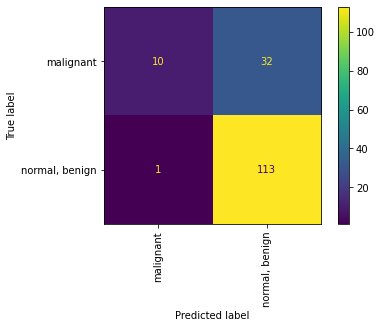

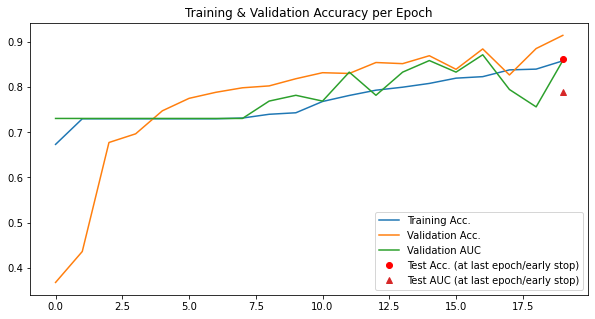

In [186]:
# Runs the classifier again 

clf = run_classifier_pipeline(name_dataset, info_flags, condGAN_loader)

#### Generating an upgraded dataset with Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [187]:
# Creates the augmented dataloader
condGAN_loader = generate_augmented_dataset_condGAN(
    n_channels, n_classes, latent_dims, model_path,
    base_dataset[0], 64, 
    test_loader, val_loader, n_generated_images,
    weighted_sampling=True
)

2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "BreastMNIST",
  "description": "The BreastMNIST is based on a dataset of 780 breast ultrasound images. It is categorized into 3 classes: normal, benign, and malignant. As we use low-resolution images, we simplify the task into binary classification by combining normal and benign as positive and classifying them against malignant as negative. We split the source dataset with a ratio of 7:1:2 into training, validation and test set. The source images of 1\u00d7500\u00d7500 are resized into 1\u00d728\u00d728.",
  "url": "https://zenodo.org/record/5208230/files/breastmnist.npz?download=1",
  "MD5": "750601b1f35ba3300ea97c75c52ff8f6",
  "task": "binary-class",
  "label": {
    "0": "malignant",
    "1": "normal, benign"
  },
  "n_channels": 1,
  "n_samples": {
    "train": 546,
    "val": 78,
    "test": 156
  },
  "license": "CC BY 4.0"
}
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
    

100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 106.95it/s]


train -- accuracy: 0.5
val -- accuracy: 0.4,  AUC: 0.51
Epoch 1



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 117.01it/s]


train -- accuracy: 0.62
val -- accuracy: 0.57,  AUC: 0.59
Epoch 2



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 115.45it/s]


train -- accuracy: 0.66
val -- accuracy: 0.67,  AUC: 0.65
Epoch 3



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 114.86it/s]


train -- accuracy: 0.7
val -- accuracy: 0.71,  AUC: 0.69
Epoch 4



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 113.97it/s]


train -- accuracy: 0.72
val -- accuracy: 0.73,  AUC: 0.69
Epoch 5



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 116.88it/s]


train -- accuracy: 0.72
val -- accuracy: 0.75,  AUC: 0.69
Epoch 6



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 116.99it/s]


train -- accuracy: 0.74
val -- accuracy: 0.77,  AUC: 0.69
Epoch 7



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 117.72it/s]


train -- accuracy: 0.73
val -- accuracy: 0.77,  AUC: 0.71
Epoch 8



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 116.79it/s]


train -- accuracy: 0.73
val -- accuracy: 0.8,  AUC: 0.73
Epoch 9



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 116.61it/s]


train -- accuracy: 0.74
val -- accuracy: 0.81,  AUC: 0.76
Epoch 10



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 112.38it/s]


train -- accuracy: 0.8
val -- accuracy: 0.82,  AUC: 0.76
Epoch 11



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 114.89it/s]


train -- accuracy: 0.79
val -- accuracy: 0.83,  AUC: 0.79
Epoch 12



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 116.15it/s]


train -- accuracy: 0.81
val -- accuracy: 0.84,  AUC: 0.78
Epoch 13



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 117.26it/s]


train -- accuracy: 0.85
val -- accuracy: 0.83,  AUC: 0.76
Epoch 14



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 115.84it/s]


train -- accuracy: 0.85
val -- accuracy: 0.86,  AUC: 0.82
Epoch 15



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 115.30it/s]


train -- accuracy: 0.85
val -- accuracy: 0.87,  AUC: 0.85
Epoch 16



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 118.91it/s]


train -- accuracy: 0.89
val -- accuracy: 0.87,  AUC: 0.85
Epoch 17



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 114.01it/s]


train -- accuracy: 0.9
val -- accuracy: 0.87,  AUC: 0.85
Epoch 18



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 116.44it/s]


train -- accuracy: 0.94
val -- accuracy: 0.88,  AUC: 0.87
Epoch 19



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 118.26it/s]


train -- accuracy: 0.94
val -- accuracy: 0.87,  AUC: 0.83
test -- accuracy: 0.86,  AUC: 0.81


<Figure size 720x720 with 0 Axes>

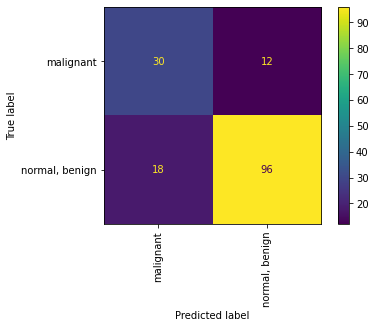

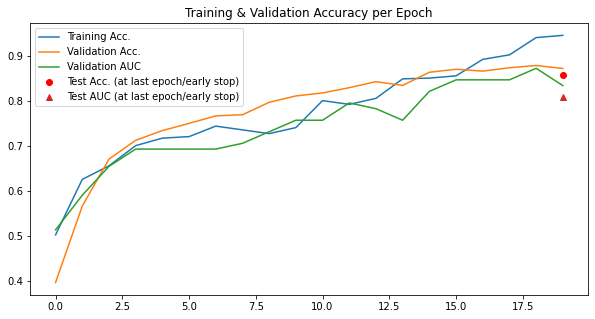

In [188]:
# Runs the classifier again 

clf = run_classifier_pipeline(name_dataset, info_flags, condGAN_loader)

### OrganaMNIST

#### Training the Conditional GAN

In [189]:
# Declares the dataset name and retrieves the base dataset
name_dataset = "organamnist"
base_dataset = organamnist_noWRS_noGDA_upscaled

# Retrieves the dataset parameters
n_classes  = len(info_flags[name_dataset][0]["label"])
n_channels = info_flags[name_dataset][0]["n_channels"]

# Retrieves the data loader
train_loader = base_dataset[3] #####################################################
val_loader = base_dataset[5]   ### OF NOTE #########################################
test_loader = base_dataset[4]  ### EVALUATE/TEST NOT IMPLEMENTED YET IN ############
                               ### TORCHFUSION AT THE TIME OF CREATION OF NOTEBOOK #
                               ### Thus the use of None below in the pipeline ######
                               #####################################################

Path trained_models/conditionalGAN/organamnist/ created.
Epoch 1 of 100
New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_1.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_1.pth
Epoch: 1, Duration: 26.180028200149536 , Gen Loss: 4.058900660767473 Disc Loss: 0.17357232837396258
Epoch 2 of 100


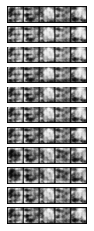

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_2.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_2.pth
Epoch: 2, Duration: 27.136640787124634 , Gen Loss: 5.513629684653423 Disc Loss: 0.12713315408931206
Epoch 3 of 100
New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_3.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_3.pth
Epoch: 3, Duration: 26.108948469161987 , Gen Loss: 5.254151484919465 Disc Loss: 0.1269956824647205
Epoch 4 of 100


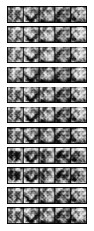

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_4.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_4.pth
Epoch: 4, Duration: 26.623735189437866 , Gen Loss: 5.220814446516873 Disc Loss: 0.12852640980144445
Epoch 5 of 100
New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_5.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_5.pth
Epoch: 5, Duration: 26.129251718521118 , Gen Loss: 4.23882198678465 Disc Loss: 0.17802030355361326
Epoch 6 of 100


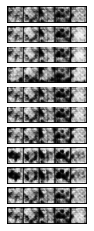

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_6.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_6.pth
Epoch: 6, Duration: 26.977535486221313 , Gen Loss: 3.510402659697522 Disc Loss: 0.19443408512351434
Epoch 7 of 100
New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_7.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_7.pth
Epoch: 7, Duration: 26.152289390563965 , Gen Loss: 3.484070687299384 Disc Loss: 0.19413930337468552
Epoch 8 of 100


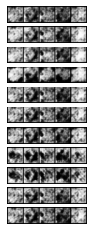

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_8.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_8.pth
Epoch: 8, Duration: 26.657400608062744 , Gen Loss: 3.1749601479135943 Disc Loss: 0.19959572385305516
Epoch 9 of 100
New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_9.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_9.pth
Epoch: 9, Duration: 26.389286041259766 , Gen Loss: 2.9403407037101297 Disc Loss: 0.20688084452083513
Epoch 10 of 100


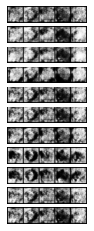

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_10.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_10.pth
Epoch: 10, Duration: 26.70969271659851 , Gen Loss: 2.8168428381914925 Disc Loss: 0.21585804094914837
Epoch 11 of 100
New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_11.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_11.pth
Epoch: 11, Duration: 26.600610733032227 , Gen Loss: 2.7497243789942454 Disc Loss: 0.21494073978937134
Epoch 12 of 100


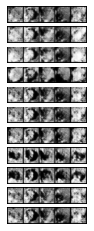

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_12.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_12.pth
Epoch: 12, Duration: 26.56170892715454 , Gen Loss: 2.6972328102859953 Disc Loss: 0.22116944976106823
Epoch 13 of 100


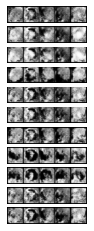

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_13.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_13.pth
Epoch: 13, Duration: 26.666831254959106 , Gen Loss: 2.6134910156588878 Disc Loss: 0.2155591361811761
Epoch 14 of 100
New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_14.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_14.pth
Epoch: 14, Duration: 26.15185022354126 , Gen Loss: 2.559977615959631 Disc Loss: 0.21843094609395333
Epoch 15 of 100


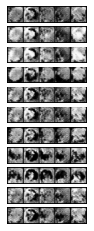

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_15.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_15.pth
Epoch: 15, Duration: 27.06806206703186 , Gen Loss: 2.4765591112171426 Disc Loss: 0.22758064568964895
Epoch 16 of 100
New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_16.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_16.pth
Epoch: 16, Duration: 26.0864839553833 , Gen Loss: 2.4538099859749574 Disc Loss: 0.23163800716524247
Epoch 17 of 100


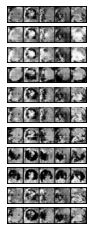

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_17.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_17.pth
Epoch: 17, Duration: 26.628211498260498 , Gen Loss: 2.4094370373181806 Disc Loss: 0.23591466525151095
Epoch 18 of 100
New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_18.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_18.pth
Epoch: 18, Duration: 26.077173471450806 , Gen Loss: 2.3536960776871694 Disc Loss: 0.22951630433800352
Epoch 19 of 100


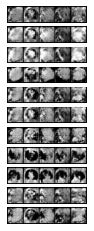

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_19.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_19.pth
Epoch: 19, Duration: 26.509880542755127 , Gen Loss: 2.3865107916919697 Disc Loss: 0.2298315741031925
Epoch 20 of 100
New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_20.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_20.pth
Epoch: 20, Duration: 26.658899307250977 , Gen Loss: 2.38889468747289 Disc Loss: 0.2297649421602542
Epoch 21 of 100


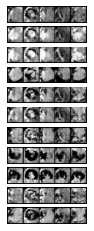

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_21.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_21.pth
Epoch: 21, Duration: 26.53205966949463 , Gen Loss: 2.3814423021312283 Disc Loss: 0.22745541604313063
Epoch 22 of 100
New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_22.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_22.pth
Epoch: 22, Duration: 26.06254744529724 , Gen Loss: 2.396892215016917 Disc Loss: 0.22645052896641218
Epoch 23 of 100


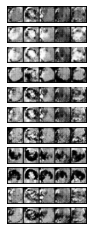

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_23.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_23.pth
Epoch: 23, Duration: 26.613261461257935 , Gen Loss: 2.3693506730574594 Disc Loss: 0.22498833976298402
Epoch 24 of 100


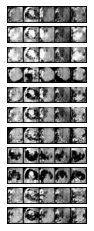

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_24.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_24.pth
Epoch: 24, Duration: 26.763986110687256 , Gen Loss: 2.4278708864694485 Disc Loss: 0.22970998739824613
Epoch 25 of 100
New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_25.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_25.pth
Epoch: 25, Duration: 26.39754581451416 , Gen Loss: 2.3781341723056015 Disc Loss: 0.22846606405070705
Epoch 26 of 100


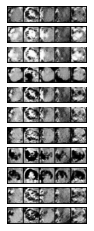

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_26.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_26.pth
Epoch: 26, Duration: 26.610939264297485 , Gen Loss: 2.403967541785952 Disc Loss: 0.2293053102453298
Epoch 27 of 100
New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_27.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_27.pth
Epoch: 27, Duration: 26.129782915115356 , Gen Loss: 2.428767106575865 Disc Loss: 0.22636675543018564
Epoch 28 of 100


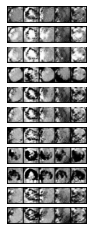

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_28.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_28.pth
Epoch: 28, Duration: 26.72898244857788 , Gen Loss: 2.4259365692143082 Disc Loss: 0.22892045747213066
Epoch 29 of 100
New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_29.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_29.pth
Epoch: 29, Duration: 26.708242416381836 , Gen Loss: 2.4119415737688326 Disc Loss: 0.23269931747654057
Epoch 30 of 100


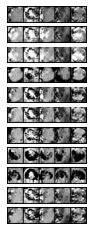

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_30.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_30.pth
Epoch: 30, Duration: 26.67819833755493 , Gen Loss: 2.409267824094156 Disc Loss: 0.2355284287253116
Epoch 31 of 100
New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_31.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_31.pth
Epoch: 31, Duration: 26.143433332443237 , Gen Loss: 2.4186879626818194 Disc Loss: 0.22865261654702004
Epoch 32 of 100


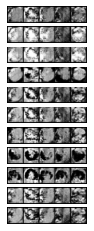

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_32.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_32.pth
Epoch: 32, Duration: 26.671173095703125 , Gen Loss: 2.4073714612070214 Disc Loss: 0.23237492623749315
Epoch 33 of 100
New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_33.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_33.pth
Epoch: 33, Duration: 26.129092931747437 , Gen Loss: 2.436033560698071 Disc Loss: 0.22652400907470865
Epoch 34 of 100


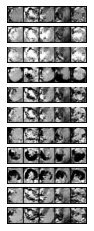

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_34.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_34.pth
Epoch: 34, Duration: 27.1018009185791 , Gen Loss: 2.4342384094589513 Disc Loss: 0.23229222581583817
Epoch 35 of 100
New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_35.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_35.pth
Epoch: 35, Duration: 26.127678871154785 , Gen Loss: 2.4638134470518493 Disc Loss: 0.22859214089293978
Epoch 36 of 100


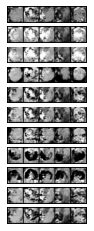

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_36.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_36.pth
Epoch: 36, Duration: 26.534070014953613 , Gen Loss: 2.448323320609583 Disc Loss: 0.23323172350333277
Epoch 37 of 100


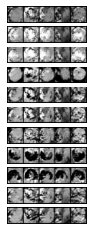

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_37.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_37.pth
Epoch: 37, Duration: 26.580257892608643 , Gen Loss: 2.457292299239467 Disc Loss: 0.23112946381773952
Epoch 38 of 100
New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_38.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_38.pth
Epoch: 38, Duration: 26.685179471969604 , Gen Loss: 2.466672224270553 Disc Loss: 0.22970097888381627
Epoch 39 of 100


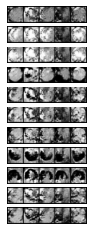

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_39.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_39.pth
Epoch: 39, Duration: 26.699812412261963 , Gen Loss: 2.44315339348197 Disc Loss: 0.2337371322266924
Epoch 40 of 100
New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_40.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_40.pth
Epoch: 40, Duration: 26.220702409744263 , Gen Loss: 2.485050271464099 Disc Loss: 0.22633515503003818
Epoch 41 of 100


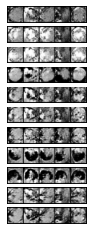

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_41.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_41.pth
Epoch: 41, Duration: 26.59782886505127 , Gen Loss: 2.501986052673433 Disc Loss: 0.22792498838777075
Epoch 42 of 100
New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_42.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_42.pth
Epoch: 42, Duration: 26.160898685455322 , Gen Loss: 2.514349462132385 Disc Loss: 0.22823485022031606
Epoch 43 of 100


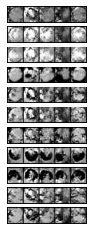

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_43.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_43.pth
Epoch: 43, Duration: 27.272111177444458 , Gen Loss: 2.520651920491021 Disc Loss: 0.23285761599577803
Epoch 44 of 100
New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_44.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_44.pth
Epoch: 44, Duration: 26.108134031295776 , Gen Loss: 2.5804234984529075 Disc Loss: 0.22264920415564182
Epoch 45 of 100


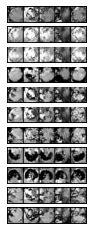

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_45.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_45.pth
Epoch: 45, Duration: 26.674876928329468 , Gen Loss: 2.5657807936439085 Disc Loss: 0.22247153309440154
Epoch 46 of 100
New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_46.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_46.pth
Epoch: 46, Duration: 26.157105684280396 , Gen Loss: 2.5511552586680546 Disc Loss: 0.22508360692106938
Epoch 47 of 100


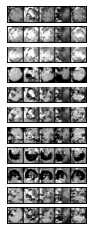

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_47.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_47.pth
Epoch: 47, Duration: 26.996519327163696 , Gen Loss: 2.567770912856771 Disc Loss: 0.22668782848601834
Epoch 48 of 100


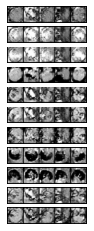

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_48.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_48.pth
Epoch: 48, Duration: 26.62793803215027 , Gen Loss: 2.5355695685492035 Disc Loss: 0.2271115110627946
Epoch 49 of 100
New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_49.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_49.pth
Epoch: 49, Duration: 26.140845775604248 , Gen Loss: 2.6094000769931465 Disc Loss: 0.2164045386646569
Epoch 50 of 100


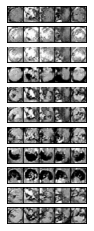

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_50.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_50.pth
Epoch: 50, Duration: 26.679441452026367 , Gen Loss: 2.591352097249935 Disc Loss: 0.22077523547522485
Epoch 51 of 100
New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_51.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_51.pth
Epoch: 51, Duration: 26.189491510391235 , Gen Loss: 2.6167986936468 Disc Loss: 0.22614711994122494
Epoch 52 of 100


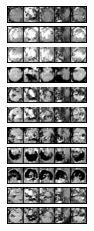

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_52.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_52.pth
Epoch: 52, Duration: 26.98585033416748 , Gen Loss: 2.631087609525462 Disc Loss: 0.2151006762203233
Epoch 53 of 100
New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_53.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_53.pth
Epoch: 53, Duration: 26.156246185302734 , Gen Loss: 2.6313772375003617 Disc Loss: 0.21516061531711778
Epoch 54 of 100


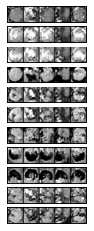

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_54.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_54.pth
Epoch: 54, Duration: 26.71452808380127 , Gen Loss: 2.635493704996964 Disc Loss: 0.2155911319393236
Epoch 55 of 100
New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_55.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_55.pth
Epoch: 55, Duration: 26.153661489486694 , Gen Loss: 2.6868290209941876 Disc Loss: 0.22156044470319683
Epoch 56 of 100


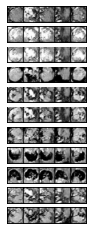

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_56.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_56.pth
Epoch: 56, Duration: 27.202402591705322 , Gen Loss: 2.6913087660131287 Disc Loss: 0.21109725287188053
Epoch 57 of 100
New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_57.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_57.pth
Epoch: 57, Duration: 26.24831533432007 , Gen Loss: 2.748853009962118 Disc Loss: 0.20903564446065034
Epoch 58 of 100


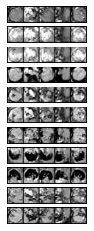

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_58.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_58.pth
Epoch: 58, Duration: 26.620583534240723 , Gen Loss: 2.7564669272866604 Disc Loss: 0.21686178431165234
Epoch 59 of 100
New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_59.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_59.pth
Epoch: 59, Duration: 26.141904830932617 , Gen Loss: 2.792530128538793 Disc Loss: 0.21337306059957056
Epoch 60 of 100


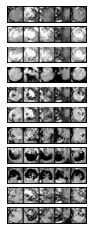

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_60.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_60.pth
Epoch: 60, Duration: 26.72316861152649 , Gen Loss: 2.8537963856597552 Disc Loss: 0.19988540830766896
Epoch 61 of 100


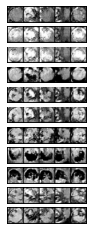

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_61.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_61.pth
Epoch: 61, Duration: 27.020320177078247 , Gen Loss: 2.8831782626297677 Disc Loss: 0.19790637323873658
Epoch 62 of 100
New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_62.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_62.pth
Epoch: 62, Duration: 26.15440082550049 , Gen Loss: 2.9097273430496515 Disc Loss: 0.20706297747950464
Epoch 63 of 100


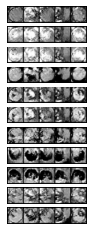

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_63.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_63.pth
Epoch: 63, Duration: 26.581902027130127 , Gen Loss: 2.851994005017206 Disc Loss: 0.21271169726511668
Epoch 64 of 100
New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_64.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_64.pth
Epoch: 64, Duration: 26.138555765151978 , Gen Loss: 2.930901136100749 Disc Loss: 0.1975278744333955
Epoch 65 of 100


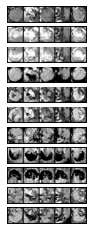

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_65.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_65.pth
Epoch: 65, Duration: 27.075135946273804 , Gen Loss: 2.9506918539082156 Disc Loss: 0.20335477359767648
Epoch 66 of 100
New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_66.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_66.pth
Epoch: 66, Duration: 26.120957136154175 , Gen Loss: 3.004046658569735 Disc Loss: 0.2036286296123594
Epoch 67 of 100


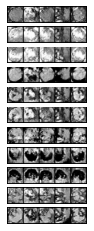

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_67.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_67.pth
Epoch: 67, Duration: 26.669480323791504 , Gen Loss: 3.052514612431682 Disc Loss: 0.1894711279089312
Epoch 68 of 100
New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_68.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_68.pth
Epoch: 68, Duration: 26.14927577972412 , Gen Loss: 3.0241992983863972 Disc Loss: 0.19931054365565629
Epoch 69 of 100


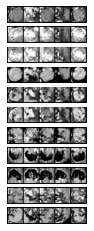

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_69.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_69.pth
Epoch: 69, Duration: 26.656614542007446 , Gen Loss: 3.0191177055319396 Disc Loss: 0.2045934584517148
Epoch 70 of 100
New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_70.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_70.pth
Epoch: 70, Duration: 26.495827198028564 , Gen Loss: 3.1779696130100343 Disc Loss: 0.1898692251751323
Epoch 71 of 100


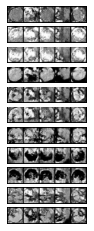

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_71.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_71.pth
Epoch: 71, Duration: 26.501893281936646 , Gen Loss: 3.2048641233625403 Disc Loss: 0.18674636293231833
Epoch 72 of 100


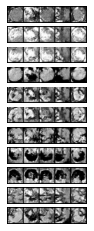

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_72.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_72.pth
Epoch: 72, Duration: 26.628407955169678 , Gen Loss: 3.1305648332899567 Disc Loss: 0.19331167788127873
Epoch 73 of 100
New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_73.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_73.pth
Epoch: 73, Duration: 26.06705141067505 , Gen Loss: 3.146704928284318 Disc Loss: 0.19344858470872733
Epoch 74 of 100


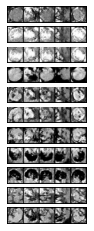

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_74.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_74.pth
Epoch: 74, Duration: 27.04529047012329 , Gen Loss: 3.1867289389404587 Disc Loss: 0.18946690605028774
Epoch 75 of 100
New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_75.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_75.pth
Epoch: 75, Duration: 26.16460108757019 , Gen Loss: 3.218756325728001 Disc Loss: 0.18391701164476157
Epoch 76 of 100


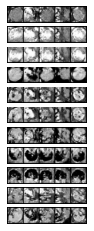

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_76.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_76.pth
Epoch: 76, Duration: 26.66095519065857 , Gen Loss: 3.3297204389693764 Disc Loss: 0.18847441627085684
Epoch 77 of 100
New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_77.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_77.pth
Epoch: 77, Duration: 26.114977598190308 , Gen Loss: 3.3150370687660855 Disc Loss: 0.17755553198468813
Epoch 78 of 100


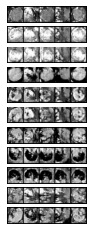

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_78.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_78.pth
Epoch: 78, Duration: 26.565221786499023 , Gen Loss: 3.3495800620282816 Disc Loss: 0.17981791166030478
Epoch 79 of 100
New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_79.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_79.pth
Epoch: 79, Duration: 26.65885901451111 , Gen Loss: 3.3244025349903126 Disc Loss: 0.18633526121190105
Epoch 80 of 100


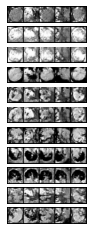

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_80.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_80.pth
Epoch: 80, Duration: 26.556997537612915 , Gen Loss: 3.4049559367860964 Disc Loss: 0.17348235618909227
Epoch 81 of 100
New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_81.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_81.pth
Epoch: 81, Duration: 26.164241552352905 , Gen Loss: 3.400211414866545 Disc Loss: 0.1871417632921619
Epoch 82 of 100


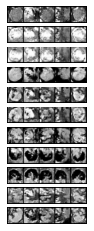

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_82.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_82.pth
Epoch: 82, Duration: 26.63505792617798 , Gen Loss: 3.478025324600214 Disc Loss: 0.1743959296877259
Epoch 83 of 100
New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_83.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_83.pth
Epoch: 83, Duration: 26.66636848449707 , Gen Loss: 3.506558876261531 Disc Loss: 0.17477548748771002
Epoch 84 of 100


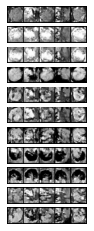

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_84.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_84.pth
Epoch: 84, Duration: 26.594550132751465 , Gen Loss: 3.490355072149446 Disc Loss: 0.17322888935126948
Epoch 85 of 100


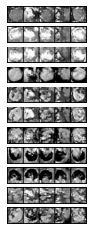

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_85.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_85.pth
Epoch: 85, Duration: 26.513372659683228 , Gen Loss: 3.493784972239091 Disc Loss: 0.17655742247368497
Epoch 86 of 100
New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_86.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_86.pth
Epoch: 86, Duration: 26.0707745552063 , Gen Loss: 3.448671235649634 Disc Loss: 0.1741561591806194
Epoch 87 of 100


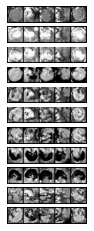

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_87.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_87.pth
Epoch: 87, Duration: 26.67747712135315 , Gen Loss: 3.631594797359822 Disc Loss: 0.17234577253856886
Epoch 88 of 100
New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_88.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_88.pth
Epoch: 88, Duration: 26.572577238082886 , Gen Loss: 3.679855583629739 Disc Loss: 0.1618327938391024
Epoch 89 of 100


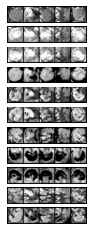

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_89.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_89.pth
Epoch: 89, Duration: 26.670419454574585 , Gen Loss: 3.582363463679477 Disc Loss: 0.1737881797220656
Epoch 90 of 100
New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_90.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_90.pth
Epoch: 90, Duration: 26.150180339813232 , Gen Loss: 3.6871579588502357 Disc Loss: 0.16249304169919898
Epoch 91 of 100


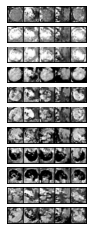

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_91.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_91.pth
Epoch: 91, Duration: 26.68506383895874 , Gen Loss: 3.6267596819785433 Disc Loss: 0.16710575408551662
Epoch 92 of 100
New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_92.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_92.pth
Epoch: 92, Duration: 26.62862539291382 , Gen Loss: 3.6325343938868166 Disc Loss: 0.16887948539299036
Epoch 93 of 100


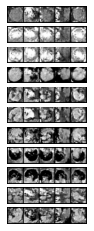

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_93.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_93.pth
Epoch: 93, Duration: 26.567509174346924 , Gen Loss: 3.7946989495676817 Disc Loss: 0.15542559385030796
Epoch 94 of 100
New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_94.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_94.pth
Epoch: 94, Duration: 26.213244915008545 , Gen Loss: 3.858282004568983 Disc Loss: 0.155299757046861
Epoch 95 of 100


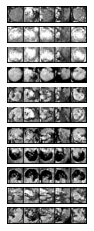

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_95.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_95.pth
Epoch: 95, Duration: 26.612250566482544 , Gen Loss: 3.8766022165350917 Disc Loss: 0.15823877781964807
Epoch 96 of 100


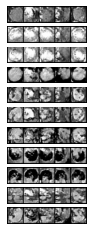

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_96.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_96.pth
Epoch: 96, Duration: 26.70071530342102 , Gen Loss: 3.795933370203291 Disc Loss: 0.16584269823476042
Epoch 97 of 100
New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_97.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_97.pth
Epoch: 97, Duration: 26.59371829032898 , Gen Loss: 3.7820490749978313 Disc Loss: 0.15575199011921287
Epoch 98 of 100


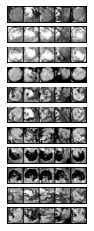

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_98.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_98.pth
Epoch: 98, Duration: 26.73015570640564 , Gen Loss: 3.82214763887684 Disc Loss: 0.15514908328905325
Epoch 99 of 100
New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_99.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_99.pth
Epoch: 99, Duration: 26.140861749649048 , Gen Loss: 3.928697297648998 Disc Loss: 0.15589152325337613
Epoch 100 of 100


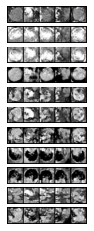

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_100.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_100.pth
Epoch: 100, Duration: 26.575723886489868 , Gen Loss: 3.9012445418004105 Disc Loss: 0.1510027662634467


In [190]:
# Runs the Cond GAN
run_GAN_pipeline(
    train_loader, None, None, #val_loader, test_loader, 
    n_channels, latent_dims, n_classes,
    epochs=epochs, name_dataset=name_dataset
)

#### Generating an upgraded dataset without Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [191]:
# Removes saved intermediary models
model_path = f"trained_models/conditionalGAN/{name_dataset}/gen_models/"
models = [x for x in os.listdir(model_path) 
          if x[-(4+len(str(epochs))):]!=f"{epochs}.pth"]
for model in models:
    os.remove(model_path+model)
# Fetches the generated GAN Model model to import
model_path += f"gen_model_{epochs}.pth"

# Calculates the number of images to generate
percentage = 5
nb_images_in_dataset = len(base_dataset[0])
n_generated_images = int((percentage/100)*nb_images_in_dataset)
print(f"Number of generated images: {n_generated_images}",
      f"({percentage}% of the dataset)")

# Creates the augmented dataloader
condGAN_loader = generate_augmented_dataset_condGAN(
    n_channels, n_classes, latent_dims, model_path,
    base_dataset[0], 64, 
    test_loader, val_loader, n_generated_images,
    weighted_sampling=False
)

Number of generated images: 1729 (5% of the dataset)


2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "OrganAMNIST",
  "description": "The OrganAMNIST is based on 3D computed tomography (CT) images from Liver Tumor Segmentation Benchmark (LiTS). It is renamed from OrganMNIST_Axial (in MedMNIST v1) for simplicity. We use bounding-box annotations of 11 body organs from another study to obtain the organ labels. Hounsfield-Unit (HU) of the 3D images are transformed into gray-scale with an abdominal window. We crop 2D images from the center slices of the 3D bounding boxes in axial views (planes). The images are resized into 1\u00d728\u00d728 to perform multi-class classification of 11 body organs. 115 and 16 CT scans from the source training set are used as training and validation set, respectively. The 70 CT scans from the source test set are treated as the test set.",
  "url": "https://zenodo.org/record/5208230/files/organamnist.npz?download=1",
  "MD5": "866b832ed4eeba67bfb9edee1d5544e6",
  "task": "multi-class",
  "label": {
    "0": "bladder",
    "1": "femur-left",

100%|████████████████████████████████████████| 568/568 [00:04<00:00, 114.82it/s]


train -- accuracy: 0.58
val -- accuracy: 0.99,  AUC: 0.88
Epoch 1



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 114.58it/s]


train -- accuracy: 0.86
val -- accuracy: 1.0,  AUC: 0.95
Epoch 2



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 114.98it/s]


train -- accuracy: 0.92
val -- accuracy: 1.0,  AUC: 0.96
Epoch 3



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 113.65it/s]


train -- accuracy: 0.95
val -- accuracy: 1.0,  AUC: 0.95
Epoch 4



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 115.06it/s]


train -- accuracy: 0.96
val -- accuracy: 1.0,  AUC: 0.96
Epoch 5



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 114.88it/s]


train -- accuracy: 0.97
val -- accuracy: 1.0,  AUC: 0.97
Epoch 6



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 114.93it/s]


train -- accuracy: 0.98
val -- accuracy: 1.0,  AUC: 0.97
Epoch 7



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 114.90it/s]


train -- accuracy: 0.98
val -- accuracy: 1.0,  AUC: 0.97
Epoch 8



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 114.51it/s]


train -- accuracy: 0.99
val -- accuracy: 1.0,  AUC: 0.96
Epoch 9



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 114.82it/s]


train -- accuracy: 0.99
val -- accuracy: 1.0,  AUC: 0.96
Epoch 10



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 114.38it/s]


train -- accuracy: 0.99
val -- accuracy: 1.0,  AUC: 0.97
Epoch 11



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 114.65it/s]


train -- accuracy: 1.0
val -- accuracy: 1.0,  AUC: 0.97
Epoch 12



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 114.76it/s]


train -- accuracy: 1.0
val -- accuracy: 1.0,  AUC: 0.97
Epoch 13



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 114.58it/s]


train -- accuracy: 1.0
val -- accuracy: 1.0,  AUC: 0.97
Epoch 14



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 114.56it/s]


train -- accuracy: 1.0
val -- accuracy: 1.0,  AUC: 0.97
Epoch 15



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 114.79it/s]


train -- accuracy: 1.0
val -- accuracy: 1.0,  AUC: 0.97
Epoch 16



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 114.95it/s]


train -- accuracy: 1.0
val -- accuracy: 1.0,  AUC: 0.97
Epoch 17



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 114.55it/s]


train -- accuracy: 1.0
val -- accuracy: 1.0,  AUC: 0.97
Epoch 18



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 114.61it/s]


train -- accuracy: 1.0
val -- accuracy: 1.0,  AUC: 0.97
Epoch 19



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 114.49it/s]


train -- accuracy: 1.0
val -- accuracy: 1.0,  AUC: 0.97
test -- accuracy: 0.99,  AUC: 0.88


<Figure size 720x720 with 0 Axes>

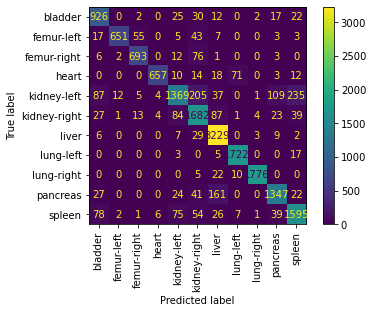

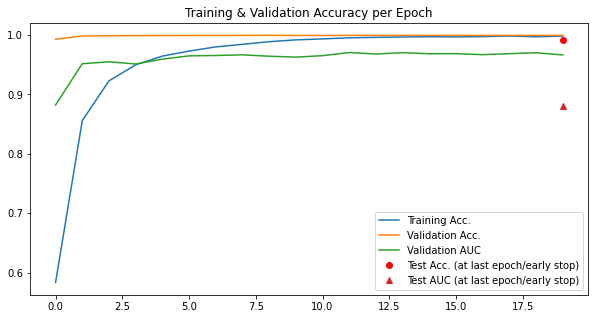

In [192]:
# Runs the classifier again 

clf = run_classifier_pipeline(name_dataset, info_flags, condGAN_loader)

#### Generating an upgraded dataset with Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [193]:
# Creates the augmented dataloader
condGAN_loader = generate_augmented_dataset_condGAN(
    n_channels, n_classes, latent_dims, model_path,
    base_dataset[0], 64, 
    test_loader, val_loader, n_generated_images,
    weighted_sampling=True
)

2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "OrganAMNIST",
  "description": "The OrganAMNIST is based on 3D computed tomography (CT) images from Liver Tumor Segmentation Benchmark (LiTS). It is renamed from OrganMNIST_Axial (in MedMNIST v1) for simplicity. We use bounding-box annotations of 11 body organs from another study to obtain the organ labels. Hounsfield-Unit (HU) of the 3D images are transformed into gray-scale with an abdominal window. We crop 2D images from the center slices of the 3D bounding boxes in axial views (planes). The images are resized into 1\u00d728\u00d728 to perform multi-class classification of 11 body organs. 115 and 16 CT scans from the source training set are used as training and validation set, respectively. The 70 CT scans from the source test set are treated as the test set.",
  "url": "https://zenodo.org/record/5208230/files/organamnist.npz?download=1",
  "MD5": "866b832ed4eeba67bfb9edee1d5544e6",
  "task": "multi-class",
  "label": {
    "0": "bladder",
    "1": "femur-left",

100%|████████████████████████████████████████| 568/568 [00:04<00:00, 115.64it/s]


train -- accuracy: 0.59
val -- accuracy: 0.99,  AUC: 0.91
Epoch 1



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 114.95it/s]


train -- accuracy: 0.87
val -- accuracy: 1.0,  AUC: 0.94
Epoch 2



100%|████████████████████████████████████████| 568/568 [00:05<00:00, 113.41it/s]


train -- accuracy: 0.93
val -- accuracy: 1.0,  AUC: 0.95
Epoch 3



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 114.75it/s]


train -- accuracy: 0.95
val -- accuracy: 1.0,  AUC: 0.95
Epoch 4



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 114.82it/s]


train -- accuracy: 0.97
val -- accuracy: 1.0,  AUC: 0.95
Epoch 5



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 114.92it/s]


train -- accuracy: 0.98
val -- accuracy: 1.0,  AUC: 0.96
Epoch 6



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 114.76it/s]


train -- accuracy: 0.98
val -- accuracy: 1.0,  AUC: 0.96
Epoch 7



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 114.90it/s]


train -- accuracy: 0.99
val -- accuracy: 1.0,  AUC: 0.96
Epoch 8



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 114.47it/s]


train -- accuracy: 0.99
val -- accuracy: 1.0,  AUC: 0.96
Epoch 9



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 114.90it/s]


train -- accuracy: 0.99
val -- accuracy: 1.0,  AUC: 0.96
Epoch 10



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 114.91it/s]


train -- accuracy: 0.99
val -- accuracy: 1.0,  AUC: 0.96
Epoch 11



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 115.17it/s]


train -- accuracy: 0.99
val -- accuracy: 1.0,  AUC: 0.96
Epoch 12



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 114.68it/s]


train -- accuracy: 0.99
val -- accuracy: 1.0,  AUC: 0.96
Epoch 13



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 114.94it/s]


train -- accuracy: 1.0
val -- accuracy: 1.0,  AUC: 0.96
Epoch 14



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 114.71it/s]


train -- accuracy: 1.0
val -- accuracy: 1.0,  AUC: 0.97
Epoch 15



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 115.14it/s]


train -- accuracy: 1.0
val -- accuracy: 1.0,  AUC: 0.97
Epoch 16



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 115.10it/s]


train -- accuracy: 1.0
val -- accuracy: 1.0,  AUC: 0.96
Epoch 17



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 114.73it/s]


train -- accuracy: 1.0
val -- accuracy: 1.0,  AUC: 0.97
Epoch 18



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 114.81it/s]


train -- accuracy: 1.0
val -- accuracy: 1.0,  AUC: 0.97
Epoch 19



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 114.71it/s]


train -- accuracy: 1.0
val -- accuracy: 1.0,  AUC: 0.97
test -- accuracy: 0.99,  AUC: 0.87


<Figure size 720x720 with 0 Axes>

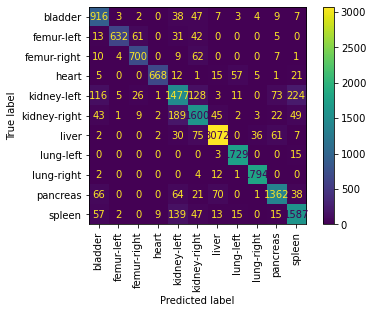

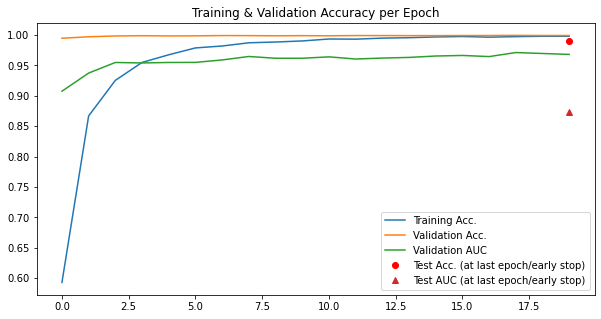

In [194]:
# Runs the classifier again 

clf = run_classifier_pipeline(name_dataset, info_flags, condGAN_loader)

### OrgancMNIST

#### Training the Conditional GAN

In [195]:
# Declares the dataset name and retrieves the base dataset
name_dataset = "organcmnist"
base_dataset = organcmnist_noWRS_noGDA_upscaled

# Retrieves the dataset parameters
n_classes  = len(info_flags[name_dataset][0]["label"])
n_channels = info_flags[name_dataset][0]["n_channels"]

# Retrieves the data loader
train_loader = base_dataset[3] #####################################################
val_loader = base_dataset[5]   ### OF NOTE #########################################
test_loader = base_dataset[4]  ### EVALUATE/TEST NOT IMPLEMENTED YET IN ############
                               ### TORCHFUSION AT THE TIME OF CREATION OF NOTEBOOK #
                               ### Thus the use of None below in the pipeline ######
                               #####################################################

Path trained_models/conditionalGAN/organcmnist/ created.
Epoch 1 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_1.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_1.pth
Epoch: 1, Duration: 10.414218425750732 , Gen Loss: 2.4074158653846154 Disc Loss: 0.30402713716947116
Epoch 2 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_2.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_2.pth
Epoch: 2, Duration: 9.785701751708984 , Gen Loss: 4.748316105769231 Disc Loss: 0.12090335787259615
Epoch 3 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_3.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_3.pth
Epoch: 3, Duration: 9.781172752380371 , Gen Loss: 5.983211538461538 Disc Loss: 0.08943851412

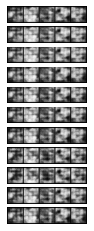

New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_5.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_5.pth
Epoch: 5, Duration: 10.242910385131836 , Gen Loss: 5.377841346153846 Disc Loss: 0.1265363487830529
Epoch 6 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_6.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_6.pth
Epoch: 6, Duration: 9.782698392868042 , Gen Loss: 5.382665865384616 Disc Loss: 0.1131796875
Epoch 7 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_7.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_7.pth
Epoch: 7, Duration: 9.863715887069702 , Gen Loss: 5.353676682692308 Disc Loss: 0.10792631648137019
Epoch 8 of 100
New Generator model saved at trained_models/conditionalGAN/

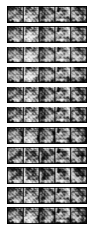

New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_10.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_10.pth
Epoch: 10, Duration: 10.243816614151001 , Gen Loss: 5.213028245192308 Disc Loss: 0.1144185791015625
Epoch 11 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_11.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_11.pth
Epoch: 11, Duration: 9.804205417633057 , Gen Loss: 4.912852764423077 Disc Loss: 0.13014007098858174
Epoch 12 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_12.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_12.pth
Epoch: 12, Duration: 9.800127744674683 , Gen Loss: 4.40525 Disc Loss: 0.1519929668719952
Epoch 13 of 100
New Generator model saved at trained_models/conditi

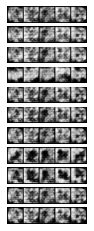

New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_15.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_15.pth
Epoch: 15, Duration: 10.328626155853271 , Gen Loss: 3.3308557692307694 Disc Loss: 0.1835143291766827
Epoch 16 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_16.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_16.pth
Epoch: 16, Duration: 9.8020658493042 , Gen Loss: 3.3363933293269232 Disc Loss: 0.16554375751201922
Epoch 17 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_17.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_17.pth
Epoch: 17, Duration: 9.804856300354004 , Gen Loss: 3.1909537259615384 Disc Loss: 0.17709551532451923
Epoch 18 of 100
New Generator model saved at trained_mo

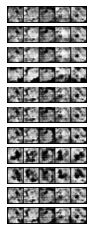

New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_20.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_20.pth
Epoch: 20, Duration: 10.348615169525146 , Gen Loss: 3.0578903245192306 Disc Loss: 0.16228870567908654
Epoch 21 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_21.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_21.pth
Epoch: 21, Duration: 9.810345888137817 , Gen Loss: 3.04214453125 Disc Loss: 0.16810655799278845
Epoch 22 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_22.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_22.pth
Epoch: 22, Duration: 9.806515216827393 , Gen Loss: 3.0057662259615383 Disc Loss: 0.1686775841346154
Epoch 23 of 100
New Generator model saved at trained_model

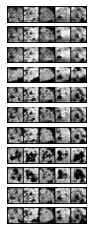

New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_25.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_25.pth
Epoch: 25, Duration: 10.462883472442627 , Gen Loss: 2.9273013822115383 Disc Loss: 0.16670301231971155
Epoch 26 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_26.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_26.pth
Epoch: 26, Duration: 10.064345598220825 , Gen Loss: 2.906649338942308 Disc Loss: 0.1673189227764423
Epoch 27 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_27.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_27.pth
Epoch: 27, Duration: 9.835551261901855 , Gen Loss: 2.943970552884615 Disc Loss: 0.17321647761418268
Epoch 28 of 100
New Generator model saved at trained_m

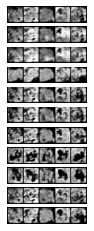

New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_30.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_30.pth
Epoch: 30, Duration: 10.216439962387085 , Gen Loss: 2.8471370192307695 Disc Loss: 0.17481698843149038
Epoch 31 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_31.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_31.pth
Epoch: 31, Duration: 9.763240337371826 , Gen Loss: 2.8426856971153844 Disc Loss: 0.1867406287560096
Epoch 32 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_32.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_32.pth
Epoch: 32, Duration: 9.766456842422485 , Gen Loss: 2.7785003004807693 Disc Loss: 0.19468545297475962
Epoch 33 of 100
New Generator model saved at trained_

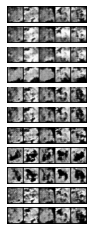

New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_35.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_35.pth
Epoch: 35, Duration: 10.29994535446167 , Gen Loss: 2.7277280649038462 Disc Loss: 0.20493688025841347
Epoch 36 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_36.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_36.pth
Epoch: 36, Duration: 9.802197933197021 , Gen Loss: 2.7672427884615383 Disc Loss: 0.20574474158653847
Epoch 37 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_37.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_37.pth
Epoch: 37, Duration: 9.968287229537964 , Gen Loss: 2.6796349158653845 Disc Loss: 0.20981174879807693
Epoch 38 of 100
New Generator model saved at trained_

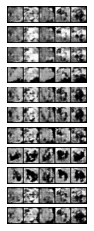

New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_40.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_40.pth
Epoch: 40, Duration: 10.327182531356812 , Gen Loss: 2.748602764423077 Disc Loss: 0.20019304011418268
Epoch 41 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_41.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_41.pth
Epoch: 41, Duration: 9.802546501159668 , Gen Loss: 2.636631310096154 Disc Loss: 0.20948159555288462
Epoch 42 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_42.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_42.pth
Epoch: 42, Duration: 9.804511308670044 , Gen Loss: 2.619303485576923 Disc Loss: 0.234341796875
Epoch 43 of 100
New Generator model saved at trained_models/

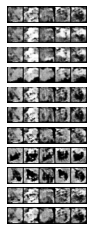

New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_45.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_45.pth
Epoch: 45, Duration: 10.240982055664062 , Gen Loss: 2.62685546875 Disc Loss: 0.2318695537860577
Epoch 46 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_46.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_46.pth
Epoch: 46, Duration: 9.786120653152466 , Gen Loss: 2.6237944711538463 Disc Loss: 0.22847455303485578
Epoch 47 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_47.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_47.pth
Epoch: 47, Duration: 9.894448041915894 , Gen Loss: 2.670135216346154 Disc Loss: 0.21714678485576924
Epoch 48 of 100
New Generator model saved at trained_models

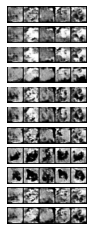

New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_50.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_50.pth
Epoch: 50, Duration: 10.688840627670288 , Gen Loss: 2.6436998197115384 Disc Loss: 0.21951171875
Epoch 51 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_51.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_51.pth
Epoch: 51, Duration: 10.17290997505188 , Gen Loss: 2.5969381009615384 Disc Loss: 0.22236215444711538
Epoch 52 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_52.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_52.pth
Epoch: 52, Duration: 9.821794271469116 , Gen Loss: 2.6839555288461536 Disc Loss: 0.2171456017127404
Epoch 53 of 100
New Generator model saved at trained_models

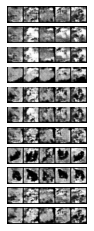

New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_54.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_54.pth
Epoch: 54, Duration: 10.33605432510376 , Gen Loss: 2.7321322115384614 Disc Loss: 0.23152120267427884
Epoch 55 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_55.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_55.pth
Epoch: 55, Duration: 9.801034212112427 , Gen Loss: 2.7954188701923077 Disc Loss: 0.20388709435096153
Epoch 56 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_56.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_56.pth
Epoch: 56, Duration: 9.79705023765564 , Gen Loss: 2.738611778846154 Disc Loss: 0.22195105919471153
Epoch 57 of 100
New Generator model saved at trained_mo

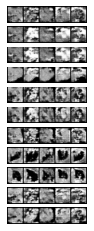

New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_59.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_59.pth
Epoch: 59, Duration: 10.337859630584717 , Gen Loss: 2.6869927884615383 Disc Loss: 0.21917144305889424
Epoch 60 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_60.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_60.pth
Epoch: 60, Duration: 9.812528848648071 , Gen Loss: 2.7030877403846154 Disc Loss: 0.2342501690204327
Epoch 61 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_61.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_61.pth
Epoch: 61, Duration: 9.839253664016724 , Gen Loss: 2.5987662259615383 Disc Loss: 0.22017623197115385
Epoch 62 of 100
New Generator model saved at trained_

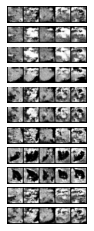

New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_64.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_64.pth
Epoch: 64, Duration: 10.31629490852356 , Gen Loss: 2.702448016826923 Disc Loss: 0.21603001051682694
Epoch 65 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_65.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_65.pth
Epoch: 65, Duration: 9.786584615707397 , Gen Loss: 2.707775841346154 Disc Loss: 0.2201995567908654
Epoch 66 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_66.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_66.pth
Epoch: 66, Duration: 9.795718908309937 , Gen Loss: 2.7523897235576924 Disc Loss: 0.21815816556490383
Epoch 67 of 100
New Generator model saved at trained_mod

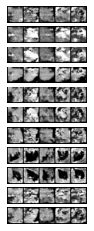

New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_69.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_69.pth
Epoch: 69, Duration: 10.240959405899048 , Gen Loss: 2.7363416466346155 Disc Loss: 0.2162723858173077
Epoch 70 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_70.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_70.pth
Epoch: 70, Duration: 9.76087737083435 , Gen Loss: 2.7623482572115385 Disc Loss: 0.19487571364182693
Epoch 71 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_71.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_71.pth
Epoch: 71, Duration: 9.772562265396118 , Gen Loss: 2.6855141225961536 Disc Loss: 0.23747299429086538
Epoch 72 of 100
New Generator model saved at trained_m

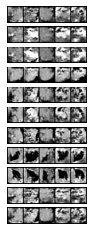

New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_74.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_74.pth
Epoch: 74, Duration: 11.0049147605896 , Gen Loss: 2.748278846153846 Disc Loss: 0.21667555588942308
Epoch 75 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_75.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_75.pth
Epoch: 75, Duration: 9.799143075942993 , Gen Loss: 2.757052884615385 Disc Loss: 0.2153094012920673
Epoch 76 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_76.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_76.pth
Epoch: 76, Duration: 9.794979333877563 , Gen Loss: 2.694789963942308 Disc Loss: 0.21797383939302883
Epoch 77 of 100
New Generator model saved at trained_model

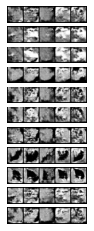

New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_79.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_79.pth
Epoch: 79, Duration: 10.340193510055542 , Gen Loss: 2.664661358173077 Disc Loss: 0.22057936448317308
Epoch 80 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_80.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_80.pth
Epoch: 80, Duration: 9.804975271224976 , Gen Loss: 2.8148521634615387 Disc Loss: 0.19797194260817308
Epoch 81 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_81.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_81.pth
Epoch: 81, Duration: 9.799375057220459 , Gen Loss: 2.706864483173077 Disc Loss: 0.2253245380108173
Epoch 82 of 100
New Generator model saved at trained_mo

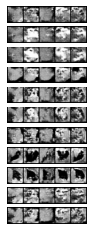

New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_84.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_84.pth
Epoch: 84, Duration: 10.258450984954834 , Gen Loss: 2.8693416466346156 Disc Loss: 0.2276385216346154
Epoch 85 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_85.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_85.pth
Epoch: 85, Duration: 9.797762632369995 , Gen Loss: 2.857209735576923 Disc Loss: 0.20362314077524038
Epoch 86 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_86.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_86.pth
Epoch: 86, Duration: 10.352756023406982 , Gen Loss: 2.825313401442308 Disc Loss: 0.21575197190504808
Epoch 87 of 100
New Generator model saved at trained_m

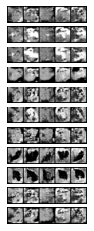

New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_89.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_89.pth
Epoch: 89, Duration: 10.246912240982056 , Gen Loss: 2.8898740985576925 Disc Loss: 0.2037381122295673
Epoch 90 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_90.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_90.pth
Epoch: 90, Duration: 9.789504766464233 , Gen Loss: 2.88725 Disc Loss: 0.2154003155048077
Epoch 91 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_91.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_91.pth
Epoch: 91, Duration: 9.792470455169678 , Gen Loss: 2.799262620192308 Disc Loss: 0.21891748046875
Epoch 92 of 100
New Generator model saved at trained_models/condition

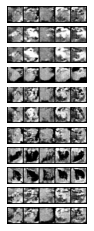

New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_94.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_94.pth
Epoch: 94, Duration: 10.340675115585327 , Gen Loss: 2.8387698317307692 Disc Loss: 0.21215024038461539
Epoch 95 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_95.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_95.pth
Epoch: 95, Duration: 9.803316354751587 , Gen Loss: 2.9311553485576924 Disc Loss: 0.19831441556490384
Epoch 96 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_96.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_96.pth
Epoch: 96, Duration: 9.806306600570679 , Gen Loss: 2.8677328725961537 Disc Loss: 0.22322291917067308
Epoch 97 of 100
New Generator model saved at trained

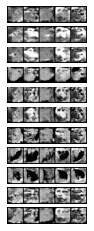

New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_99.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_99.pth
Epoch: 99, Duration: 10.344066619873047 , Gen Loss: 2.8096814903846155 Disc Loss: 0.22103665865384614
Epoch 100 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_100.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_100.pth
Epoch: 100, Duration: 9.805380821228027 , Gen Loss: 2.7892626201923076 Disc Loss: 0.2196474421574519


In [196]:
# Runs the Cond GAN
run_GAN_pipeline(
    train_loader, None, None, #val_loader, test_loader, 
    n_channels, latent_dims, n_classes,
    epochs=epochs, name_dataset=name_dataset
)

#### Generating an upgraded dataset without Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [197]:
# Removes saved intermediary models
model_path = f"trained_models/conditionalGAN/{name_dataset}/gen_models/"
models = [x for x in os.listdir(model_path) 
          if x[-(4+len(str(epochs))):]!=f"{epochs}.pth"]
for model in models:
    os.remove(model_path+model)
# Fetches the generated GAN Model model to import
model_path += f"gen_model_{epochs}.pth"

# Calculates the number of images to generate
percentage = 10
nb_images_in_dataset = len(base_dataset[0])
n_generated_images = int((percentage/100)*nb_images_in_dataset)
print(f"Number of generated images: {n_generated_images}",
      f"({percentage}% of the dataset)")

# Creates the augmented dataloader
condGAN_loader = generate_augmented_dataset_condGAN(
    n_channels, n_classes, latent_dims, model_path,
    base_dataset[0], 64, 
    test_loader, val_loader, n_generated_images,
    weighted_sampling=False
)

Number of generated images: 1300 (10% of the dataset)


2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "OrganCMNIST",
  "description": "The OrganCMNIST is based on 3D computed tomography (CT) images from Liver Tumor Segmentation Benchmark (LiTS). It is renamed from OrganMNIST_Coronal (in MedMNIST v1) for simplicity. We use bounding-box annotations of 11 body organs from another study to obtain the organ labels. Hounsfield-Unit (HU) of the 3D images are transformed into gray-scale with an abdominal window. We crop 2D images from the center slices of the 3D bounding boxes in coronal views (planes). The images are resized into 1\u00d728\u00d728 to perform multi-class classification of 11 body organs. 115 and 16 CT scans from the source training set are used as training and validation set, respectively. The 70 CT scans from the source test set are treated as the test set.",
  "url": "https://zenodo.org/record/5208230/files/organcmnist.npz?download=1",
  "MD5": "0afa5834fb105f7705a7d93372119a21",
  "task": "multi-class",
  "label": {
    "0": "bladder",
    "1": "femur-le

100%|████████████████████████████████████████| 224/224 [00:01<00:00, 115.11it/s]


train -- accuracy: 0.38
val -- accuracy: 0.96,  AUC: 0.62
Epoch 1



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 115.61it/s]


train -- accuracy: 0.67
val -- accuracy: 0.99,  AUC: 0.84
Epoch 2



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 115.46it/s]


train -- accuracy: 0.8
val -- accuracy: 0.99,  AUC: 0.9
Epoch 3



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 115.47it/s]


train -- accuracy: 0.85
val -- accuracy: 1.0,  AUC: 0.93
Epoch 4



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 115.52it/s]


train -- accuracy: 0.88
val -- accuracy: 1.0,  AUC: 0.92
Epoch 5



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 115.11it/s]


train -- accuracy: 0.91
val -- accuracy: 1.0,  AUC: 0.94
Epoch 6



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 115.67it/s]


train -- accuracy: 0.92
val -- accuracy: 1.0,  AUC: 0.95
Epoch 7



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 115.41it/s]


train -- accuracy: 0.93
val -- accuracy: 1.0,  AUC: 0.96
Epoch 8



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 116.02it/s]


train -- accuracy: 0.94
val -- accuracy: 1.0,  AUC: 0.96
Epoch 9



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 115.36it/s]


train -- accuracy: 0.95
val -- accuracy: 1.0,  AUC: 0.96
Epoch 10



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 115.34it/s]


train -- accuracy: 0.95
val -- accuracy: 1.0,  AUC: 0.94
Epoch 11



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 115.44it/s]


train -- accuracy: 0.96
val -- accuracy: 1.0,  AUC: 0.96
Epoch 12



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 115.05it/s]


train -- accuracy: 0.97
val -- accuracy: 1.0,  AUC: 0.96
Epoch 13



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 115.26it/s]


train -- accuracy: 0.97
val -- accuracy: 1.0,  AUC: 0.96
Epoch 14



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 115.08it/s]


train -- accuracy: 0.98
val -- accuracy: 1.0,  AUC: 0.96
Epoch 15



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 115.72it/s]


train -- accuracy: 0.98
val -- accuracy: 1.0,  AUC: 0.96
Epoch 16



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 115.53it/s]


train -- accuracy: 0.98
val -- accuracy: 1.0,  AUC: 0.96
Epoch 17



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 115.29it/s]


train -- accuracy: 0.98
val -- accuracy: 1.0,  AUC: 0.96
Epoch 18



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 115.32it/s]


train -- accuracy: 0.99
val -- accuracy: 1.0,  AUC: 0.95
Epoch 19



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 115.23it/s]


train -- accuracy: 0.99
val -- accuracy: 1.0,  AUC: 0.96
test -- accuracy: 0.99,  AUC: 0.87


<Figure size 720x720 with 0 Axes>

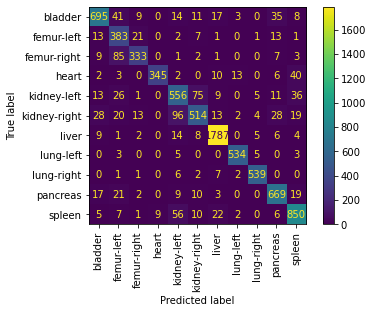

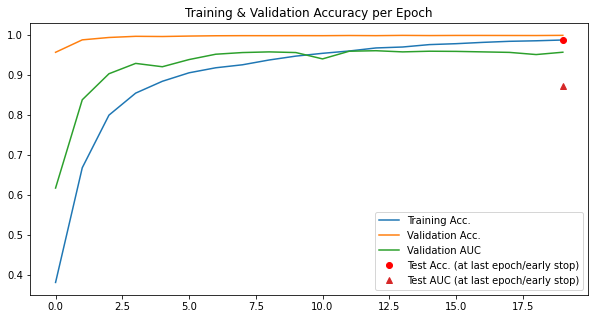

In [198]:
# Runs the classifier again 

clf = run_classifier_pipeline(name_dataset, info_flags, condGAN_loader)

#### Generating an upgraded dataset with Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [199]:
# Creates the augmented dataloader
condGAN_loader = generate_augmented_dataset_condGAN(
    n_channels, n_classes, latent_dims, model_path,
    base_dataset[0], 64, 
    test_loader, val_loader, n_generated_images,
    weighted_sampling=True
)

2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "OrganCMNIST",
  "description": "The OrganCMNIST is based on 3D computed tomography (CT) images from Liver Tumor Segmentation Benchmark (LiTS). It is renamed from OrganMNIST_Coronal (in MedMNIST v1) for simplicity. We use bounding-box annotations of 11 body organs from another study to obtain the organ labels. Hounsfield-Unit (HU) of the 3D images are transformed into gray-scale with an abdominal window. We crop 2D images from the center slices of the 3D bounding boxes in coronal views (planes). The images are resized into 1\u00d728\u00d728 to perform multi-class classification of 11 body organs. 115 and 16 CT scans from the source training set are used as training and validation set, respectively. The 70 CT scans from the source test set are treated as the test set.",
  "url": "https://zenodo.org/record/5208230/files/organcmnist.npz?download=1",
  "MD5": "0afa5834fb105f7705a7d93372119a21",
  "task": "multi-class",
  "label": {
    "0": "bladder",
    "1": "femur-le

100%|████████████████████████████████████████| 224/224 [00:01<00:00, 115.02it/s]


train -- accuracy: 0.43
val -- accuracy: 0.97,  AUC: 0.78
Epoch 1



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 115.30it/s]


train -- accuracy: 0.73
val -- accuracy: 1.0,  AUC: 0.91
Epoch 2



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 115.15it/s]


train -- accuracy: 0.83
val -- accuracy: 1.0,  AUC: 0.92
Epoch 3



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 115.21it/s]


train -- accuracy: 0.87
val -- accuracy: 1.0,  AUC: 0.93
Epoch 4



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 114.87it/s]


train -- accuracy: 0.9
val -- accuracy: 1.0,  AUC: 0.94
Epoch 5



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 115.01it/s]


train -- accuracy: 0.91
val -- accuracy: 1.0,  AUC: 0.94
Epoch 6



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 114.71it/s]


train -- accuracy: 0.92
val -- accuracy: 1.0,  AUC: 0.96
Epoch 7



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 114.99it/s]


train -- accuracy: 0.94
val -- accuracy: 1.0,  AUC: 0.95
Epoch 8



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 115.62it/s]


train -- accuracy: 0.95
val -- accuracy: 1.0,  AUC: 0.95
Epoch 9



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 115.16it/s]


train -- accuracy: 0.95
val -- accuracy: 1.0,  AUC: 0.95
Epoch 10



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 115.02it/s]


train -- accuracy: 0.96
val -- accuracy: 1.0,  AUC: 0.96
Epoch 11



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 115.70it/s]


train -- accuracy: 0.97
val -- accuracy: 1.0,  AUC: 0.96
Epoch 12



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 115.20it/s]


train -- accuracy: 0.97
val -- accuracy: 1.0,  AUC: 0.95
Epoch 13



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 114.88it/s]


train -- accuracy: 0.98
val -- accuracy: 1.0,  AUC: 0.97
Epoch 14



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 115.03it/s]


train -- accuracy: 0.98
val -- accuracy: 1.0,  AUC: 0.96
Epoch 15



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 115.09it/s]


train -- accuracy: 0.98
val -- accuracy: 1.0,  AUC: 0.96
Epoch 16



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 112.71it/s]


train -- accuracy: 0.98
val -- accuracy: 1.0,  AUC: 0.96
Epoch 17



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 115.51it/s]


train -- accuracy: 0.99
val -- accuracy: 1.0,  AUC: 0.96
Epoch 18



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 114.25it/s]


train -- accuracy: 0.99
val -- accuracy: 1.0,  AUC: 0.96
Epoch 19



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 114.54it/s]


train -- accuracy: 0.99
val -- accuracy: 1.0,  AUC: 0.96
test -- accuracy: 0.99,  AUC: 0.86


<Figure size 720x720 with 0 Axes>

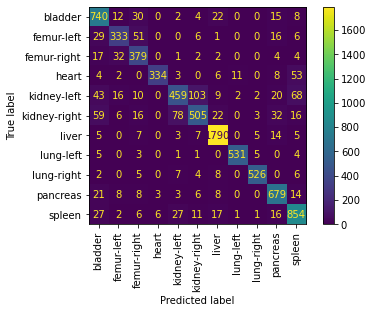

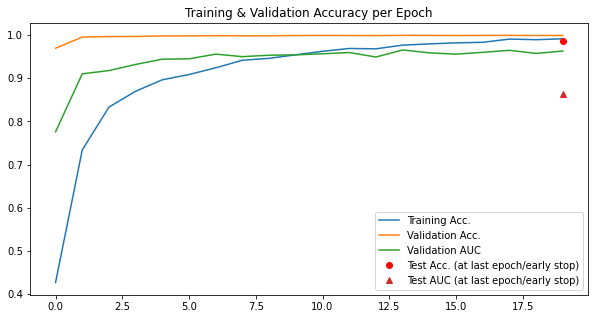

In [200]:
# Runs the classifier again 

clf = run_classifier_pipeline(name_dataset, info_flags, condGAN_loader)

### OrgansMNIST

#### Training the Conditional GAN

In [201]:
# Declares the dataset name and retrieves the base dataset
name_dataset = "organsmnist"
base_dataset = organsmnist_noWRS_noGDA_upscaled

# Retrieves the dataset parameters
n_classes  = len(info_flags[name_dataset][0]["label"])
n_channels = info_flags[name_dataset][0]["n_channels"]

# Retrieves the data loader
train_loader = base_dataset[3] #####################################################
val_loader = base_dataset[5]   ### OF NOTE #########################################
test_loader = base_dataset[4]  ### EVALUATE/TEST NOT IMPLEMENTED YET IN ############
                               ### TORCHFUSION AT THE TIME OF CREATION OF NOTEBOOK #
                               ### Thus the use of None below in the pipeline ######
                               #####################################################

Path trained_models/conditionalGAN/organsmnist/ created.
Epoch 1 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_1.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_1.pth
Epoch: 1, Duration: 10.594209671020508 , Gen Loss: 2.3535049766857963 Disc Loss: 0.3292406561042862
Epoch 2 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_2.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_2.pth
Epoch: 2, Duration: 10.4728262424469 , Gen Loss: 2.9431068978658534 Disc Loss: 0.23596138865225968
Epoch 3 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_3.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_3.pth
Epoch: 3, Duration: 10.50066351890564 , Gen Loss: 3.628773986728838 Disc Loss: 0.190247562797

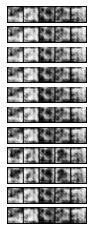

New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_5.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_5.pth
Epoch: 5, Duration: 11.1520094871521 , Gen Loss: 3.841649199695122 Disc Loss: 0.22328225878766142
Epoch 6 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_6.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_6.pth
Epoch: 6, Duration: 10.520471334457397 , Gen Loss: 4.141912885581061 Disc Loss: 0.19618478608097203
Epoch 7 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_7.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_7.pth
Epoch: 7, Duration: 10.508596181869507 , Gen Loss: 4.569592337697274 Disc Loss: 0.16378877877847023
Epoch 8 of 100
New Generator model saved at trained_models/conditi

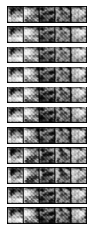

New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_10.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_10.pth
Epoch: 10, Duration: 10.950015306472778 , Gen Loss: 3.758439349444046 Disc Loss: 0.19508781706756637
Epoch 11 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_11.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_11.pth
Epoch: 11, Duration: 10.808730363845825 , Gen Loss: 4.4240035419655666 Disc Loss: 0.1763236660184272
Epoch 12 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_12.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_12.pth
Epoch: 12, Duration: 10.517064332962036 , Gen Loss: 4.410495034522955 Disc Loss: 0.19278797384998206
Epoch 13 of 100
New Generator model saved at trained_

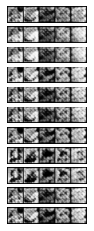

New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_14.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_14.pth
Epoch: 14, Duration: 11.05588698387146 , Gen Loss: 3.1729356281384504 Disc Loss: 0.27766069497063306
Epoch 15 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_15.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_15.pth
Epoch: 15, Duration: 10.506349802017212 , Gen Loss: 2.902126580434003 Disc Loss: 0.2634381725251076
Epoch 16 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_16.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_16.pth
Epoch: 16, Duration: 10.517812252044678 , Gen Loss: 2.8120082160150646 Disc Loss: 0.2717854876087249
Epoch 17 of 100
New Generator model saved at trained_m

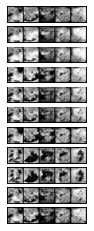

New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_19.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_19.pth
Epoch: 19, Duration: 11.041188716888428 , Gen Loss: 2.554822845677905 Disc Loss: 0.2580609489889706
Epoch 20 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_20.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_20.pth
Epoch: 20, Duration: 10.506695747375488 , Gen Loss: 2.5811166158536585 Disc Loss: 0.26310133202004127
Epoch 21 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_21.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_21.pth
Epoch: 21, Duration: 10.513816356658936 , Gen Loss: 2.564172345767575 Disc Loss: 0.2579648689696915
Epoch 22 of 100
New Generator model saved at trained_m

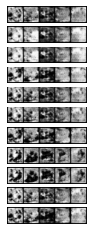

New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_23.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_23.pth
Epoch: 23, Duration: 11.06048583984375 , Gen Loss: 2.3818199650286944 Disc Loss: 0.2605332143337518
Epoch 24 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_24.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_24.pth
Epoch: 24, Duration: 10.544968366622925 , Gen Loss: 2.365134336890244 Disc Loss: 0.26106326569785687
Epoch 25 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_25.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_25.pth
Epoch: 25, Duration: 10.523488521575928 , Gen Loss: 2.3724718660329986 Disc Loss: 0.2695982748329896
Epoch 26 of 100
New Generator model saved at trained_m

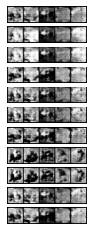

New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_28.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_28.pth
Epoch: 28, Duration: 10.981544733047485 , Gen Loss: 2.3230799408177907 Disc Loss: 0.2609256082148942
Epoch 29 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_29.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_29.pth
Epoch: 29, Duration: 10.508572101593018 , Gen Loss: 2.414105093256815 Disc Loss: 0.24347267096148673
Epoch 30 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_30.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_30.pth
Epoch: 30, Duration: 10.507153511047363 , Gen Loss: 2.3950381657998565 Disc Loss: 0.23822109052748386
Epoch 31 of 100
New Generator model saved at trained

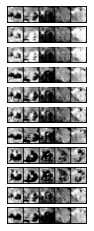

New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_33.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_33.pth
Epoch: 33, Duration: 11.422786235809326 , Gen Loss: 2.399905005828551 Disc Loss: 0.25005149020355094
Epoch 34 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_34.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_34.pth
Epoch: 34, Duration: 10.534367799758911 , Gen Loss: 2.335002269772238 Disc Loss: 0.23843845274390243
Epoch 35 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_35.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_35.pth
Epoch: 35, Duration: 10.565040588378906 , Gen Loss: 2.3883569090746053 Disc Loss: 0.25159814032796807
Epoch 36 of 100
New Generator model saved at trained

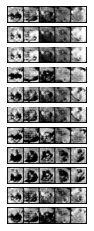

New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_37.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_37.pth
Epoch: 37, Duration: 11.043161869049072 , Gen Loss: 2.3286406025824964 Disc Loss: 0.24794357934675396
Epoch 38 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_38.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_38.pth
Epoch: 38, Duration: 10.4908766746521 , Gen Loss: 2.3219880682837157 Disc Loss: 0.2441405549453013
Epoch 39 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_39.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_39.pth
Epoch: 39, Duration: 10.51699948310852 , Gen Loss: 2.326144973995696 Disc Loss: 0.24143222277954626
Epoch 40 of 100
New Generator model saved at trained_mo

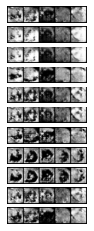

New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_42.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_42.pth
Epoch: 42, Duration: 11.041659116744995 , Gen Loss: 2.307776912213056 Disc Loss: 0.24164828898403873
Epoch 43 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_43.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_43.pth
Epoch: 43, Duration: 10.498336553573608 , Gen Loss: 2.3734856976327117 Disc Loss: 0.23814278688800214
Epoch 44 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_44.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_44.pth
Epoch: 44, Duration: 10.51300597190857 , Gen Loss: 2.3408745348368005 Disc Loss: 0.23100673505873387
Epoch 45 of 100
New Generator model saved at trained

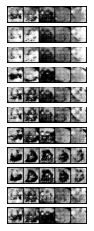

New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_46.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_46.pth
Epoch: 46, Duration: 10.983279705047607 , Gen Loss: 2.360163255469871 Disc Loss: 0.2423968584670911
Epoch 47 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_47.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_47.pth
Epoch: 47, Duration: 10.515995740890503 , Gen Loss: 2.3779375336262554 Disc Loss: 0.22943477767440817
Epoch 48 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_48.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_48.pth
Epoch: 48, Duration: 10.517481565475464 , Gen Loss: 2.431885816445481 Disc Loss: 0.2246747010065459
Epoch 49 of 100
New Generator model saved at trained_m

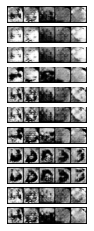

New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_51.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_51.pth
Epoch: 51, Duration: 10.985366106033325 , Gen Loss: 2.4454422413020085 Disc Loss: 0.23896661263114238
Epoch 52 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_52.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_52.pth
Epoch: 52, Duration: 10.519943475723267 , Gen Loss: 2.411740326847202 Disc Loss: 0.2244625053241571
Epoch 53 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_53.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_53.pth
Epoch: 53, Duration: 10.526963472366333 , Gen Loss: 2.4432926829268293 Disc Loss: 0.208696940571198
Epoch 54 of 100
New Generator model saved at trained_m

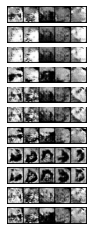

New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_56.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_56.pth
Epoch: 56, Duration: 11.483361721038818 , Gen Loss: 2.4597443283715927 Disc Loss: 0.21875588459469153
Epoch 57 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_57.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_57.pth
Epoch: 57, Duration: 10.539522886276245 , Gen Loss: 2.5110201645444765 Disc Loss: 0.21128491876457137
Epoch 58 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_58.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_58.pth
Epoch: 58, Duration: 10.547483444213867 , Gen Loss: 2.505118196287661 Disc Loss: 0.20398788123767037
Epoch 59 of 100
New Generator model saved at traine

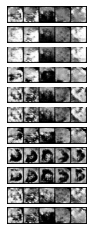

New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_60.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_60.pth
Epoch: 60, Duration: 11.08339548110962 , Gen Loss: 2.470698361280488 Disc Loss: 0.21538103451174678
Epoch 61 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_61.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_61.pth
Epoch: 61, Duration: 10.534260988235474 , Gen Loss: 2.539616212338594 Disc Loss: 0.20300236924991033
Epoch 62 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_62.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_62.pth
Epoch: 62, Duration: 10.534987688064575 , Gen Loss: 2.498419285778336 Disc Loss: 0.21246297609173243
Epoch 63 of 100
New Generator model saved at trained_m

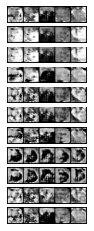

New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_65.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_65.pth
Epoch: 65, Duration: 10.973847150802612 , Gen Loss: 2.553055785957676 Disc Loss: 0.2063654676571467
Epoch 66 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_66.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_66.pth
Epoch: 66, Duration: 10.520013093948364 , Gen Loss: 2.580912336352224 Disc Loss: 0.19909559383967002
Epoch 67 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_67.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_67.pth
Epoch: 67, Duration: 11.141784906387329 , Gen Loss: 2.508072823260402 Disc Loss: 0.20446763332810258
Epoch 68 of 100
New Generator model saved at trained_m

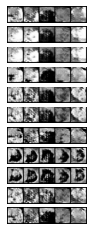

New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_69.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_69.pth
Epoch: 69, Duration: 11.03432297706604 , Gen Loss: 2.5156174340925395 Disc Loss: 0.2022625390905219
Epoch 70 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_70.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_70.pth
Epoch: 70, Duration: 10.495656490325928 , Gen Loss: 2.5780070278873746 Disc Loss: 0.20030400236504664
Epoch 71 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_71.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_71.pth
Epoch: 71, Duration: 10.492774248123169 , Gen Loss: 2.5281989777618366 Disc Loss: 0.20284231177703552
Epoch 72 of 100
New Generator model saved at trained

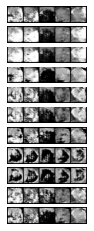

New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_74.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_74.pth
Epoch: 74, Duration: 11.068289041519165 , Gen Loss: 2.5729762598637014 Disc Loss: 0.20775151738477404
Epoch 75 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_75.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_75.pth
Epoch: 75, Duration: 10.576967239379883 , Gen Loss: 2.513872231438307 Disc Loss: 0.20296674643561693
Epoch 76 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_76.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_76.pth
Epoch: 76, Duration: 10.552992582321167 , Gen Loss: 2.5649053981348637 Disc Loss: 0.2083051596686693
Epoch 77 of 100
New Generator model saved at trained

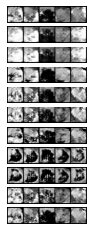

New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_78.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_78.pth
Epoch: 78, Duration: 11.598727941513062 , Gen Loss: 2.547212943866571 Disc Loss: 0.2027233238712787
Epoch 79 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_79.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_79.pth
Epoch: 79, Duration: 10.49799394607544 , Gen Loss: 2.548571164365136 Disc Loss: 0.20599431786338773
Epoch 80 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_80.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_80.pth
Epoch: 80, Duration: 10.500768899917603 , Gen Loss: 2.5405798847740315 Disc Loss: 0.20408177204761477
Epoch 81 of 100
New Generator model saved at trained_m

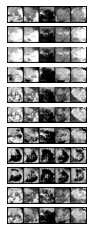

New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_83.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_83.pth
Epoch: 83, Duration: 10.941500663757324 , Gen Loss: 2.5195200412482066 Disc Loss: 0.2063679896263002
Epoch 84 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_84.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_84.pth
Epoch: 84, Duration: 10.498602867126465 , Gen Loss: 2.5445029479017216 Disc Loss: 0.20086627889055775
Epoch 85 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_85.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_85.pth
Epoch: 85, Duration: 10.493781089782715 , Gen Loss: 2.5445637553802007 Disc Loss: 0.2083317979678533
Epoch 86 of 100
New Generator model saved at trained

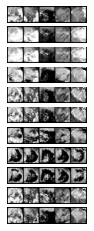

New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_88.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_88.pth
Epoch: 88, Duration: 10.95945143699646 , Gen Loss: 2.5545137643472025 Disc Loss: 0.19730126532796807
Epoch 89 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_89.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_89.pth
Epoch: 89, Duration: 10.927615642547607 , Gen Loss: 2.4900045955882355 Disc Loss: 0.21693194045911046
Epoch 90 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_90.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_90.pth
Epoch: 90, Duration: 10.64447021484375 , Gen Loss: 2.5529711598816354 Disc Loss: 0.20236586977111728
Epoch 91 of 100
New Generator model saved at trained

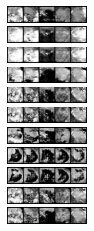

New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_92.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_92.pth
Epoch: 92, Duration: 11.016086101531982 , Gen Loss: 2.5634754416248207 Disc Loss: 0.20525674696803264
Epoch 93 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_93.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_93.pth
Epoch: 93, Duration: 10.508002042770386 , Gen Loss: 2.574307018920373 Disc Loss: 0.20632896915911944
Epoch 94 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_94.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_94.pth
Epoch: 94, Duration: 10.494054555892944 , Gen Loss: 2.5116803600251076 Disc Loss: 0.21415411403223636
Epoch 95 of 100
New Generator model saved at traine

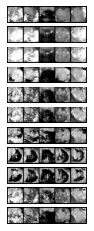

New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_97.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_97.pth
Epoch: 97, Duration: 11.026833534240723 , Gen Loss: 2.534028649569584 Disc Loss: 0.2070744737491033
Epoch 98 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_98.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_98.pth
Epoch: 98, Duration: 10.48913860321045 , Gen Loss: 2.535957955972023 Disc Loss: 0.19887140129012734
Epoch 99 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_99.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_99.pth
Epoch: 99, Duration: 10.487481117248535 , Gen Loss: 2.54760525017934 Disc Loss: 0.20117858273740136
Epoch 100 of 100
New Generator model saved at trained_mo

In [202]:
# Runs the Cond GAN
run_GAN_pipeline(
    train_loader, None, None, #val_loader, test_loader, 
    n_channels, latent_dims, n_classes,
    epochs=epochs, name_dataset=name_dataset
)

#### Generating an upgraded dataset without Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [203]:
# Removes saved intermediary models
model_path = f"trained_models/conditionalGAN/{name_dataset}/gen_models/"
models = [x for x in os.listdir(model_path) 
          if x[-(4+len(str(epochs))):]!=f"{epochs}.pth"]
for model in models:
    os.remove(model_path+model)
# Fetches the generated GAN Model model to import
model_path += f"gen_model_{epochs}.pth"

# Calculates the number of images to generate
percentage = 10
nb_images_in_dataset = len(base_dataset[0])
n_generated_images = int((percentage/100)*nb_images_in_dataset)
print(f"Number of generated images: {n_generated_images}",
      f"({percentage}% of the dataset)")

# Creates the augmented dataloader
condGAN_loader = generate_augmented_dataset_condGAN(
    n_channels, n_classes, latent_dims, model_path,
    base_dataset[0], 64, 
    test_loader, val_loader, n_generated_images,
    weighted_sampling=False
)

Number of generated images: 1394 (10% of the dataset)


2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "OrganSMNIST",
  "description": "The OrganSMNIST is based on 3D computed tomography (CT) images from Liver Tumor Segmentation Benchmark (LiTS). It is renamed from OrganMNIST_Sagittal (in MedMNIST v1) for simplicity. We use bounding-box annotations of 11 body organs from another study to obtain the organ labels. Hounsfield-Unit (HU) of the 3D images are transformed into gray-scale with an abdominal window. We crop 2D images from the center slices of the 3D bounding boxes in sagittal views (planes). The images are resized into 1\u00d728\u00d728 to perform multi-class classification of 11 body organs. 115 and 16 CT scans from the source training set are used as training and validation set, respectively. The 70 CT scans from the source test set are treated as the test set.",
  "url": "https://zenodo.org/record/5208230/files/organsmnist.npz?download=1",
  "MD5": "e5c39f1af030238290b9557d9503af9d",
  "task": "multi-class",
  "label": {
    "0": "bladder",
    "1": "femur-

100%|████████████████████████████████████████| 240/240 [00:02<00:00, 114.46it/s]


train -- accuracy: 0.35
val -- accuracy: 0.92,  AUC: 0.51
Epoch 1



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 114.43it/s]


train -- accuracy: 0.56
val -- accuracy: 0.97,  AUC: 0.66
Epoch 2



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 115.34it/s]


train -- accuracy: 0.67
val -- accuracy: 0.98,  AUC: 0.73
Epoch 3



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 114.92it/s]


train -- accuracy: 0.73
val -- accuracy: 0.98,  AUC: 0.79
Epoch 4



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 115.00it/s]


train -- accuracy: 0.77
val -- accuracy: 0.99,  AUC: 0.82
Epoch 5



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 115.10it/s]


train -- accuracy: 0.79
val -- accuracy: 0.99,  AUC: 0.83
Epoch 6



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 116.03it/s]


train -- accuracy: 0.82
val -- accuracy: 0.99,  AUC: 0.84
Epoch 7



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 115.09it/s]


train -- accuracy: 0.84
val -- accuracy: 0.99,  AUC: 0.83
Epoch 8



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 115.31it/s]


train -- accuracy: 0.85
val -- accuracy: 0.99,  AUC: 0.85
Epoch 9



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 115.32it/s]


train -- accuracy: 0.87
val -- accuracy: 0.99,  AUC: 0.81
Epoch 10



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 115.38it/s]


train -- accuracy: 0.88
val -- accuracy: 0.99,  AUC: 0.86
Epoch 11



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 115.49it/s]


train -- accuracy: 0.9
val -- accuracy: 0.99,  AUC: 0.84
Epoch 12



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 115.56it/s]


train -- accuracy: 0.91
val -- accuracy: 0.99,  AUC: 0.84
Epoch 13



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 115.24it/s]


train -- accuracy: 0.92
val -- accuracy: 0.99,  AUC: 0.85
Epoch 14



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 115.37it/s]


train -- accuracy: 0.93
val -- accuracy: 0.99,  AUC: 0.85
Epoch 15



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 115.34it/s]


train -- accuracy: 0.93
val -- accuracy: 0.99,  AUC: 0.84
Epoch 16



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 115.35it/s]


train -- accuracy: 0.94
val -- accuracy: 0.99,  AUC: 0.86
Epoch 17



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 115.51it/s]


train -- accuracy: 0.94
val -- accuracy: 0.99,  AUC: 0.85
Epoch 18



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 115.88it/s]


train -- accuracy: 0.95
val -- accuracy: 0.99,  AUC: 0.85
Epoch 19



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 115.44it/s]


train -- accuracy: 0.95
val -- accuracy: 0.99,  AUC: 0.85
test -- accuracy: 0.96,  AUC: 0.72


<Figure size 720x720 with 0 Axes>

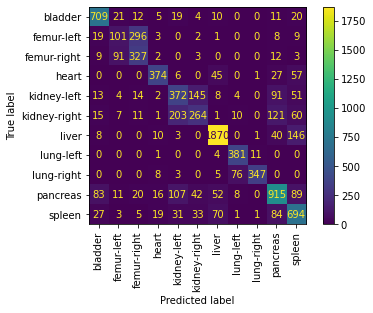

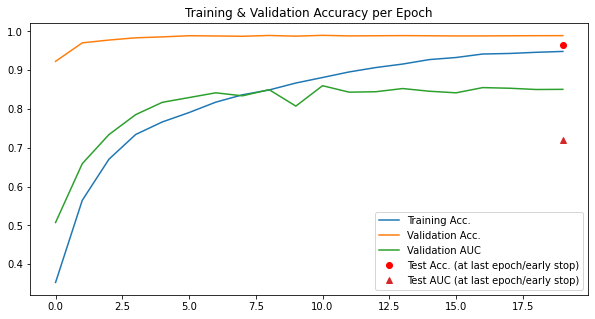

In [204]:
# Runs the classifier again 

clf = run_classifier_pipeline(name_dataset, info_flags, condGAN_loader)

#### Generating an upgraded dataset with Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [205]:
# Creates the augmented dataloader
condGAN_loader = generate_augmented_dataset_condGAN(
    n_channels, n_classes, latent_dims, model_path,
    base_dataset[0], 64, 
    test_loader, val_loader, n_generated_images,
    weighted_sampling=True
)

2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "OrganSMNIST",
  "description": "The OrganSMNIST is based on 3D computed tomography (CT) images from Liver Tumor Segmentation Benchmark (LiTS). It is renamed from OrganMNIST_Sagittal (in MedMNIST v1) for simplicity. We use bounding-box annotations of 11 body organs from another study to obtain the organ labels. Hounsfield-Unit (HU) of the 3D images are transformed into gray-scale with an abdominal window. We crop 2D images from the center slices of the 3D bounding boxes in sagittal views (planes). The images are resized into 1\u00d728\u00d728 to perform multi-class classification of 11 body organs. 115 and 16 CT scans from the source training set are used as training and validation set, respectively. The 70 CT scans from the source test set are treated as the test set.",
  "url": "https://zenodo.org/record/5208230/files/organsmnist.npz?download=1",
  "MD5": "e5c39f1af030238290b9557d9503af9d",
  "task": "multi-class",
  "label": {
    "0": "bladder",
    "1": "femur-

100%|████████████████████████████████████████| 240/240 [00:02<00:00, 114.98it/s]


train -- accuracy: 0.35
val -- accuracy: 0.94,  AUC: 0.51
Epoch 1



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 115.45it/s]


train -- accuracy: 0.55
val -- accuracy: 0.97,  AUC: 0.66
Epoch 2



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 115.20it/s]


train -- accuracy: 0.67
val -- accuracy: 0.98,  AUC: 0.78
Epoch 3



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 115.34it/s]


train -- accuracy: 0.72
val -- accuracy: 0.99,  AUC: 0.79
Epoch 4



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 115.77it/s]


train -- accuracy: 0.75
val -- accuracy: 0.99,  AUC: 0.82
Epoch 5



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 115.86it/s]


train -- accuracy: 0.78
val -- accuracy: 0.99,  AUC: 0.83
Epoch 6



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 115.87it/s]


train -- accuracy: 0.8
val -- accuracy: 0.99,  AUC: 0.84
Epoch 7



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 115.60it/s]


train -- accuracy: 0.82
val -- accuracy: 0.99,  AUC: 0.83
Epoch 8



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 115.23it/s]


train -- accuracy: 0.84
val -- accuracy: 0.99,  AUC: 0.85
Epoch 9



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 115.07it/s]


train -- accuracy: 0.85
val -- accuracy: 0.99,  AUC: 0.84
Epoch 10



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 115.50it/s]


train -- accuracy: 0.87
val -- accuracy: 0.99,  AUC: 0.85
Epoch 11



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 115.23it/s]


train -- accuracy: 0.88
val -- accuracy: 0.99,  AUC: 0.85
Epoch 12



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 115.25it/s]


train -- accuracy: 0.89
val -- accuracy: 0.99,  AUC: 0.86
Epoch 13



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 115.61it/s]


train -- accuracy: 0.91
val -- accuracy: 0.99,  AUC: 0.85
Epoch 14



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 116.06it/s]


train -- accuracy: 0.91
val -- accuracy: 0.99,  AUC: 0.85
Epoch 15



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 115.20it/s]


train -- accuracy: 0.93
val -- accuracy: 0.99,  AUC: 0.86
Epoch 16



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 115.61it/s]


train -- accuracy: 0.93
val -- accuracy: 0.99,  AUC: 0.86
Epoch 17



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 115.34it/s]


train -- accuracy: 0.94
val -- accuracy: 0.99,  AUC: 0.85
Epoch 18



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 115.32it/s]


train -- accuracy: 0.95
val -- accuracy: 0.99,  AUC: 0.86
Epoch 19



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 115.36it/s]


train -- accuracy: 0.96
val -- accuracy: 0.99,  AUC: 0.83
test -- accuracy: 0.96,  AUC: 0.7


<Figure size 720x720 with 0 Axes>

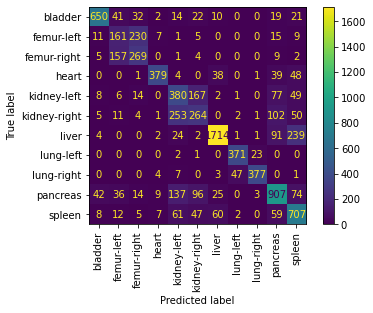

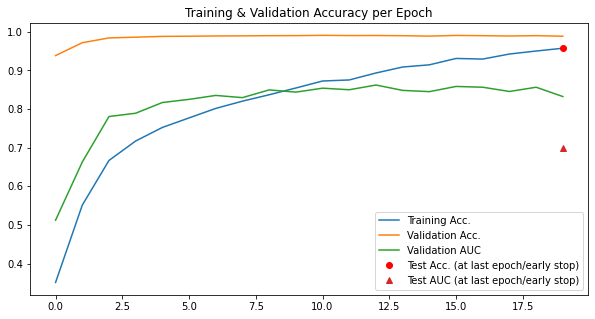

In [206]:
# Runs the classifier again 

clf = run_classifier_pipeline(name_dataset, info_flags, condGAN_loader)